# Loading basic data

In [1]:
import pandas as pd
import numpy as np
import os
import glob

# df_stc = pd.read_excel(os.path.join(os.getcwd(),'database','data','stc','stc.xlsx'))
df_stc = pd.read_parquet(glob.glob(os.path.join(os.getcwd(),'data','DRS','index','STC*.parquet'))[-1])

df_stc = df_stc.drop_duplicates()
df_stc['drs:stcHolder'] = df_stc['drs:stcHolder'].map(lambda x: x.replace(", Inc.","").replace(", Inc","").replace(" Inc.","").replace(" Inc",""))

print(df_stc.shape)

df_office = pd.read_excel(os.path.join(os.getcwd(),'data','STC','index','RespOffice.xlsx'))
df_office = df_office.drop_duplicates()
print(df_office.shape)

start_dates = pd.to_datetime(pd.DataFrame({'year': np.linspace(1950, 2020, 8)})['year'], format="%Y").dt.date
end_dates = pd.to_datetime(pd.DataFrame({'year': np.linspace(1960, 2030, 8)})['year'], format="%Y").dt.date

(79364, 27)
(60, 2)


# Data Sanity

* check dates all dates
* check missing data, only somne fields
* check coherence between drs:status and drs:stcStatus
* check choehrence between drs:stcProductType and drs:stcProductSubType

* Basic statitics to see balance: # STC (drs:chronicleId) vs. 
    *  holder (drs:stcHolder)
    *  type of part (drs:stcProductType)
    *  primaryRespOffice (drs:primaryRespOffice)
    *  time (drs:stcStatusDate drs:stcAplicationDate  docLastModifiedDate)
    *  stcProductType (drs:stcProductType)


SA00765DE pdf is broken. Just one!

## Missing pdfs

In [3]:
import os
import glob

dl_dir = os.path.join(os.getcwd(),'database','data','stc','pdf')

list_of_pdfs = glob.glob(os.path.join(dl_dir,"*.pdf"))
list_of_real_pdfs = [val for val in list_of_pdfs if os.path.getsize(val)>200]

print("Number of STCs = "+str(len(list_of_pdfs)))
print("Number of STCs with pdfs = "+str(len(list_of_real_pdfs)))

Number of STCs = 0
Number of STCs with pdfs = 0


## Abnormal date

In [4]:
print(df_stc[df_stc["drs:stcStatusDate"]<"1940-01-01T01:01:01.000Z"][["drs:chronicleId","drs:stcStatusDate","drs:stcAplicationDate","docLastModifiedDate"]])

    drs:chronicleId         drs:stcStatusDate     drs:stcAplicationDate  \
616       SA00198WI  1194-08-26T00:00:00.000Z  1994-07-07T00:00:00.000Z   
617       ST02602LA  0206-08-18T00:00:00.000Z  2015-06-22T00:00:00.000Z   
618       ST03355AT  0201-05-23T00:00:00.000Z  2005-07-09T00:00:00.000Z   
619       SA03518AT  0016-05-11T00:00:00.000Z  2006-05-12T00:00:00.000Z   

          docLastModifiedDate  
616  2021-03-22T14:45:42.000Z  
617  2021-10-27T02:03:51.000Z  
618  2021-10-27T01:57:25.000Z  
619  2021-03-22T14:47:51.000Z  


In [5]:
print(df_stc[df_stc["drs:stcStatusDate"]>"2040-01-01T01:01:01.000Z"][["drs:chronicleId","drs:stcStatusDate","drs:stcAplicationDate"]])

Empty DataFrame
Columns: [drs:chronicleId, drs:stcStatusDate, drs:stcAplicationDate]
Index: []


In [6]:
print(df_stc[df_stc["drs:stcAplicationDate"]<"1940-01-01T01:01:01.000Z"][["drs:chronicleId","drs:stcStatusDate","drs:stcAplicationDate"]])

    drs:chronicleId         drs:stcStatusDate     drs:stcAplicationDate
351      SA2058CE-D  2020-03-23T00:00:00.000Z  0986-09-16T00:00:00.000Z
73        ST10924SC  2019-05-10T00:00:00.000Z  1907-07-26T00:00:00.000Z
74        ST02555SE  2018-02-22T00:00:00.000Z  0207-05-15T00:00:00.000Z
731       ST03927NY  2017-06-16T00:00:00.000Z  0016-04-08T00:00:00.000Z
101       ST04102CH  2017-05-15T00:00:00.000Z  0216-03-24T00:00:00.000Z
186        SA1494NM  2017-04-27T00:00:00.000Z  1930-11-14T00:00:00.000Z
707       ST03821NY  2017-02-17T00:00:00.000Z  0216-10-21T00:00:00.000Z
363     ST01619LA-D  2015-12-23T00:00:00.000Z  0200-10-01T00:00:00.000Z
209       ST02363AT  2008-07-09T00:00:00.000Z  1901-02-28T00:00:00.000Z
119       SA01022WI  2001-11-23T00:00:00.000Z  0012-04-17T00:00:00.000Z
279      SA2058CE-D  2000-02-28T00:00:00.000Z  0986-09-16T00:00:00.000Z
571       SA00070WI  1993-06-10T00:00:00.000Z  1922-12-03T00:00:00.000Z
151        SA1494NM  1986-03-03T00:00:00.000Z  1930-11-14T00:00:

In [7]:
print(df_stc[df_stc["drs:stcAplicationDate"]>"2040-01-01T01:01:01.000Z"][["drs:chronicleId","drs:stcStatusDate","drs:stcAplicationDate"]])

    drs:chronicleId         drs:stcStatusDate     drs:stcAplicationDate
360      SA8084NM-D  2015-12-23T00:00:00.000Z  2996-10-25T00:00:00.000Z
106       SA01638WI  2011-07-28T00:00:00.000Z  2077-10-03T00:00:00.000Z
561        SH7536SW  2007-11-27T00:00:00.000Z  2988-11-03T00:00:00.000Z
699     ST01311WI-D  2005-03-04T00:00:00.000Z  2040-11-12T00:00:00.000Z
35        ST01999NY  2004-09-22T00:00:00.000Z  2040-03-28T00:00:00.000Z
577        SA3597NM  2004-07-07T00:00:00.000Z  2986-08-25T00:00:00.000Z
30        ST01823NY  2003-10-30T00:00:00.000Z  2993-09-10T00:00:00.000Z
407        SA3597NM  2003-03-24T00:00:00.000Z  2986-08-25T00:00:00.000Z
282        SA2291CE  1990-06-18T00:00:00.000Z  2987-05-20T00:00:00.000Z


This one is also a corrupted pdf: pdf/SA00765DE Page 2__Current__2F49BD200CEC24DD86257F5600610445.pdf

# Getting to know the metadata

## Number of STCs by stcProductSubType all years

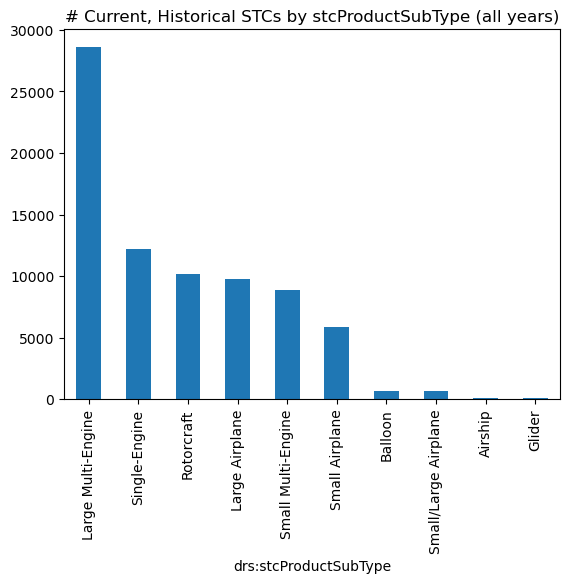

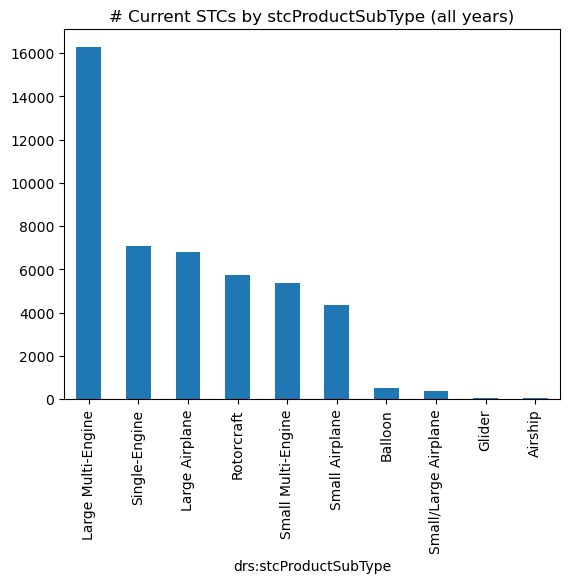

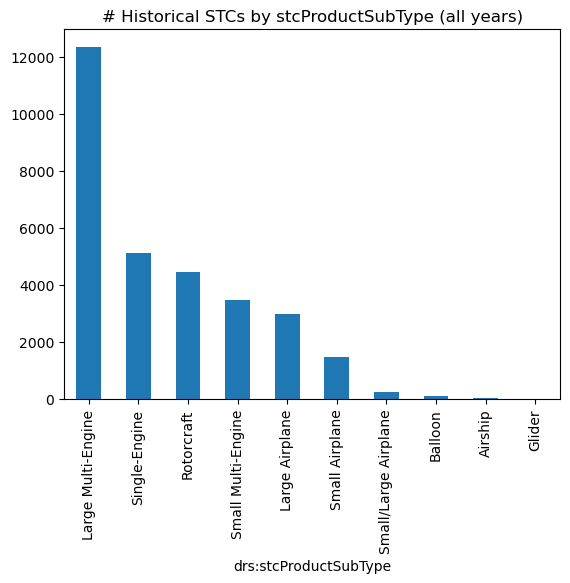

In [9]:
import matplotlib.pyplot as plt
import numpy as np

plt.rcParams['figure.dpi'] = 100
plt.rcParams['figure.figsize'] = 6.4, 4.8

for status in [["Current","Historical"],["Current"],["Historical"]]:
    try:
        df_stc[df_stc["drs:status"].isin(status)]["drs:stcProductSubType"].value_counts(ascending=False).nlargest(120).plot.bar()
        plt.yticks(fontsize=10)
        plt.title("# "+", ".join(status)+" STCs by stcProductSubType (all years)")
        plt.show()
    except:
        pass

## Number of STCs by stcProductSubType by decade

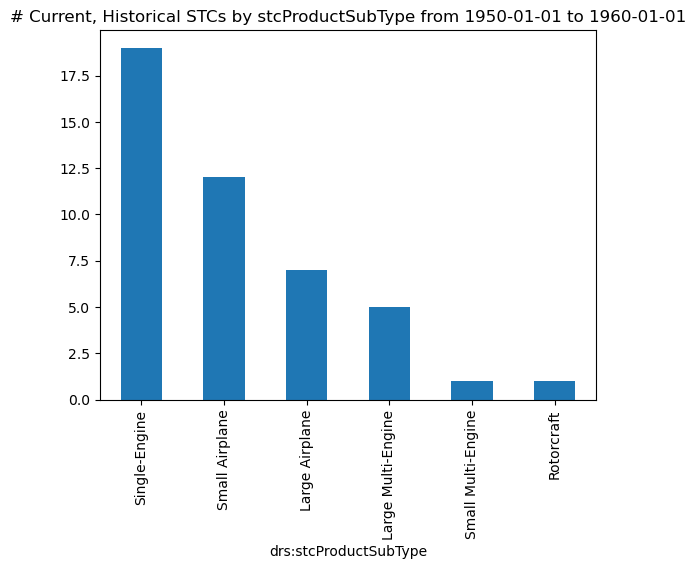

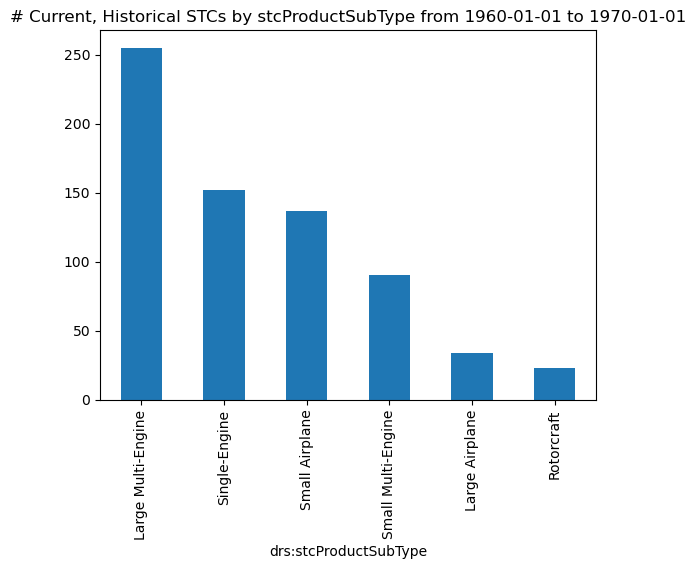

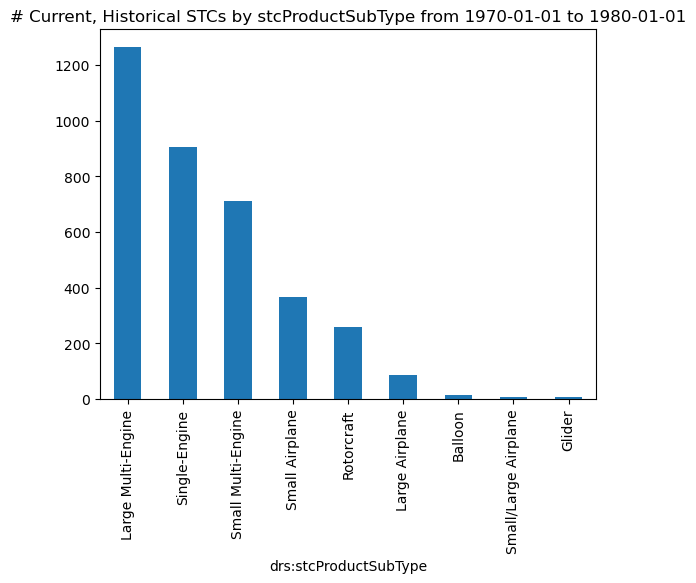

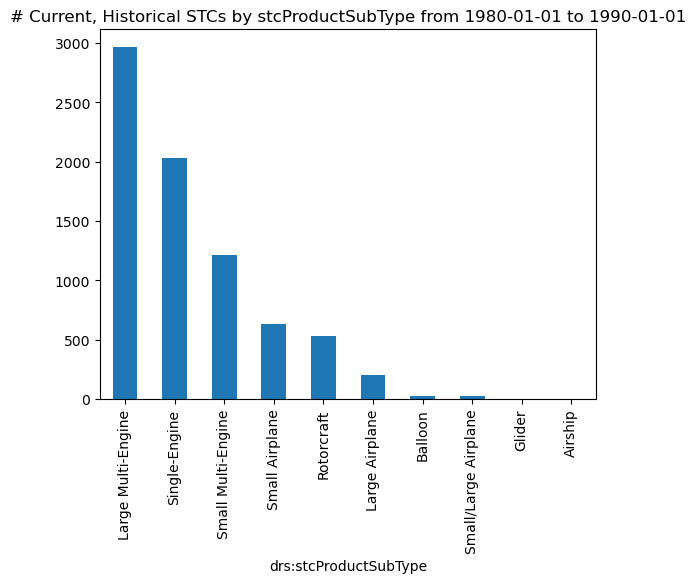

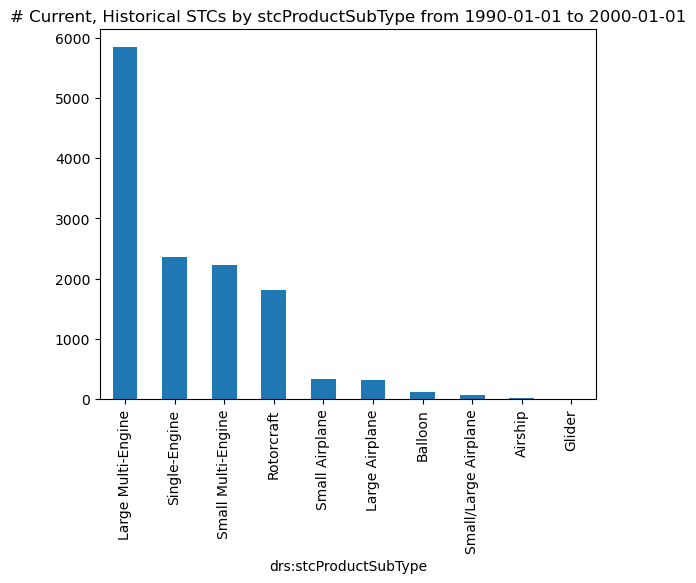

...

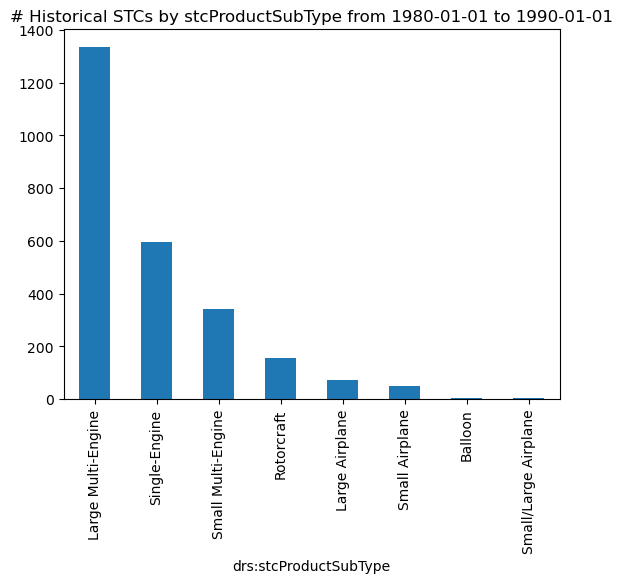

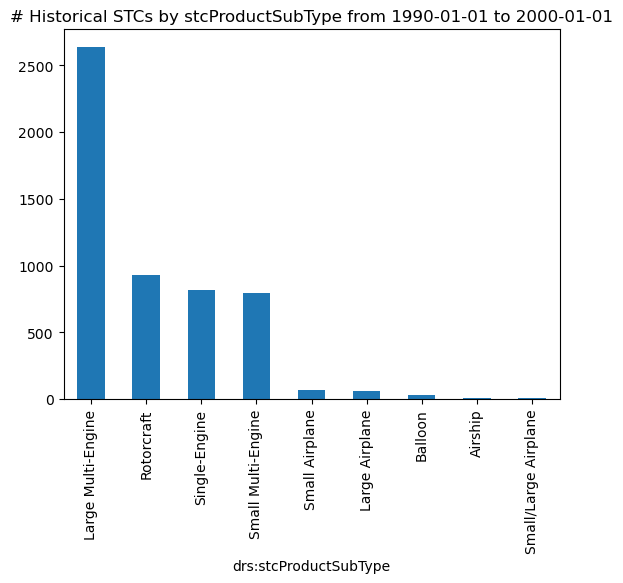

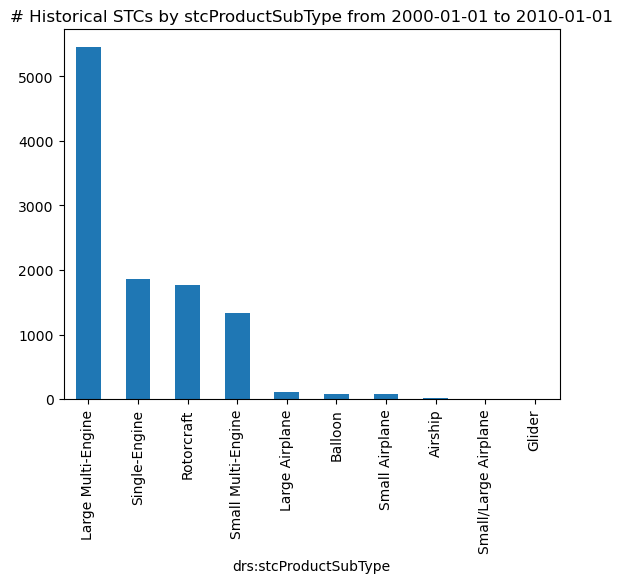

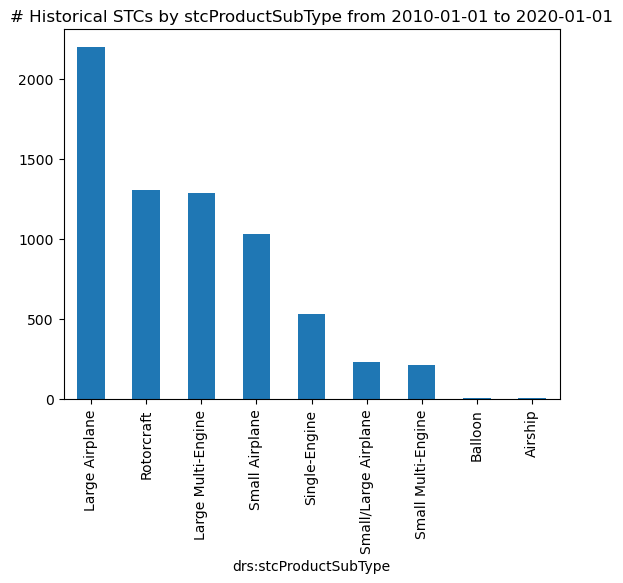

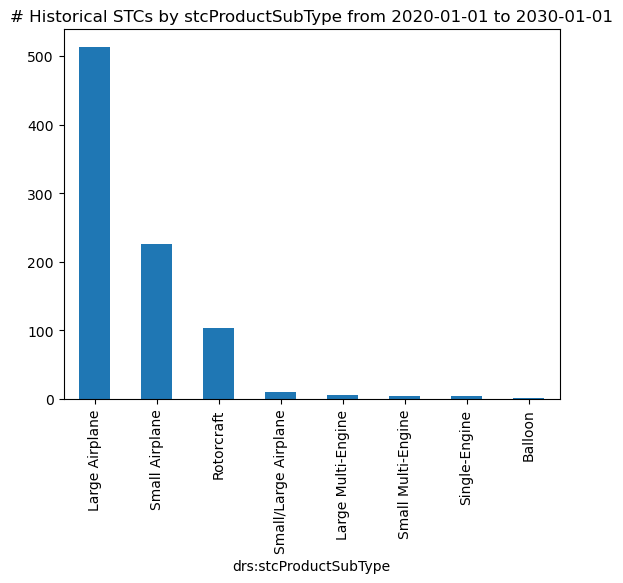

In [2]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

plt.rcParams['figure.dpi'] = 100
plt.rcParams['figure.figsize'] = 6.4, 4.8

for status in [["Current","Historical"],["Current"],["Historical"]]:
    for n, _ in enumerate(start_dates):
        try:
            df_dates = df_stc
            df_dates["date sortable "+str(n)] = pd.to_datetime(df_stc["drs:stcStatusDate"], errors="coerce").dt.date
            df_dates = df_dates[(start_dates.iloc[n]<df_dates["date sortable "+str(n)]) & (df_dates["date sortable "+str(n)]<end_dates.iloc[n])]

            df_dates[df_dates["drs:status"].isin(status)]["drs:stcProductSubType"].value_counts(ascending=False).plot.bar()
            
            plt.yticks(fontsize=10)
            plt.title("# "+", ".join(status)+" STCs by stcProductSubType from "+str(start_dates.iloc[n])+" to "+str(end_dates.iloc[n]))
            plt.show()
        except:
            pass

## Number of STCs by Holder all years

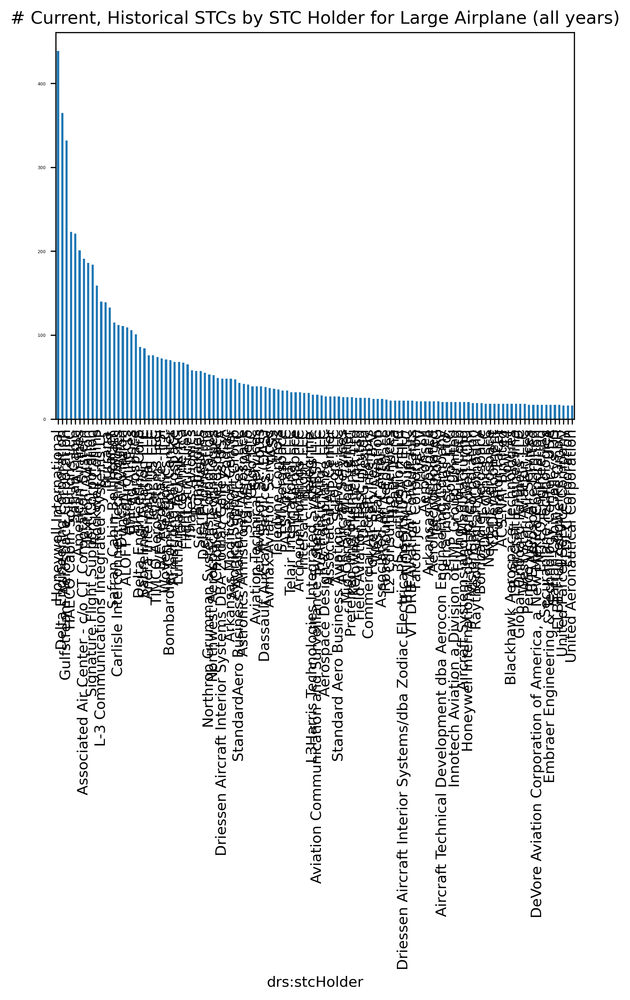

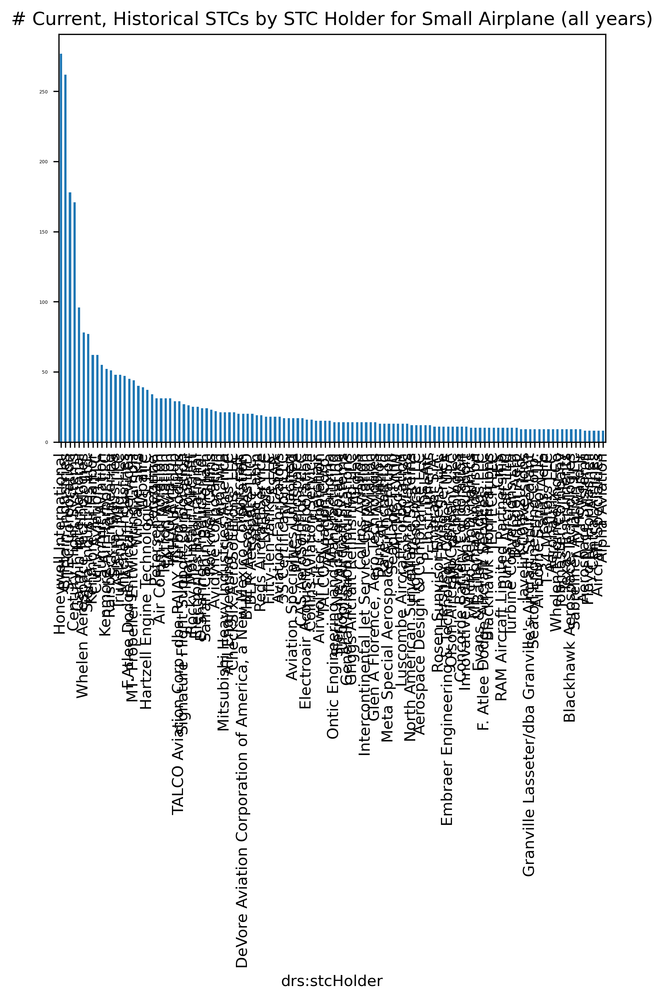

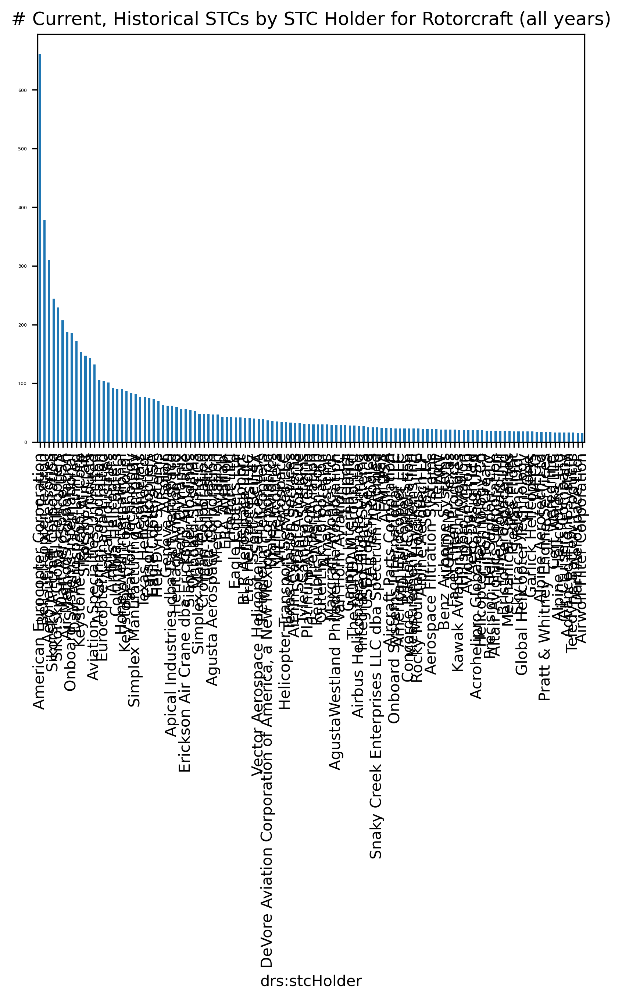

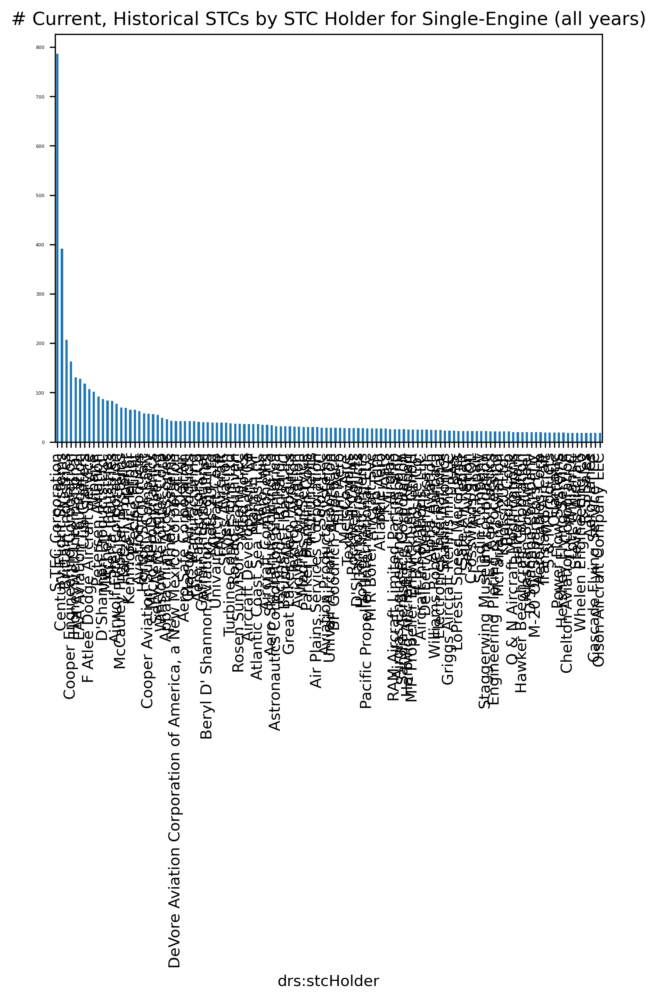

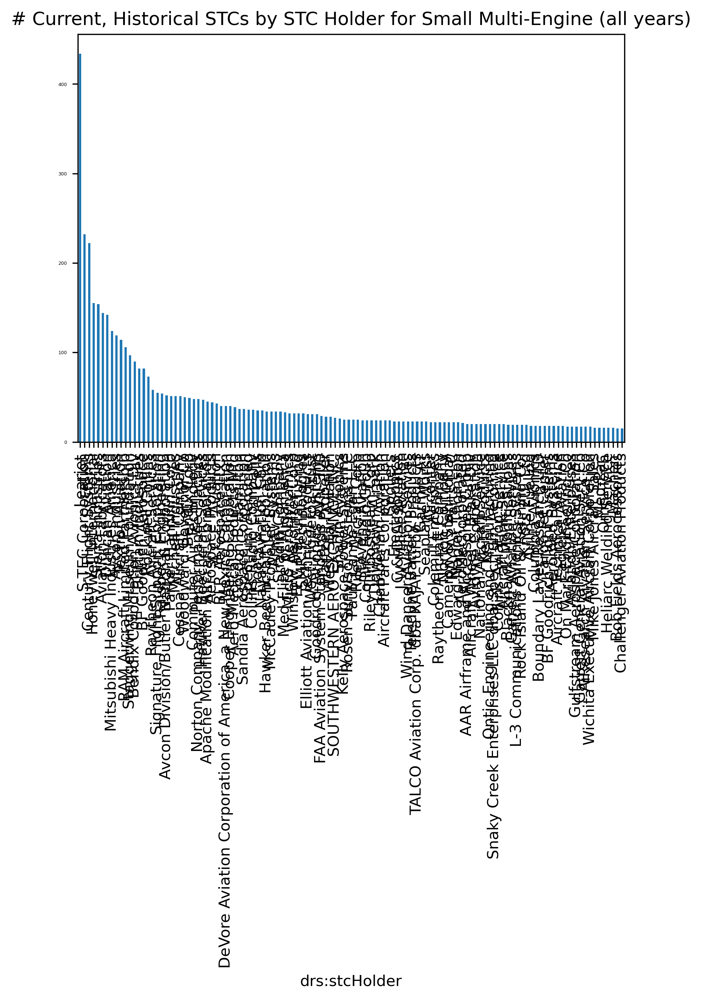

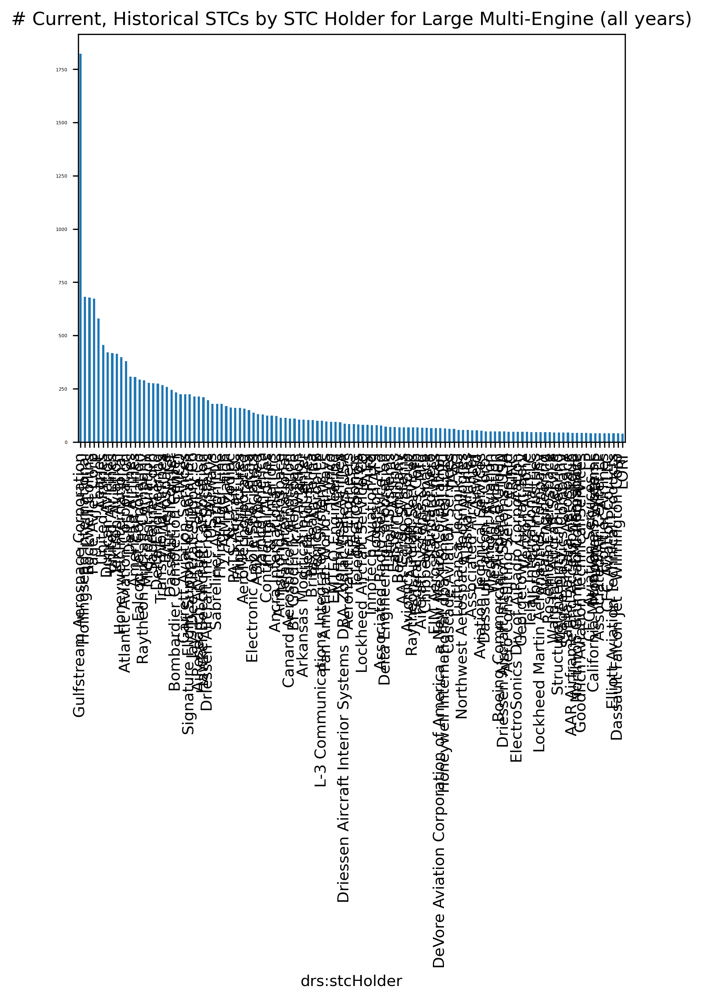

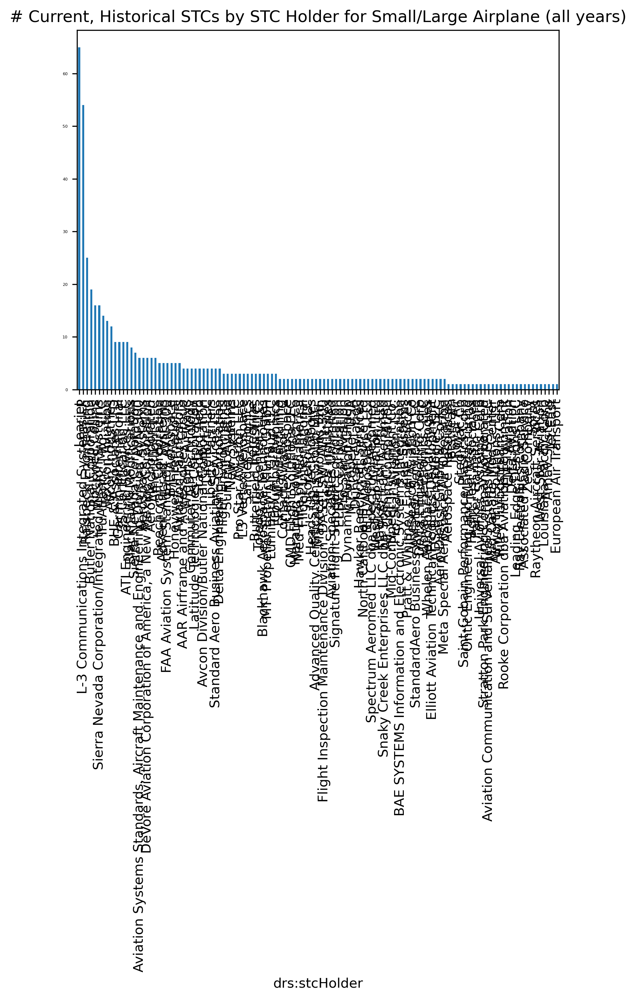

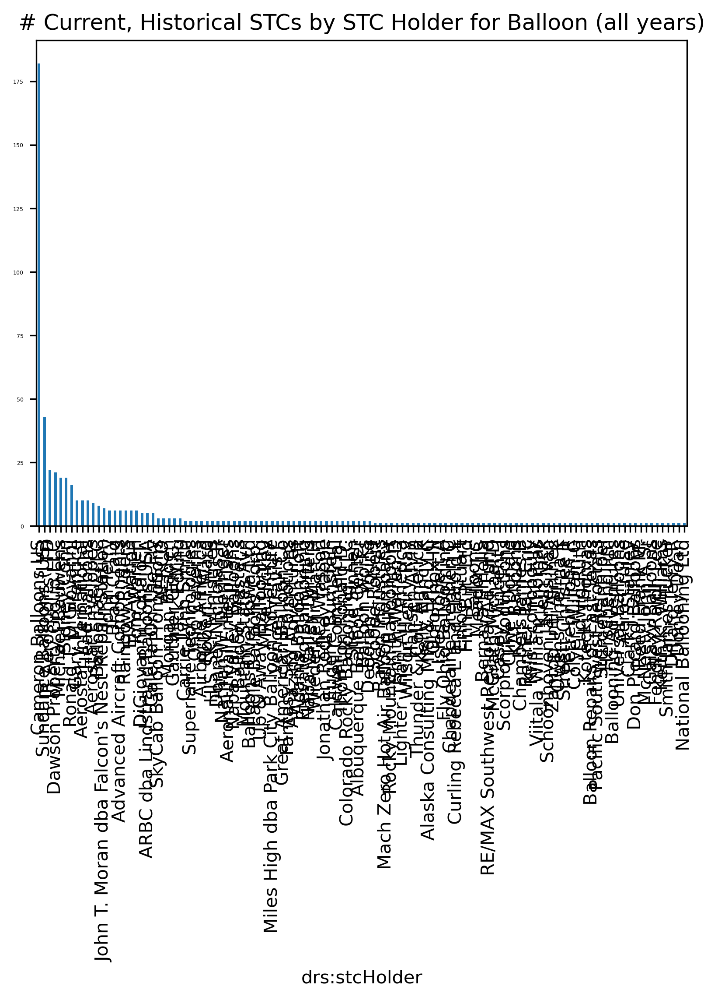

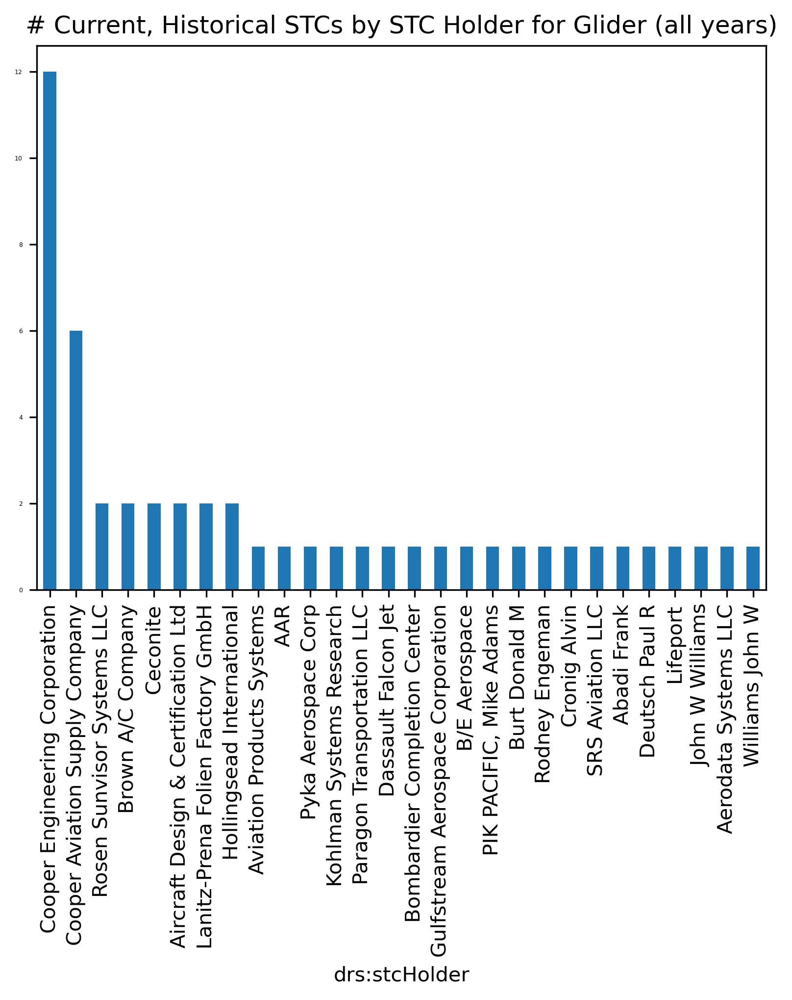

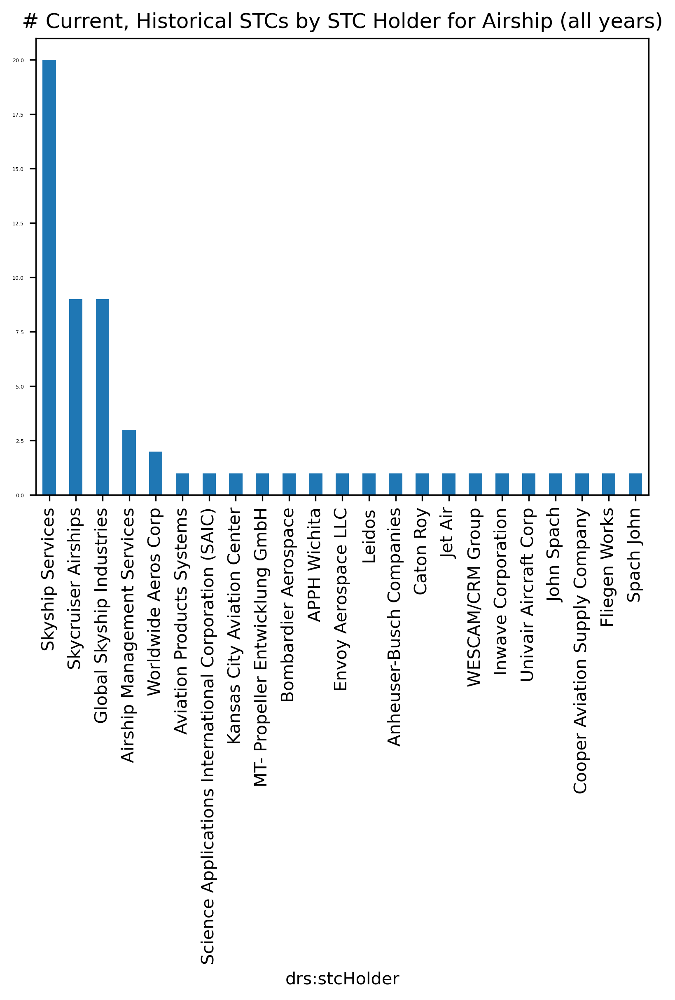

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2499209324.py:10: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_stc[df_stc["drs:status"].isin(status)][df_stc["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(120).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2499209324.py:10: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_stc[df_stc["drs:status"].isin(status)][df_stc["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(120).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2499209324.py:10: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_stc[df_stc["drs:status"].isin(status)][df_stc["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(120).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2499209324.py:

In [3]:
import matplotlib.pyplot as plt
import numpy as np

plt.rcParams['figure.dpi'] = 300
plt.rcParams['figure.figsize'] = 6.4, 4.8

for status in [["Current","Historical"],["Current"],["Historical"]]:
    for m, stcProductSubType in enumerate(df_stc["drs:stcProductSubType"].unique()):
        try:
            df_stc[df_stc["drs:status"].isin(status)][df_stc["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(120).plot.bar()
            plt.yticks(fontsize=3)
            plt.title("# "+", ".join(status)+" STCs by STC Holder for "+stcProductSubType + " (all years)")
            plt.show()
        except:
            pass

## Number of STCs by Holder by decade

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


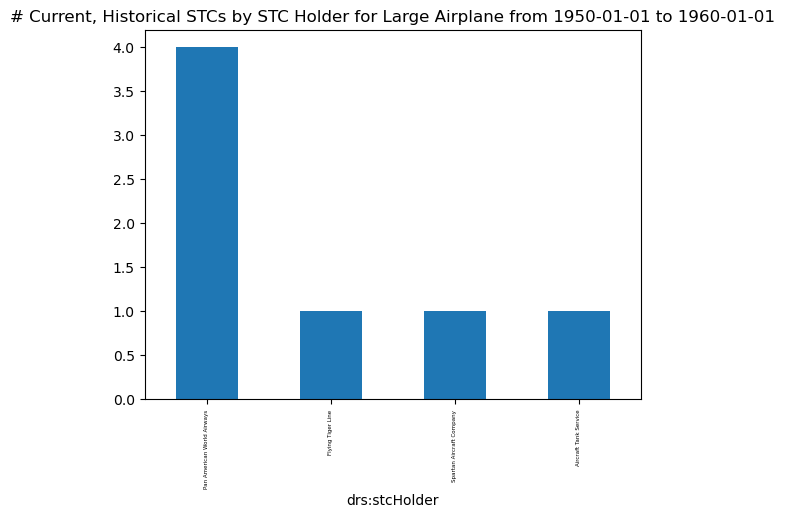

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


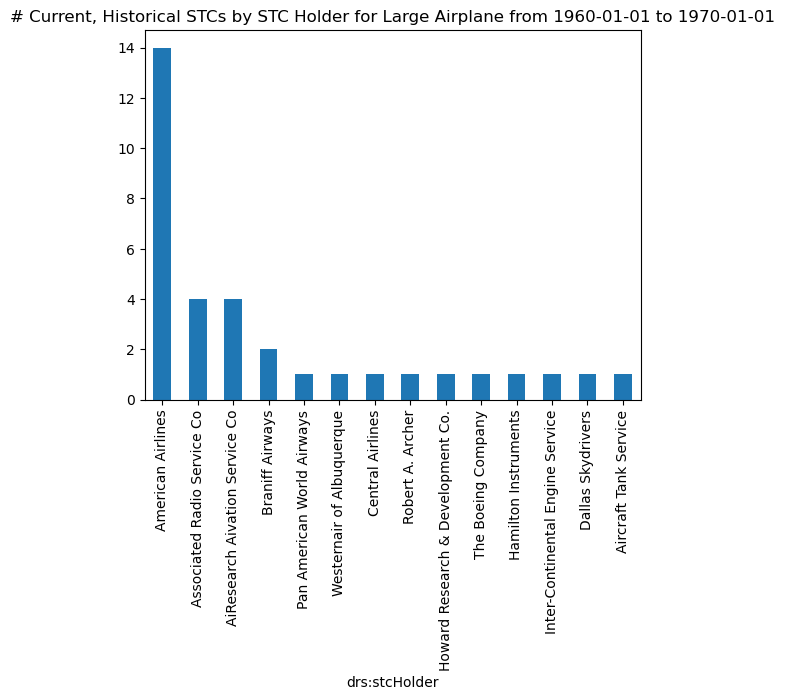

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


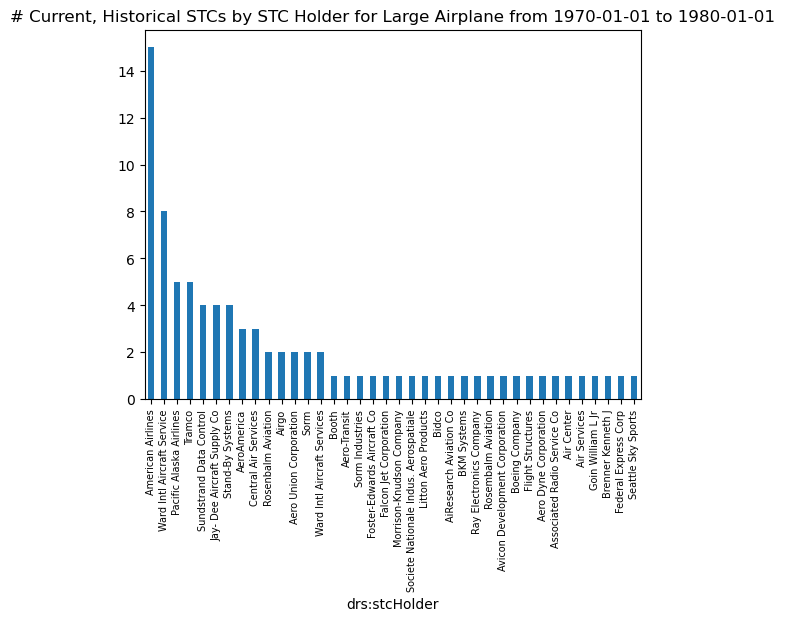

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


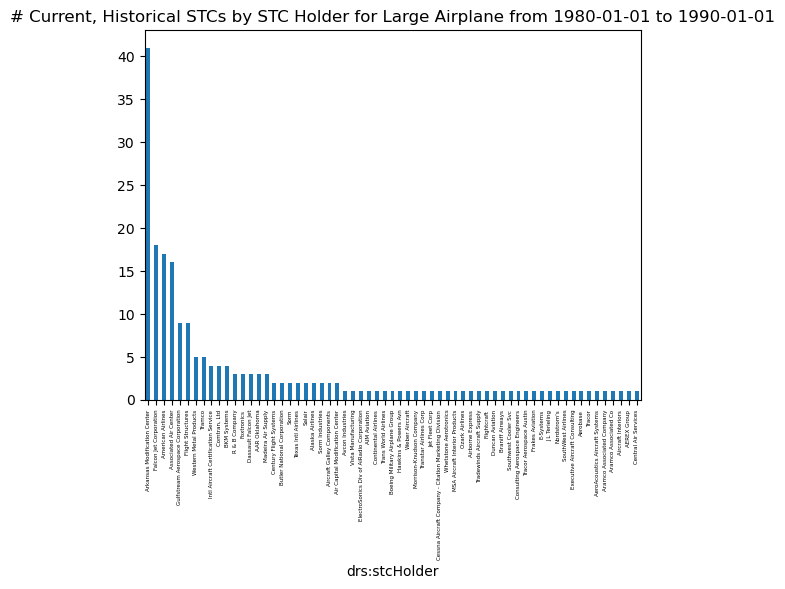

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


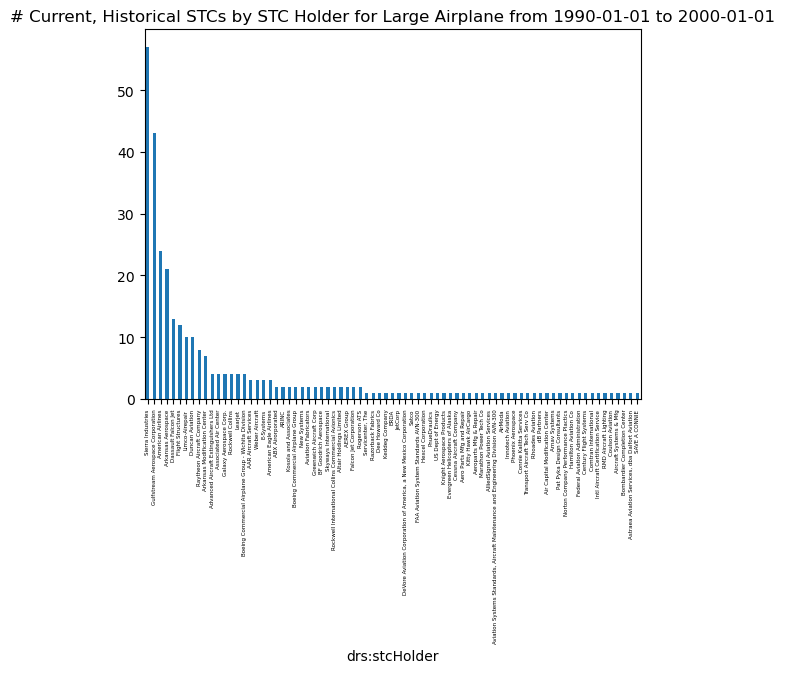

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


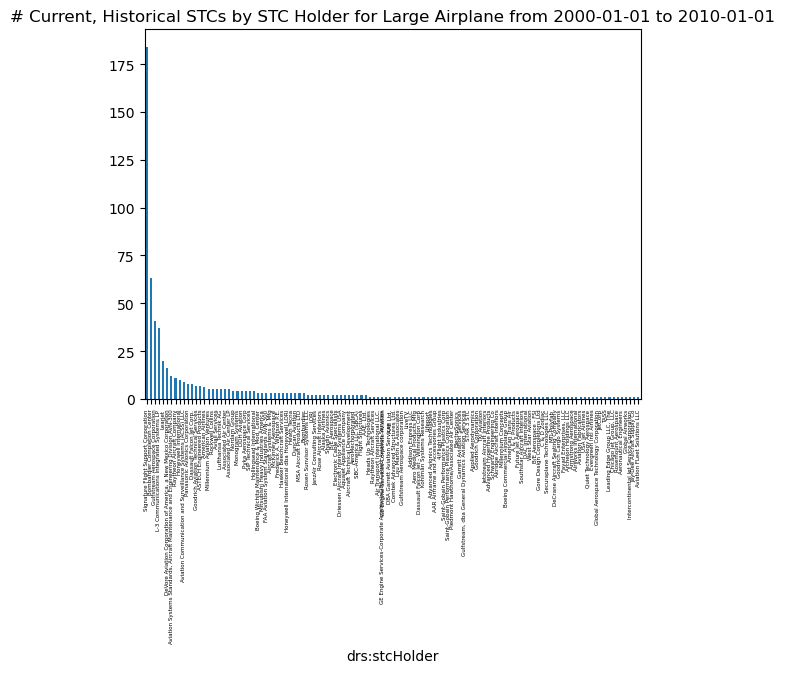

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


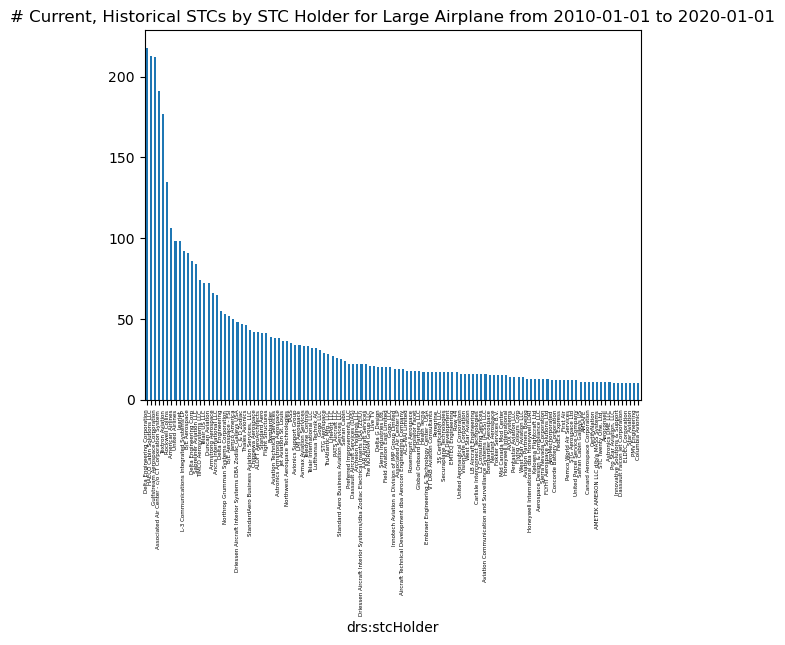

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


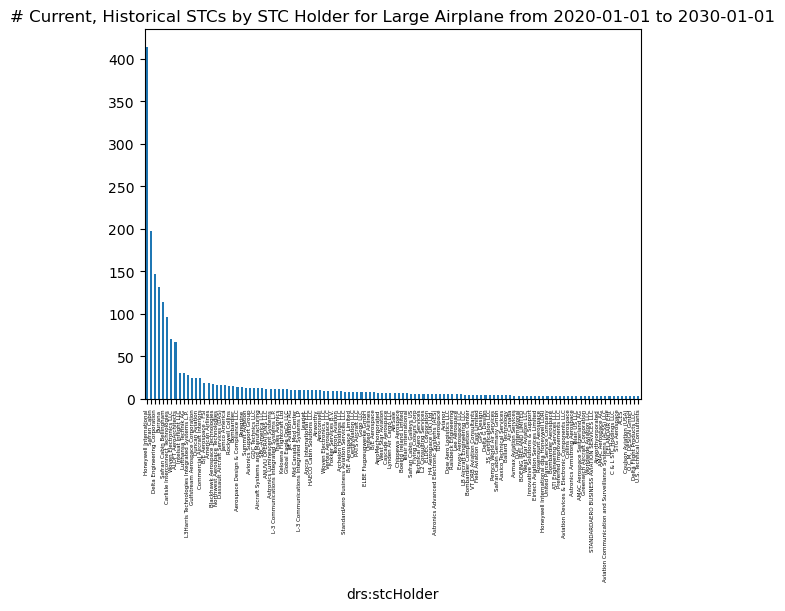

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


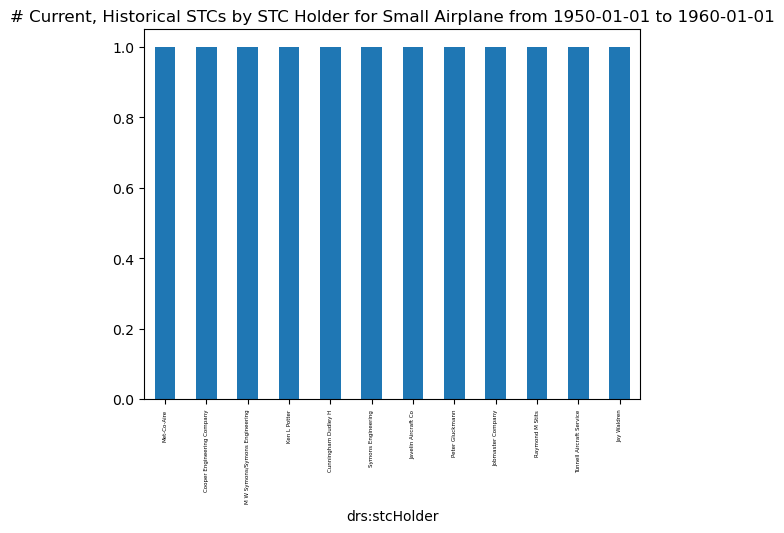

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


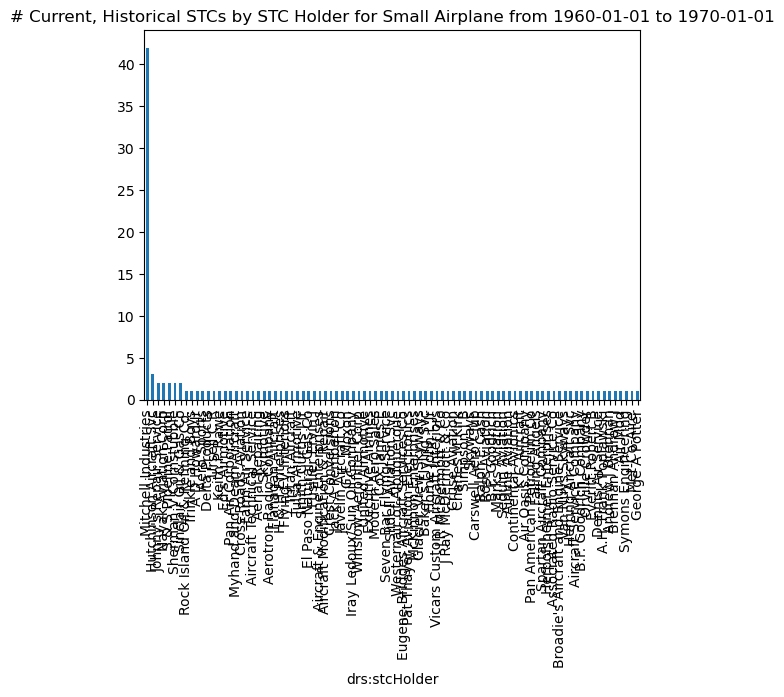

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


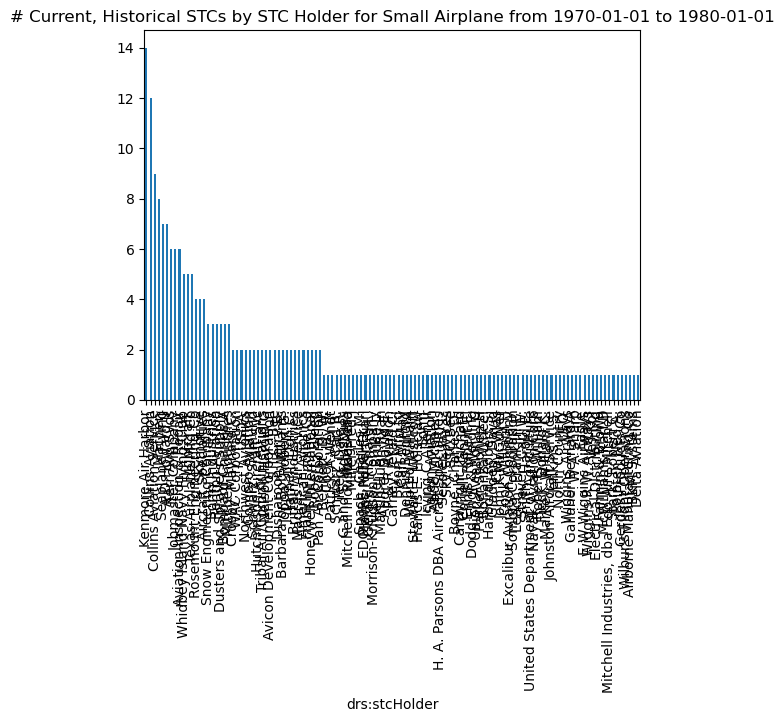

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


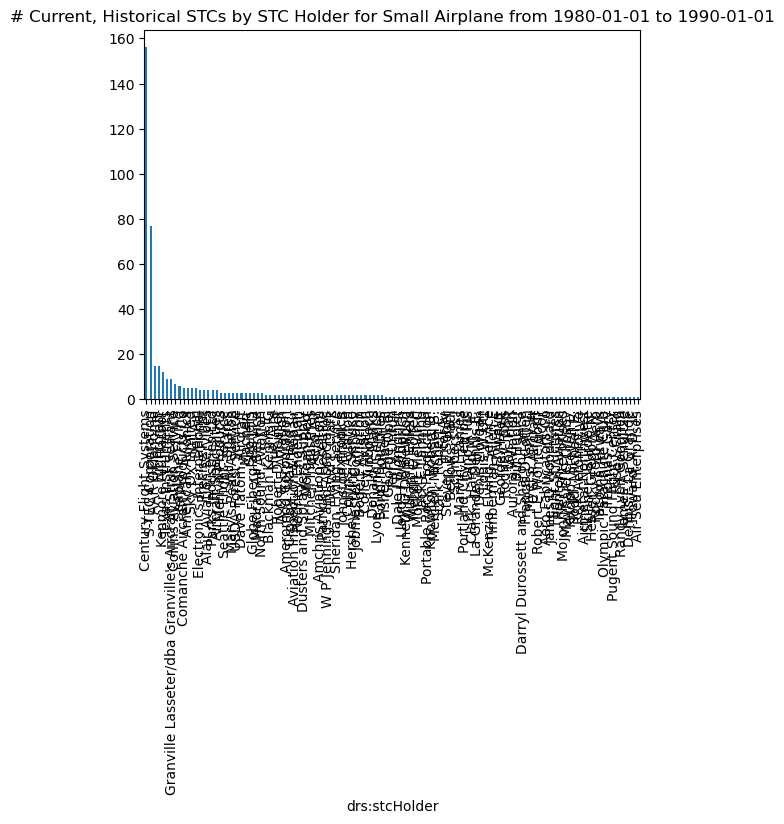

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


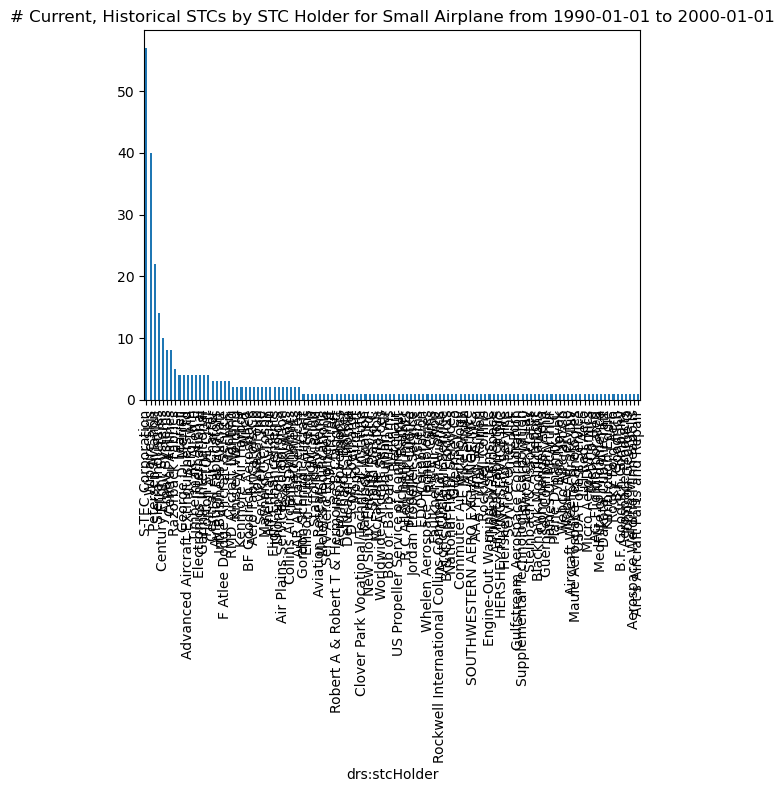

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


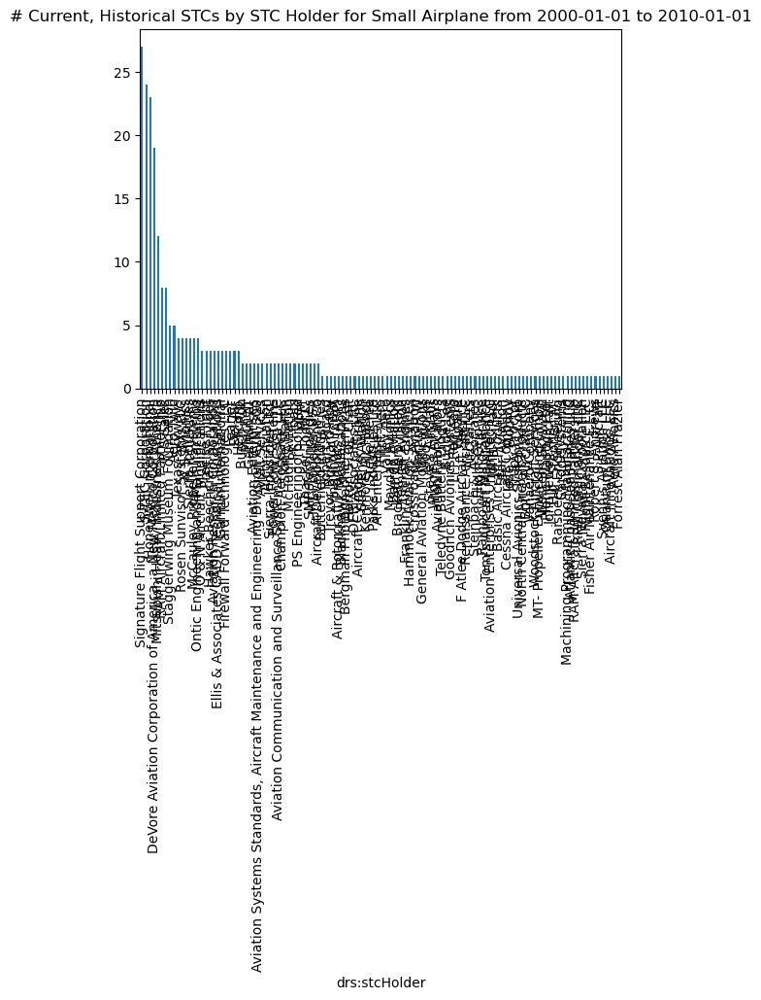

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


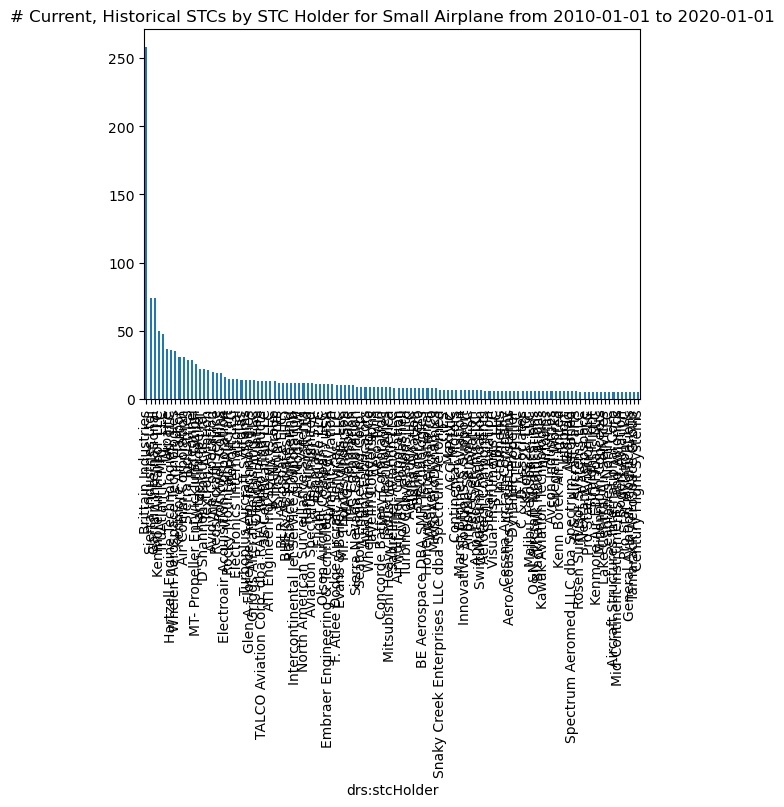

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


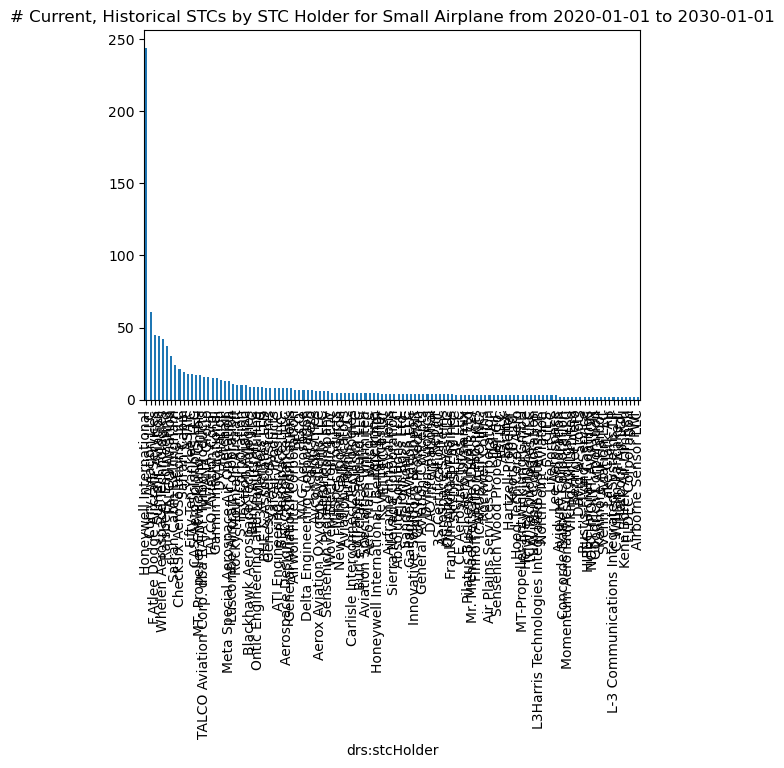

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


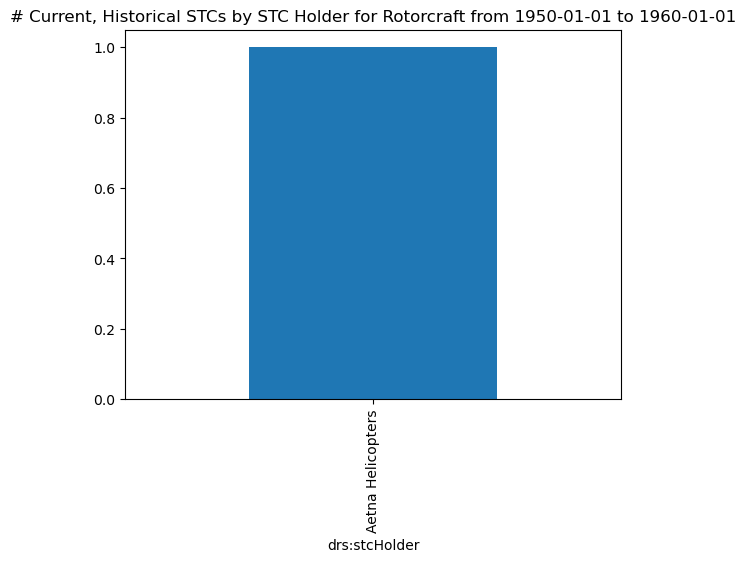

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


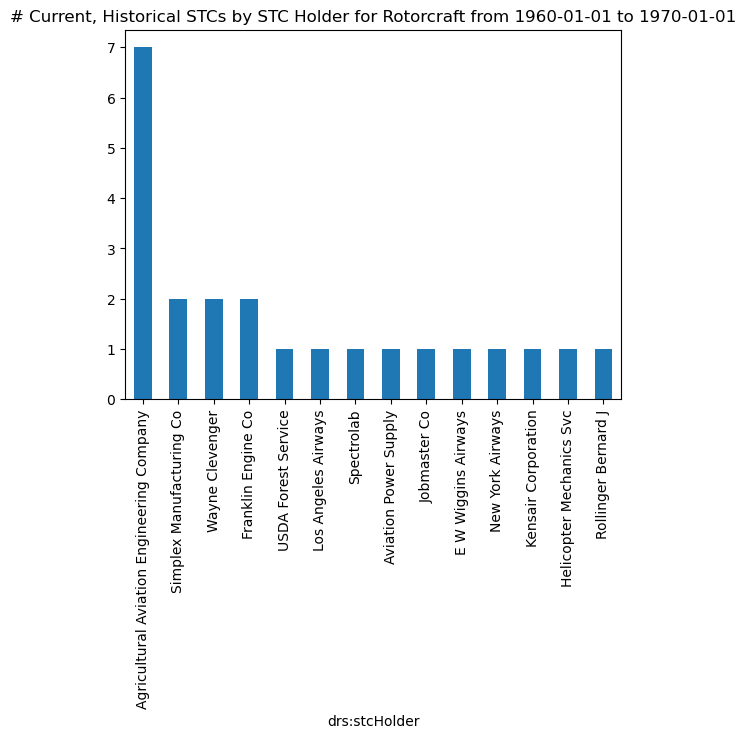

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


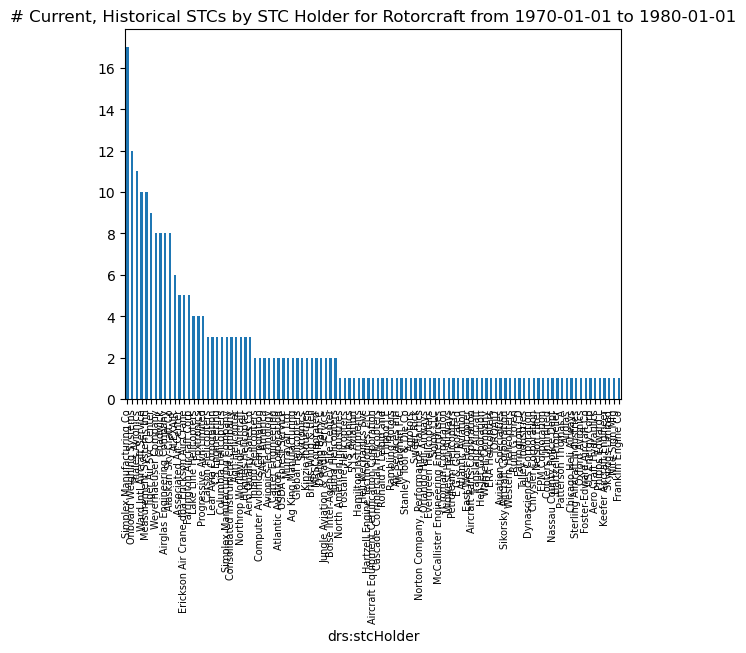

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


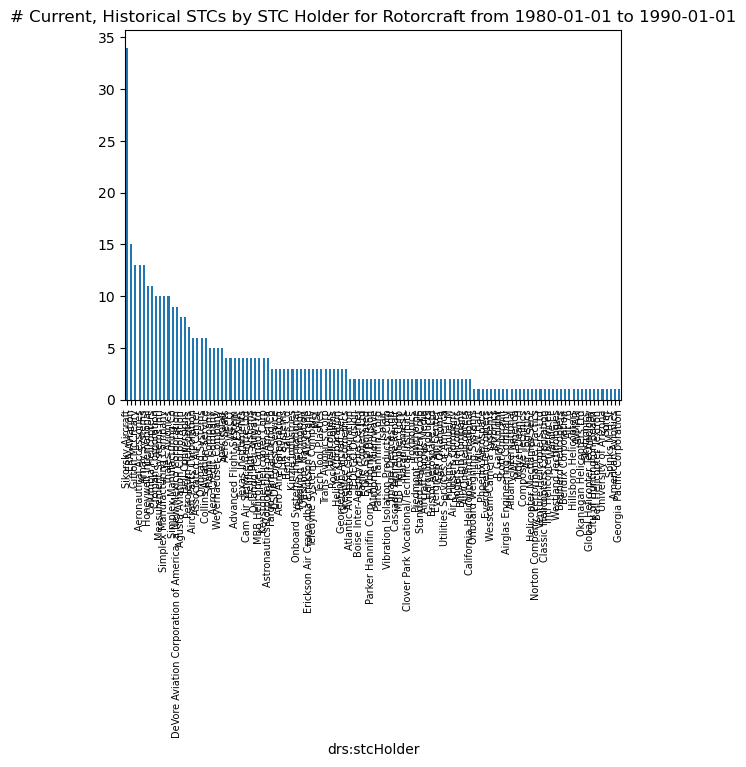

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


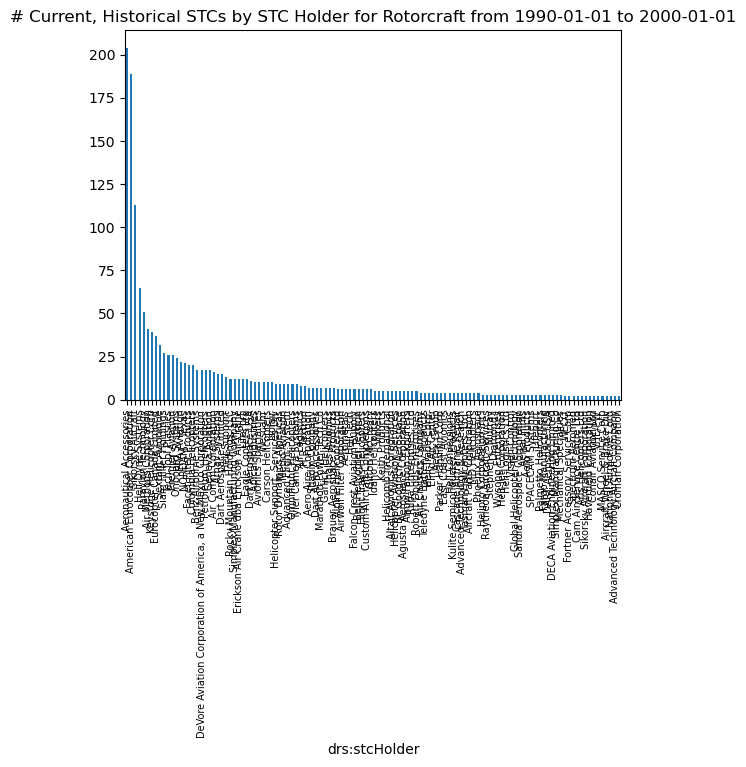

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


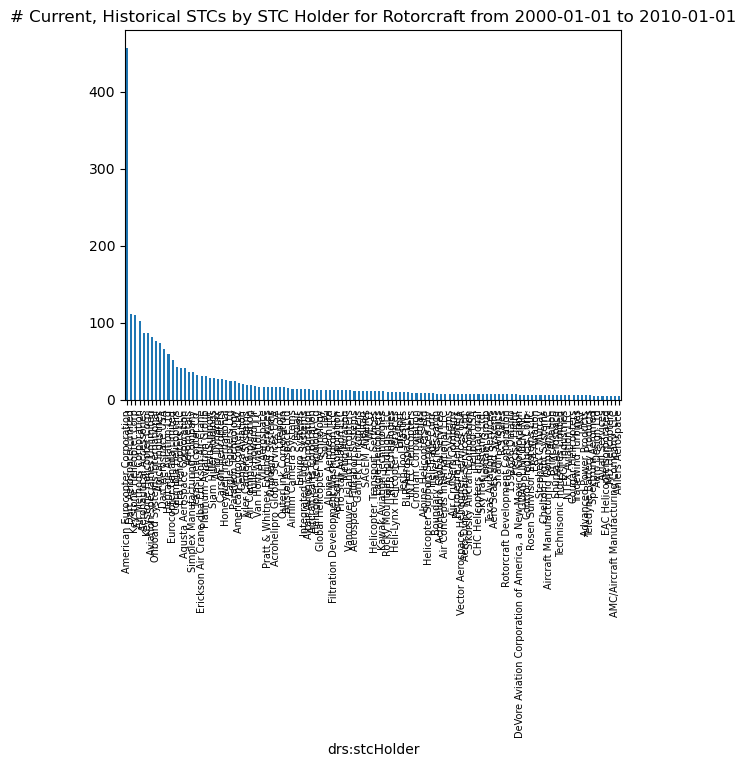

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


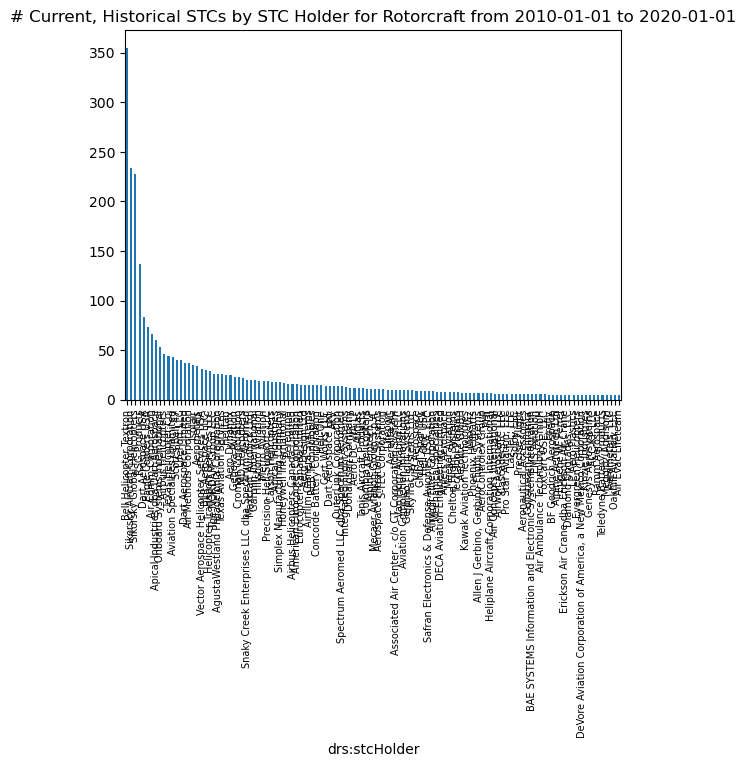

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


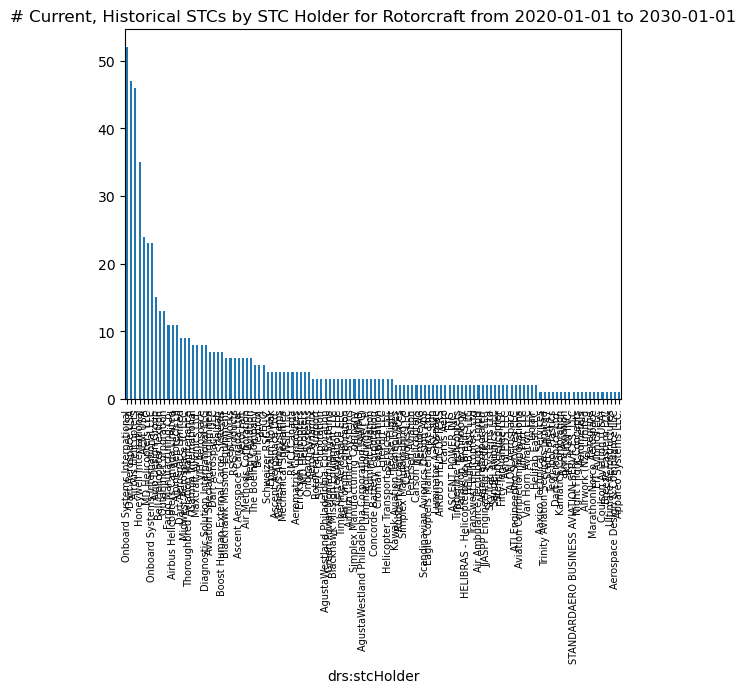

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


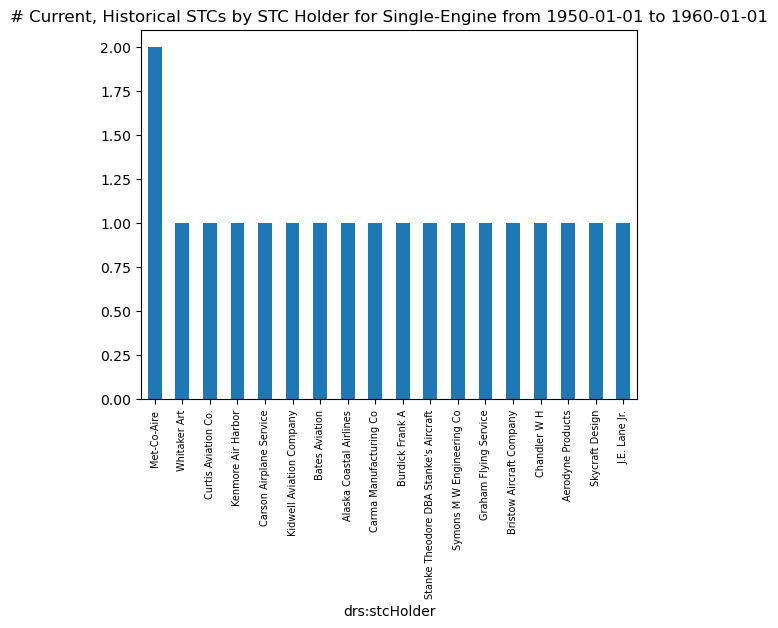

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


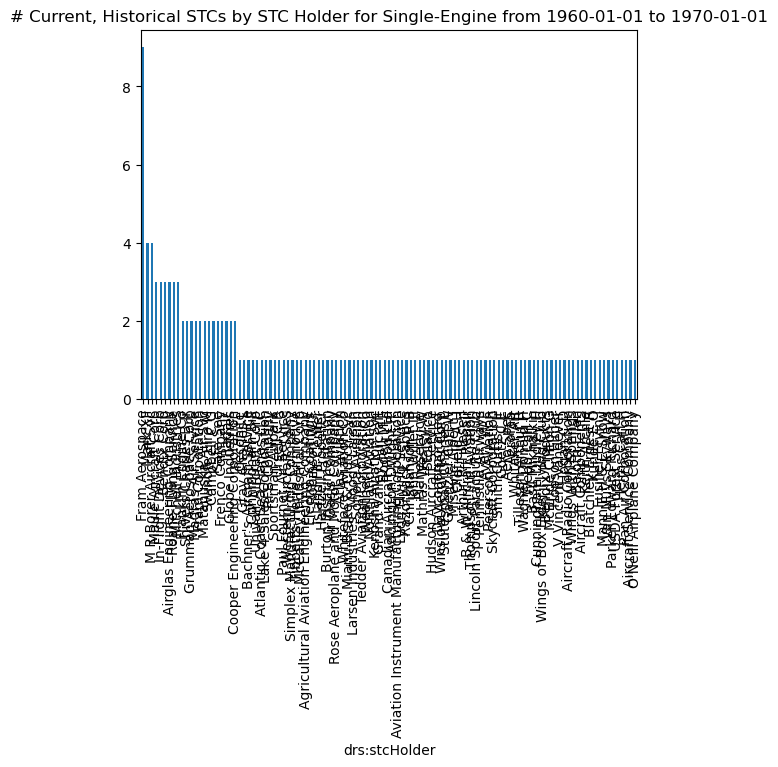

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


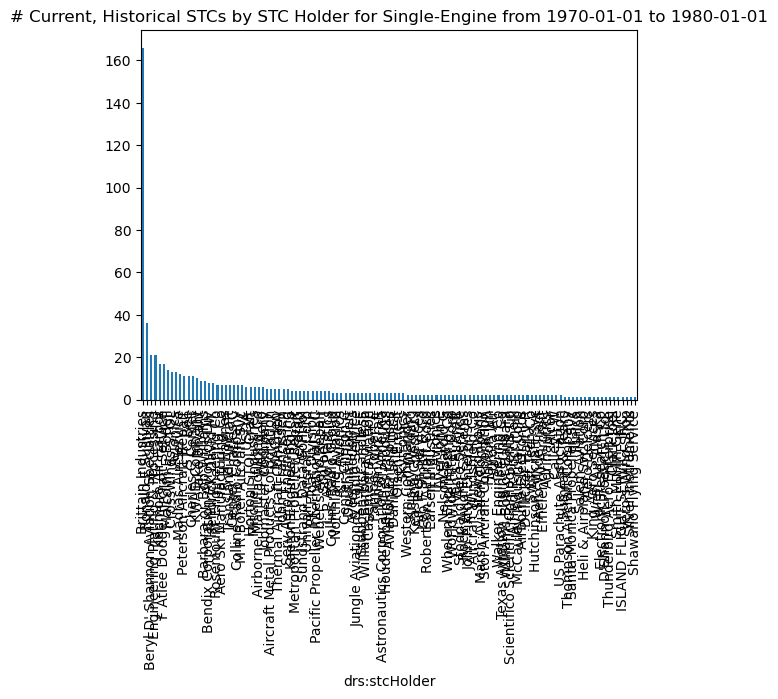

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


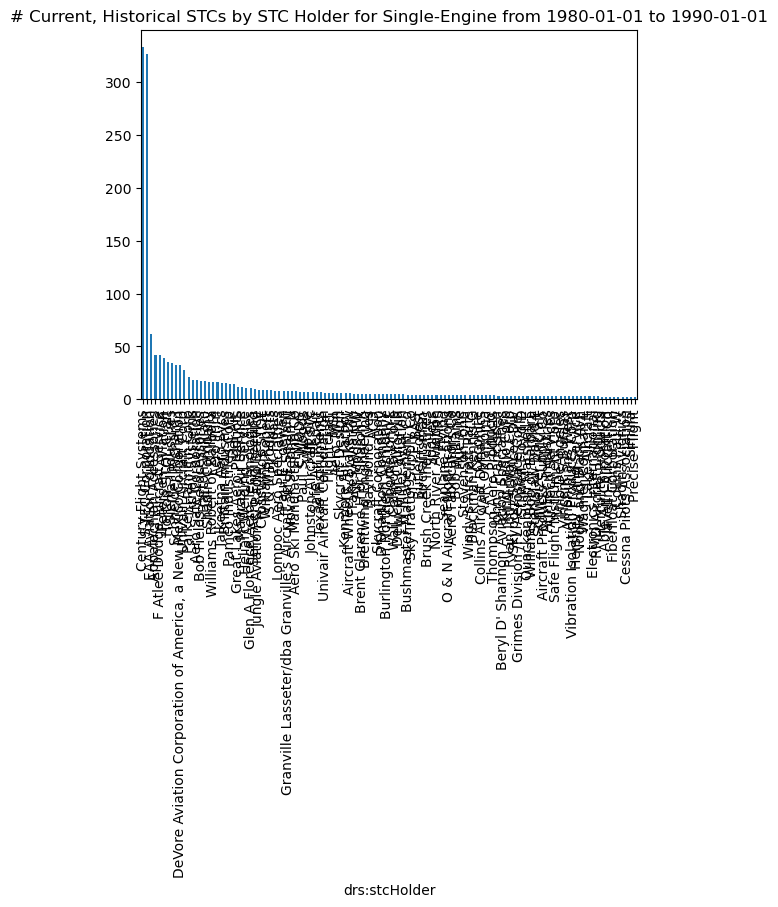

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


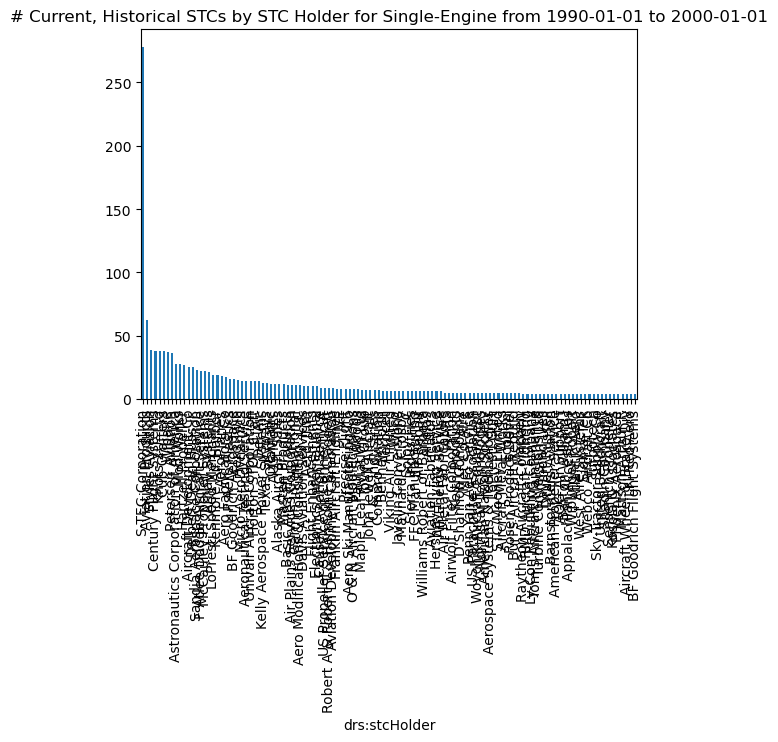

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


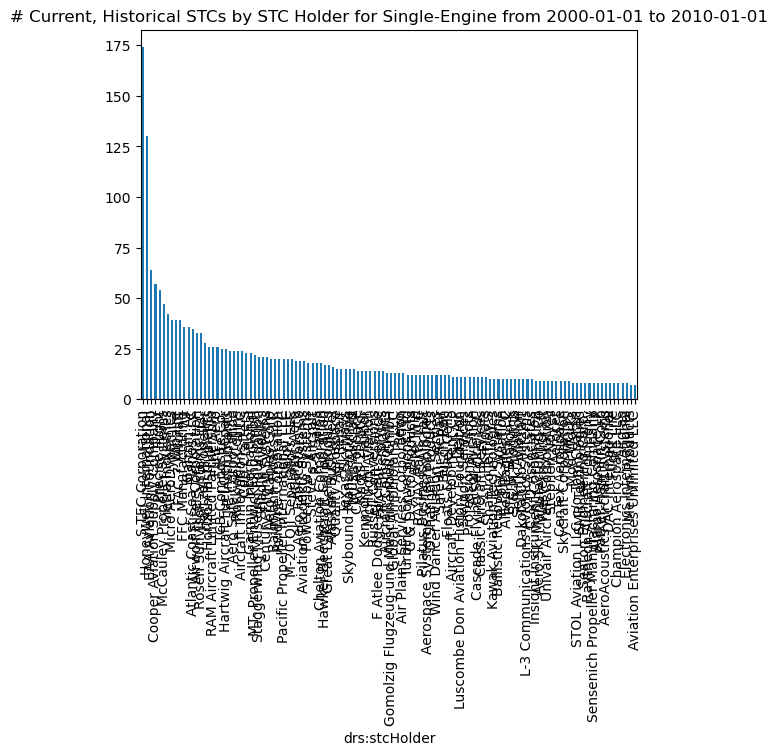

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


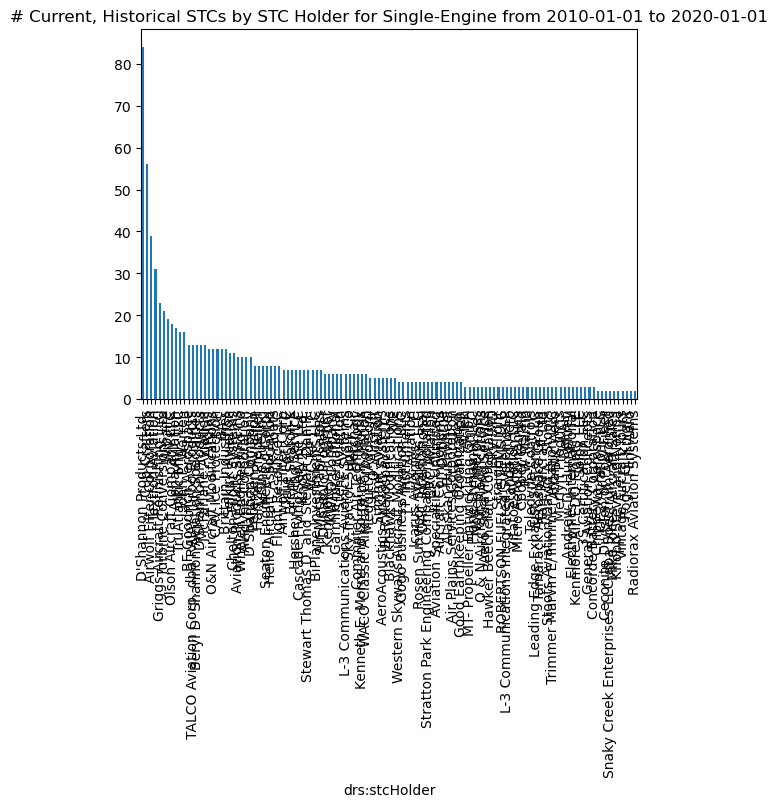

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


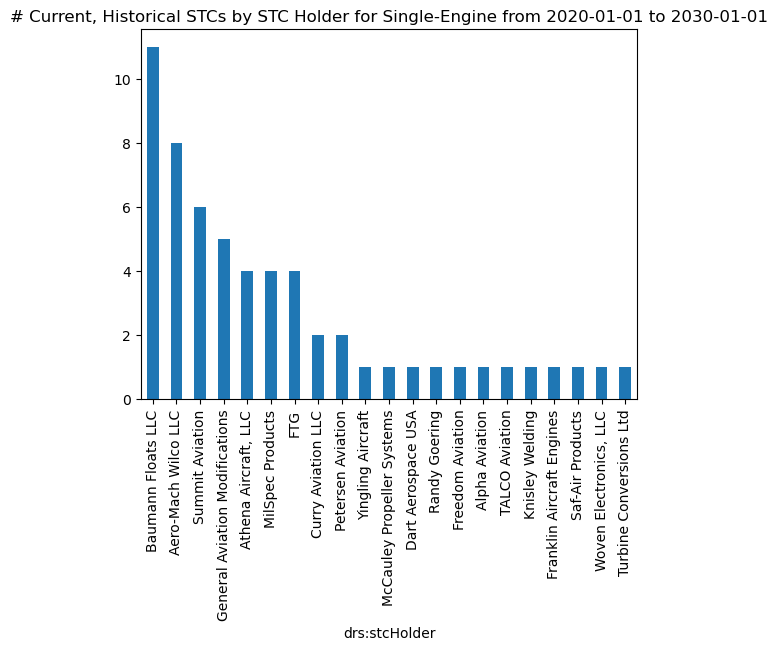

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


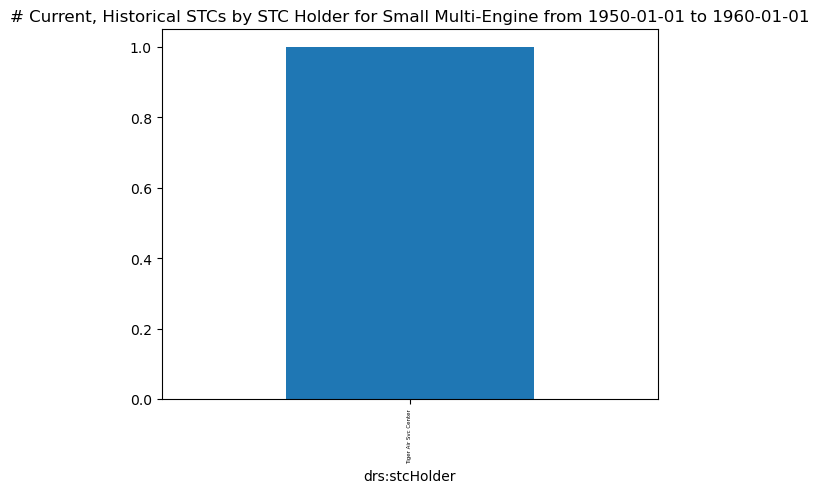

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


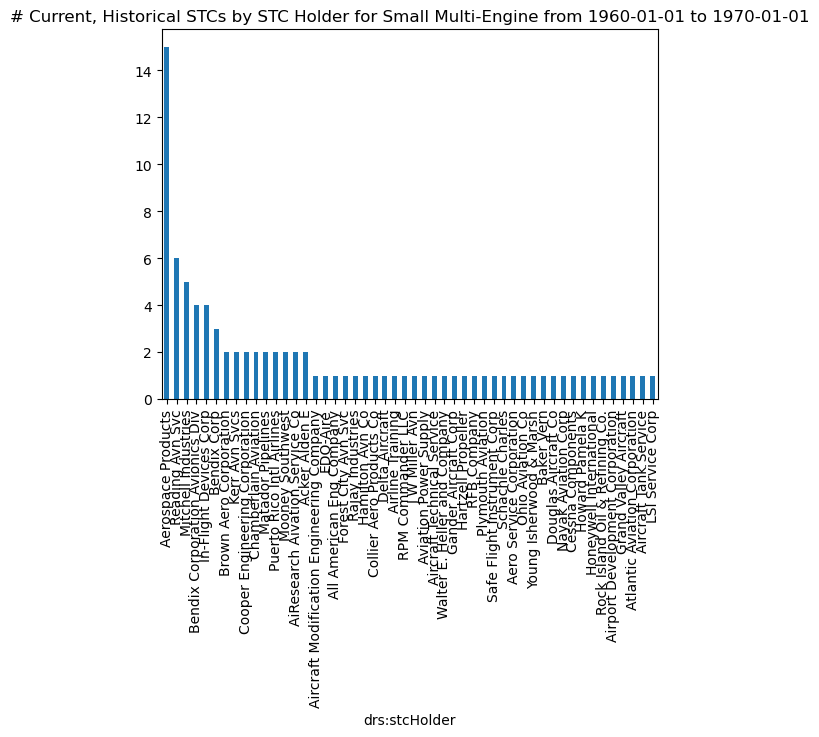

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


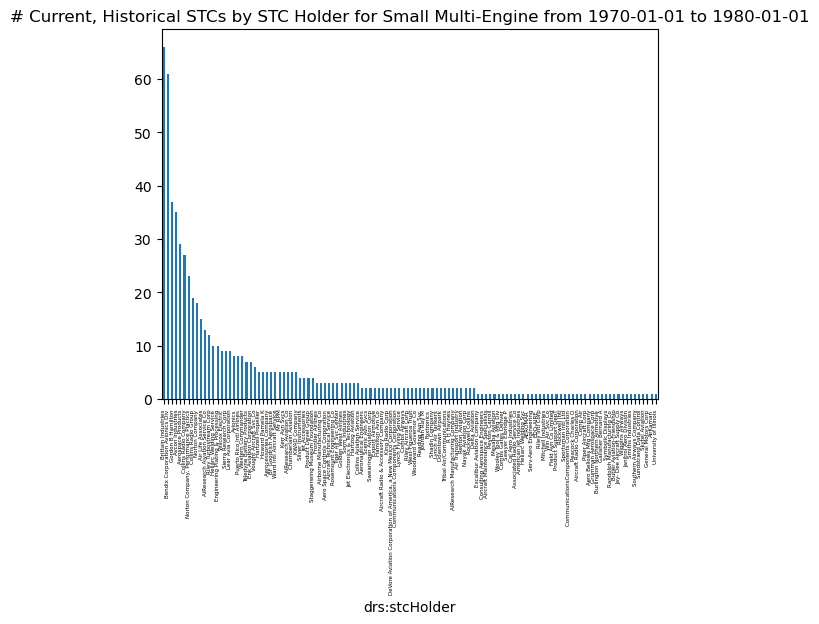

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


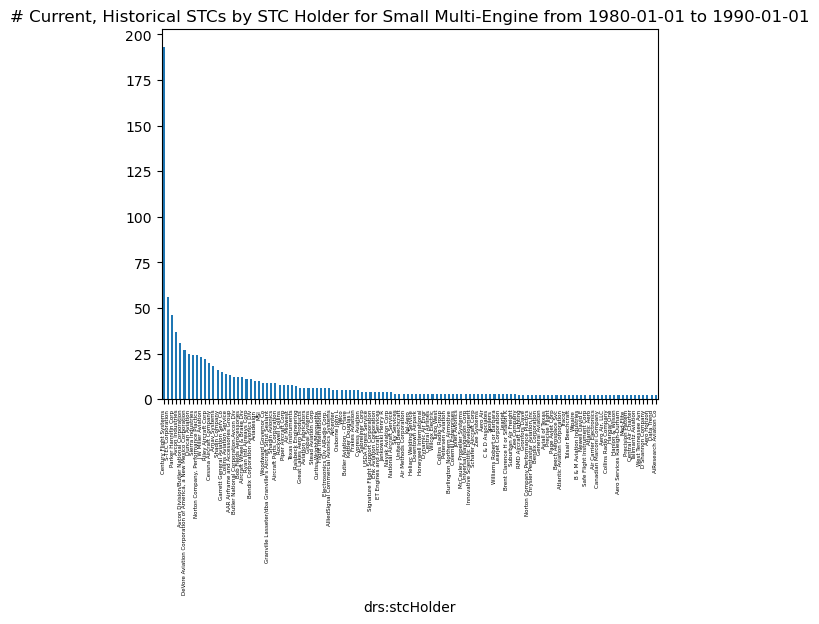

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


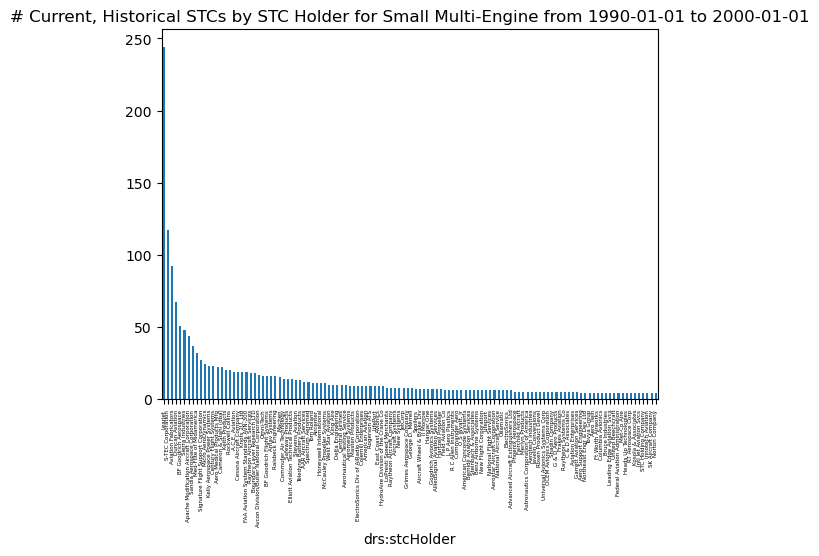

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


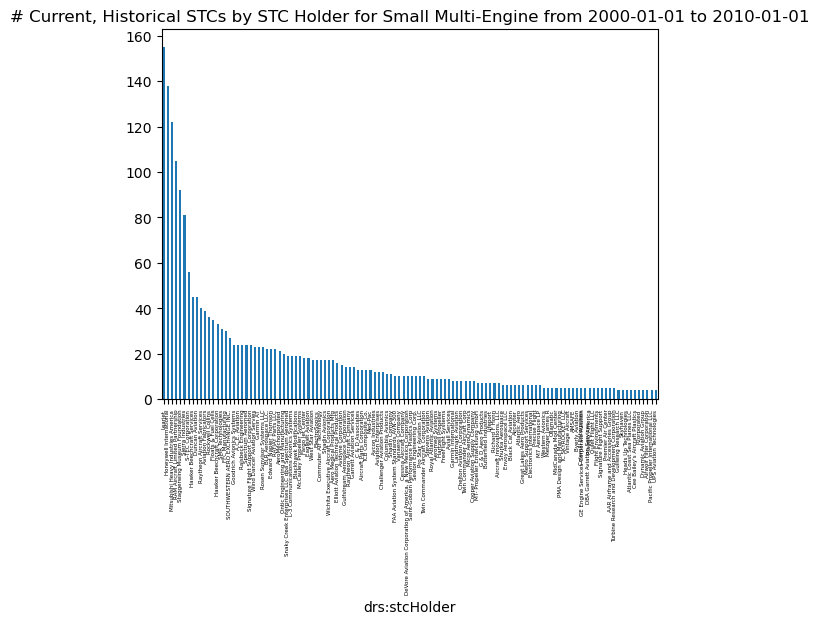

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


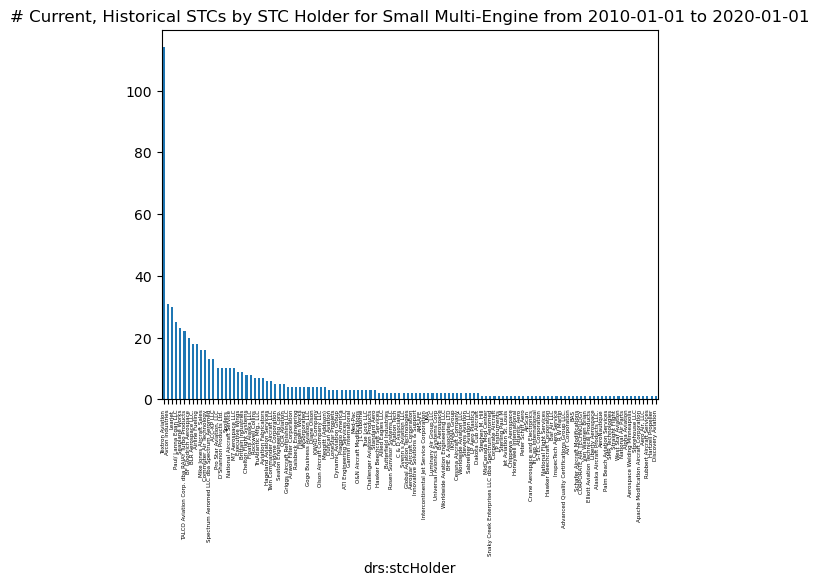

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


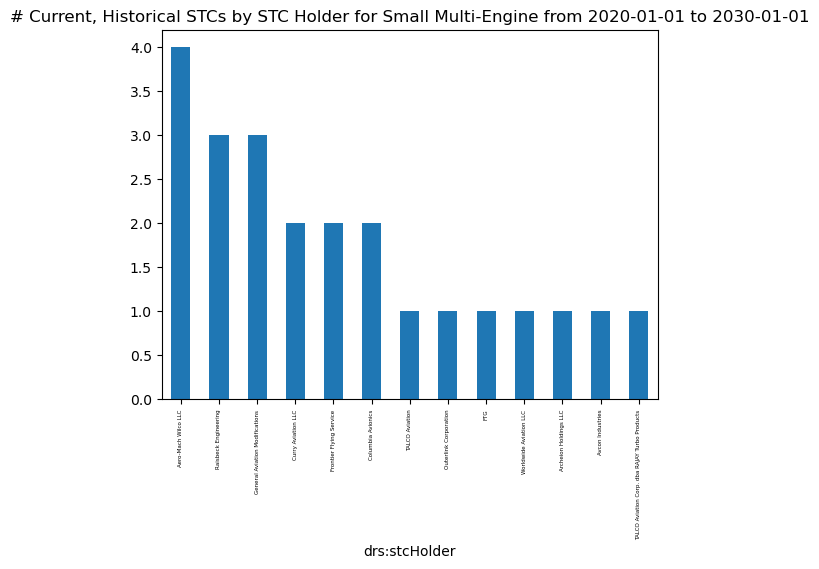

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


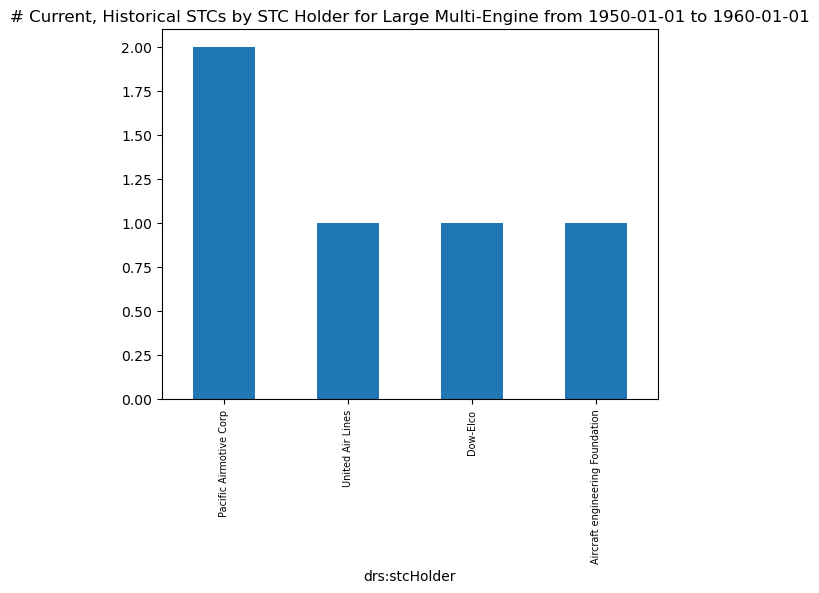

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


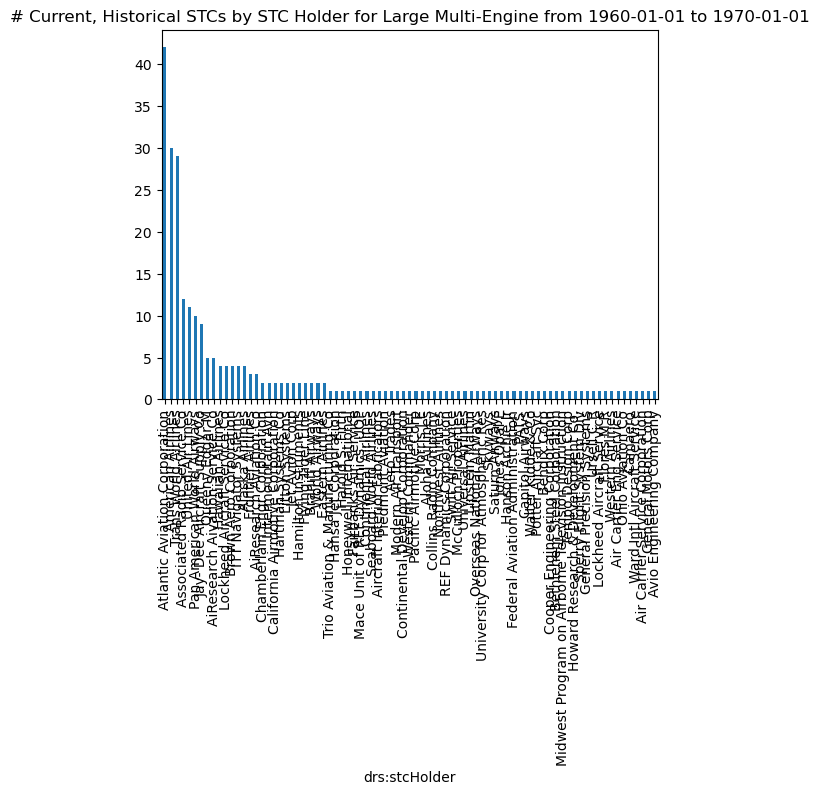

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


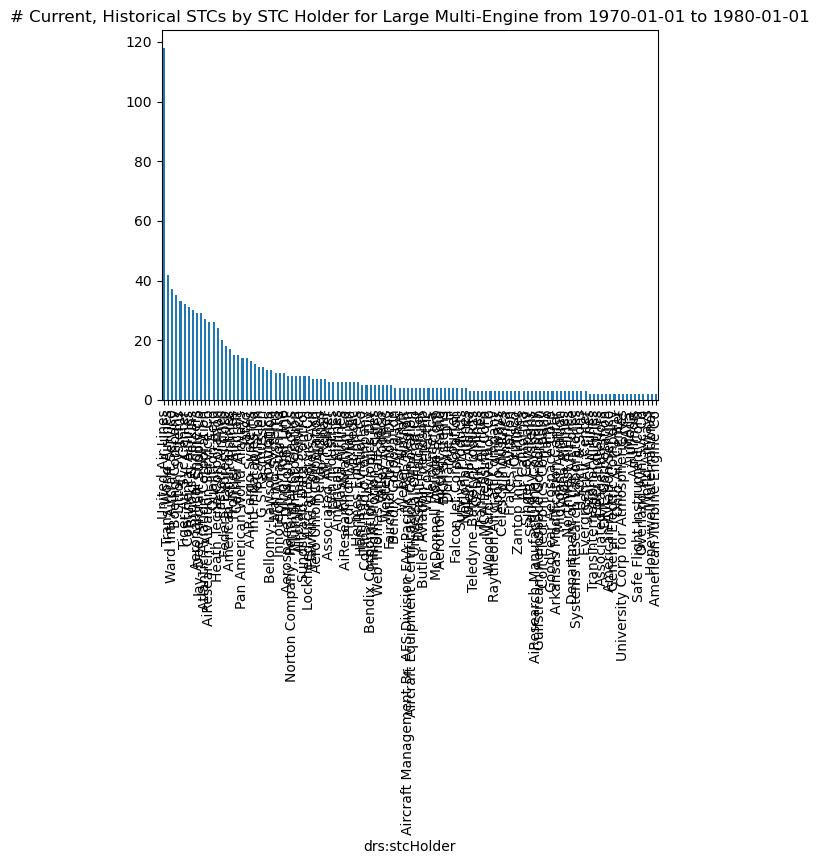

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


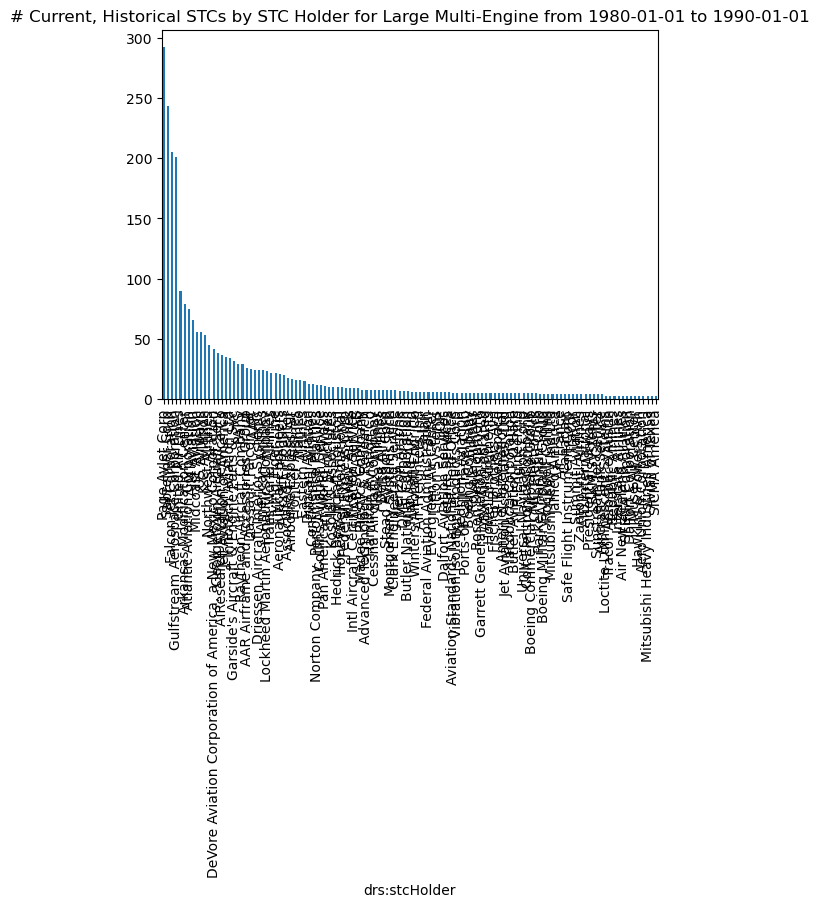

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


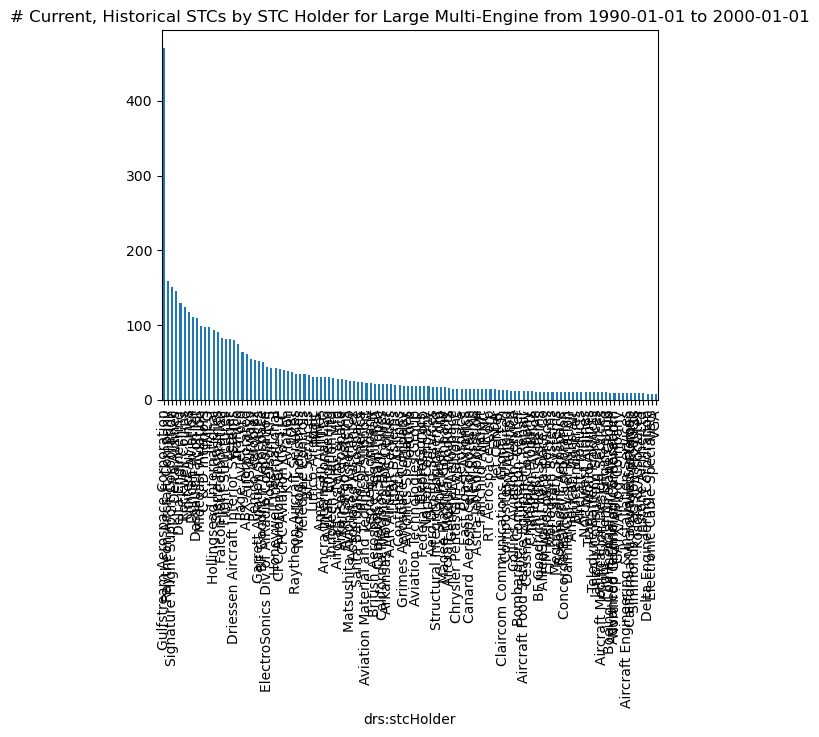

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


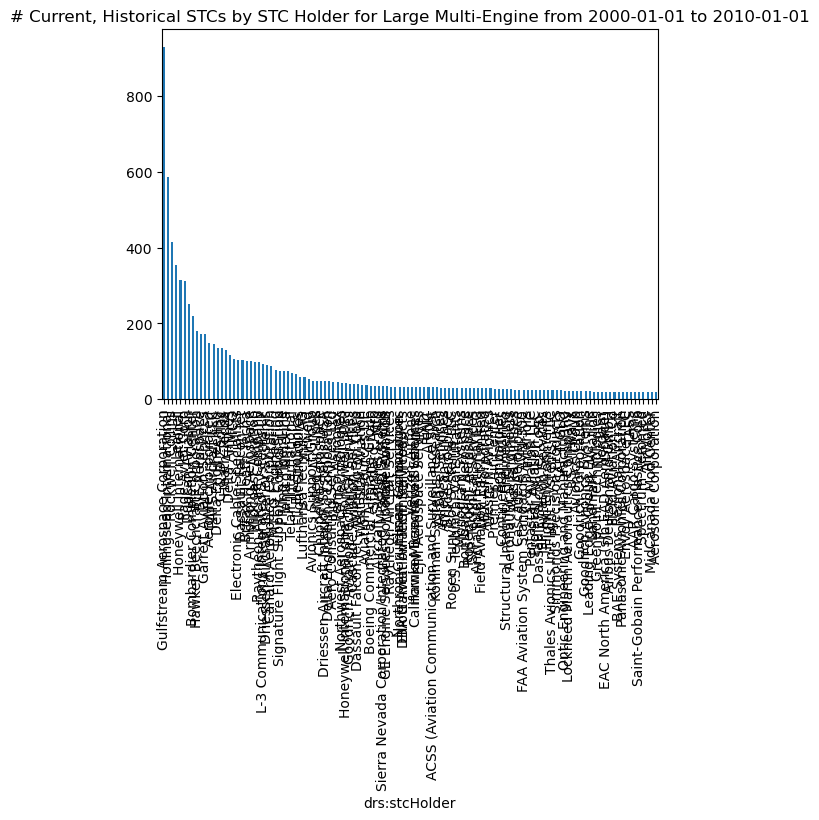

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


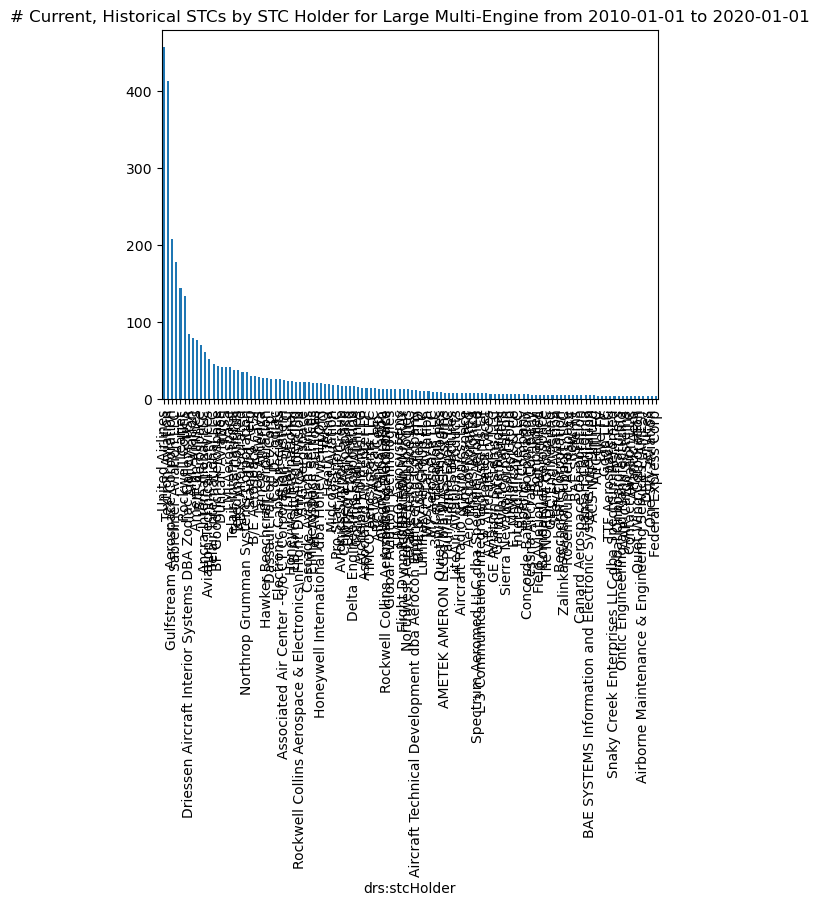

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


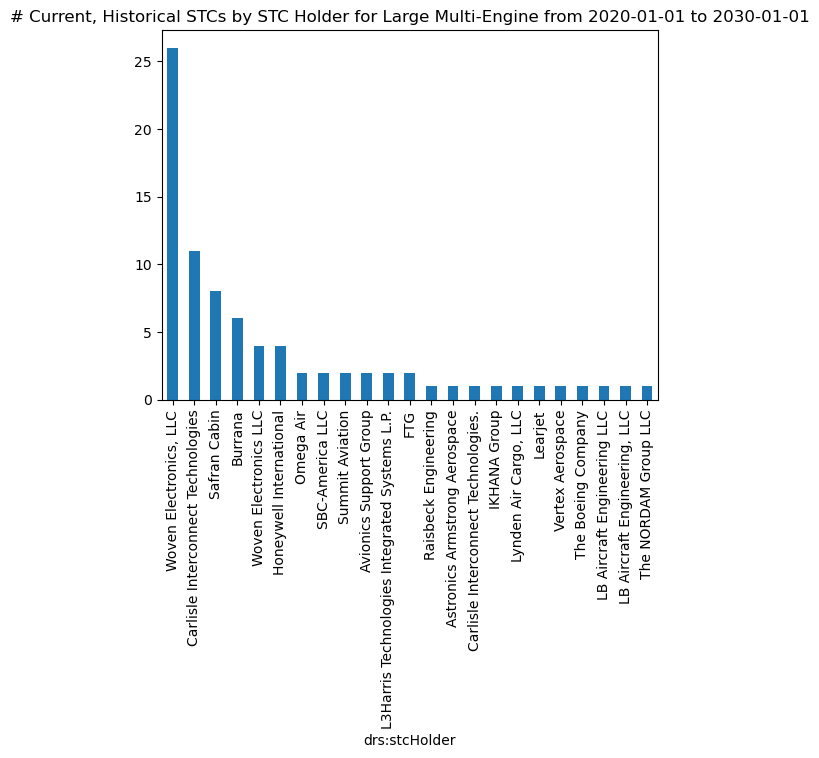

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: Setti

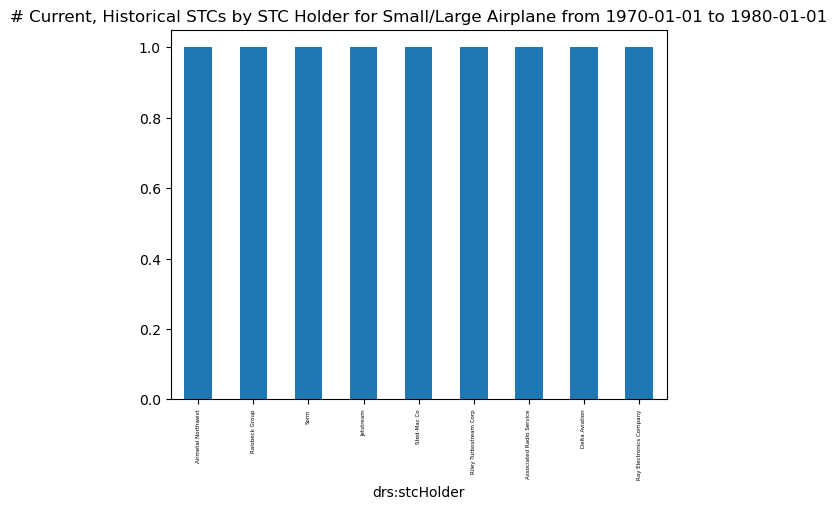

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


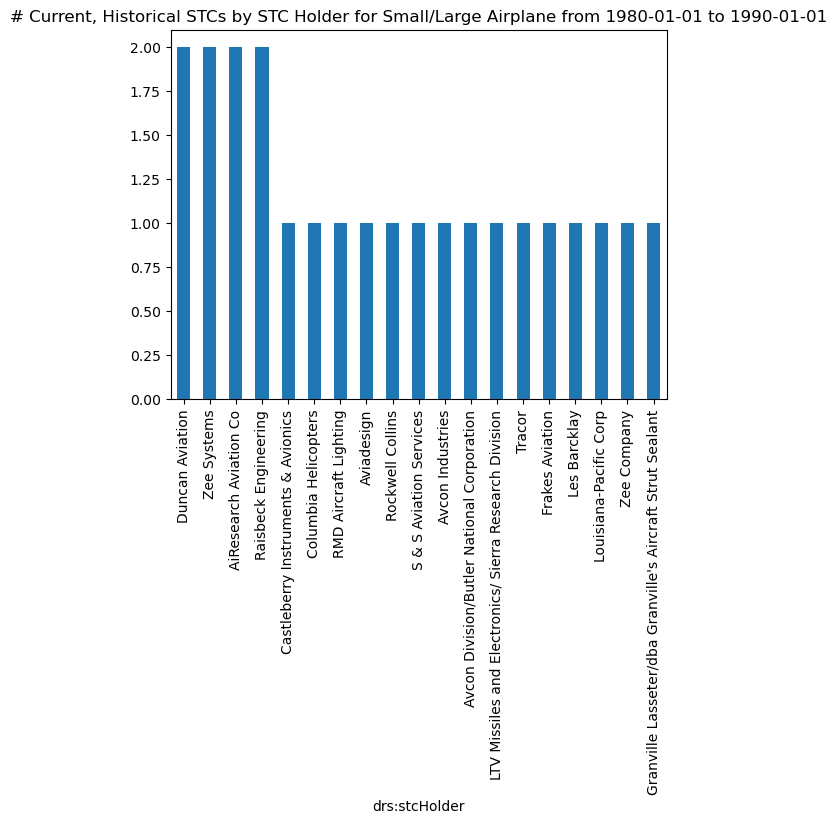

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


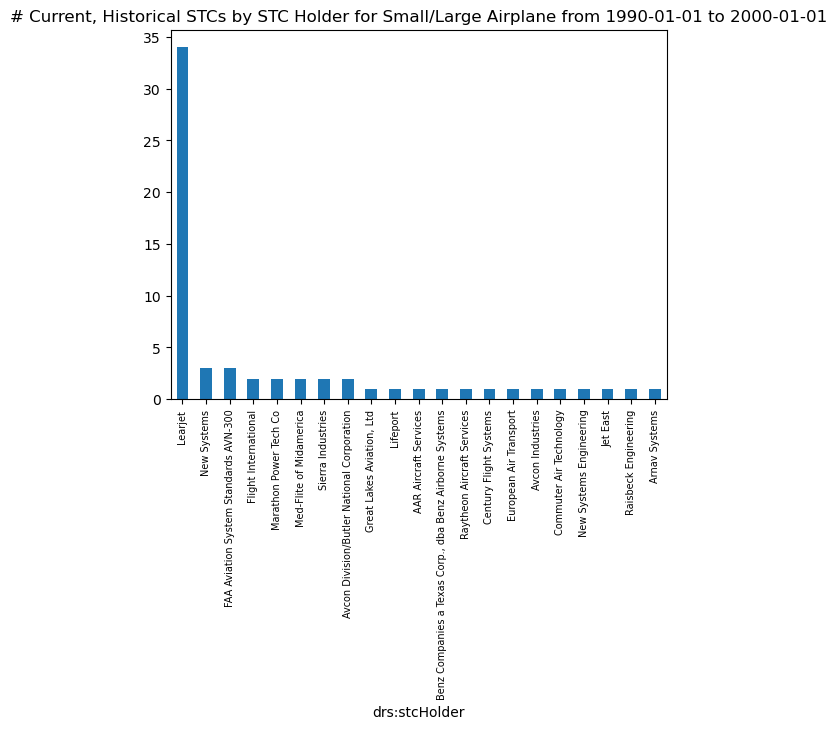

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


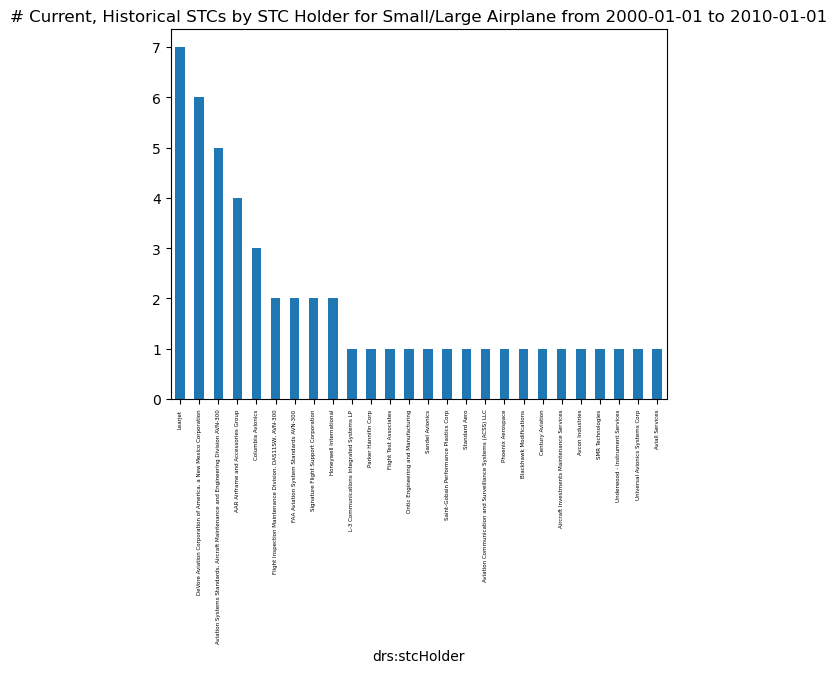

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


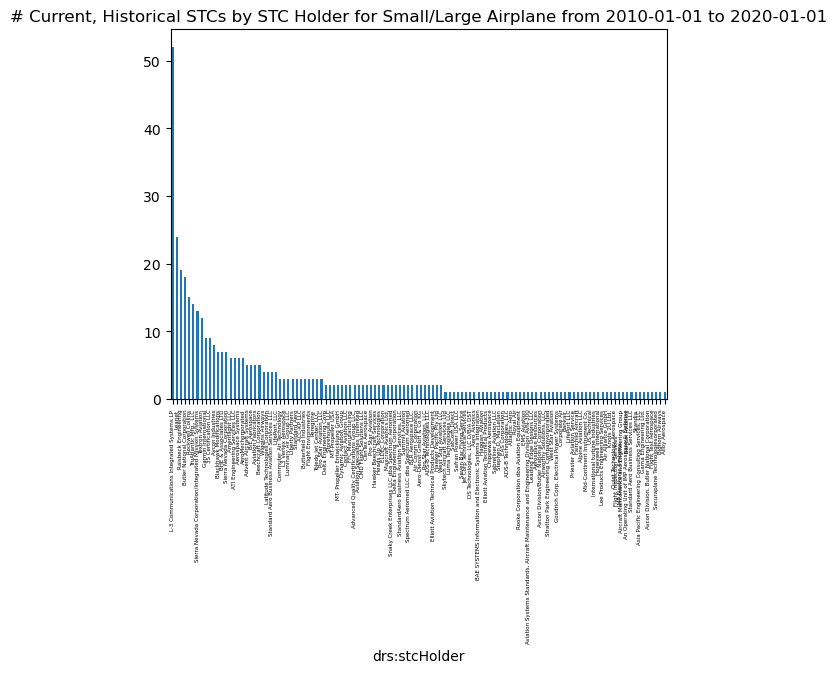

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


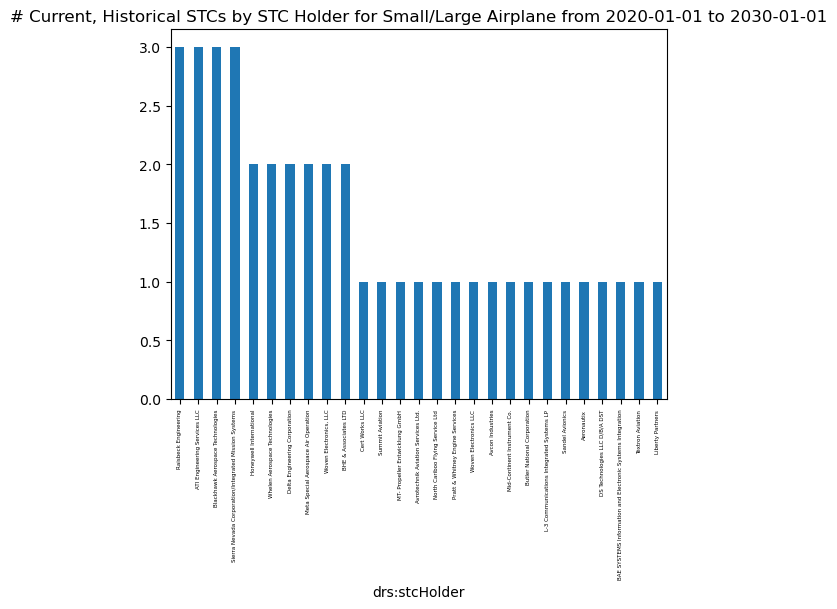

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: Setti

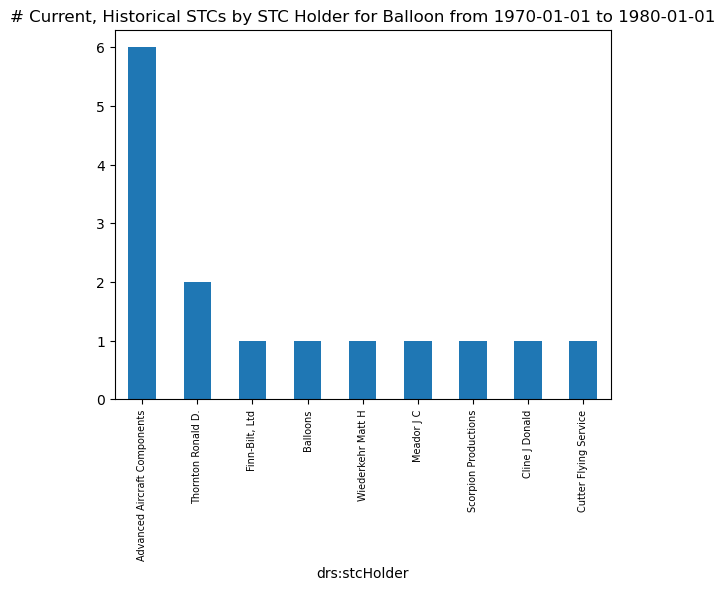

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


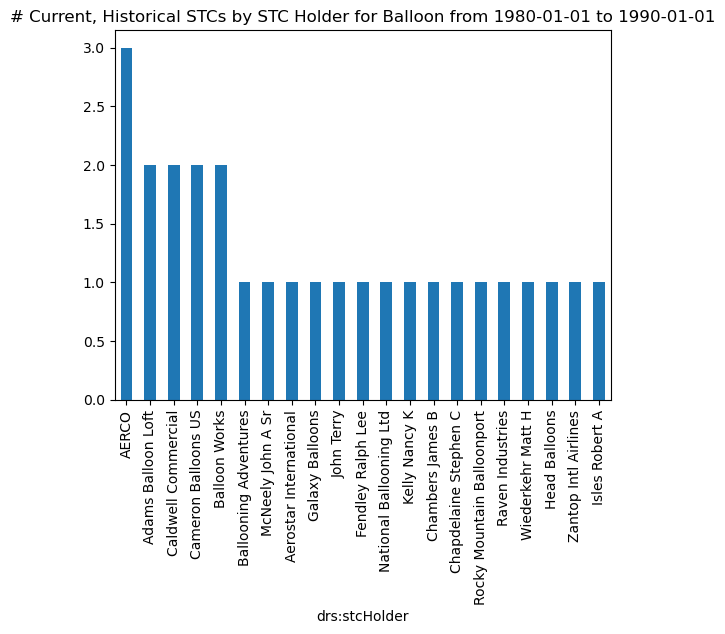

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


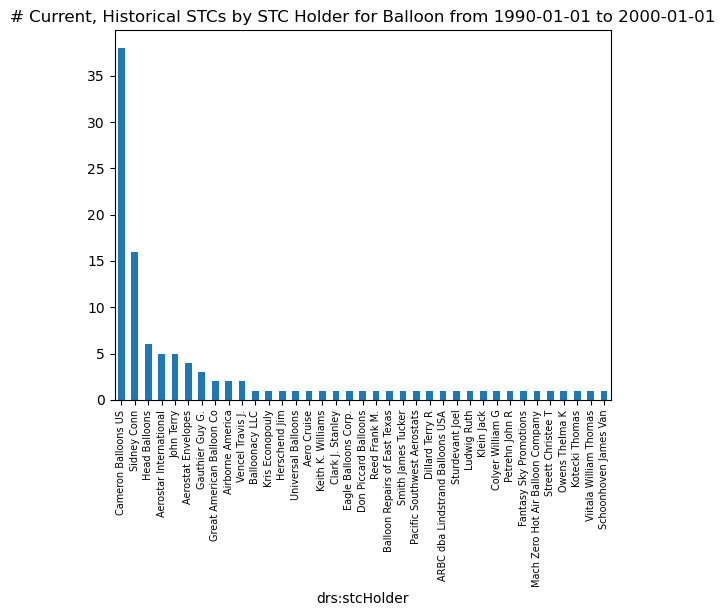

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


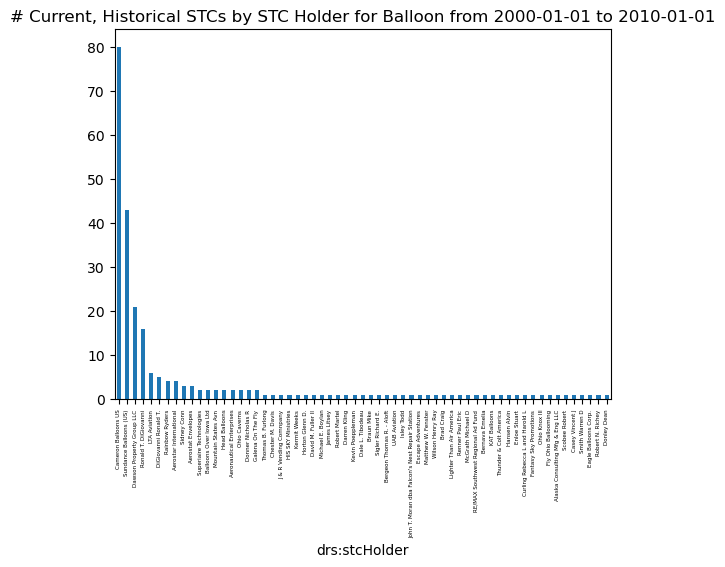

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


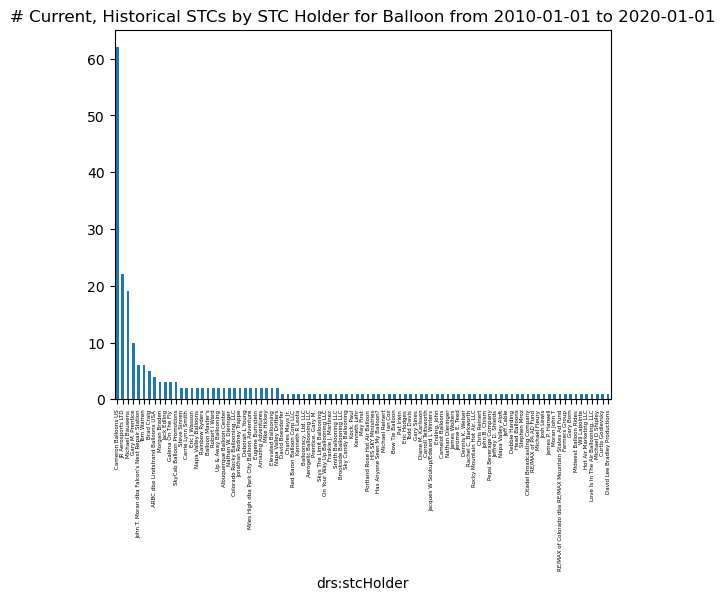

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


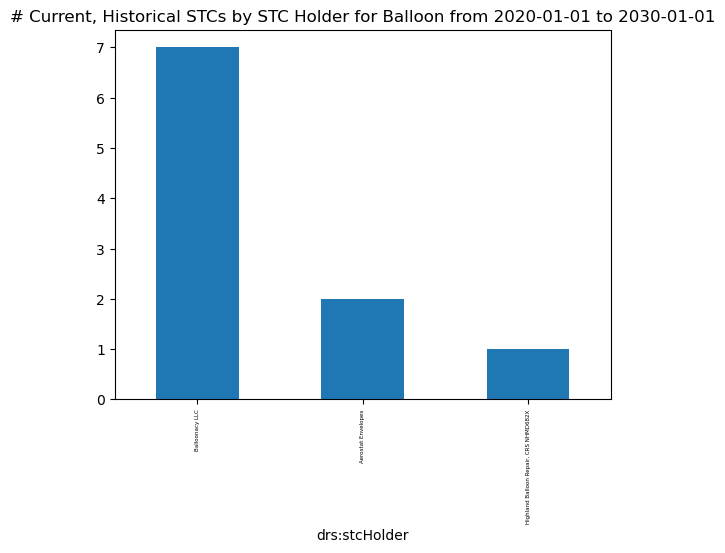

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: Setti

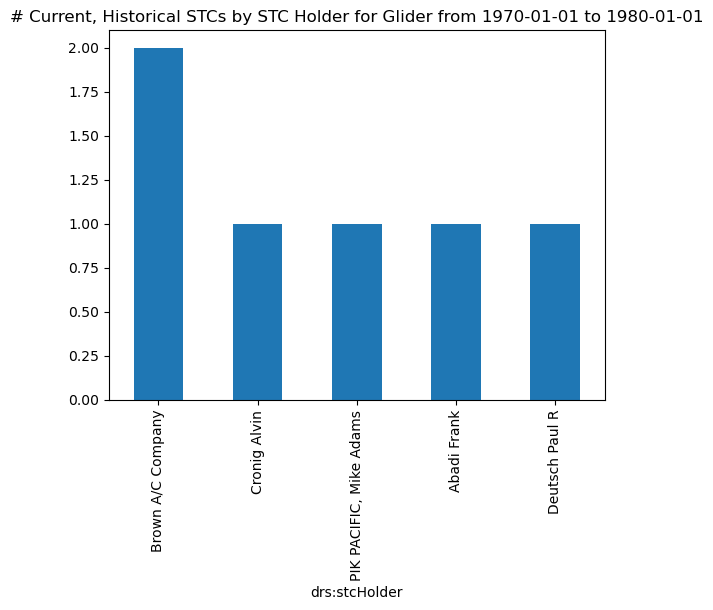

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


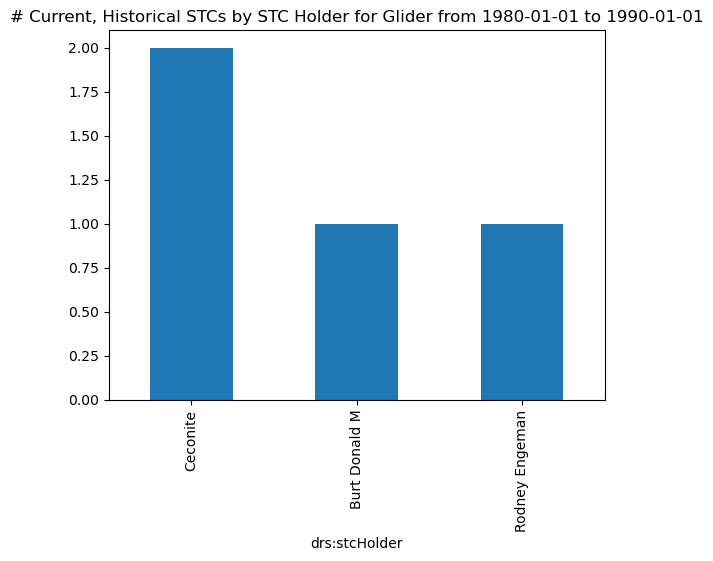

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


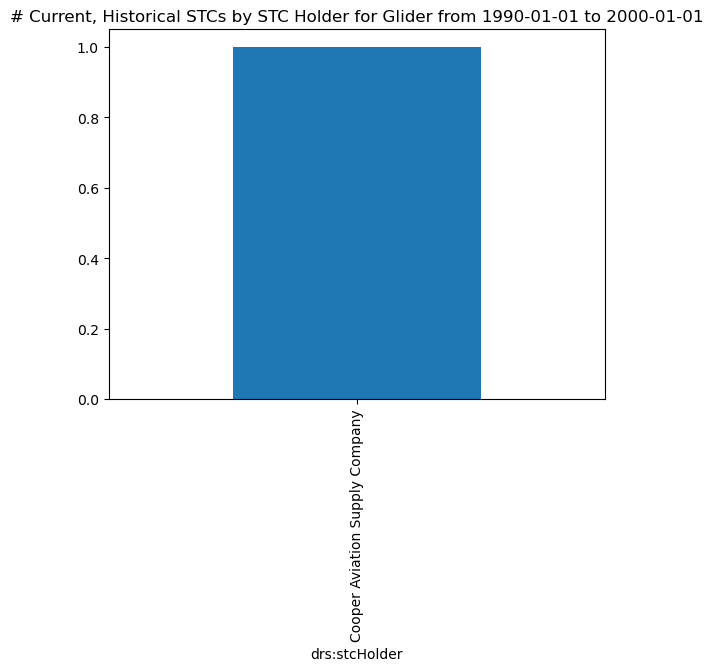

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


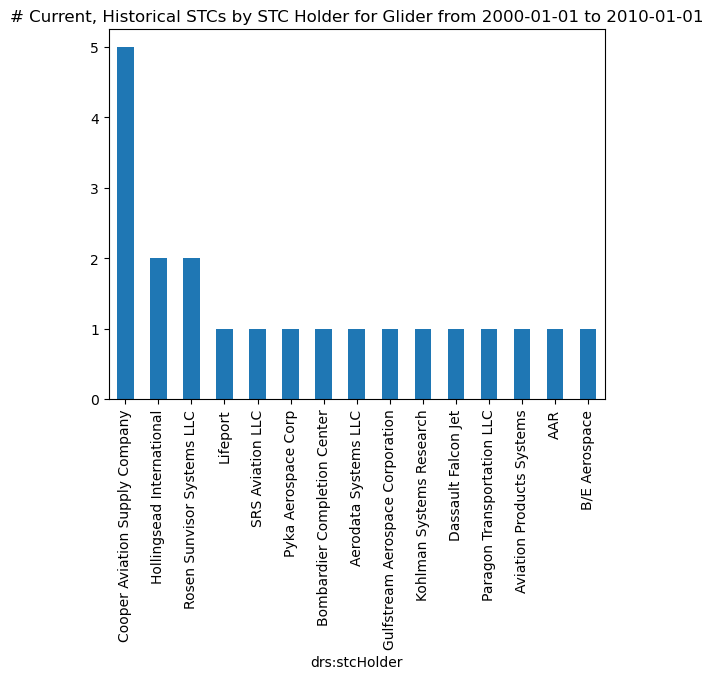

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


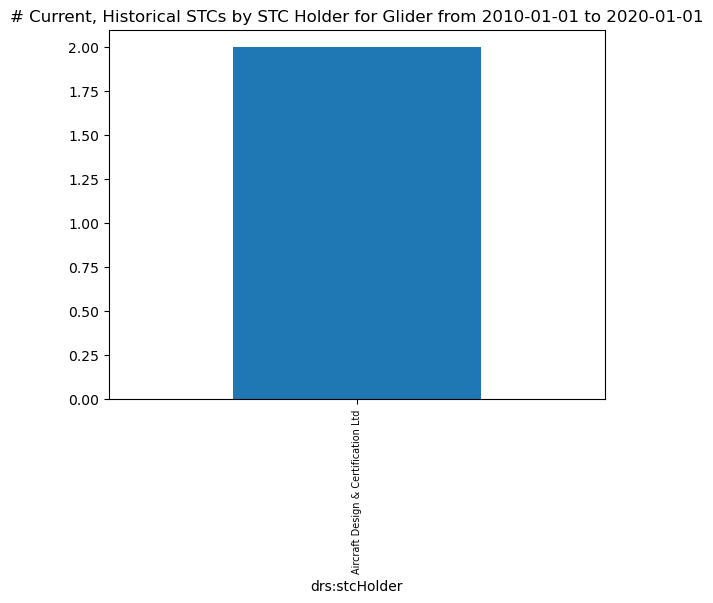

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


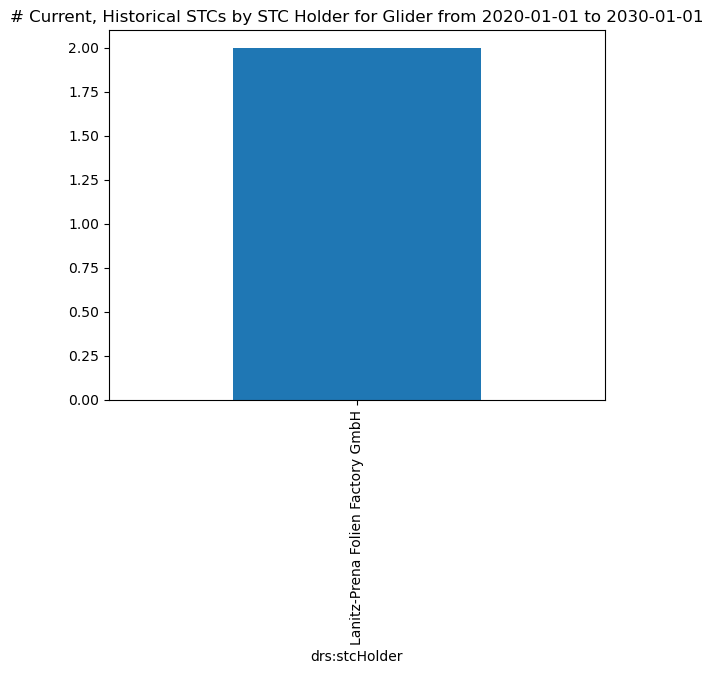

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: Setti

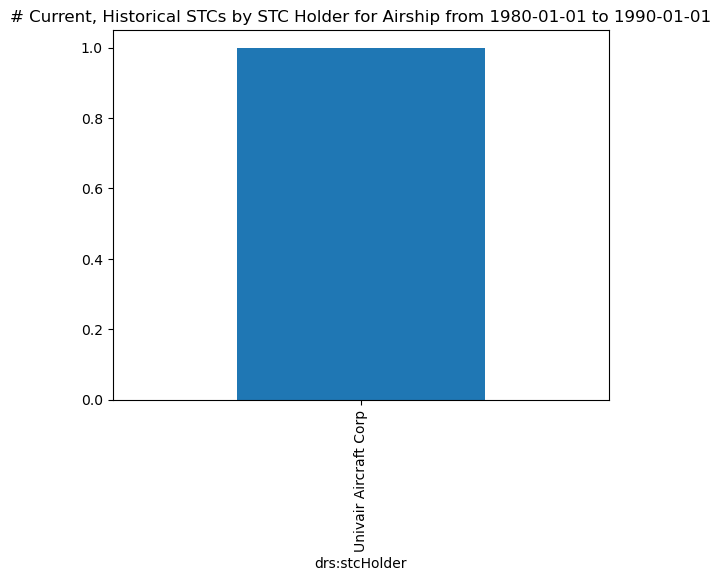

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


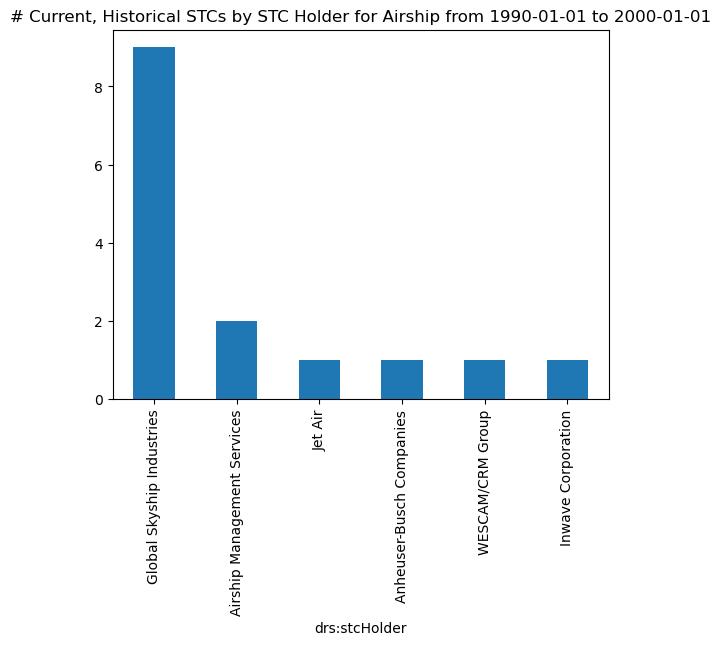

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


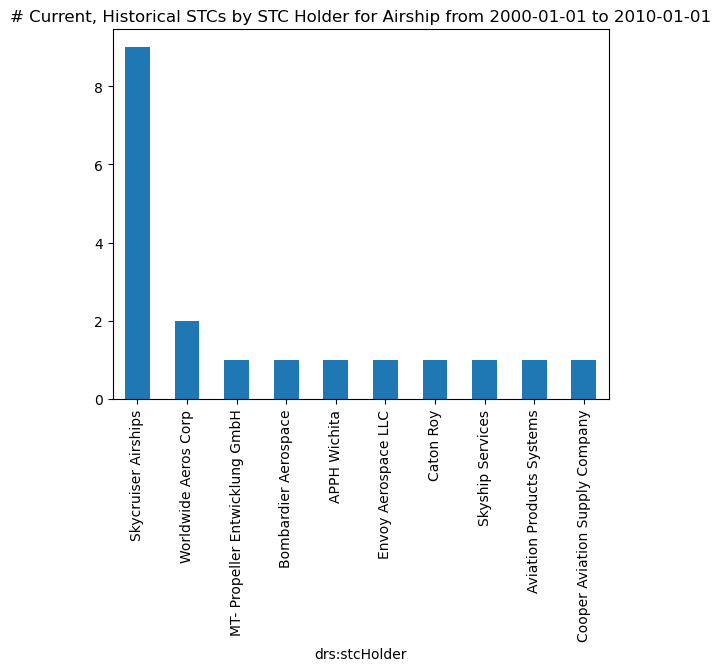

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


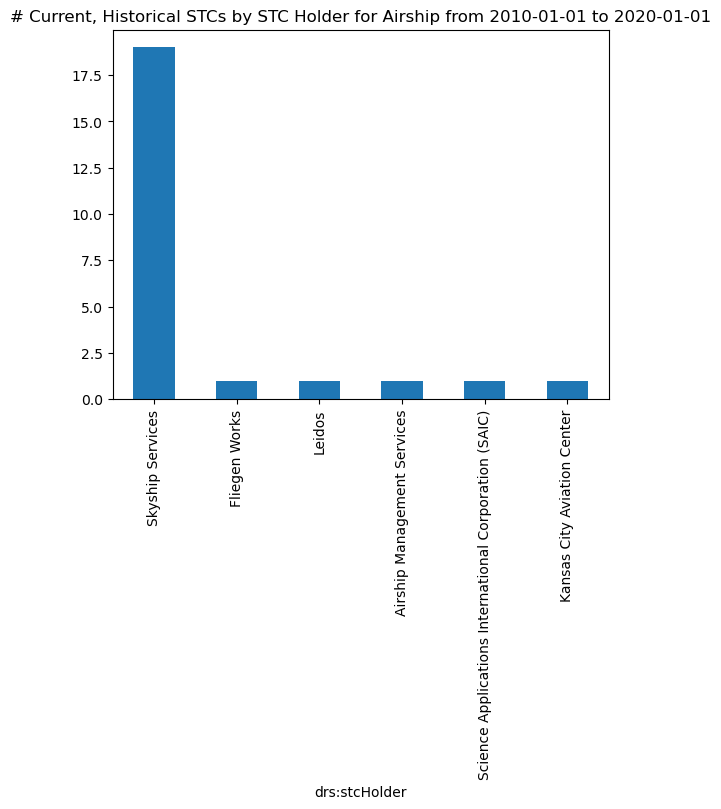

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:21: UserW

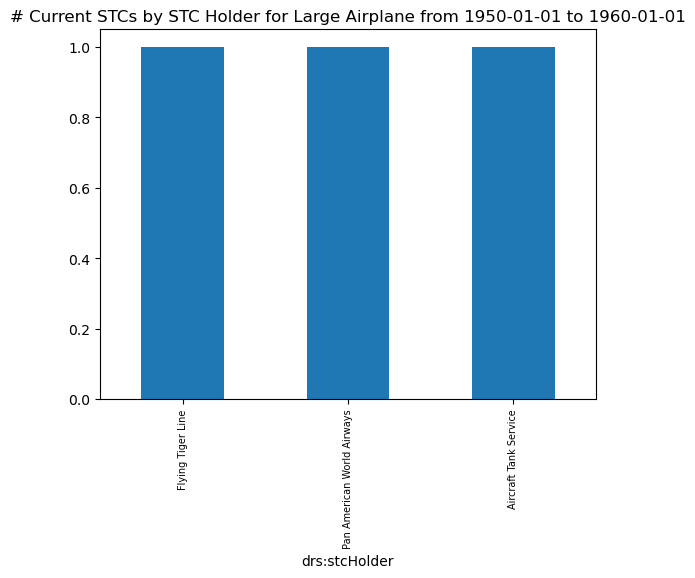

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:21: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(120).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:23: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  if df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductS

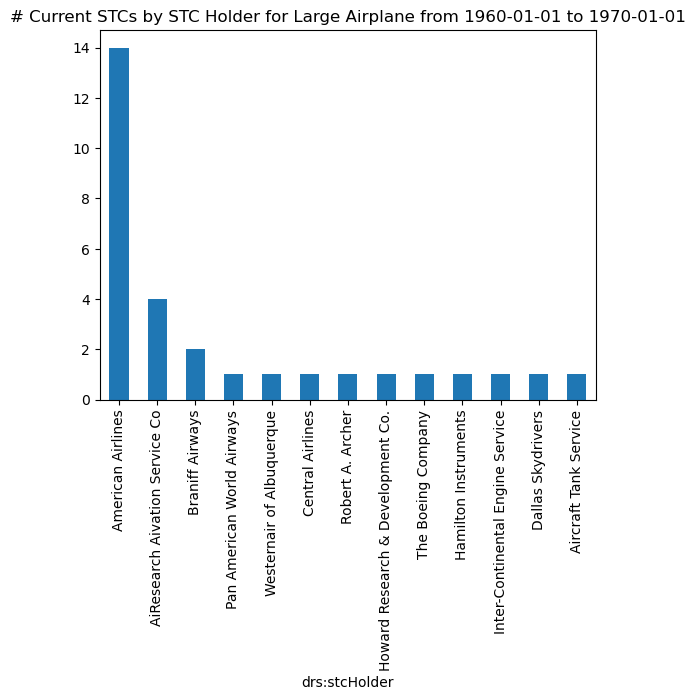

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:21: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(120).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See

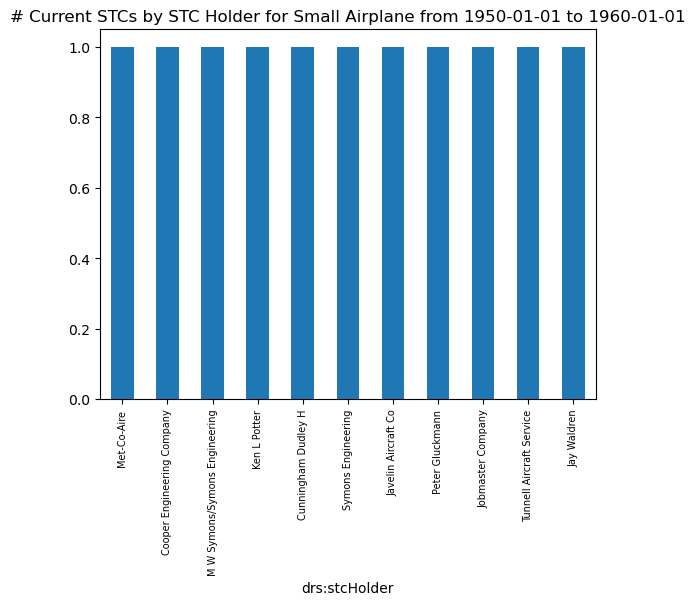

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:21: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(120).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:23: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  if df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductS

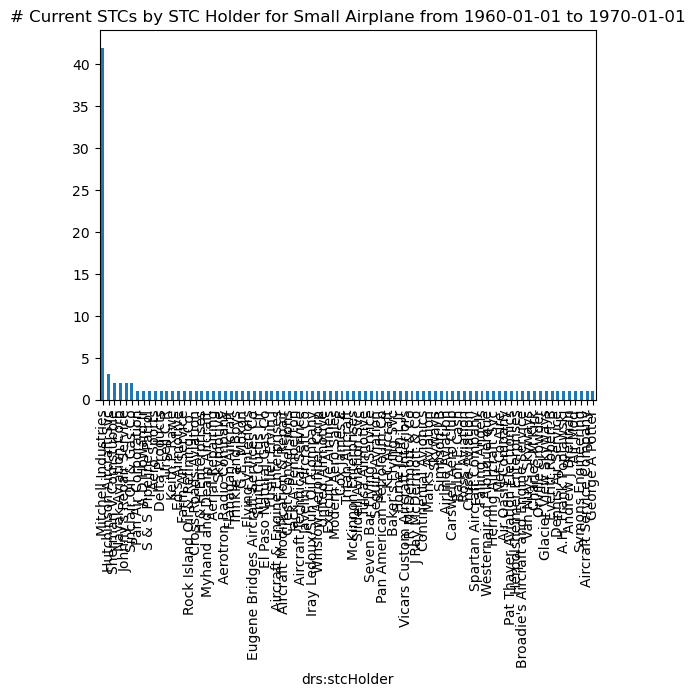

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:21: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(120).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See

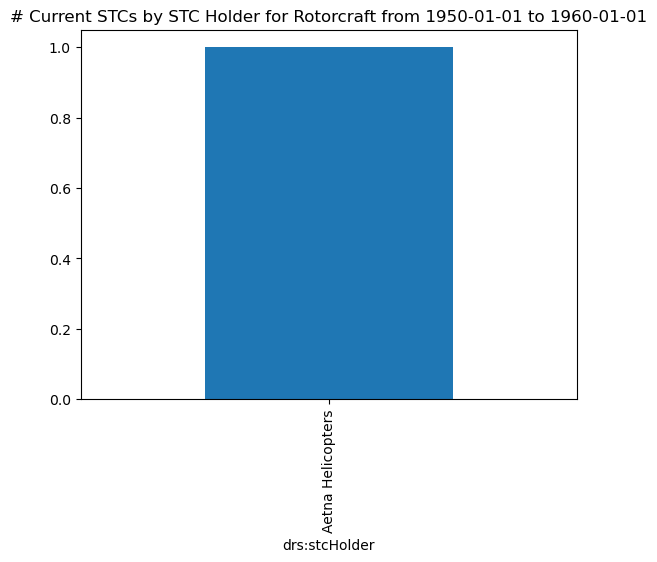

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


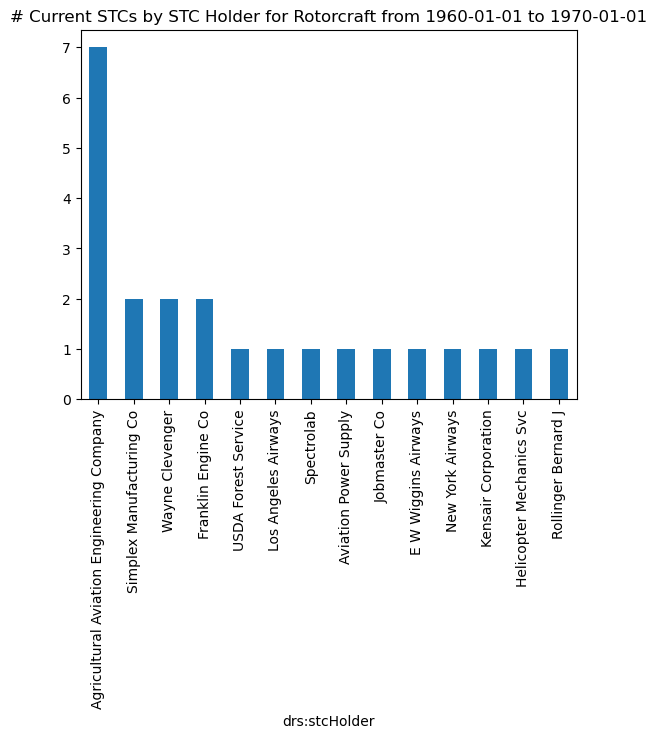

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:21: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(120).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See

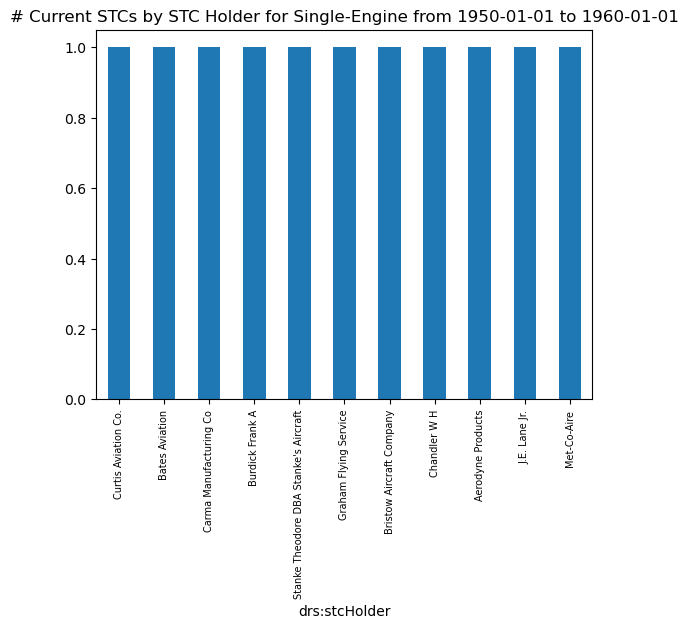

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:21: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(120).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:23: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  if df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductS

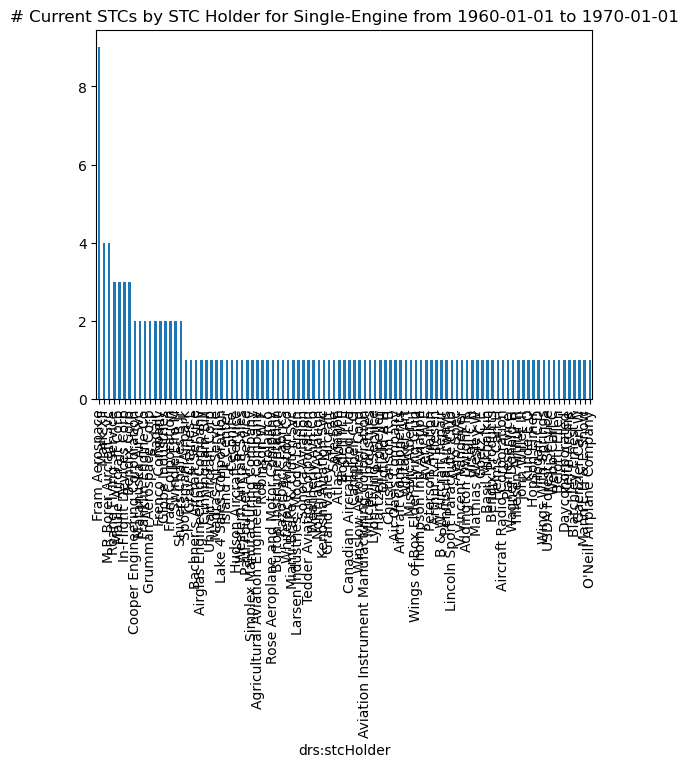

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:21: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(120).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See

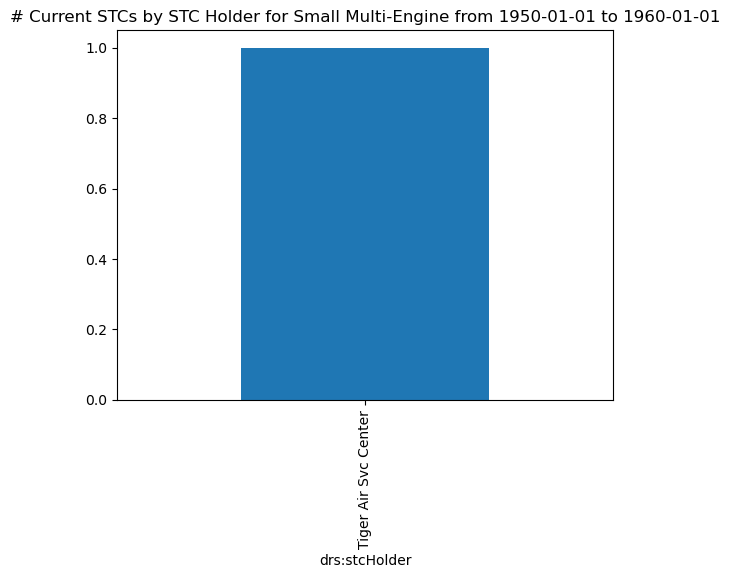

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:21: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(120).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:23: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  if df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductS

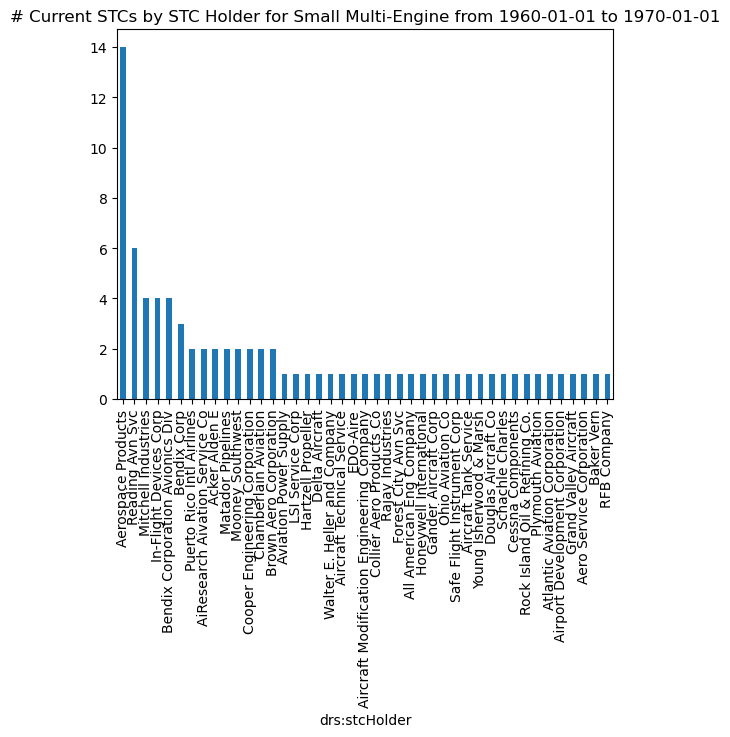

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:21: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(120).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See

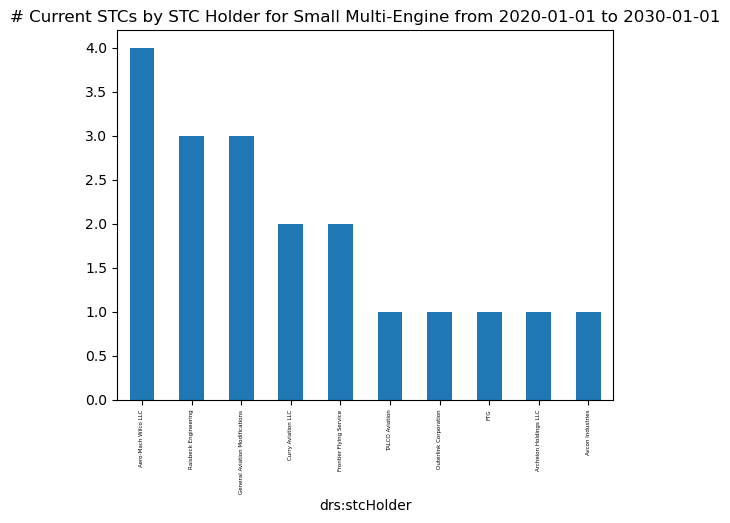

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:21: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(120).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:23: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  if df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductS

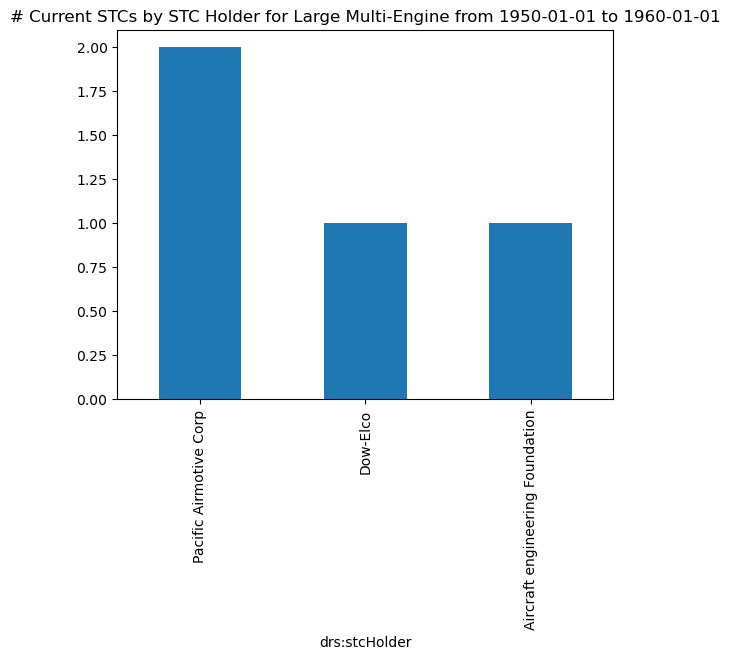

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:21: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(120).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:23: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  if df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductS

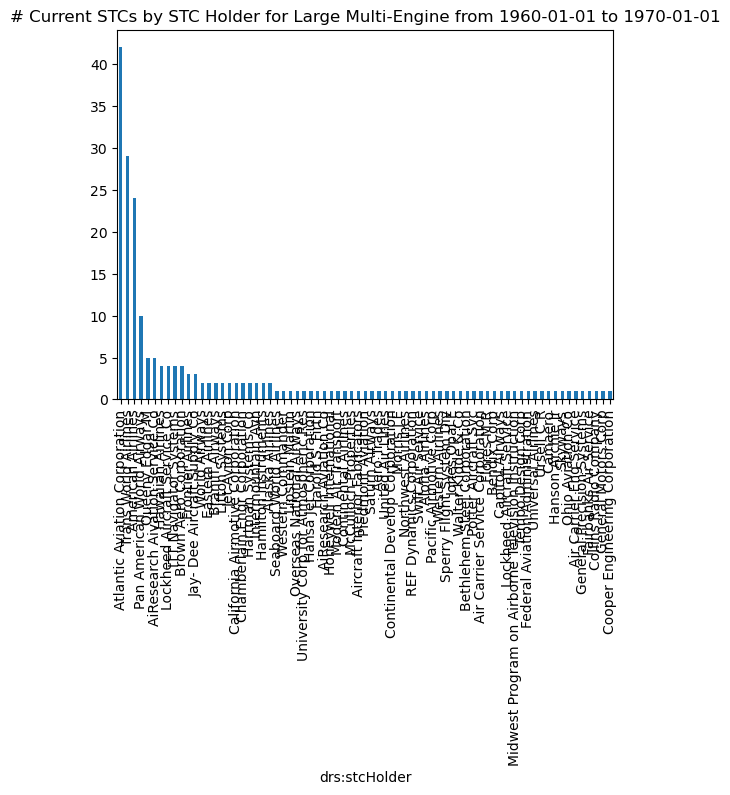

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:21: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(120).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See

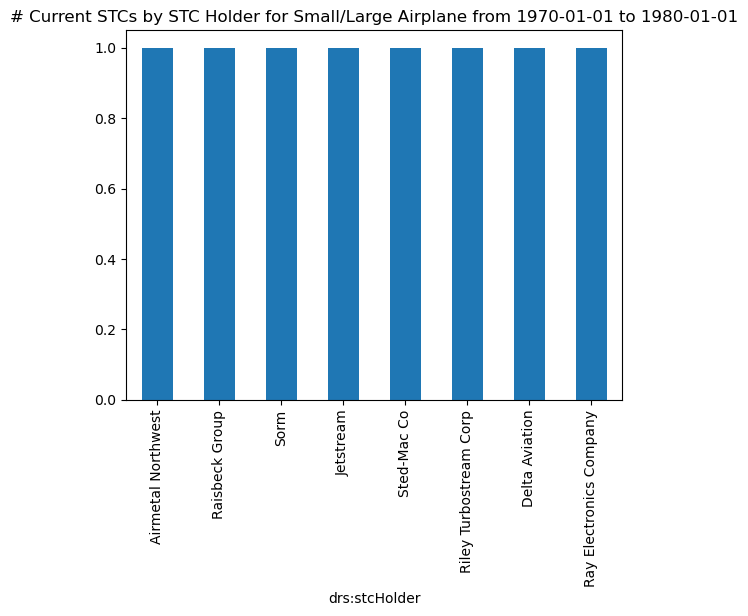

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:21: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(120).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:23: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  if df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductS

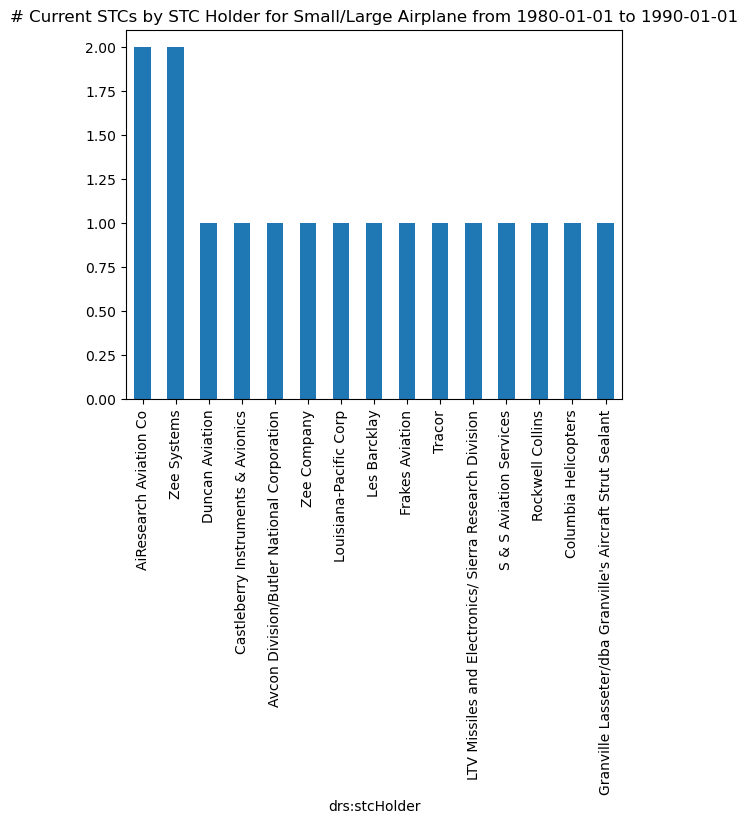

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:21: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(120).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See

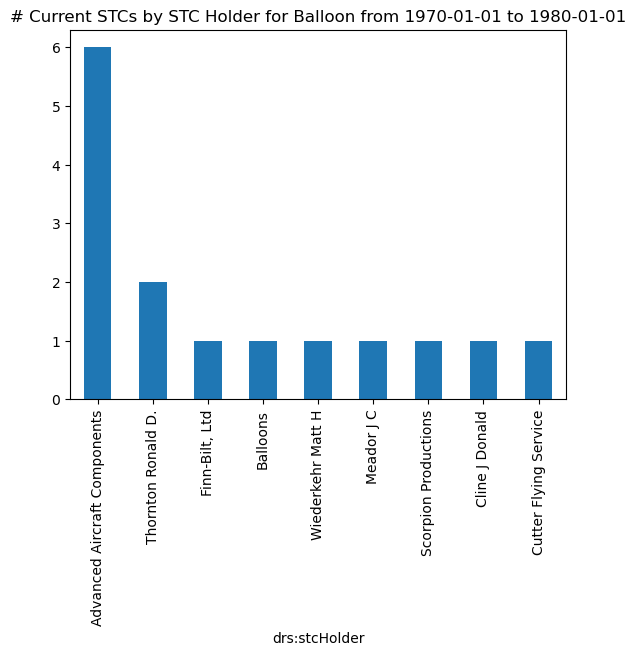

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:21: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(120).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:23: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  if df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductS

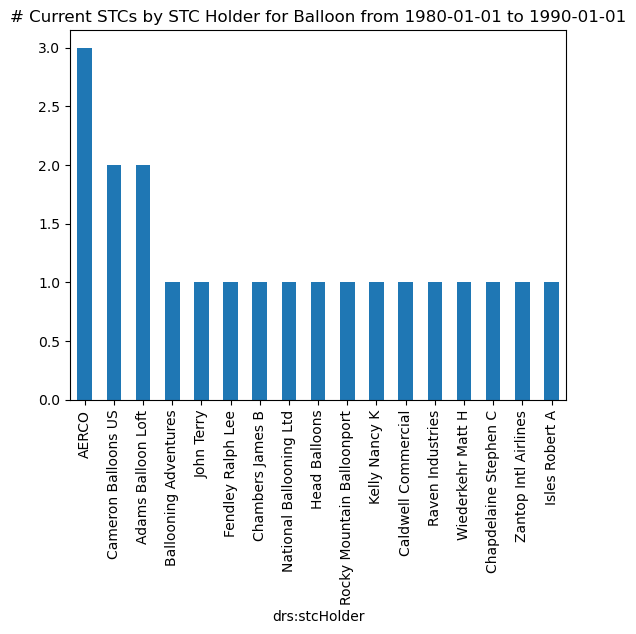

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:21: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(120).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See

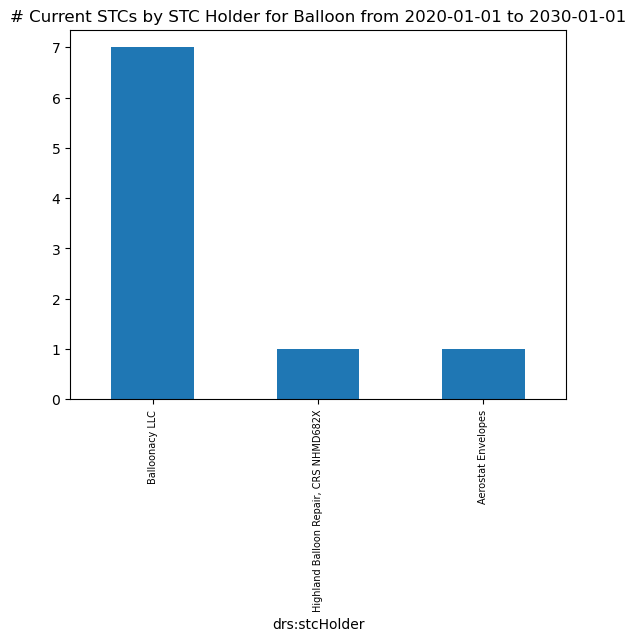

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: Setti

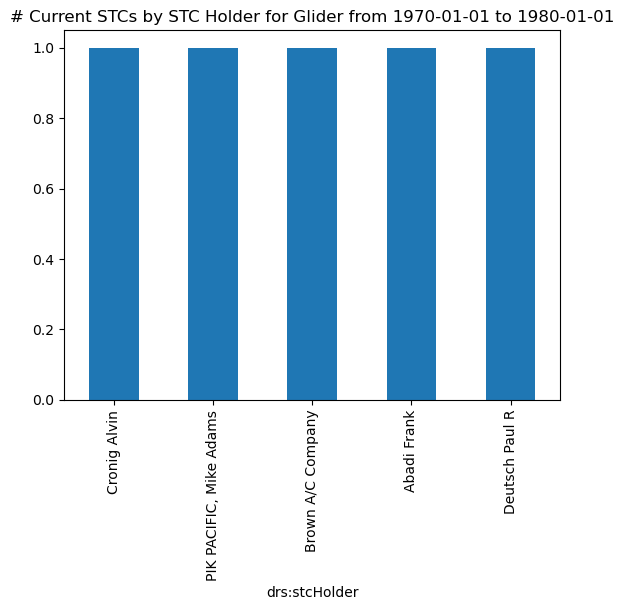

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


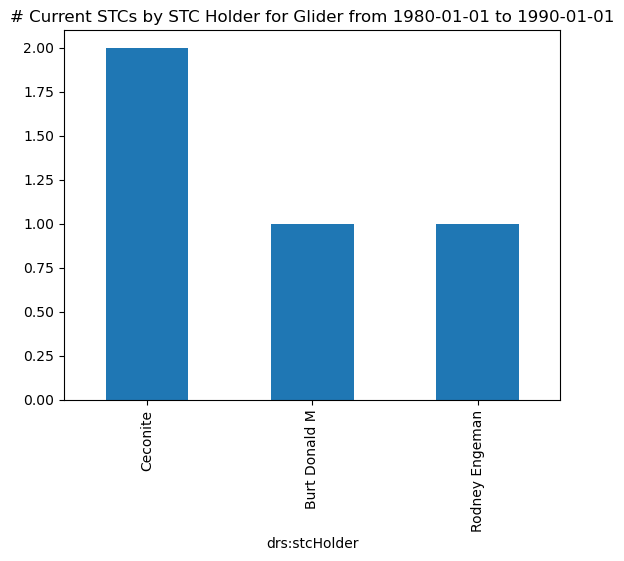

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


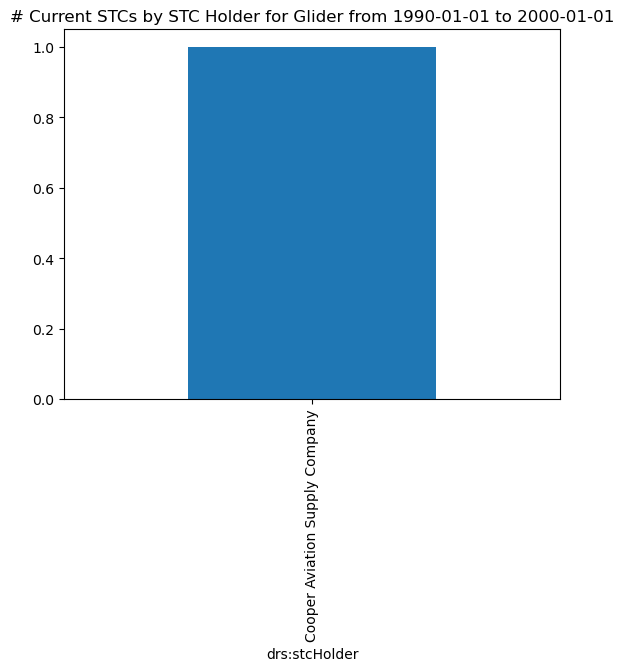

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:21: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(120).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:23: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  if df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductS

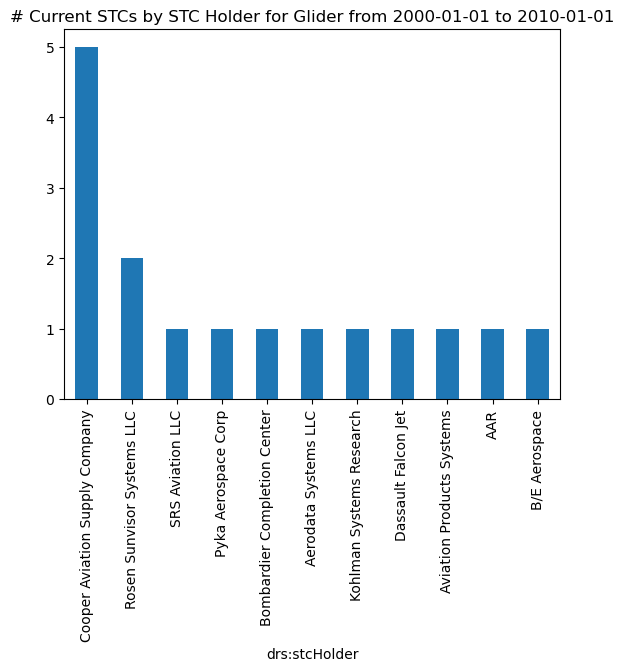

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


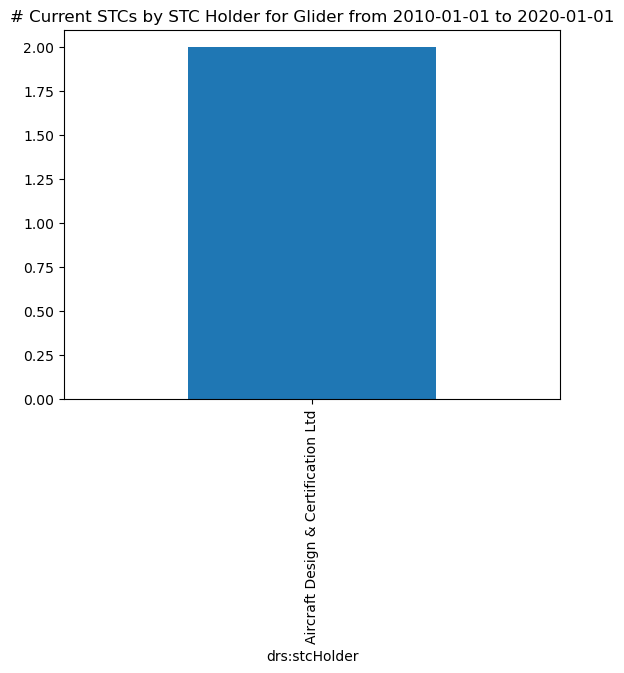

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


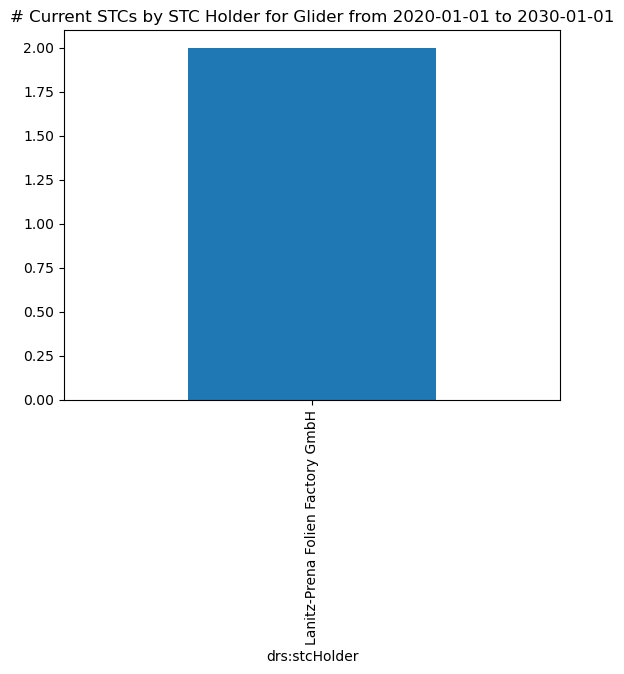

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: Setti

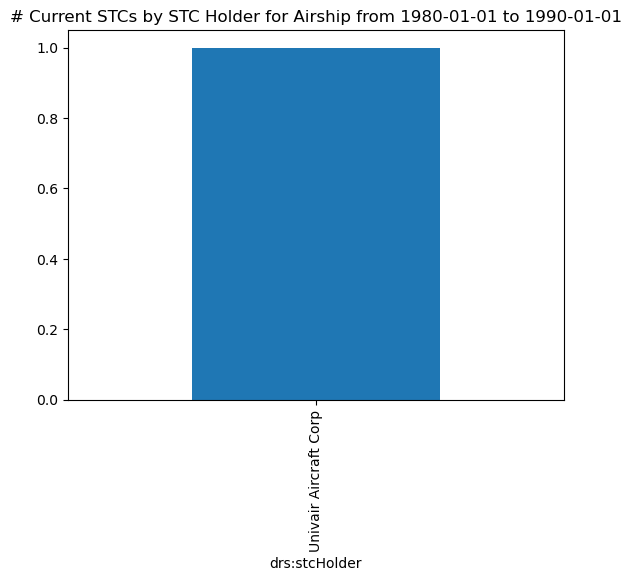

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:21: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(120).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:23: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  if df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductS

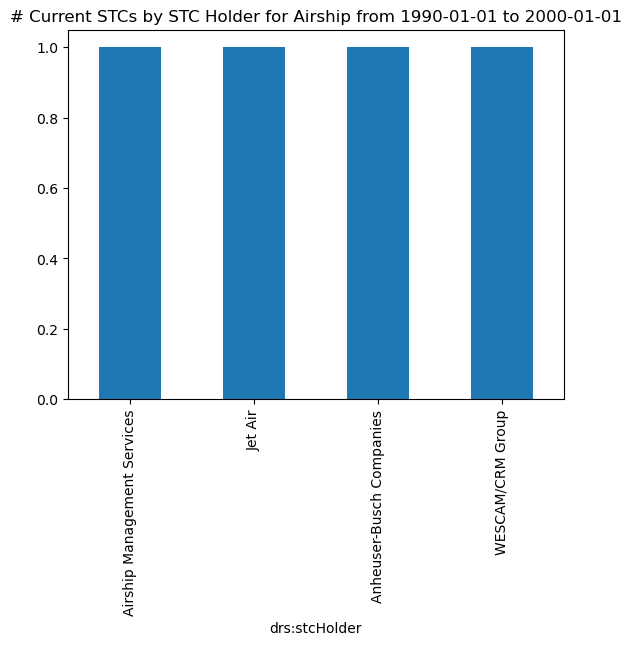

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:21: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(120).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:23: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  if df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductS

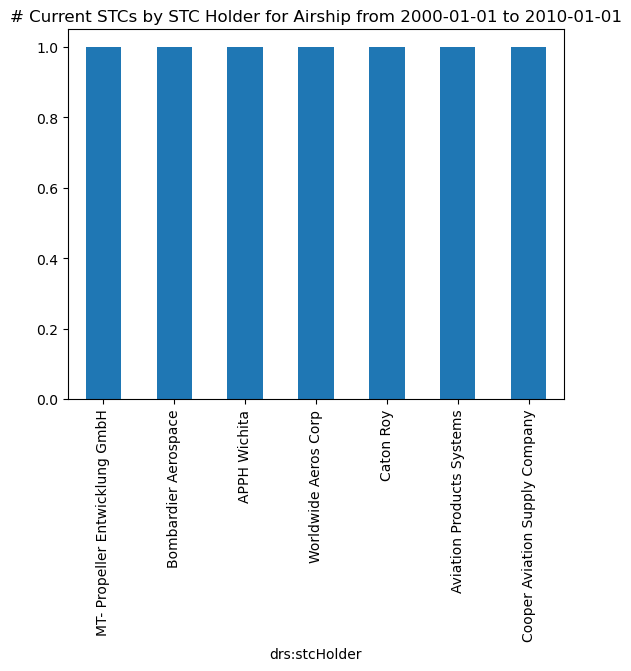

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:21: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(120).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See

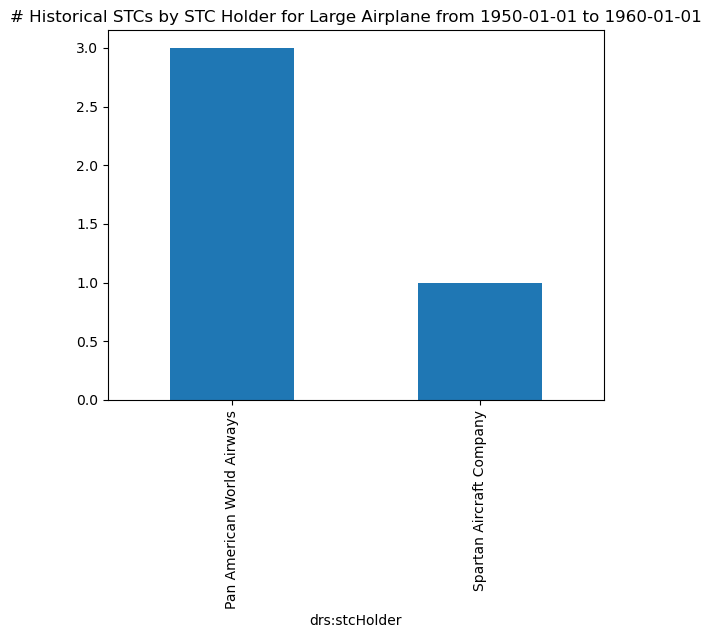

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:21: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(120).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:23: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  if df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductS

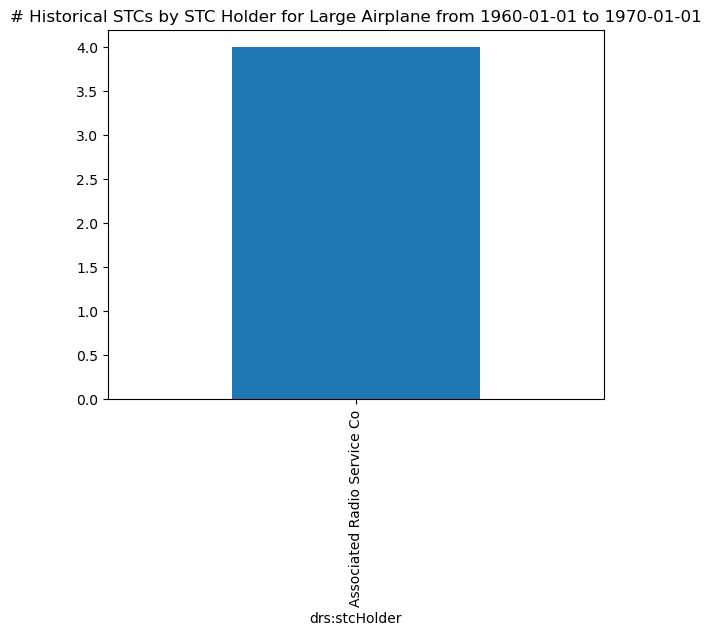

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:21: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(120).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:23: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  if df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductS

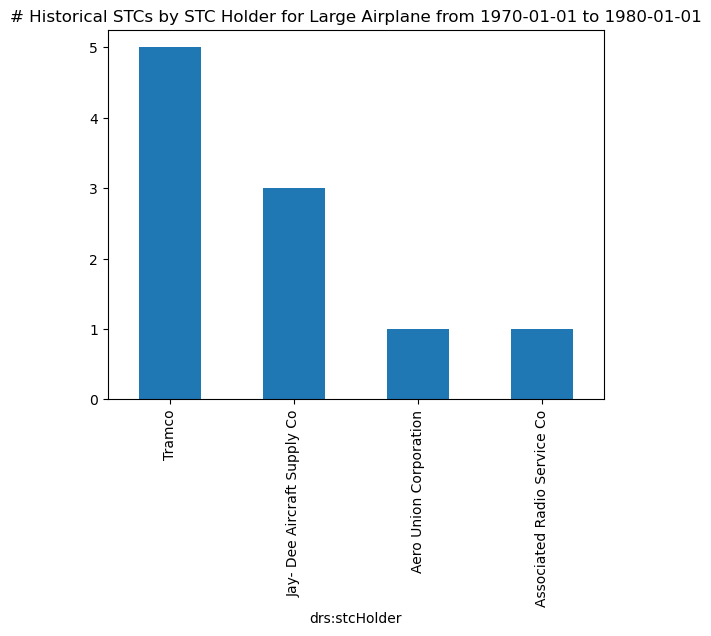

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:21: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(120).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See

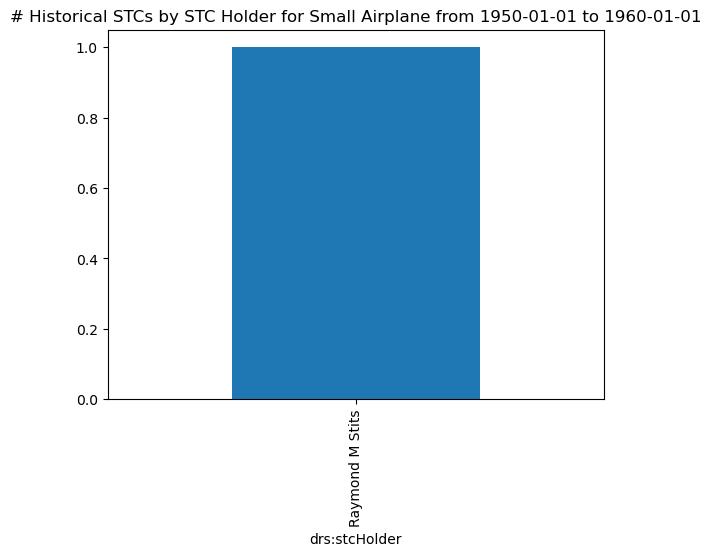

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:21: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(120).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:23: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  if df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductS

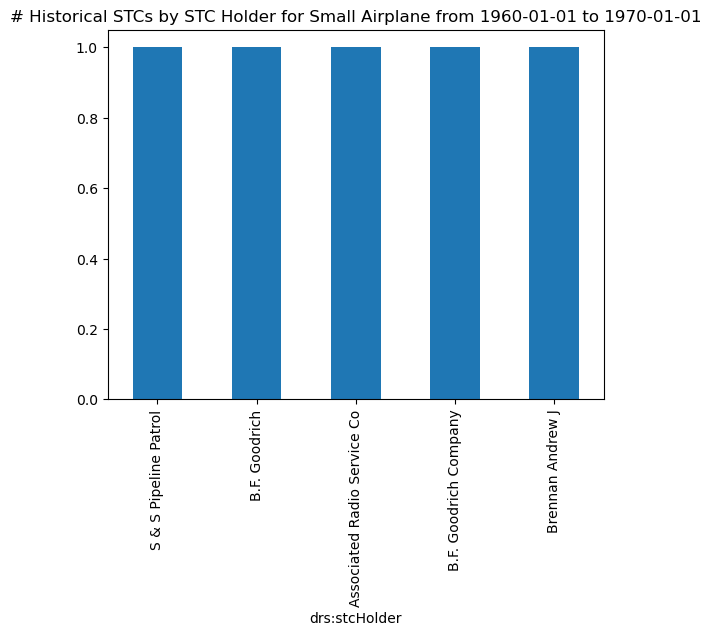

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:21: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(120).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See

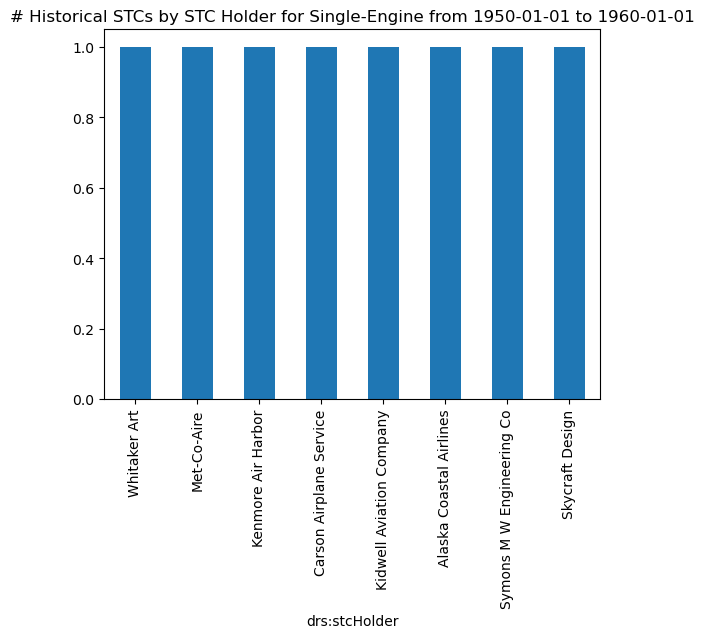

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:21: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(120).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:23: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  if df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductS

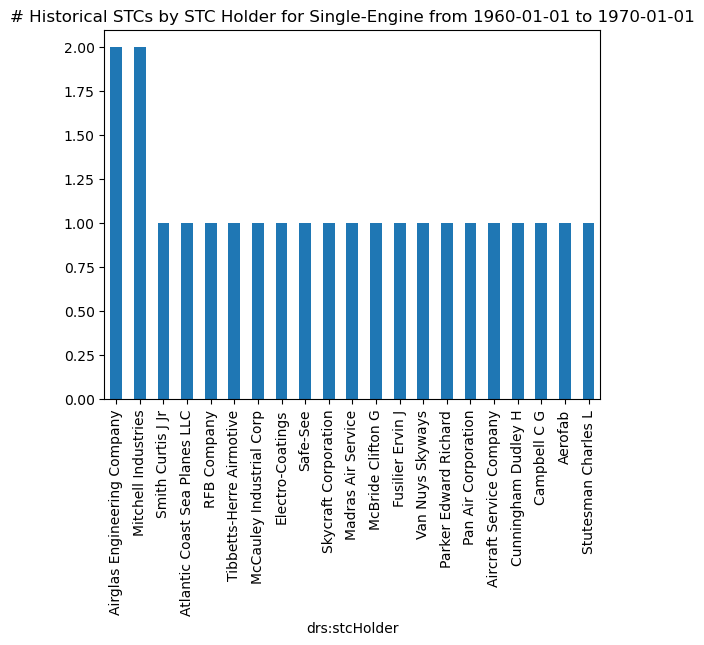

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:21: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(120).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See

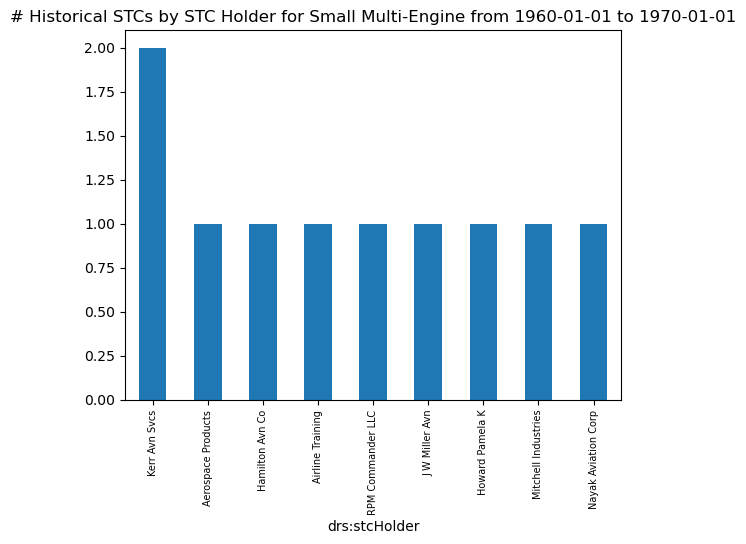

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:21: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(120).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See

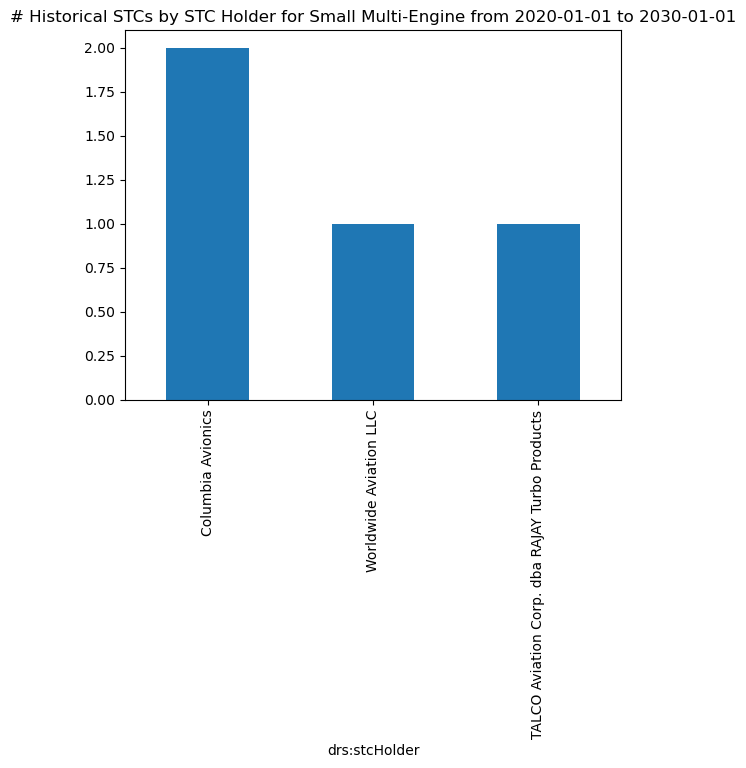

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:21: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(120).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:23: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  if df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductS

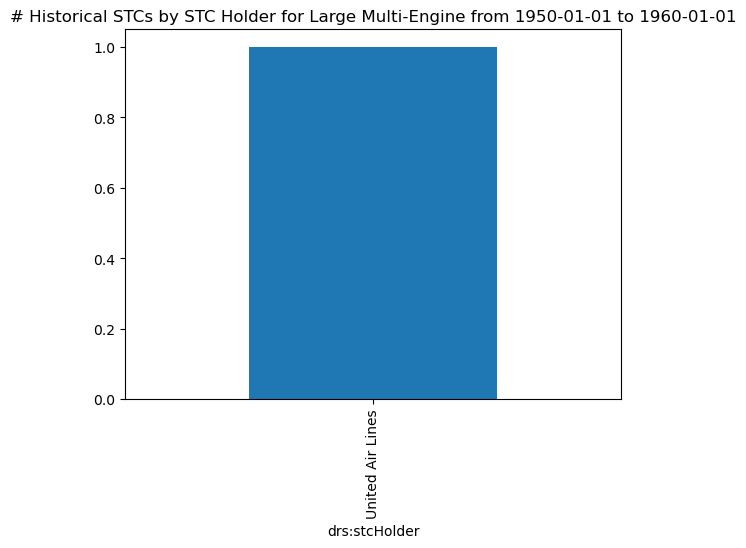

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:21: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(120).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:23: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  if df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductS

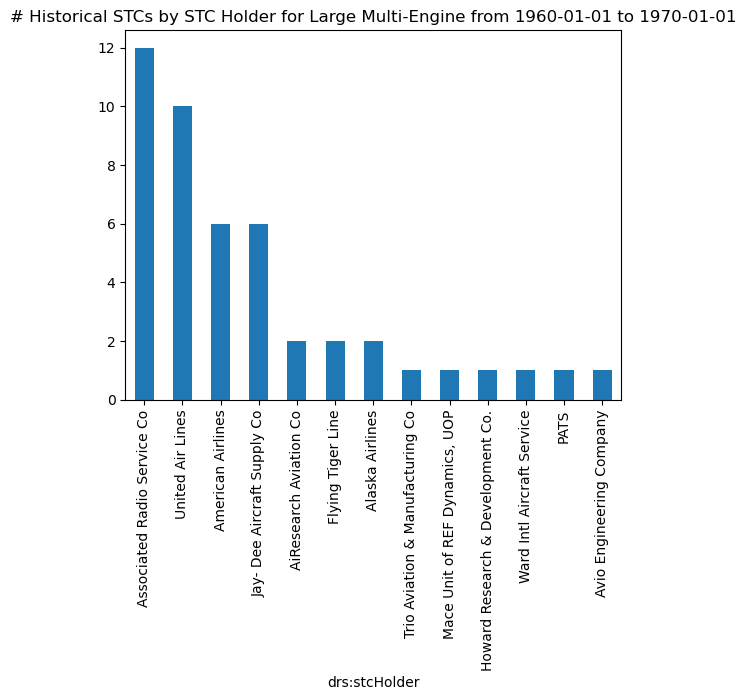

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:21: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(120).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See

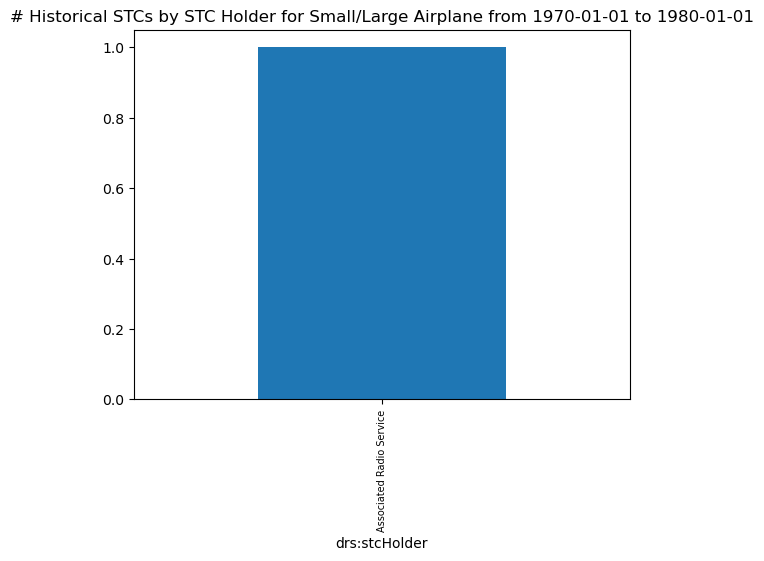

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:21: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(120).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:23: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  if df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductS

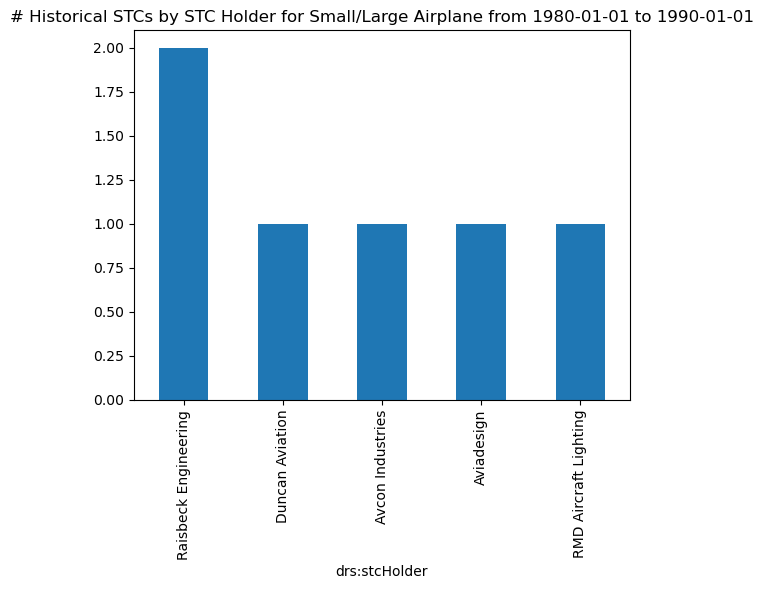

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:21: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(120).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:23: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  if df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductS

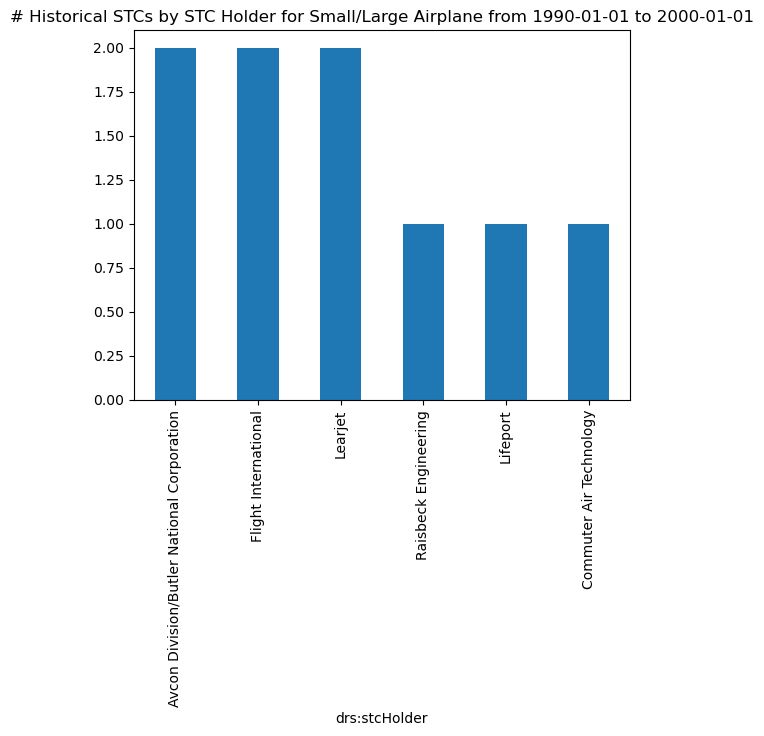

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:21: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(120).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:23: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  if df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductS

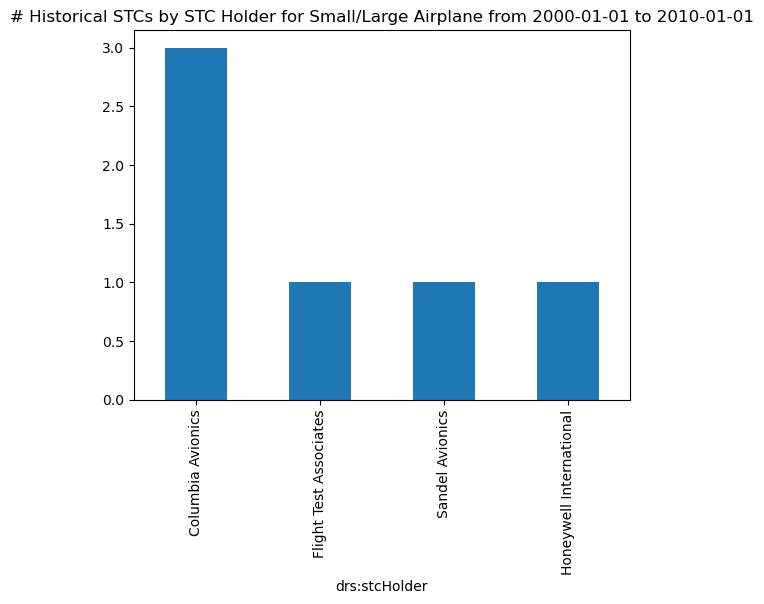

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:21: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(120).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See

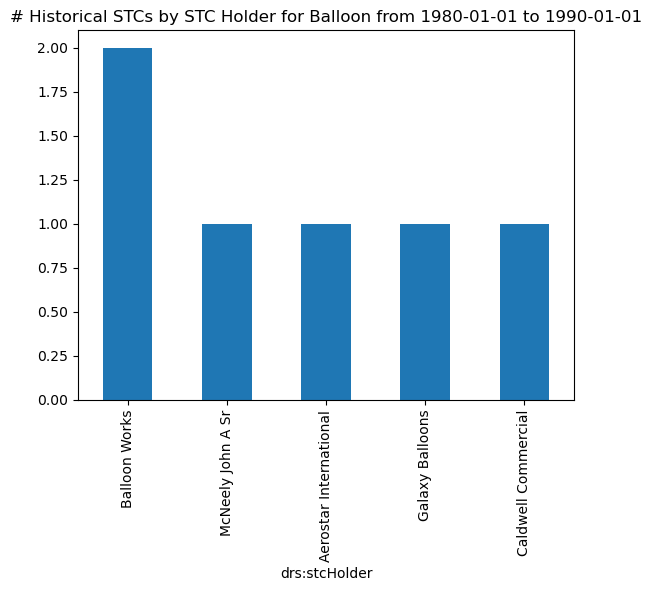

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:21: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(120).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See

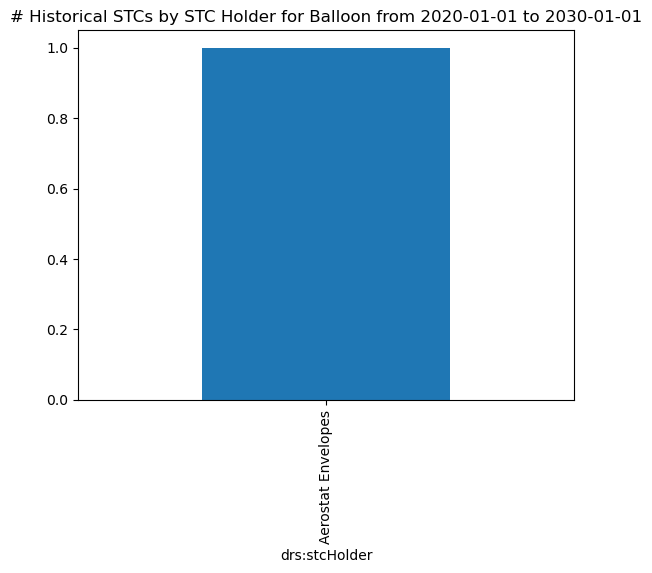

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: Setti

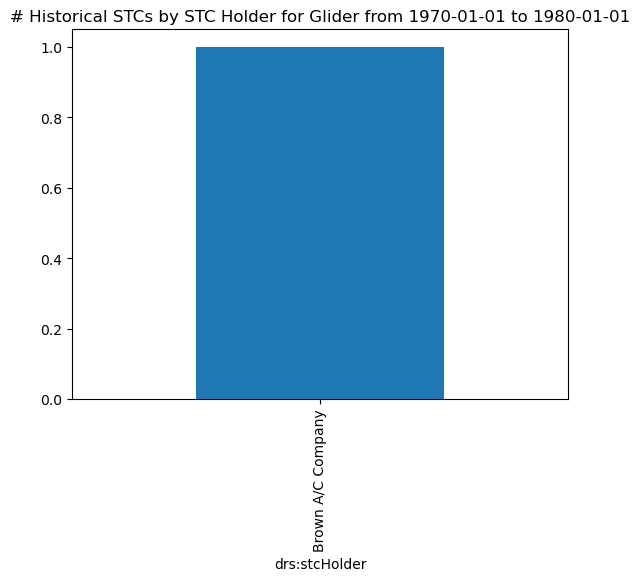

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:21: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(120).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See

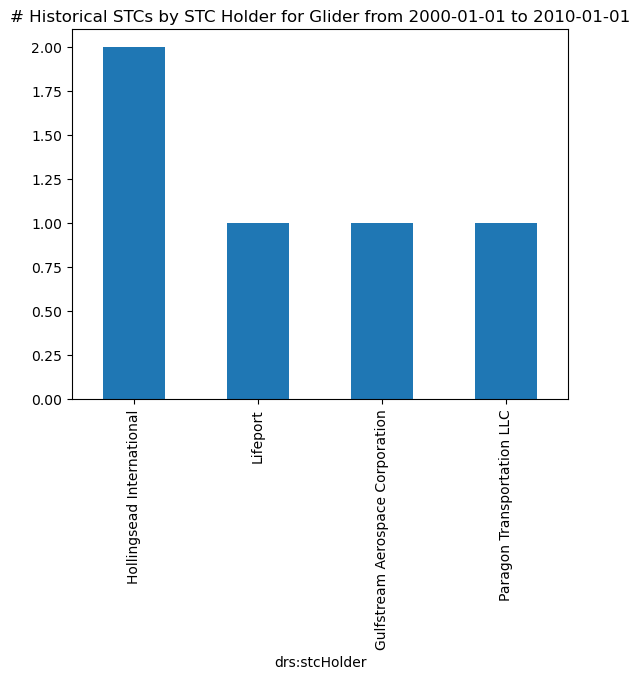

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:21: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(120).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See

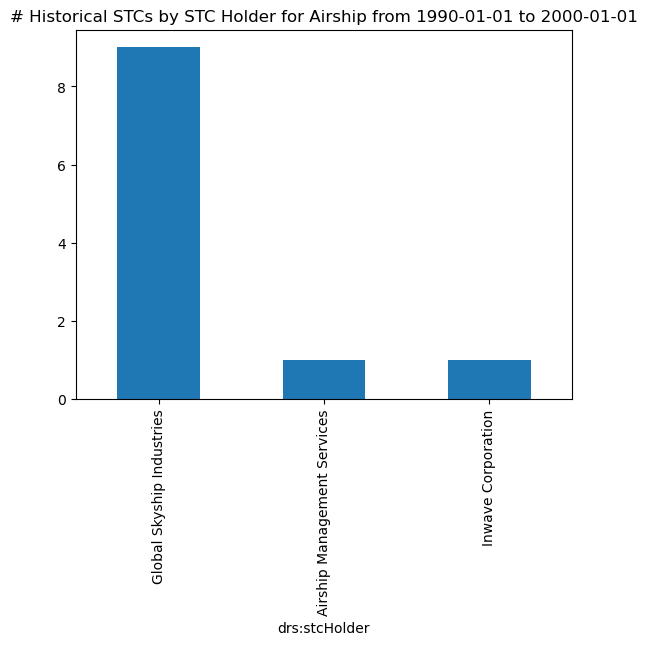

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:21: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(120).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:23: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  if df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductS

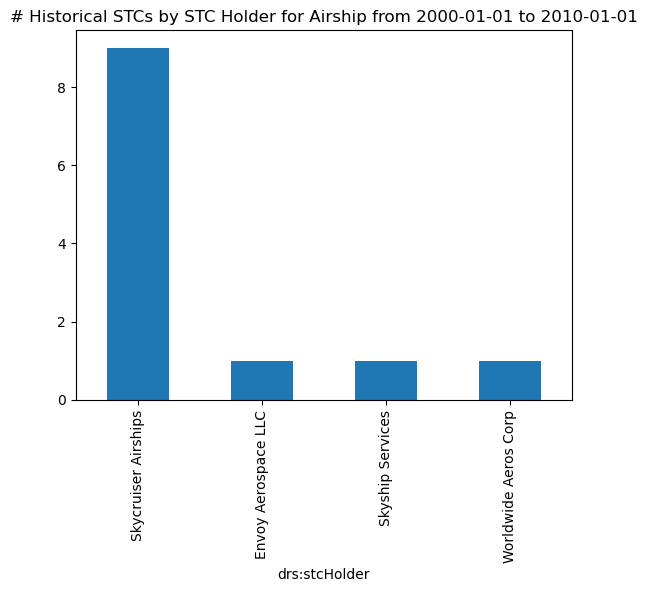

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:21: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(120).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\452177066.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See

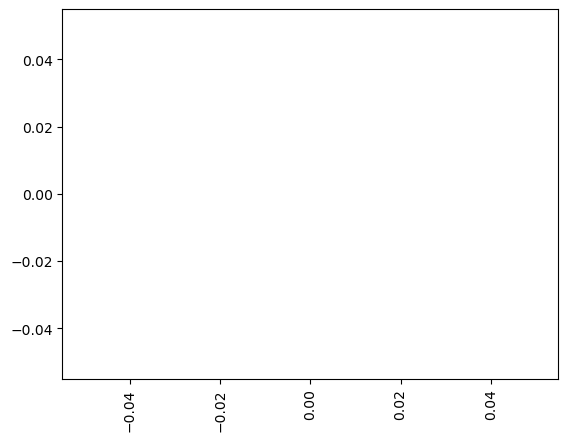

In [30]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

# plt.rcParams['figure.dpi'] = 300
# plt.rcParams['figure.figsize'] = 6.4, 4.8
# plt.rcParams['ytick.labelsize'] = 3

plt.rcParams['figure.dpi'] = 100
plt.rcParams['figure.figsize'] = 6.4, 4.8


for status in [["Current","Historical"],["Current"],["Historical"]]:
    for m, stcProductSubType in enumerate(df_stc["drs:stcProductSubType"].unique()):
        for n, _ in enumerate(start_dates):              
            try:
                df_dates = df_stc[df_stc["drs:stcProductSubType"]==stcProductSubType]
                df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
                df_dates = df_dates[(start_dates.iloc[n]<df_dates["date sortable "+str(n)]) & (df_dates["date sortable "+str(n)]<end_dates.iloc[n])]

                df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(120).plot.bar()

                if df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].shape[0]<20:
                    plt.rcParams['xtick.labelsize'] = 10
                    plt.rcParams['ytick.labelsize'] = 10
                elif df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].shape[0]<50:
                    plt.rcParams['xtick.labelsize'] = 7
                    plt.rcParams['ytick.labelsize'] = 10
                elif df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].shape[0]<120:
                    plt.rcParams['xtick.labelsize'] = 4
                    plt.rcParams['ytick.labelsize'] = 10
                
                plt.title("# "+", ".join(status)+" STCs by STC Holder for "+stcProductSubType+" from "+str(start_dates.iloc[n])+" to "+str(end_dates.iloc[n]))
                plt.show()
            except:
                pass

## Number of STCs by Office all years

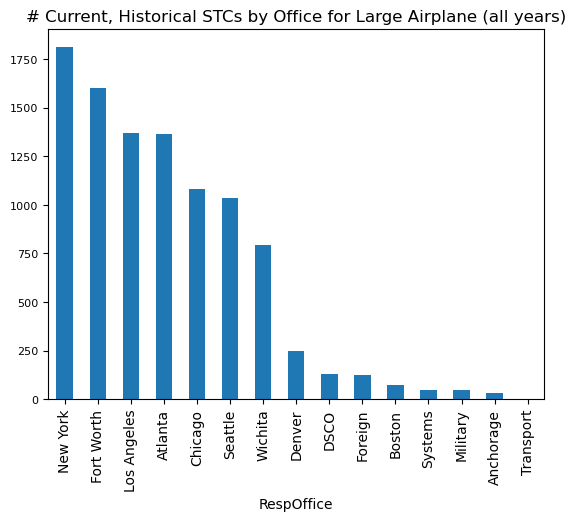

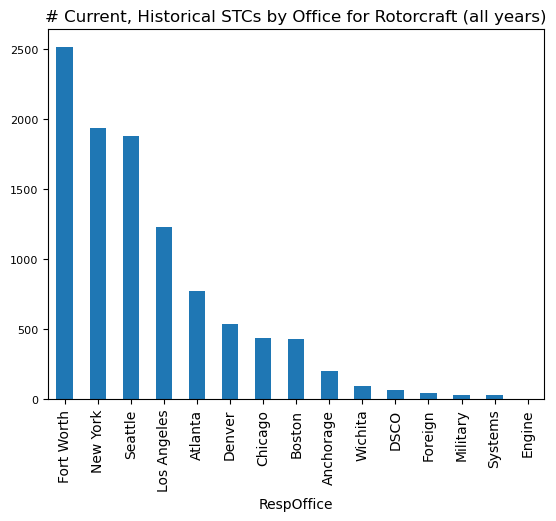

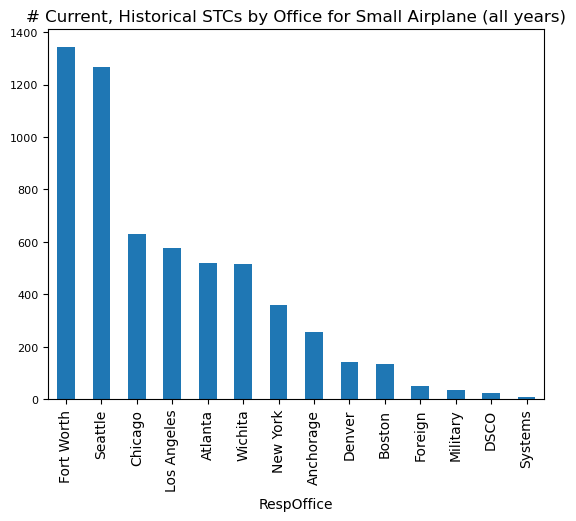

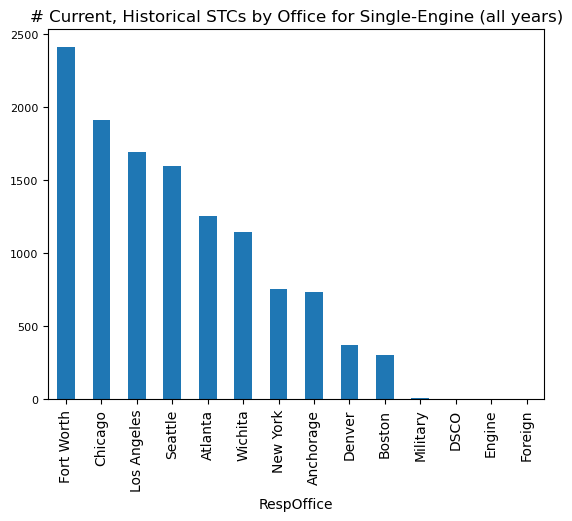

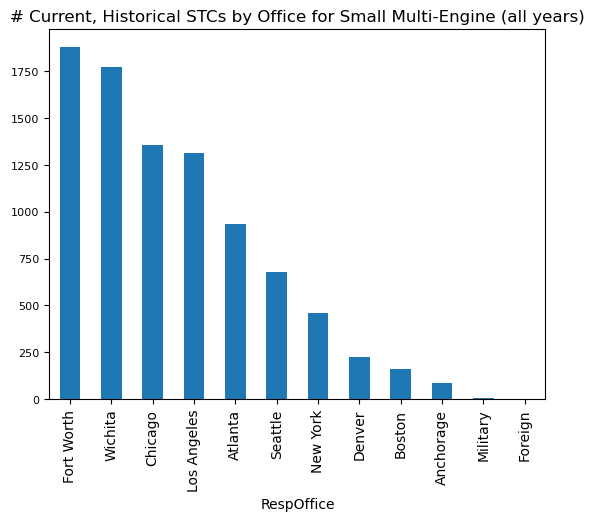

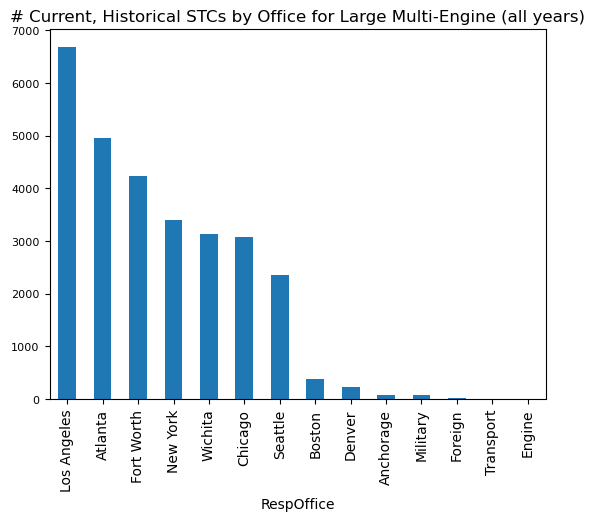

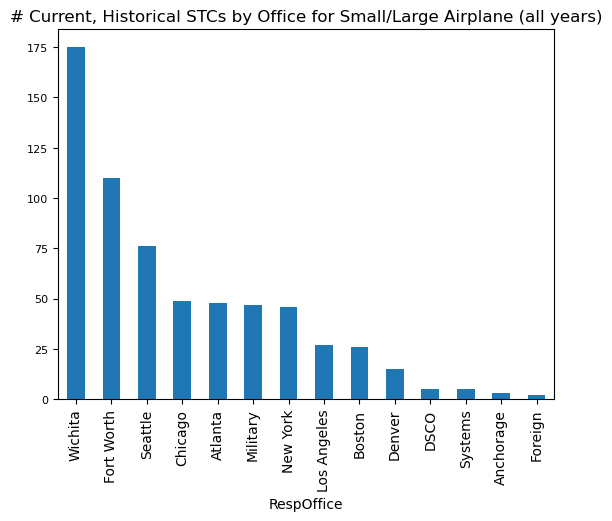

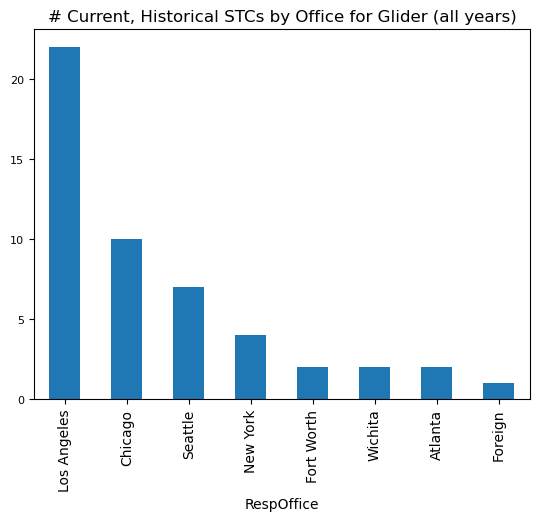

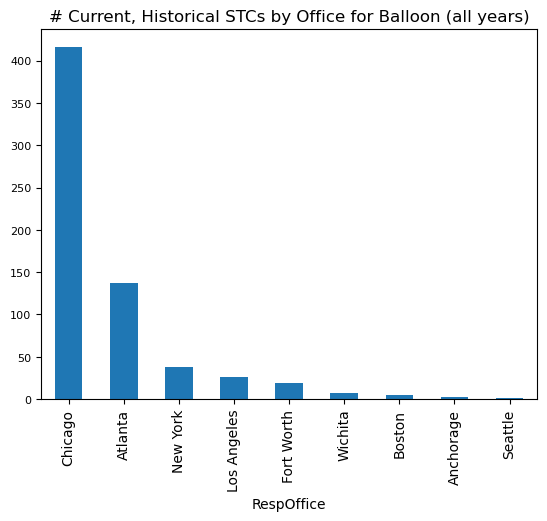

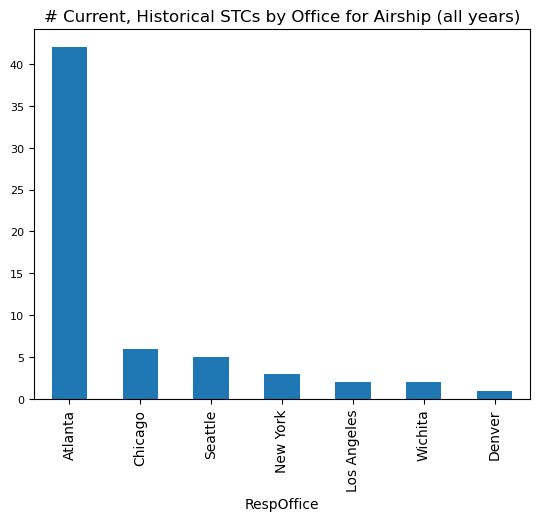

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\1622052736.py:12: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_stc_with_office[df_stc_with_office["drs:status"].isin(status)][df_stc_with_office["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


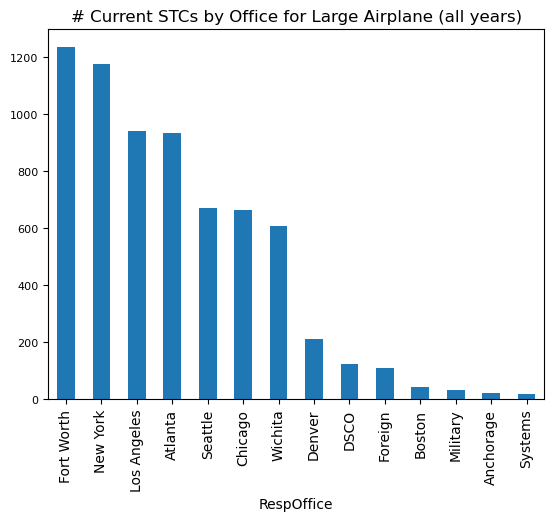

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\1622052736.py:12: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_stc_with_office[df_stc_with_office["drs:status"].isin(status)][df_stc_with_office["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


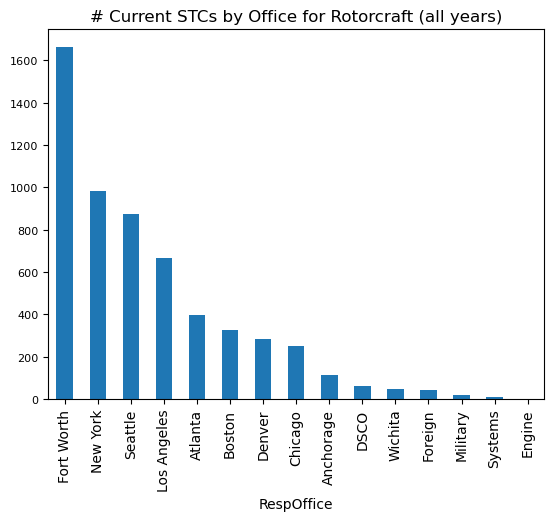

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\1622052736.py:12: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_stc_with_office[df_stc_with_office["drs:status"].isin(status)][df_stc_with_office["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\1622052736.py:12: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_stc_with_office[df_stc_with_office["drs:status"].isin(status)][df_stc_with_office["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


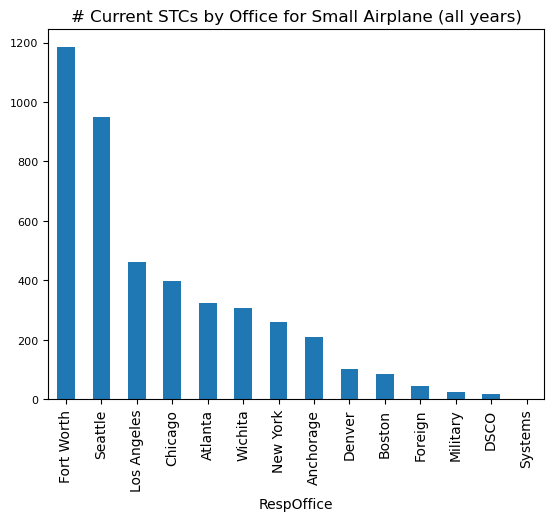

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\1622052736.py:12: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_stc_with_office[df_stc_with_office["drs:status"].isin(status)][df_stc_with_office["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


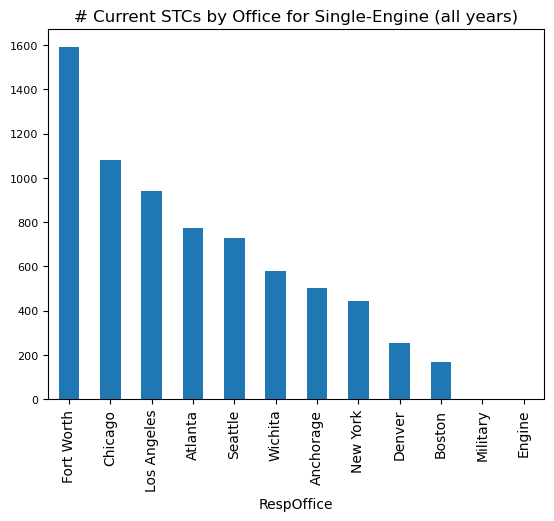

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\1622052736.py:12: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_stc_with_office[df_stc_with_office["drs:status"].isin(status)][df_stc_with_office["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


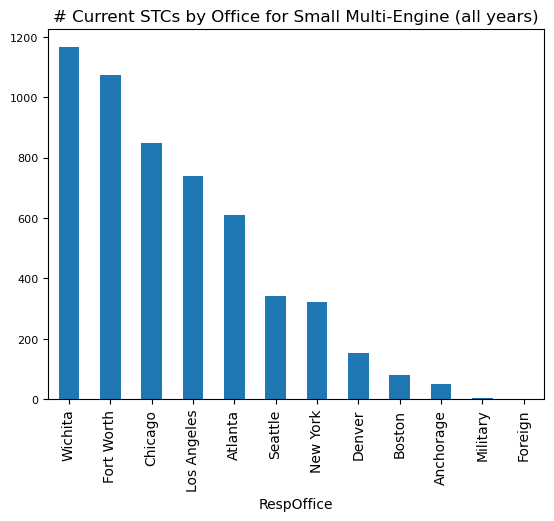

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\1622052736.py:12: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_stc_with_office[df_stc_with_office["drs:status"].isin(status)][df_stc_with_office["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


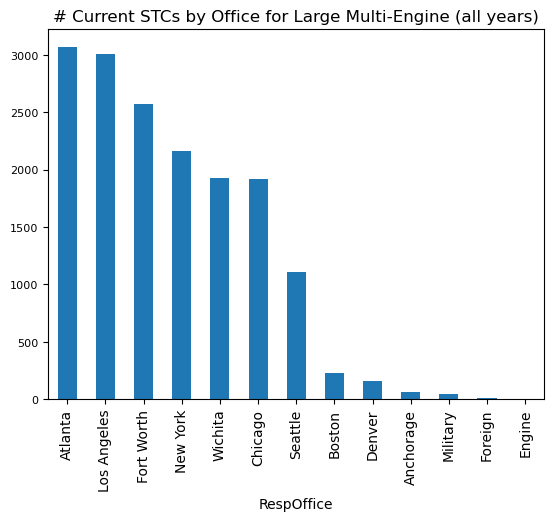

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\1622052736.py:12: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_stc_with_office[df_stc_with_office["drs:status"].isin(status)][df_stc_with_office["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


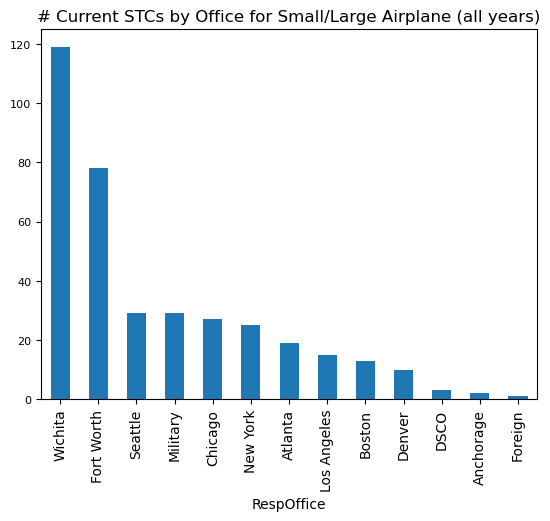

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\1622052736.py:12: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_stc_with_office[df_stc_with_office["drs:status"].isin(status)][df_stc_with_office["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


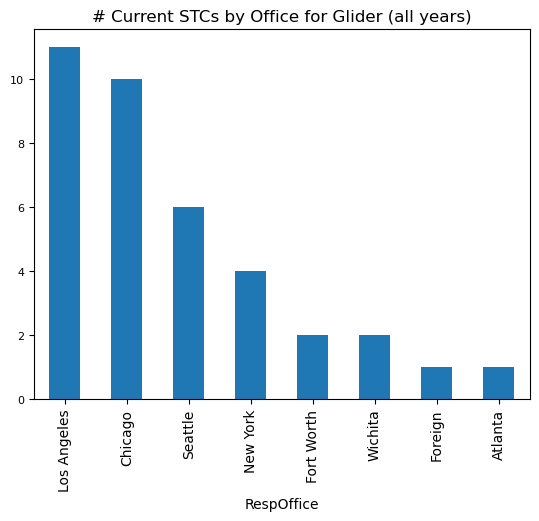

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\1622052736.py:12: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_stc_with_office[df_stc_with_office["drs:status"].isin(status)][df_stc_with_office["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


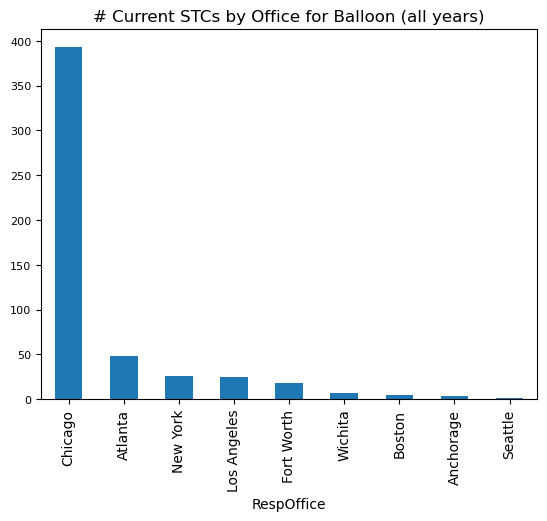

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\1622052736.py:12: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_stc_with_office[df_stc_with_office["drs:status"].isin(status)][df_stc_with_office["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


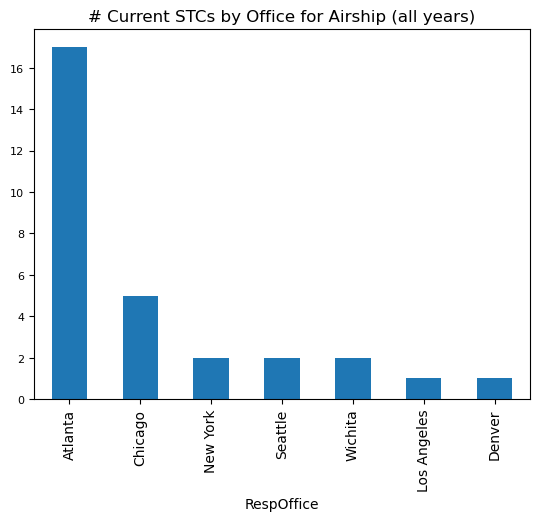

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\1622052736.py:12: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_stc_with_office[df_stc_with_office["drs:status"].isin(status)][df_stc_with_office["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


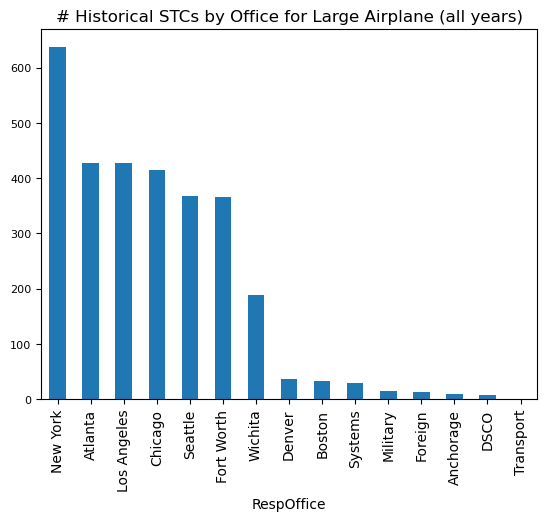

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\1622052736.py:12: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_stc_with_office[df_stc_with_office["drs:status"].isin(status)][df_stc_with_office["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


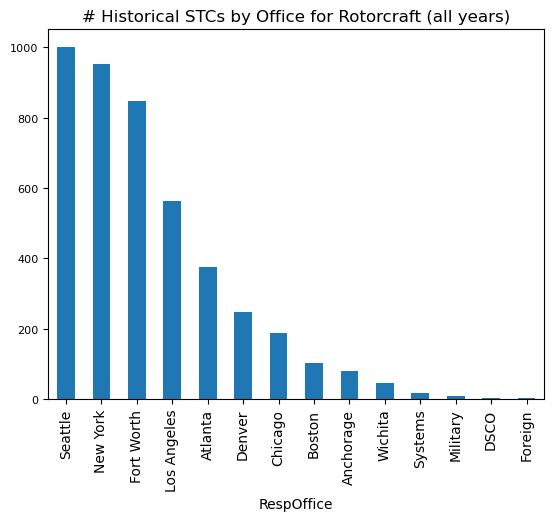

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\1622052736.py:12: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_stc_with_office[df_stc_with_office["drs:status"].isin(status)][df_stc_with_office["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\1622052736.py:12: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_stc_with_office[df_stc_with_office["drs:status"].isin(status)][df_stc_with_office["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


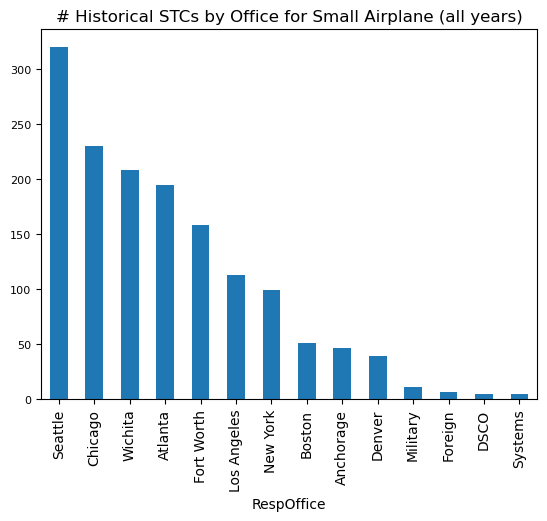

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\1622052736.py:12: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_stc_with_office[df_stc_with_office["drs:status"].isin(status)][df_stc_with_office["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


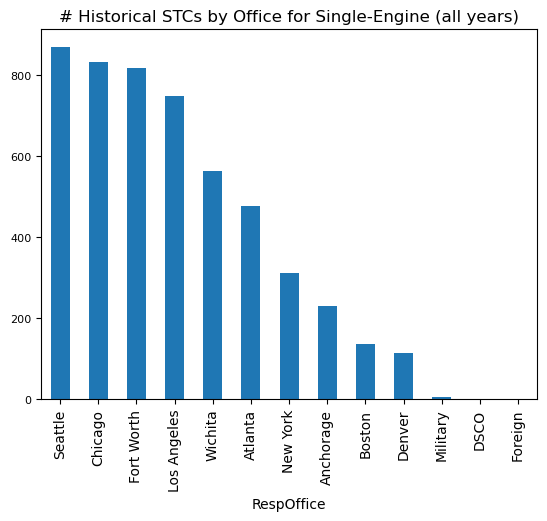

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\1622052736.py:12: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_stc_with_office[df_stc_with_office["drs:status"].isin(status)][df_stc_with_office["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


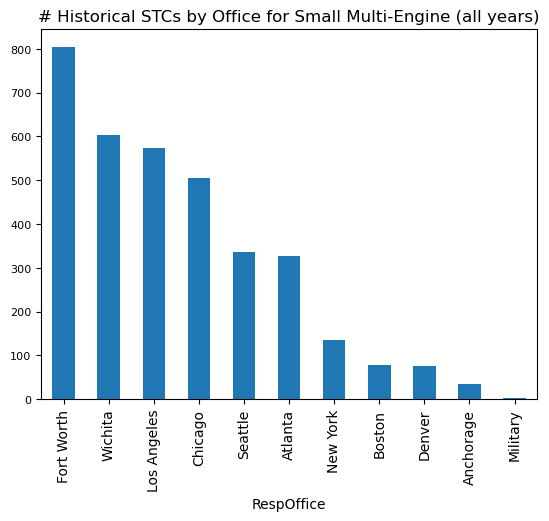

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\1622052736.py:12: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_stc_with_office[df_stc_with_office["drs:status"].isin(status)][df_stc_with_office["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


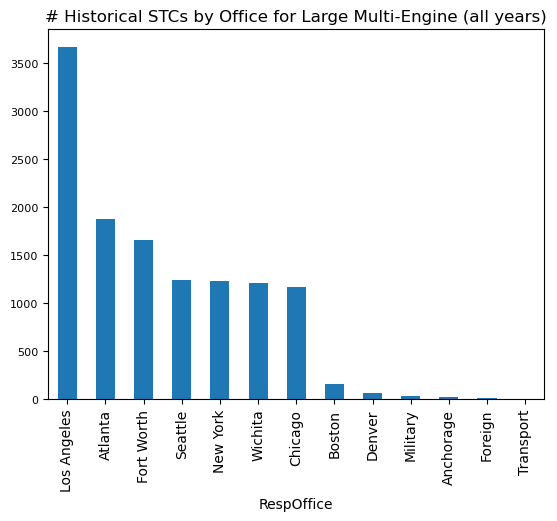

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\1622052736.py:12: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_stc_with_office[df_stc_with_office["drs:status"].isin(status)][df_stc_with_office["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


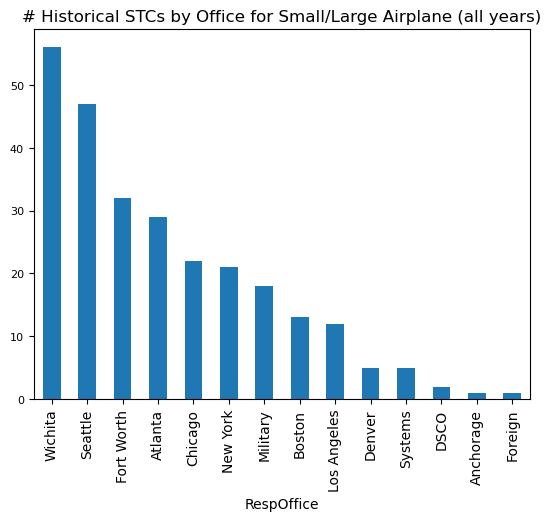

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\1622052736.py:12: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_stc_with_office[df_stc_with_office["drs:status"].isin(status)][df_stc_with_office["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


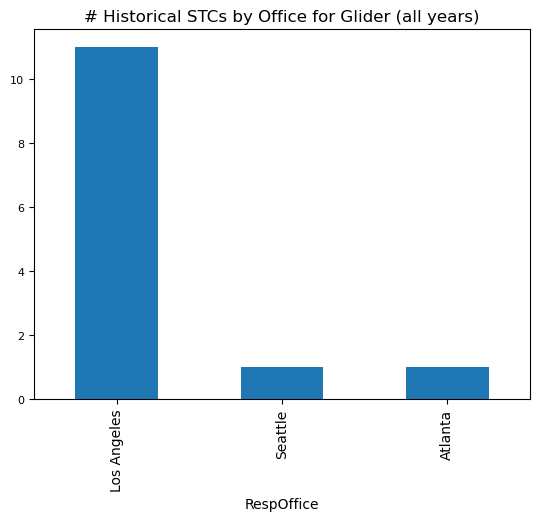

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\1622052736.py:12: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_stc_with_office[df_stc_with_office["drs:status"].isin(status)][df_stc_with_office["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


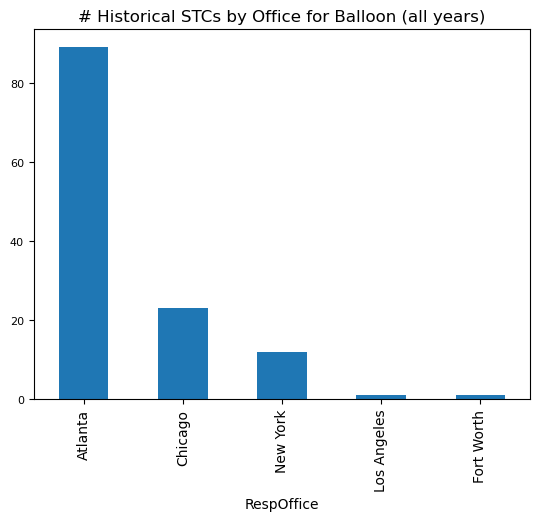

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\1622052736.py:12: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_stc_with_office[df_stc_with_office["drs:status"].isin(status)][df_stc_with_office["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


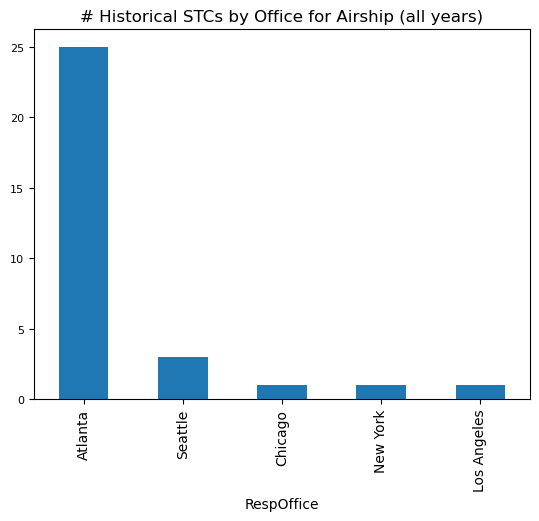

In [4]:
import matplotlib.pyplot as plt
import numpy as np

plt.rcParams['figure.dpi'] = 100
plt.rcParams['figure.figsize'] = 6.4, 4.8

df_stc_with_office = df_stc.merge(df_office, on='drs:primaryRespOffice')

for status in [["Current","Historical"],["Current"],["Historical"]]:
    for m, stcProductSubType in enumerate(df_stc_with_office["drs:stcProductSubType"].unique()):
        try:
            df_stc_with_office[df_stc_with_office["drs:status"].isin(status)][df_stc_with_office["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()
            plt.yticks(fontsize=8)
            plt.title("# "+", ".join(status)+" STCs by Office for "+stcProductSubType + " (all years)")
            plt.show()
        except:
            pass

## Number of STCs by Office by decade

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


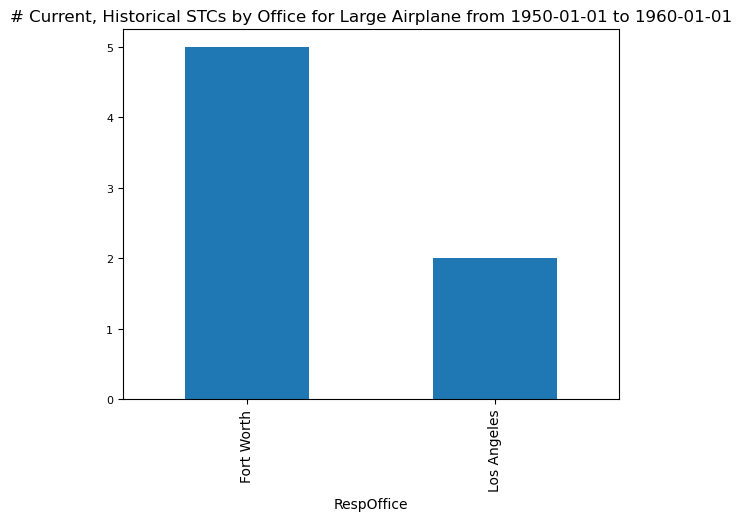

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


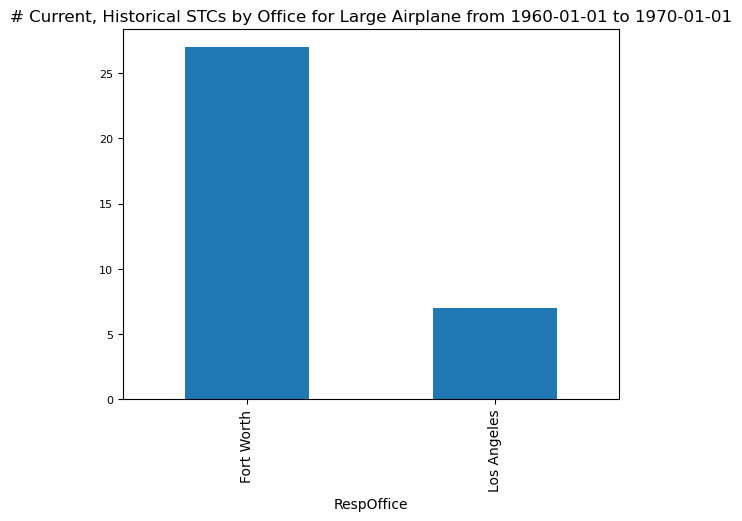

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


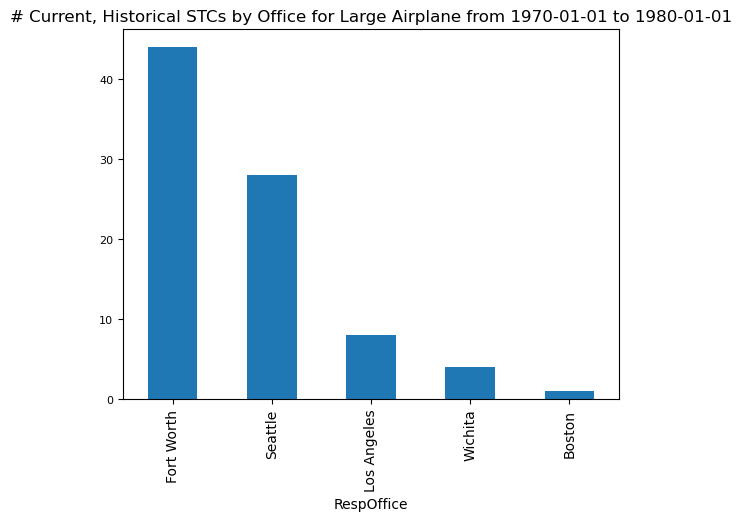

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


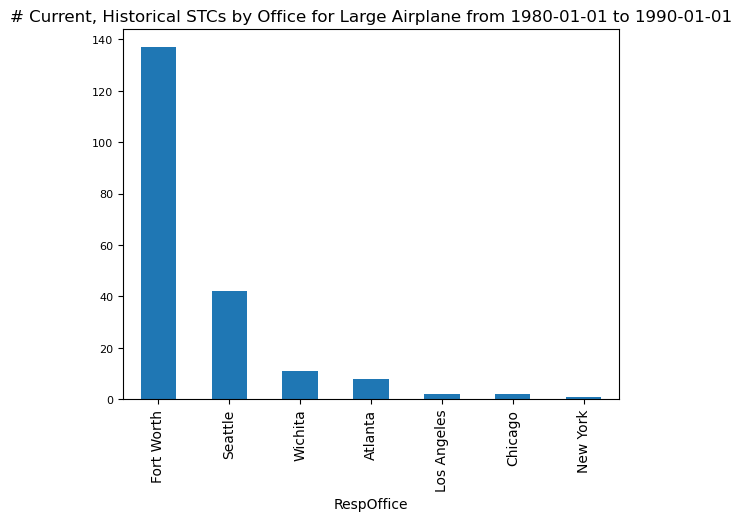

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


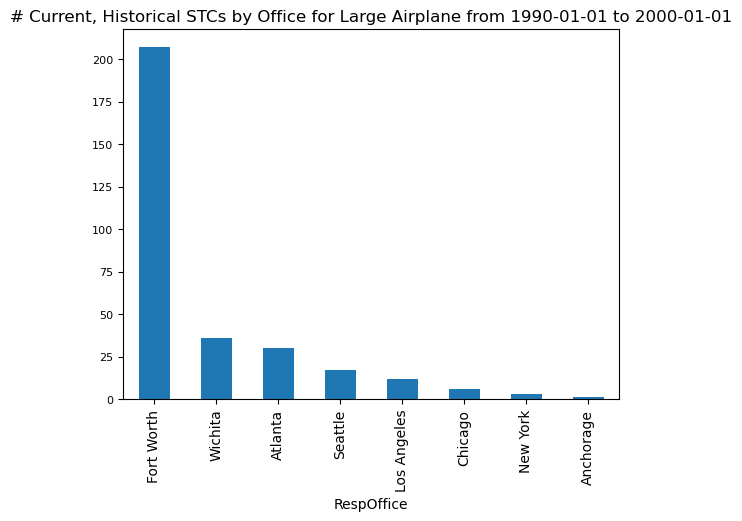

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


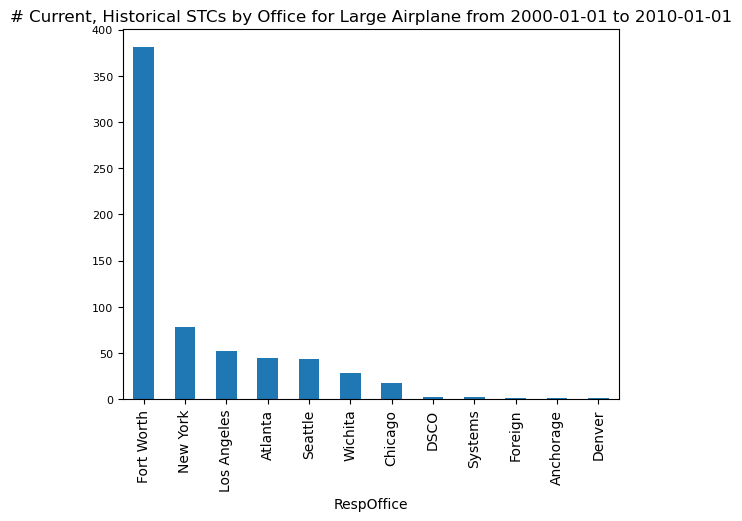

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


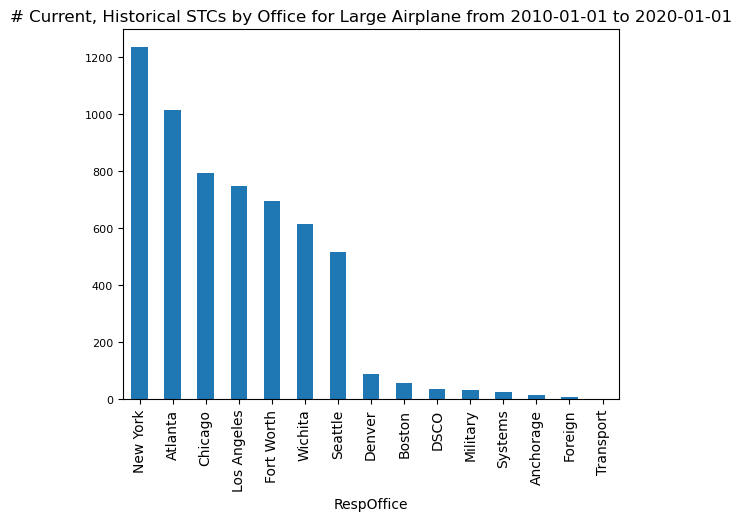

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


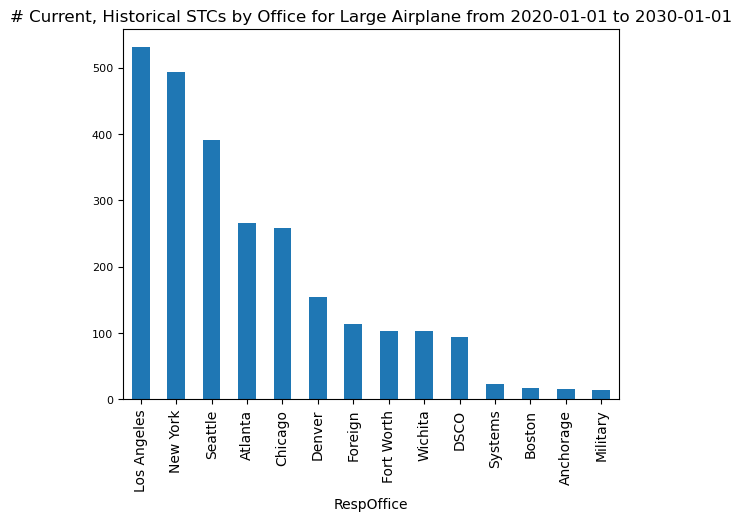

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


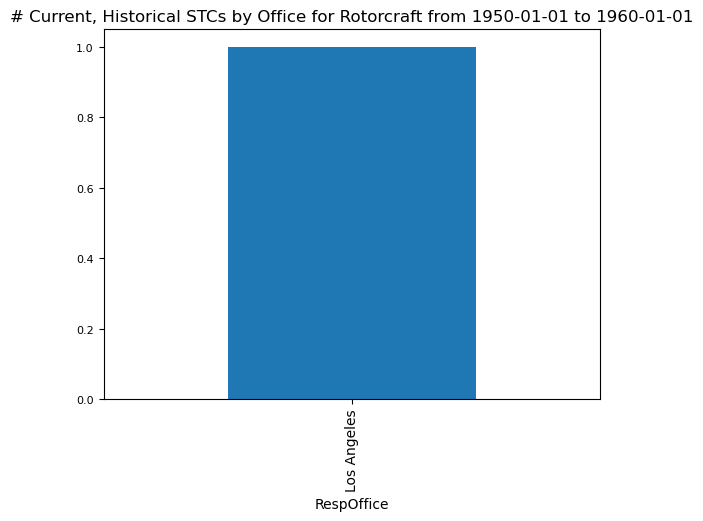

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


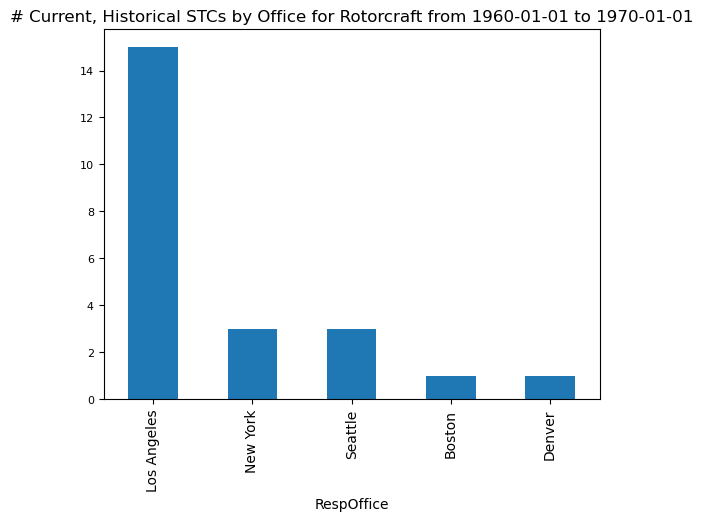

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


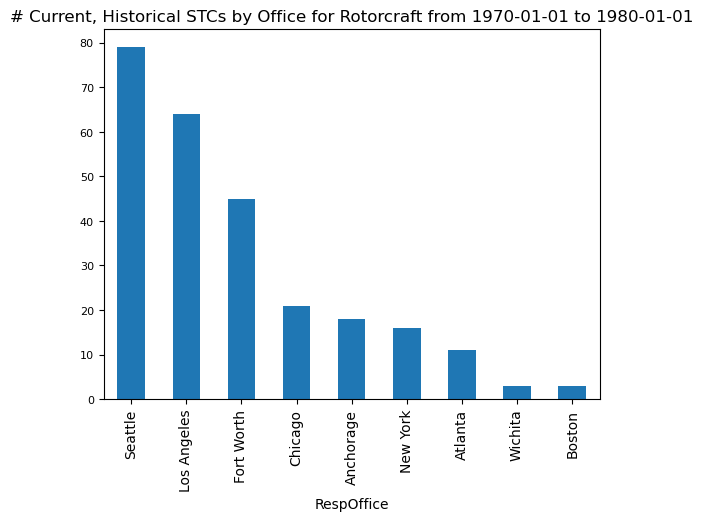

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


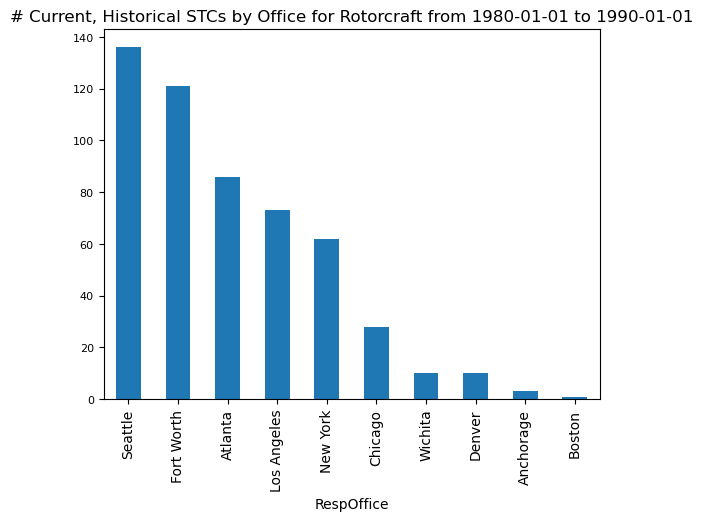

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


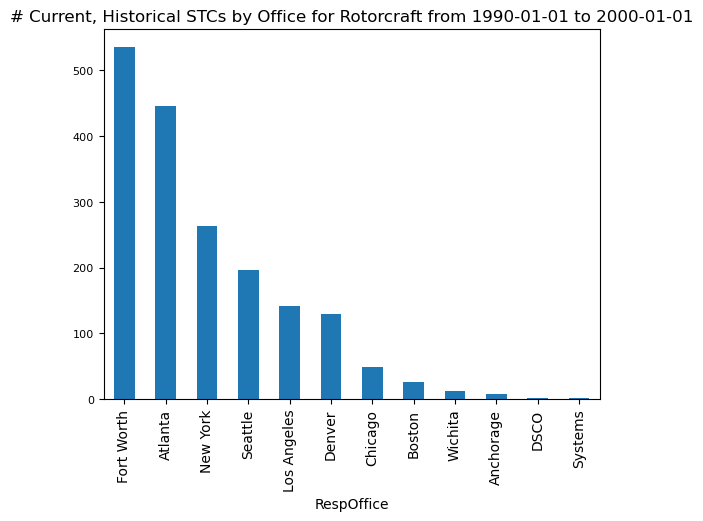

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


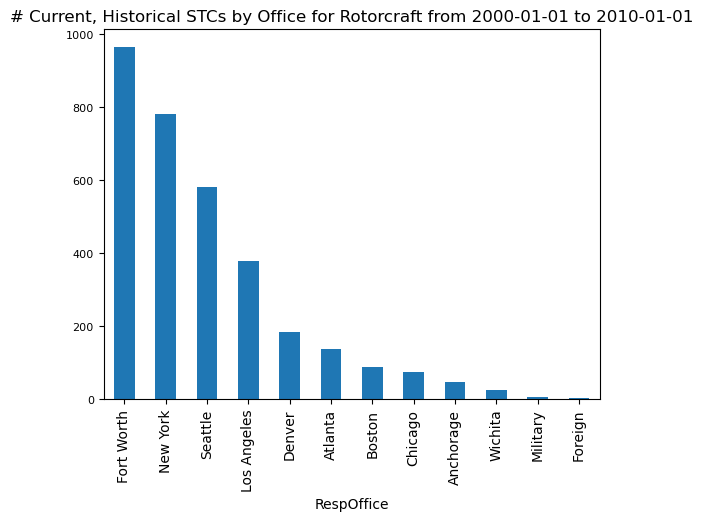

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


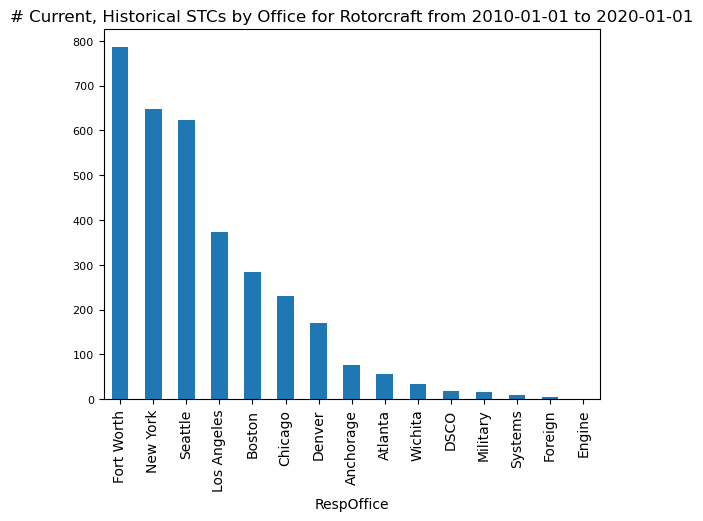

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


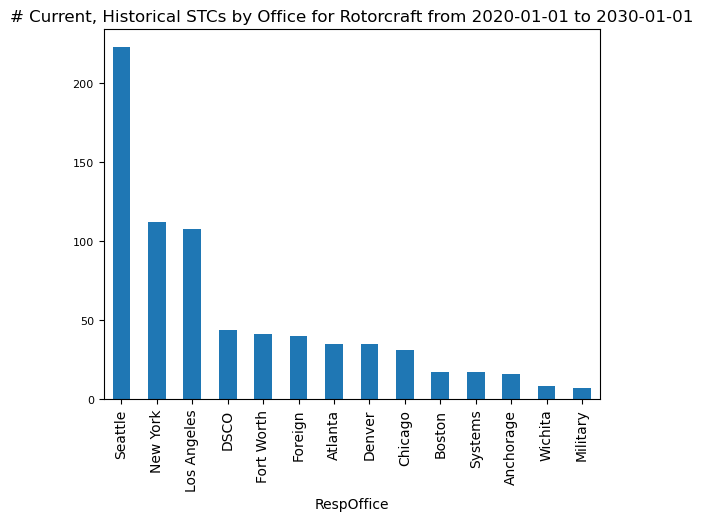

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


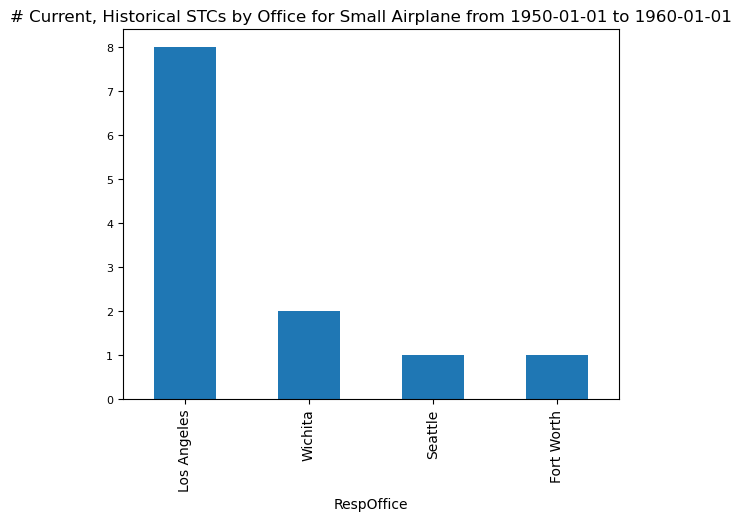

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


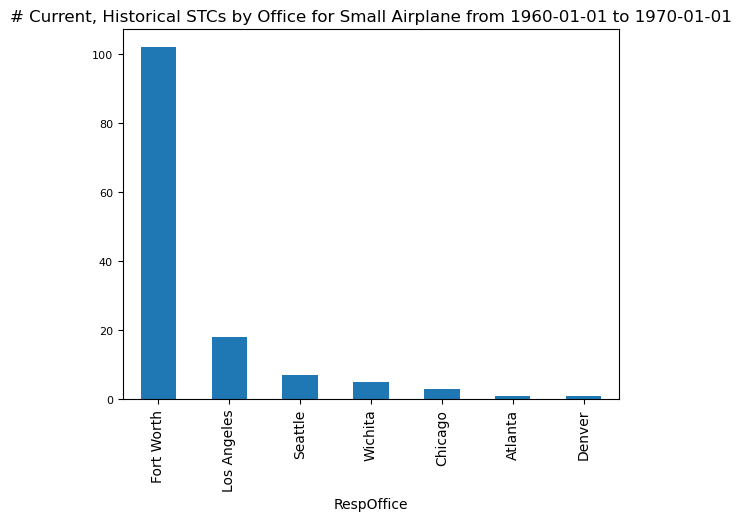

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


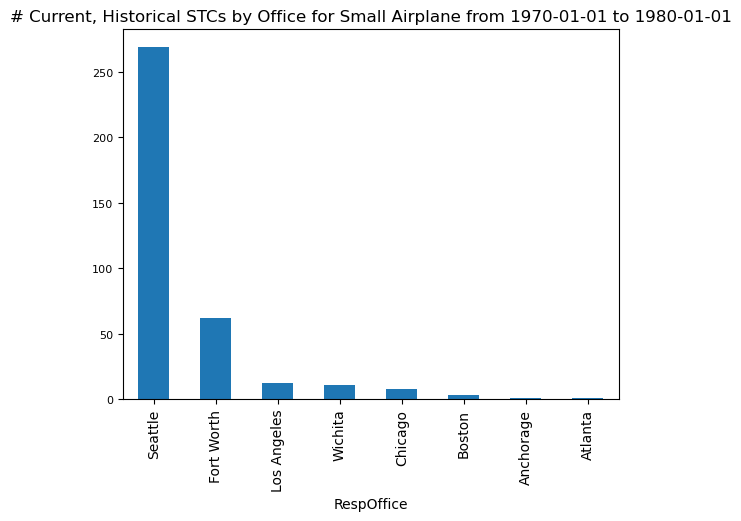

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


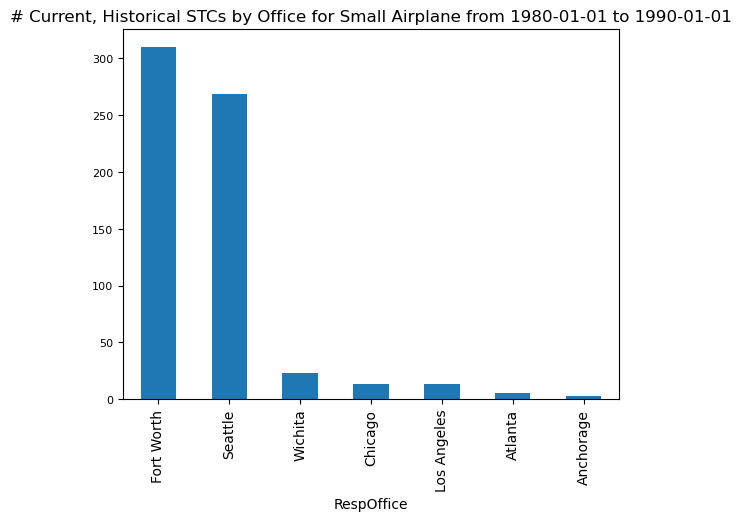

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


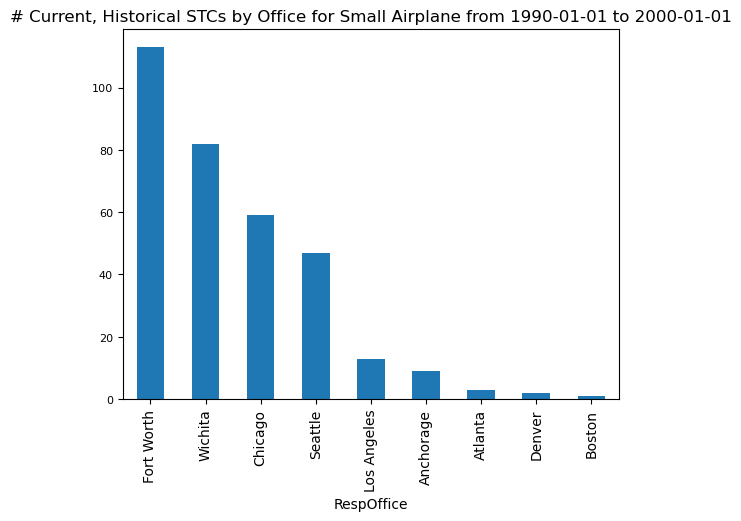

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


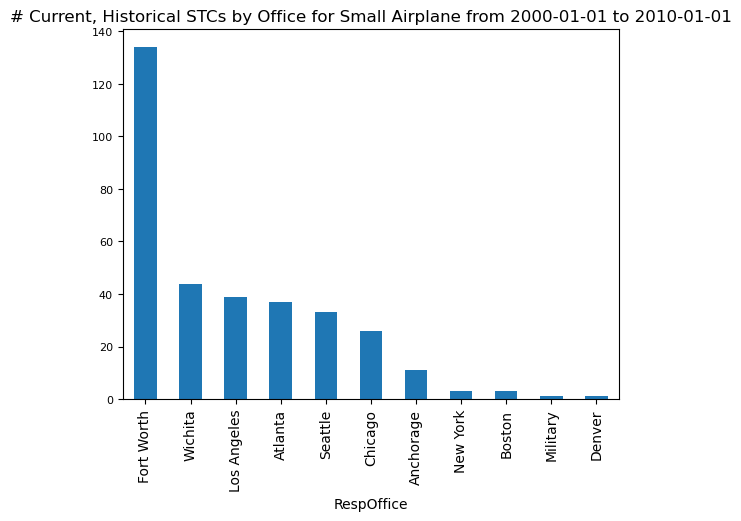

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


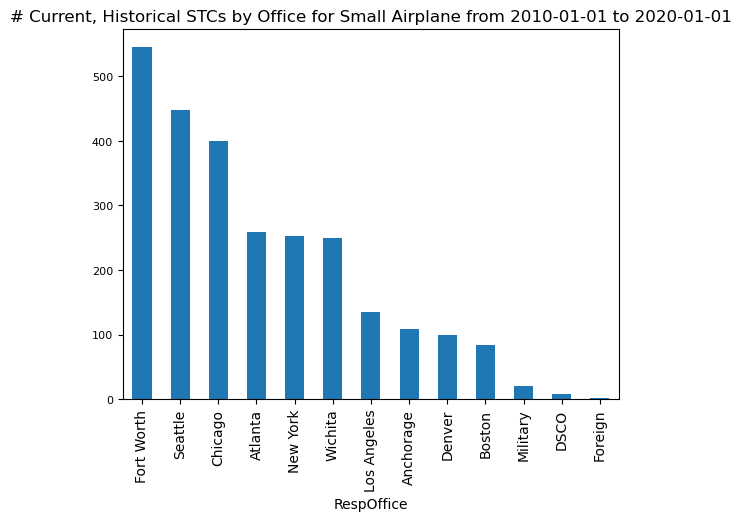

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


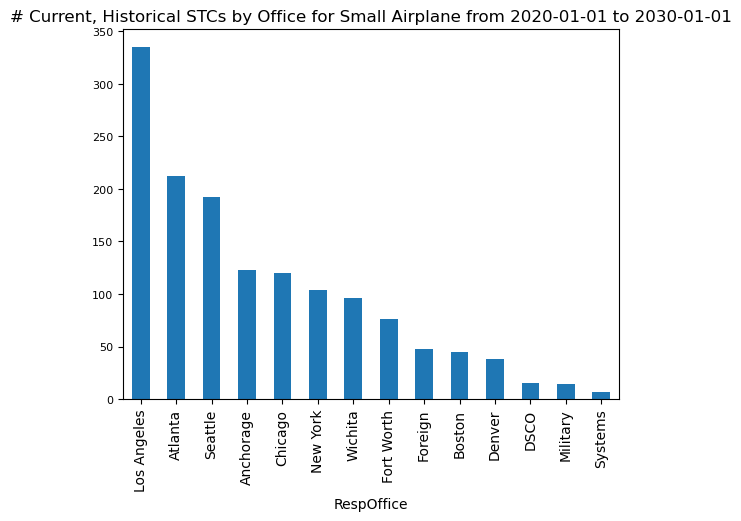

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


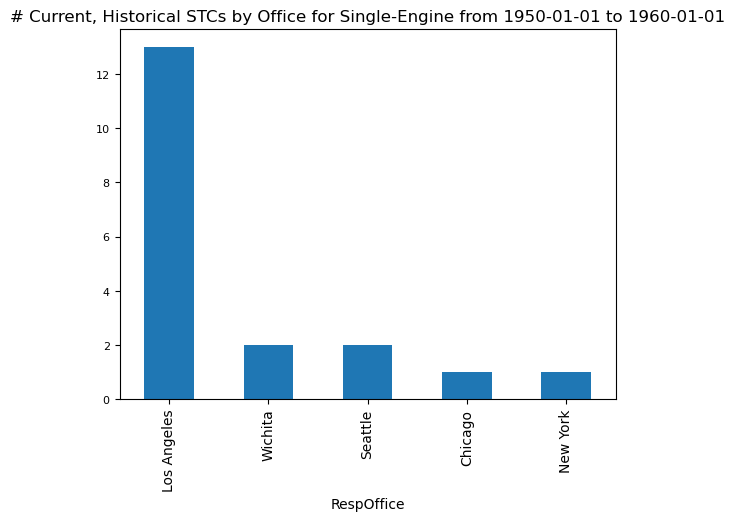

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


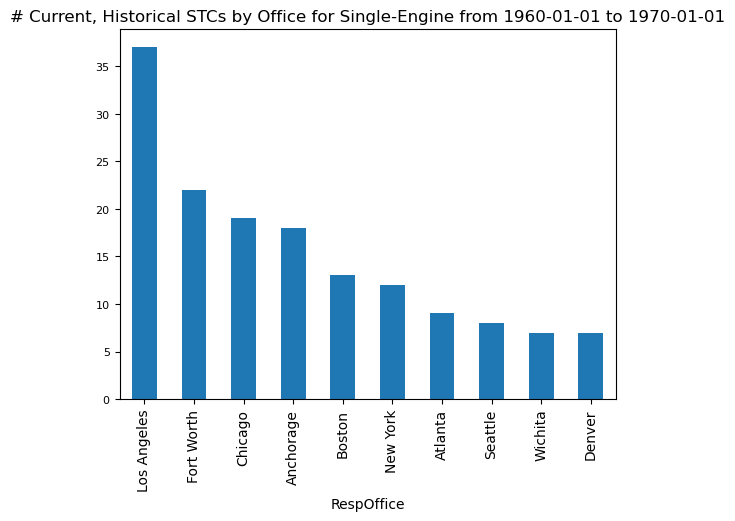

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


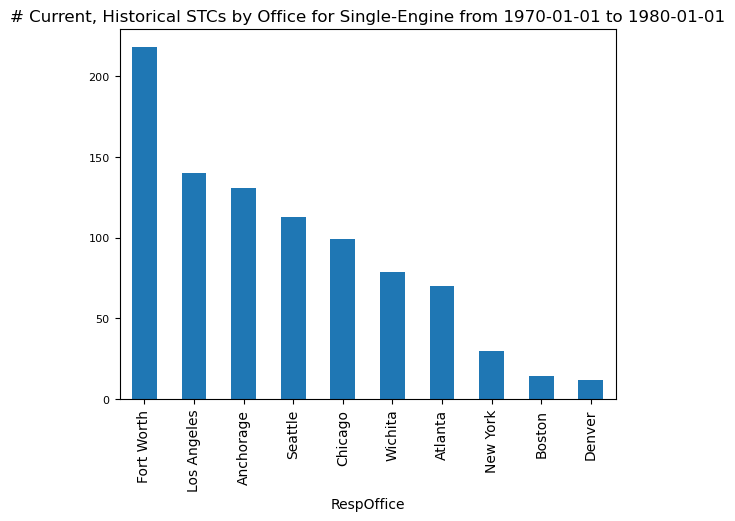

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


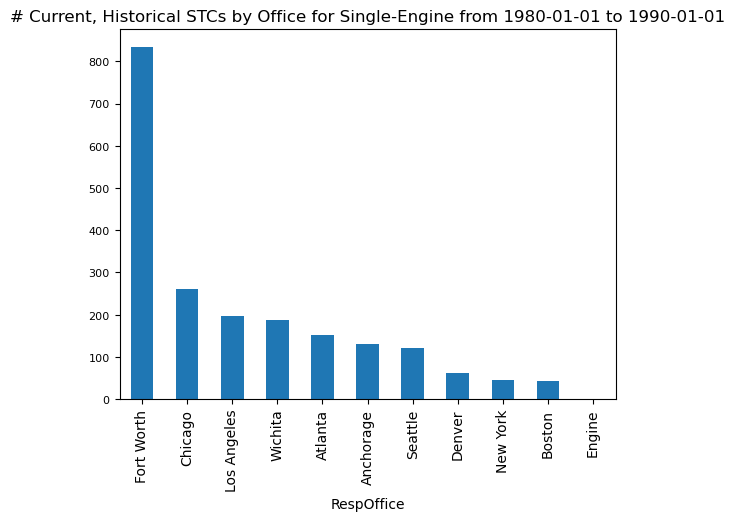

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


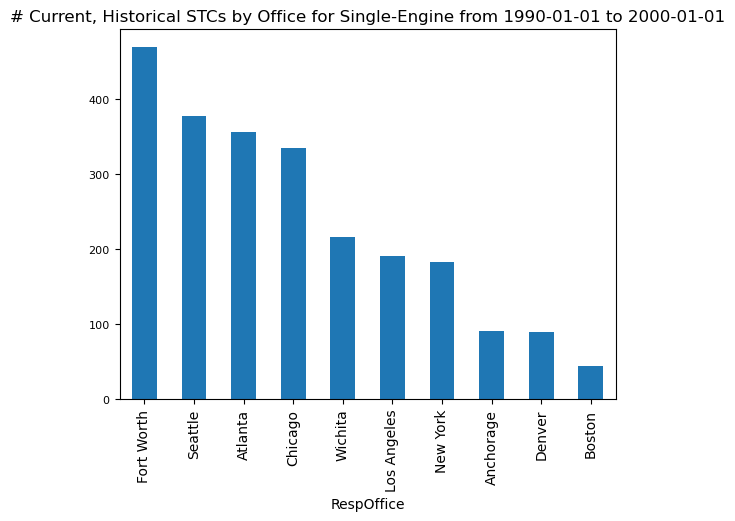

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


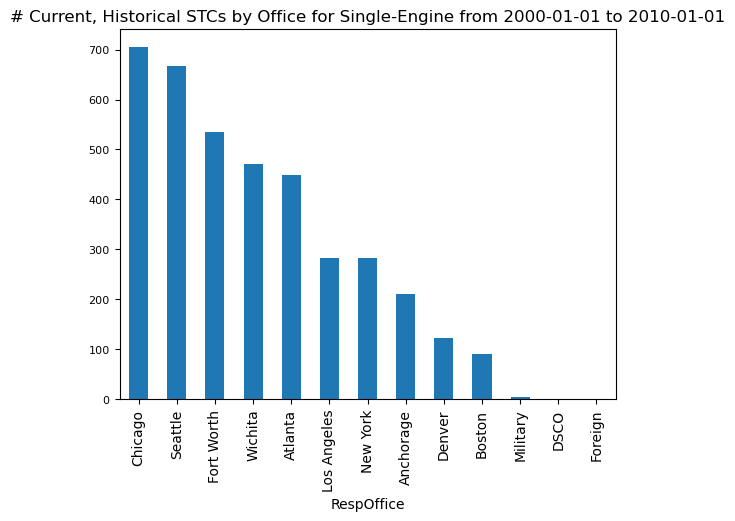

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


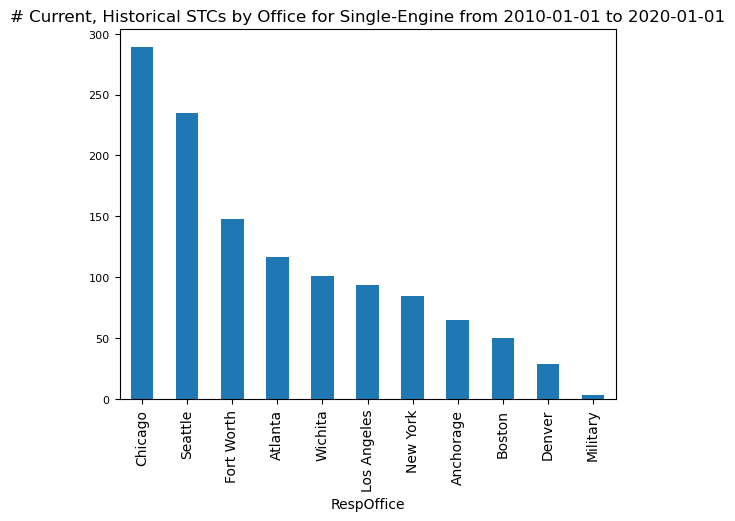

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


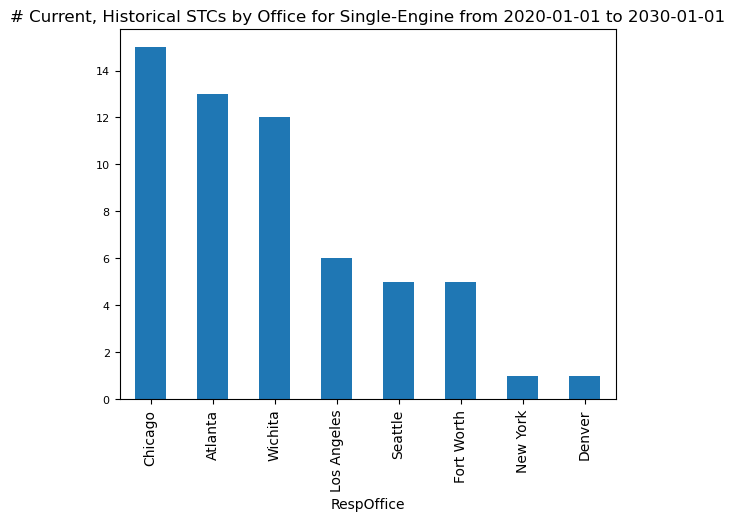

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


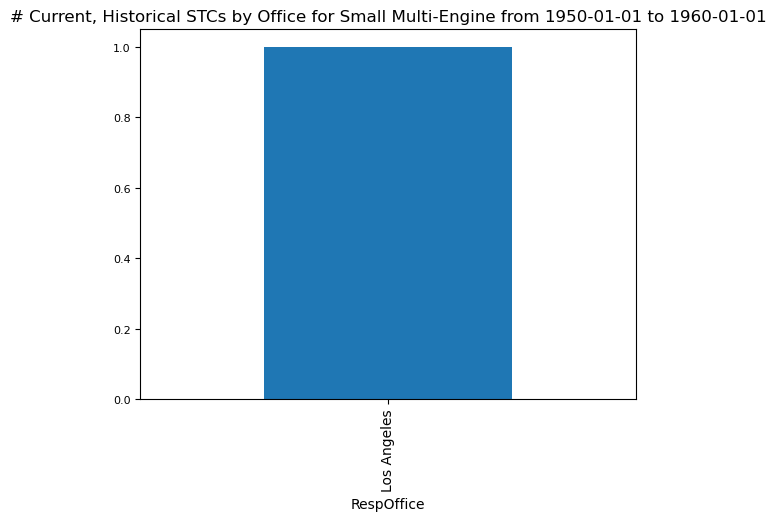

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


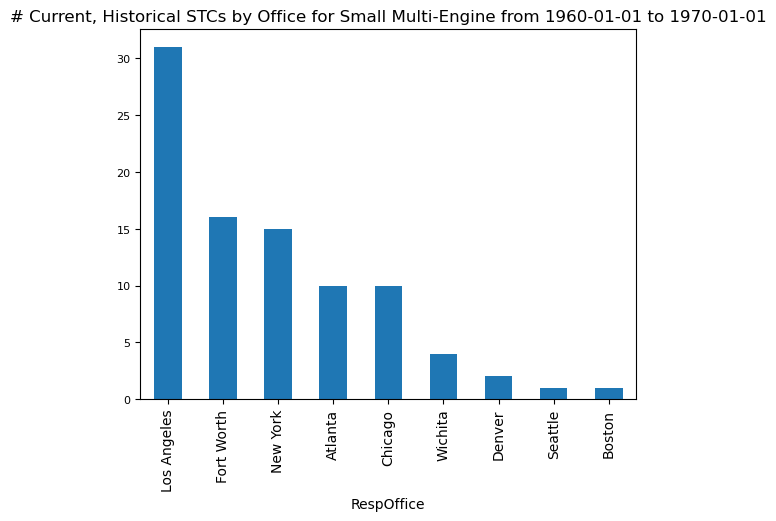

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


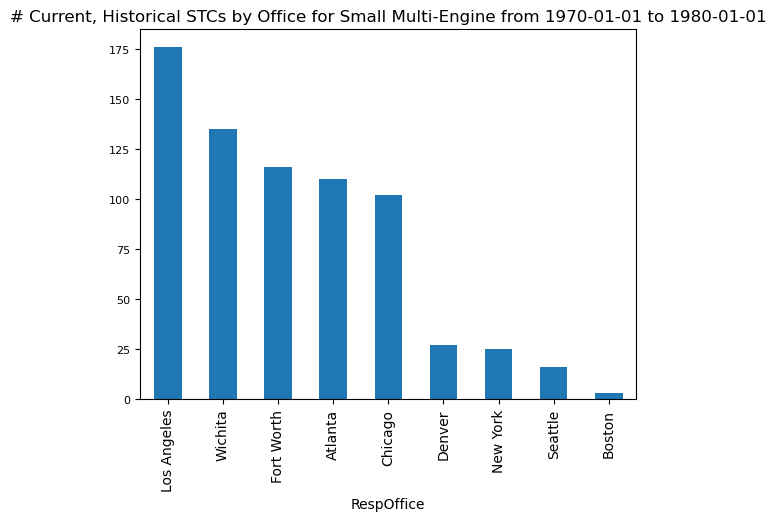

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


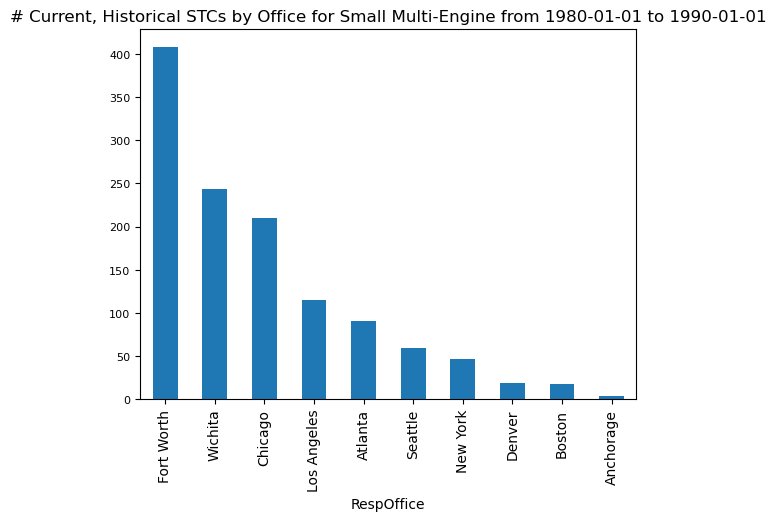

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


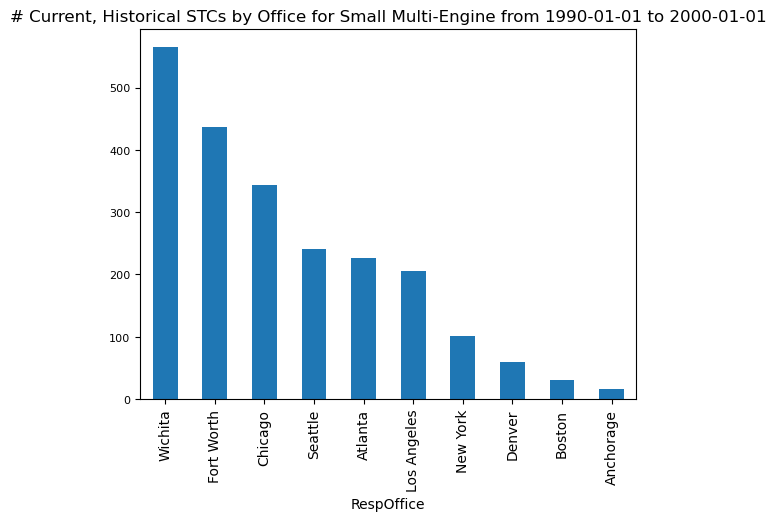

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


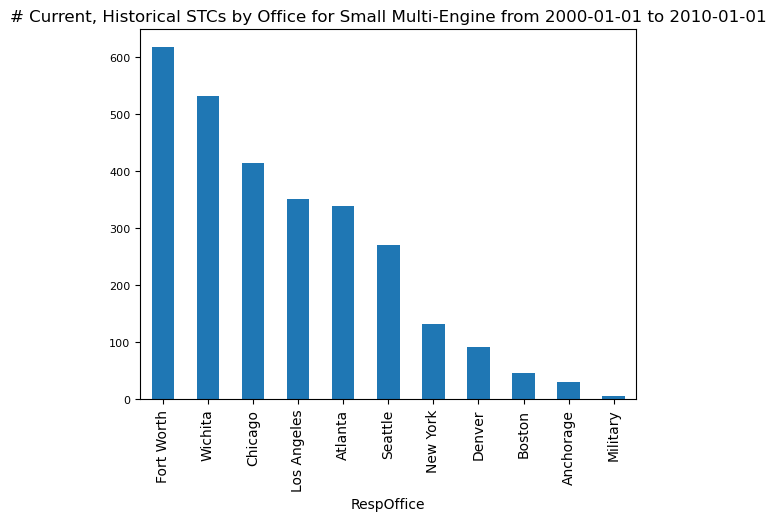

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


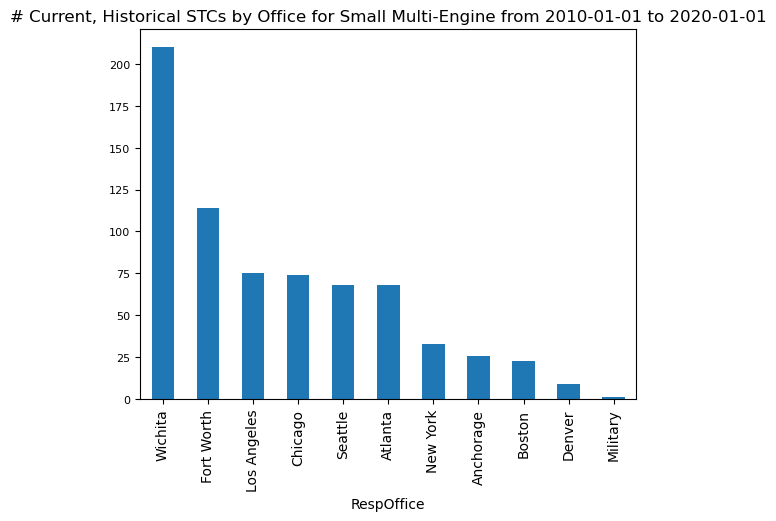

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


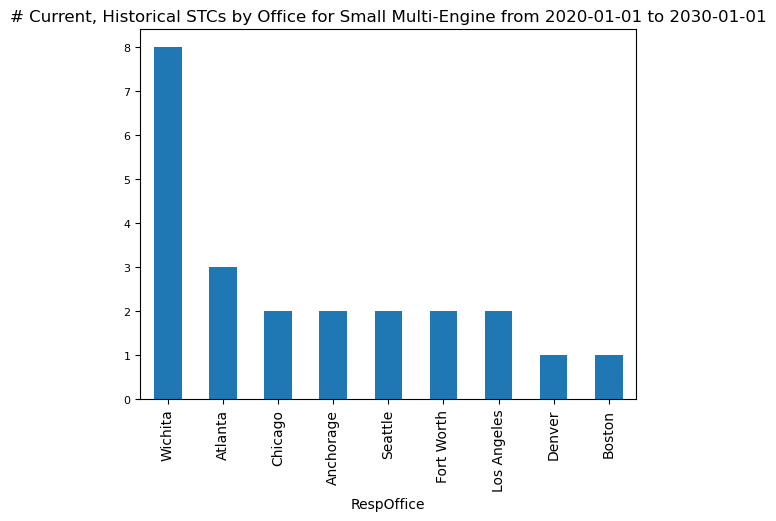

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


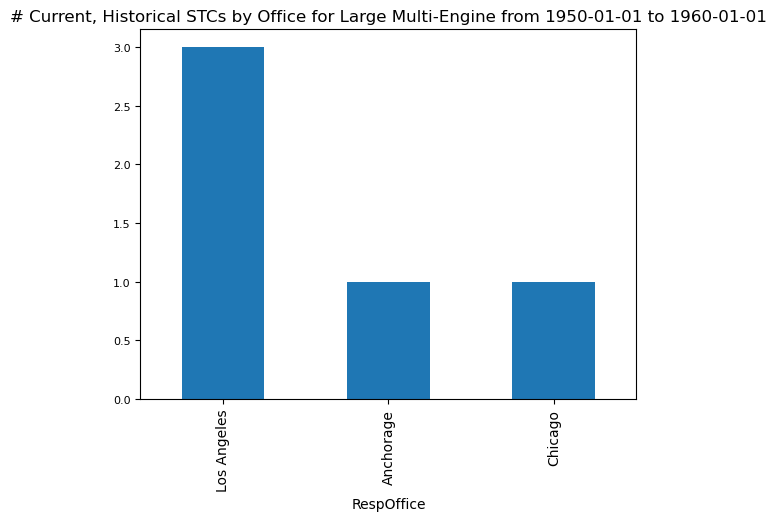

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


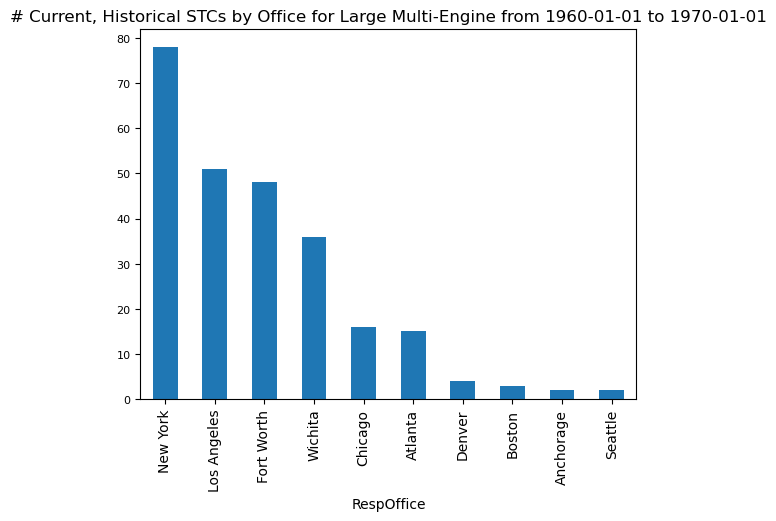

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


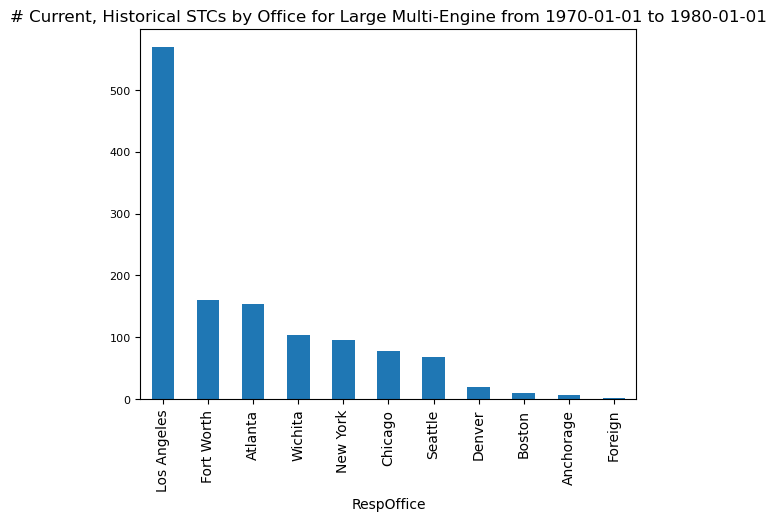

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


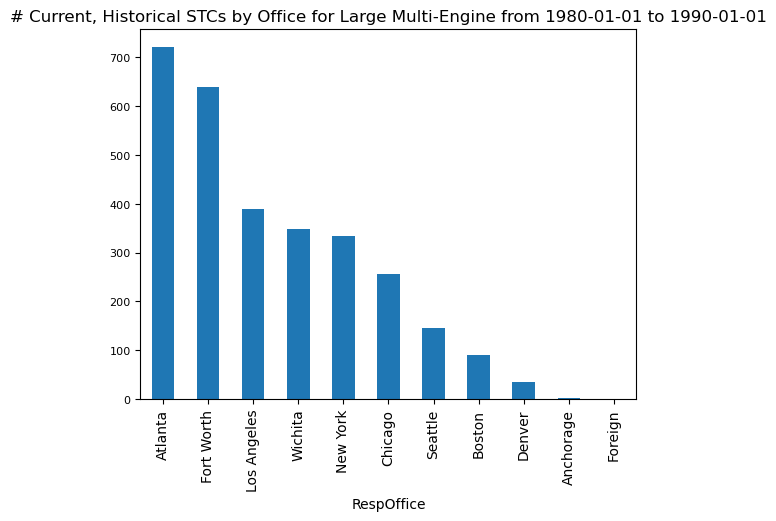

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


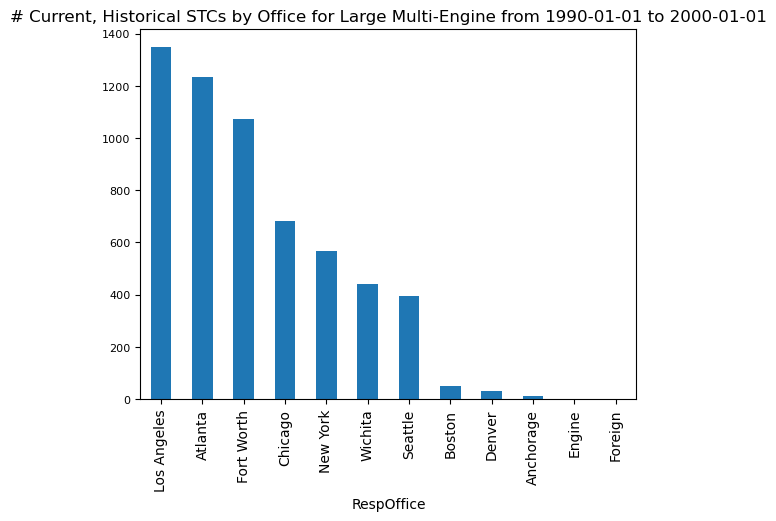

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


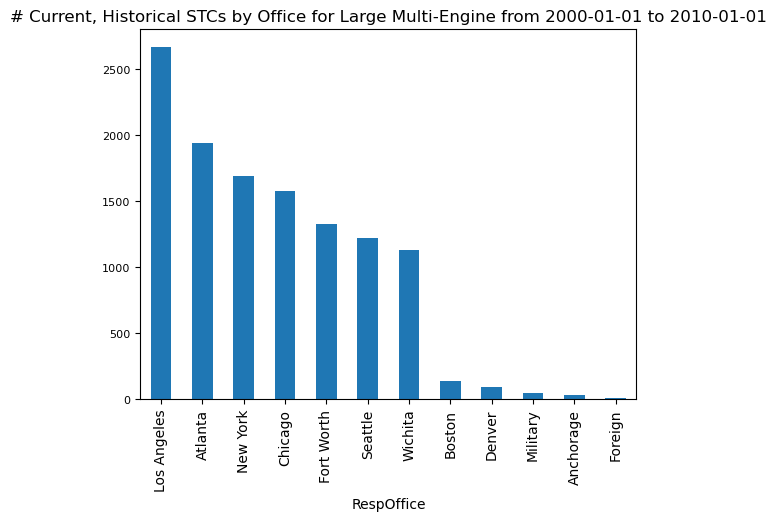

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


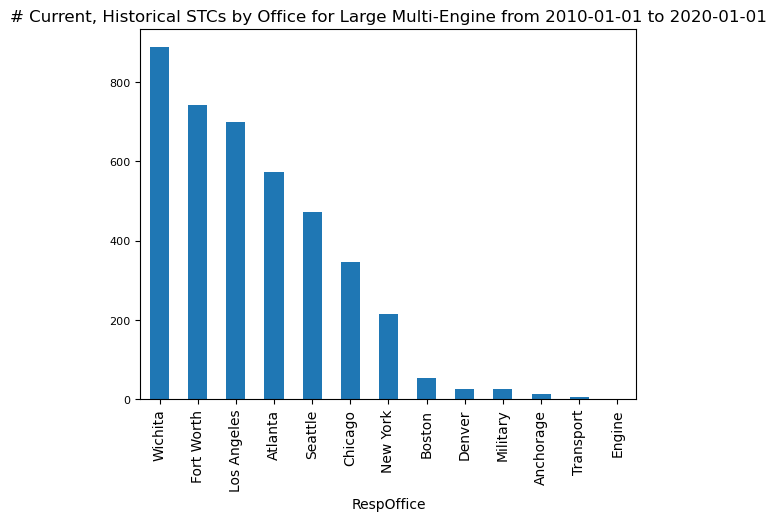

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


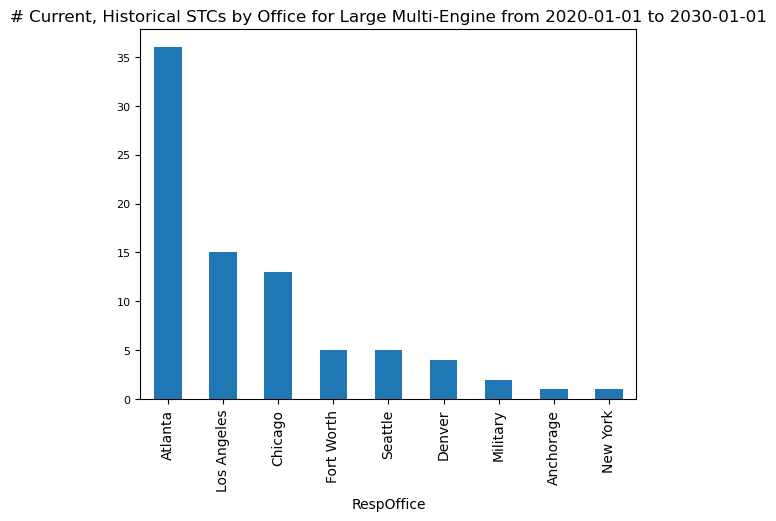

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: Se

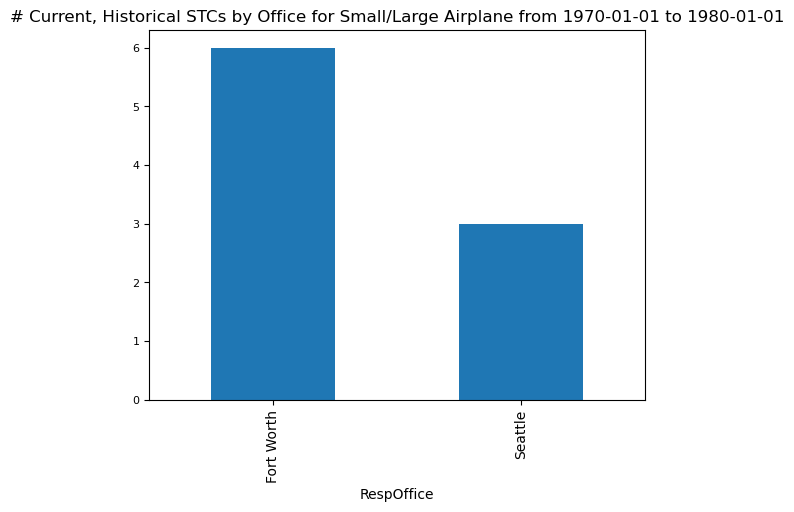

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


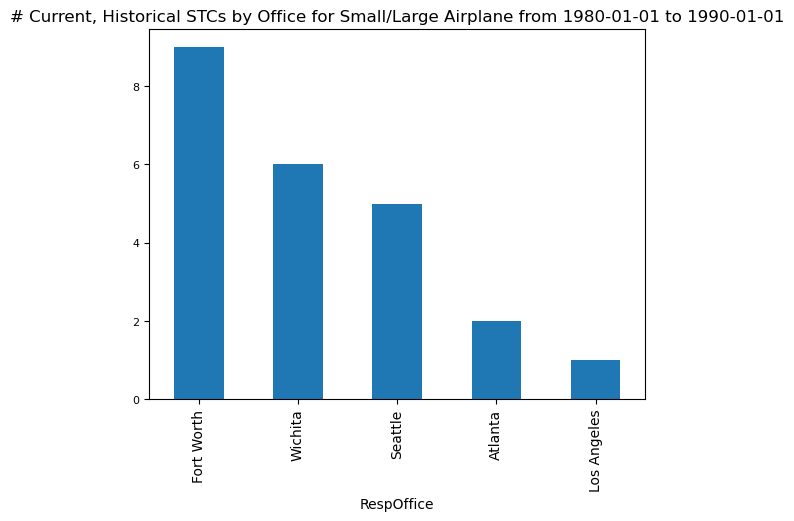

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


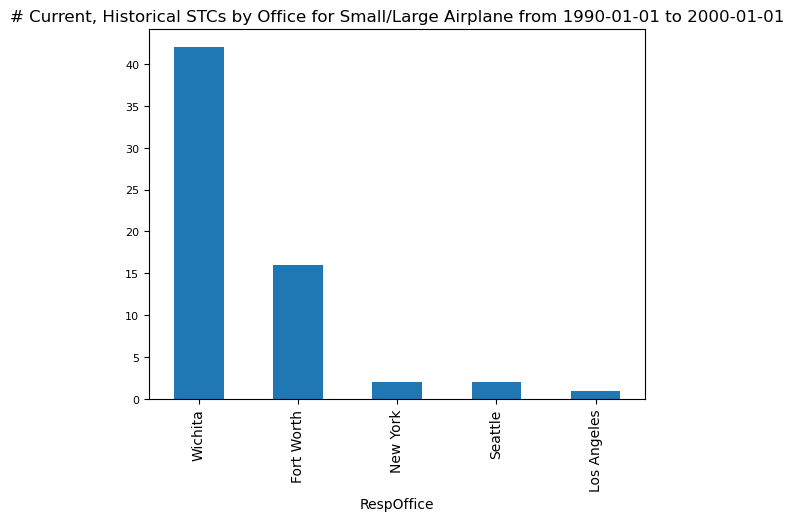

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


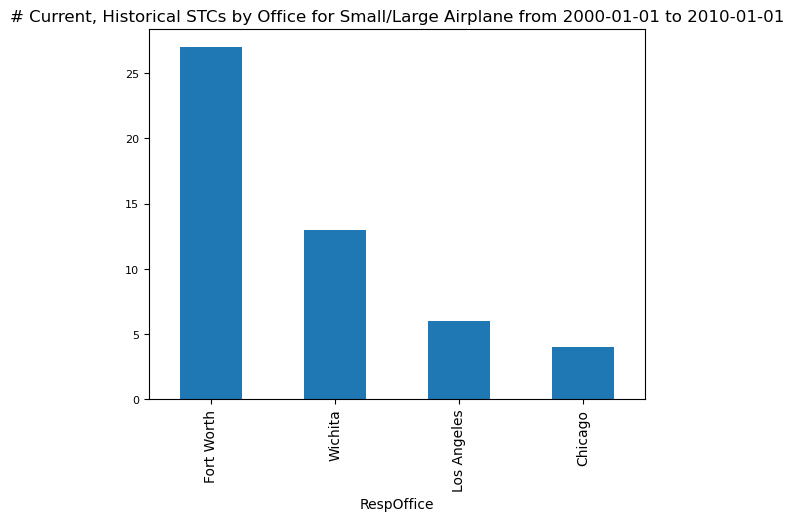

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


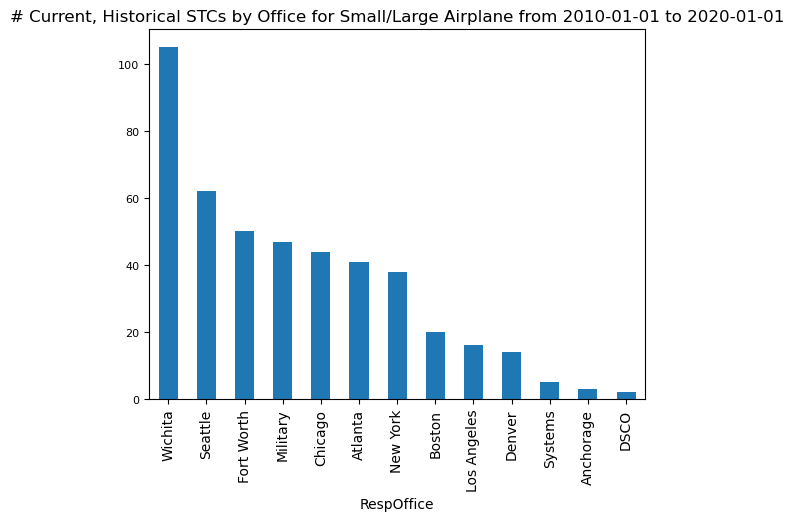

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


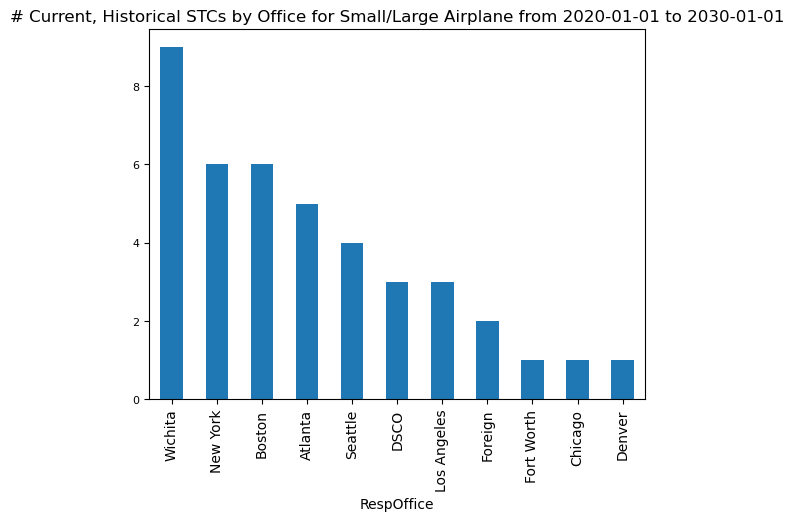

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: Se

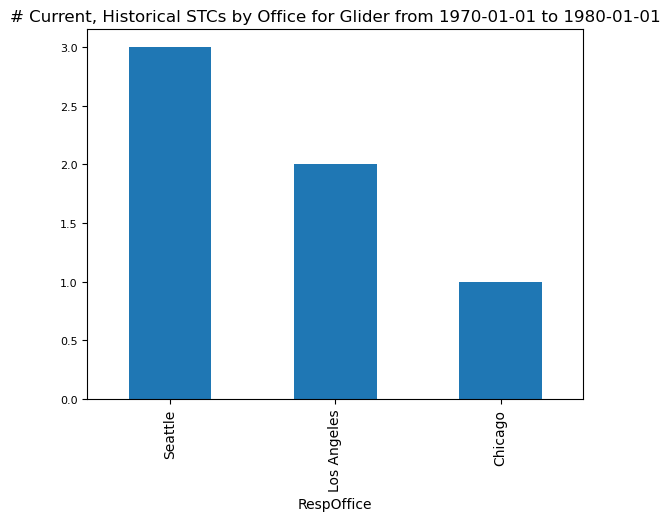

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


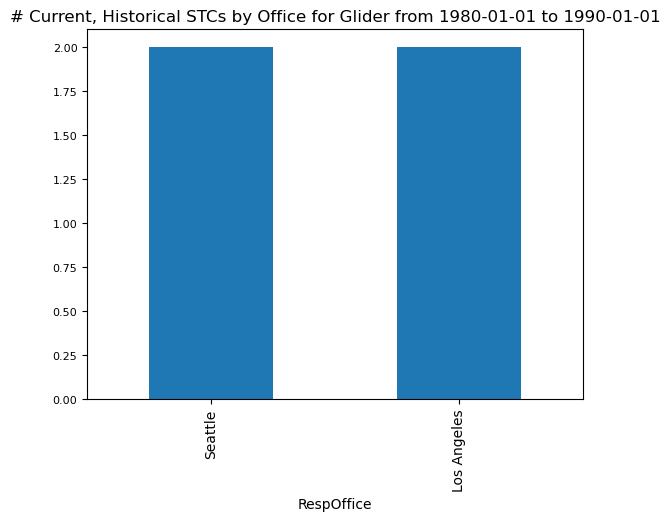

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


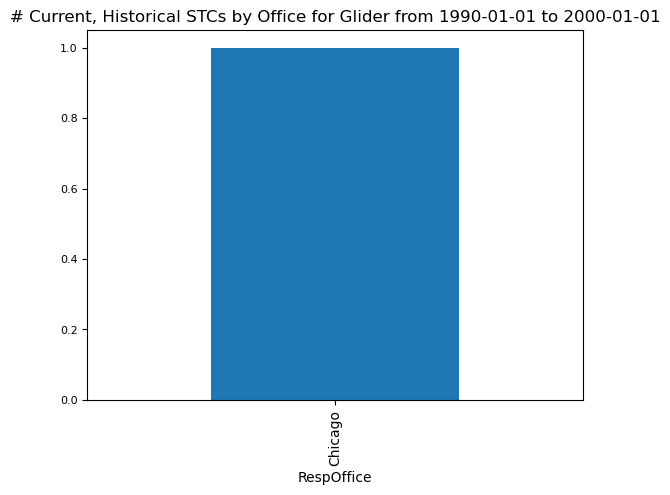

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


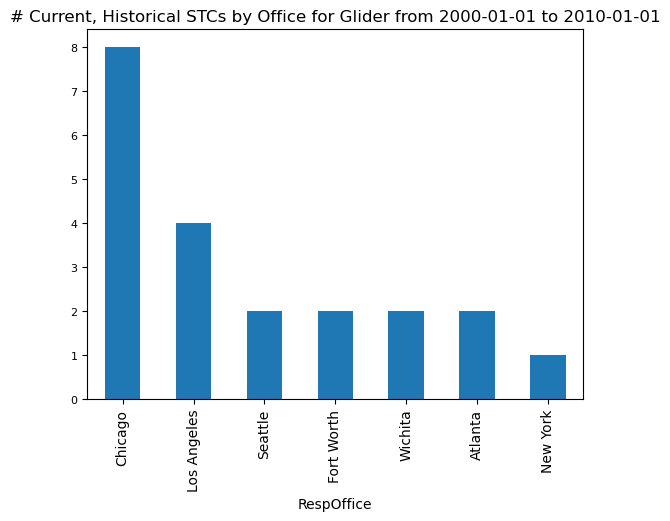

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


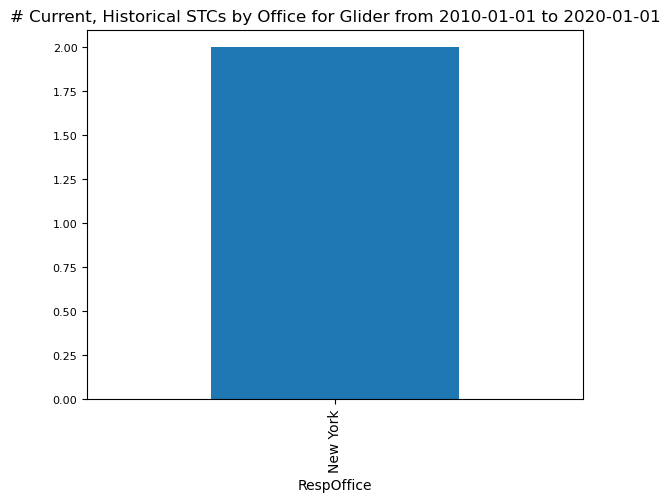

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


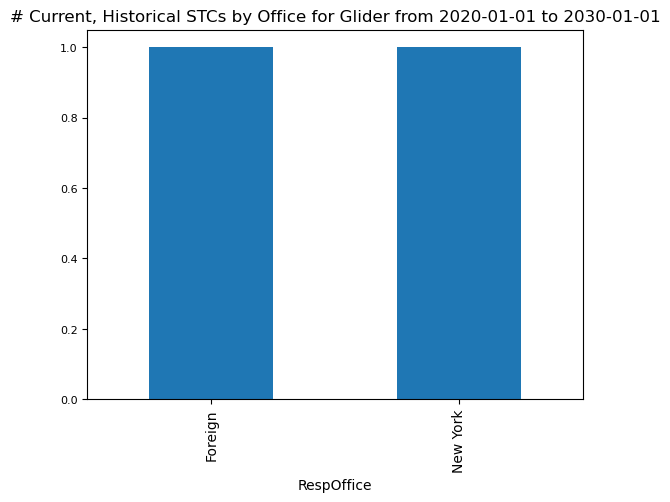

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: Se

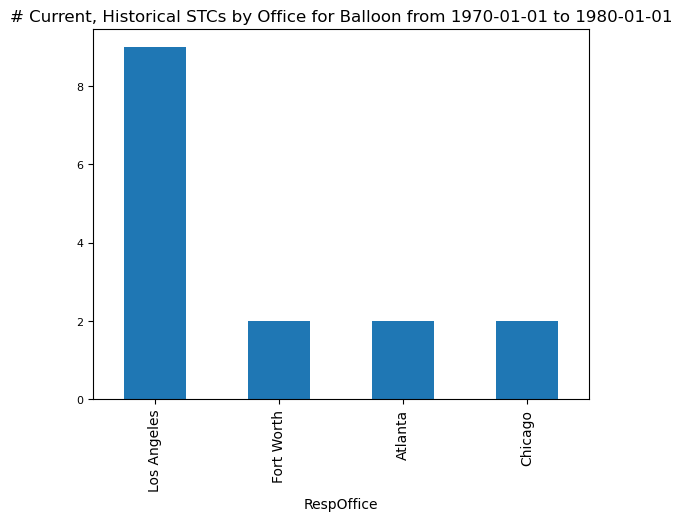

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


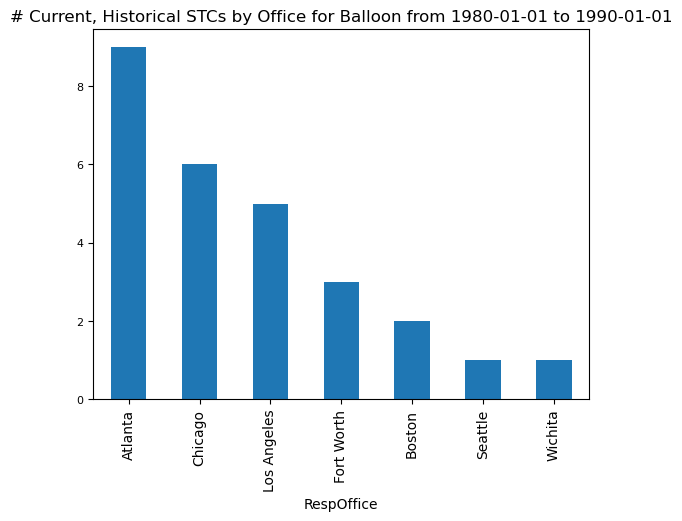

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


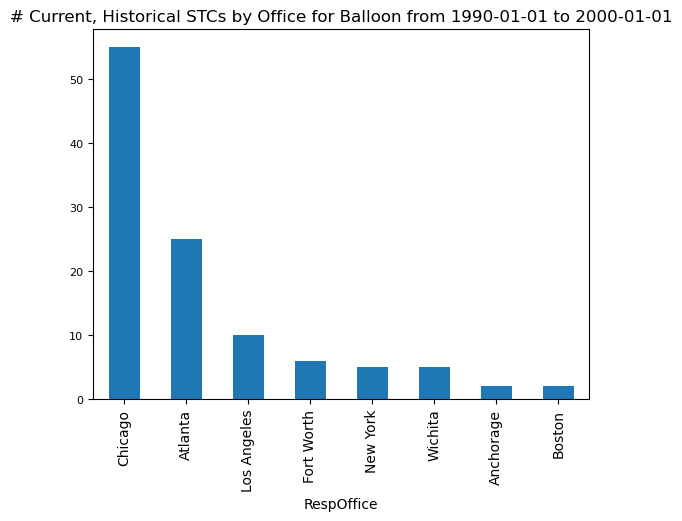

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


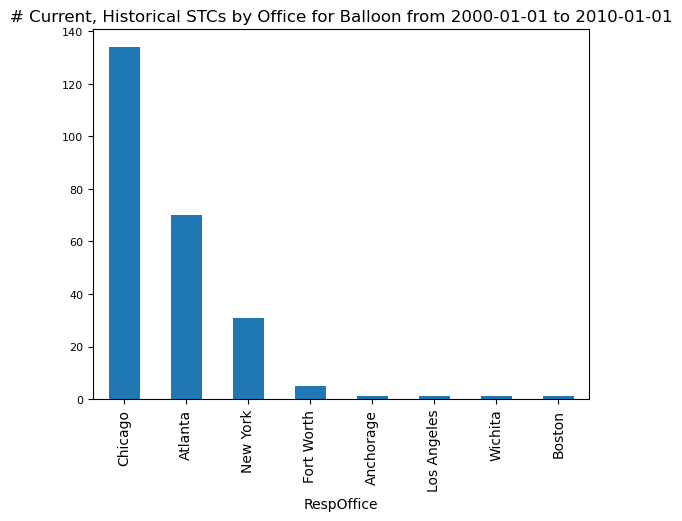

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


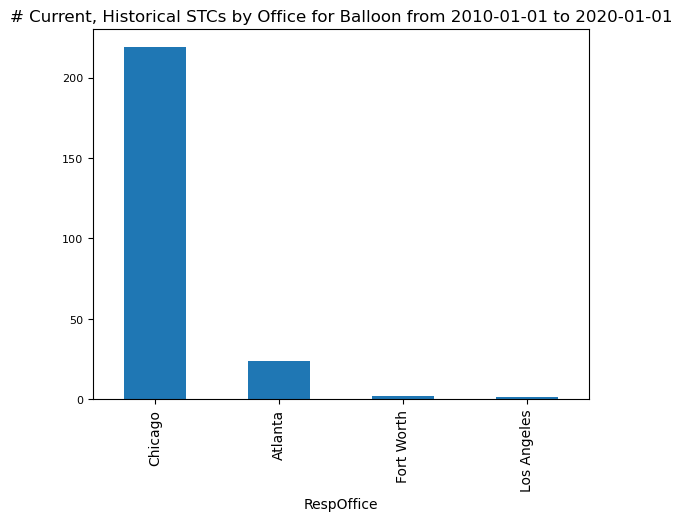

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


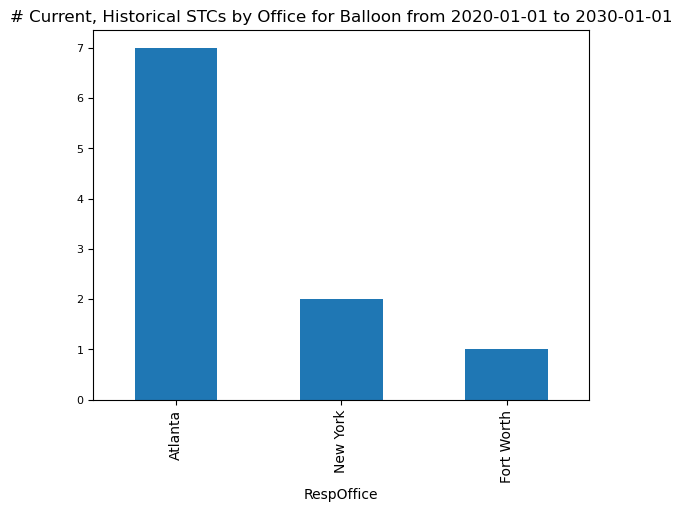

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: Se

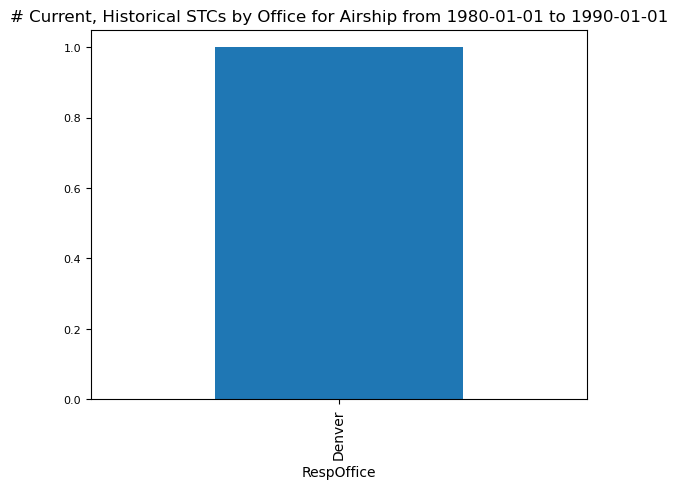

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


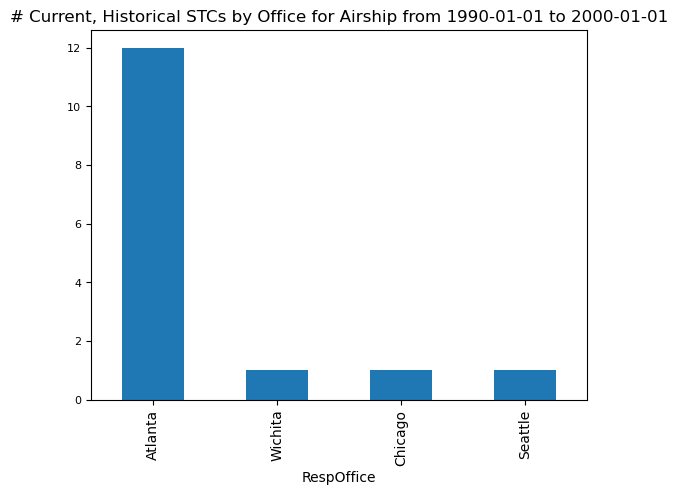

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


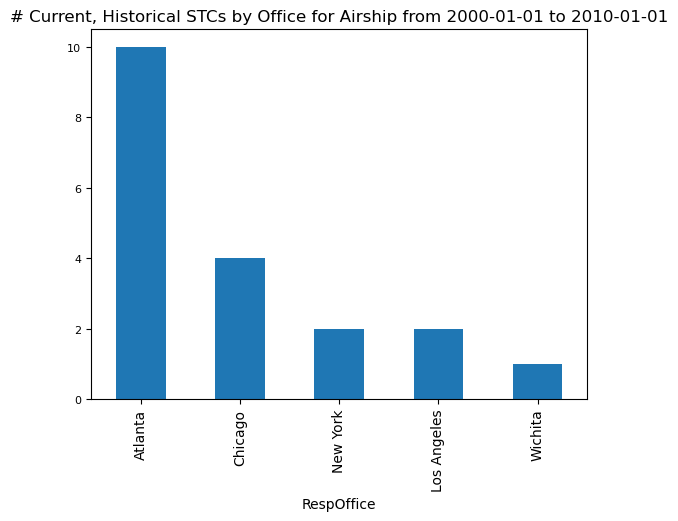

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


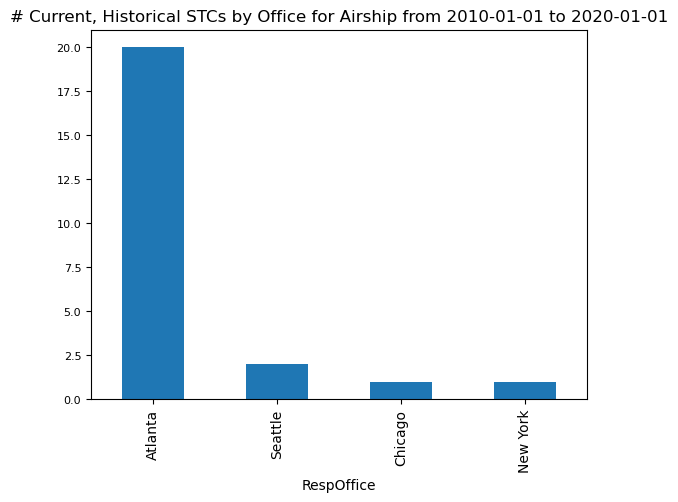

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: Us

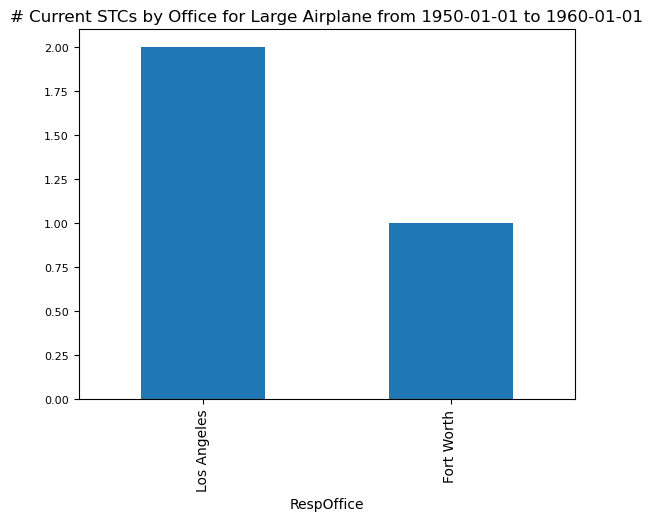

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


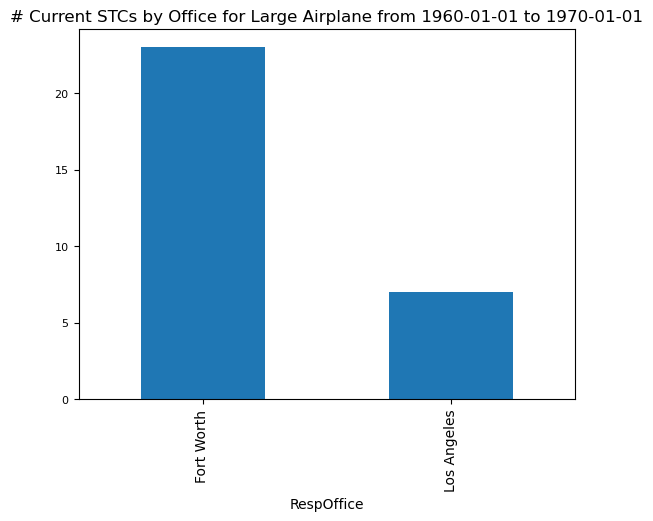

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


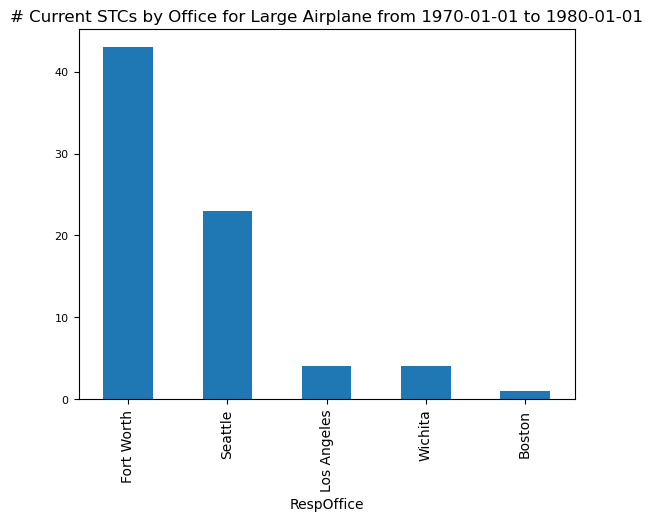

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


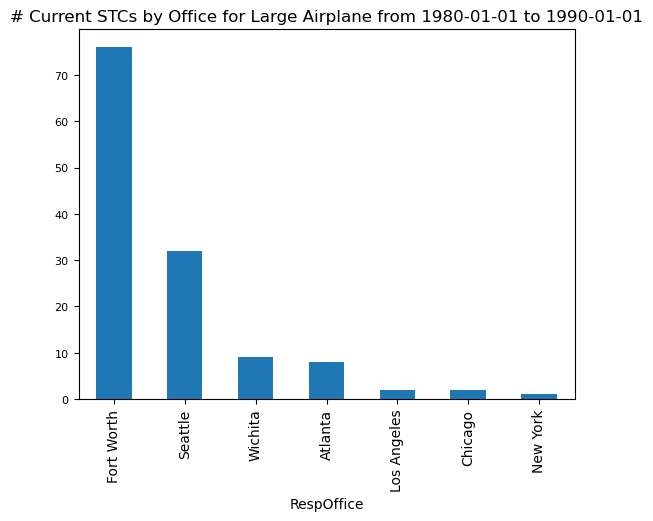

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


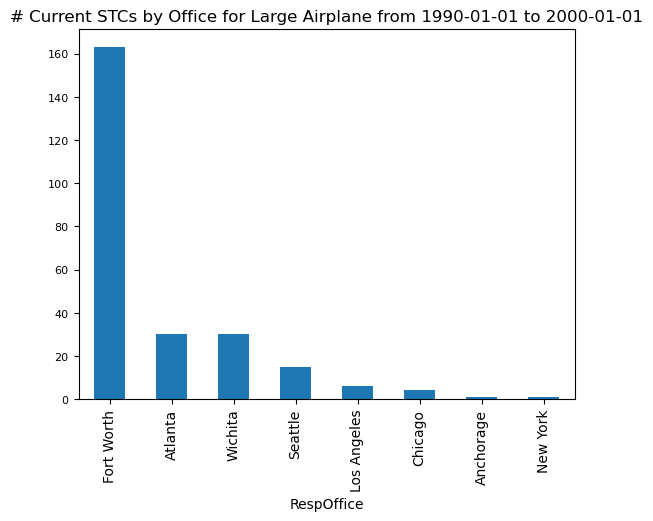

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


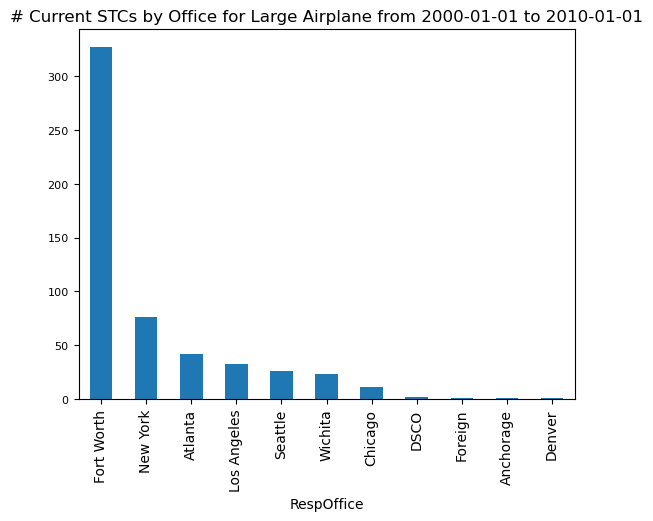

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


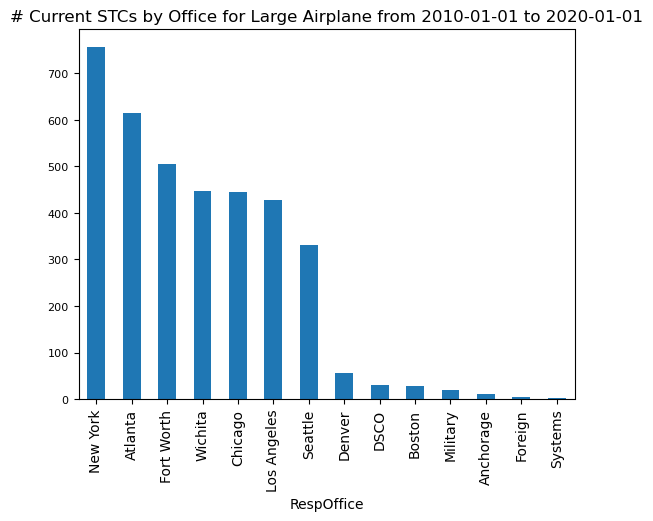

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


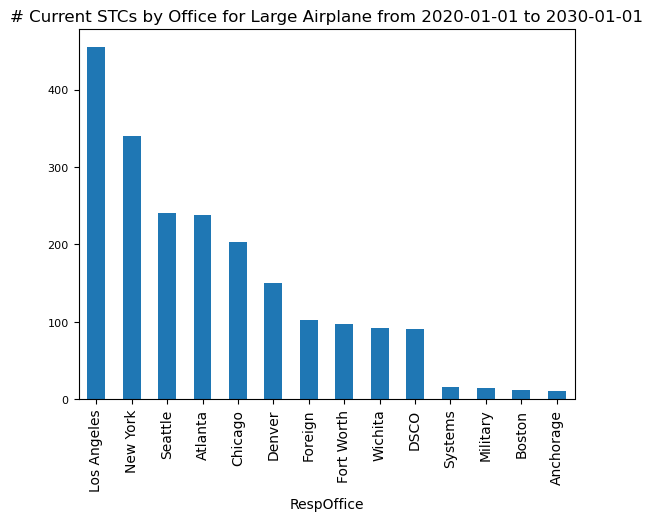

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


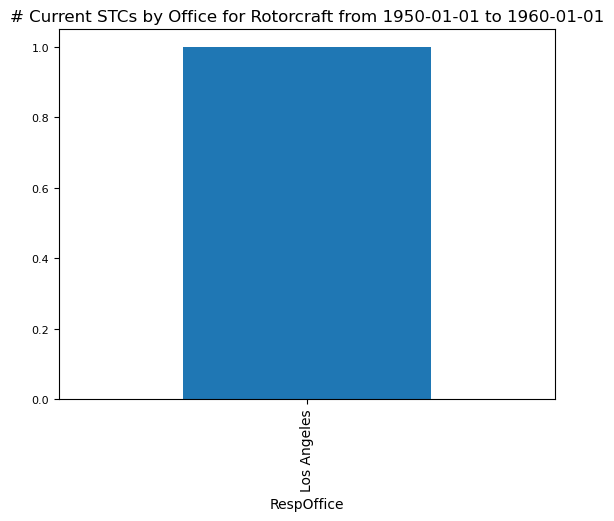

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


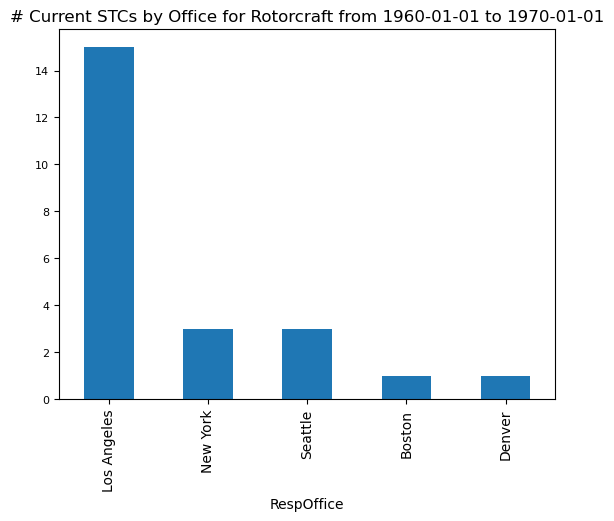

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


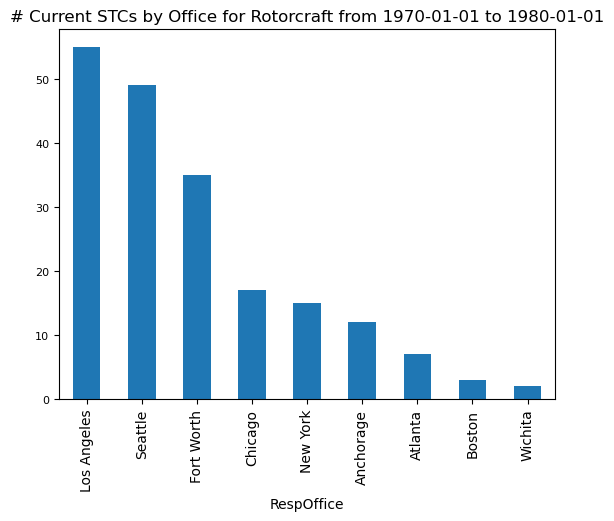

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


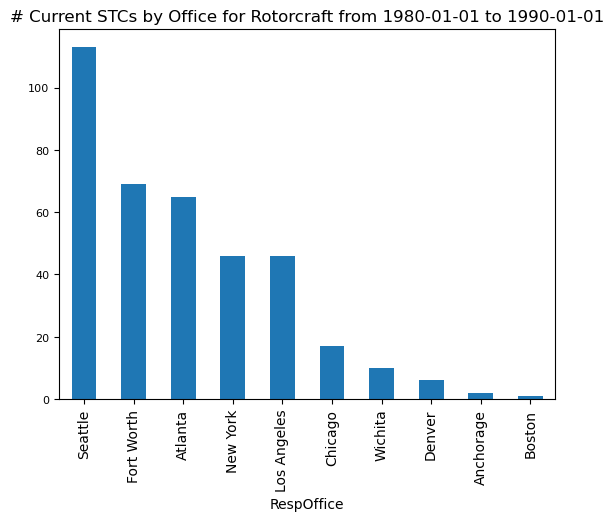

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


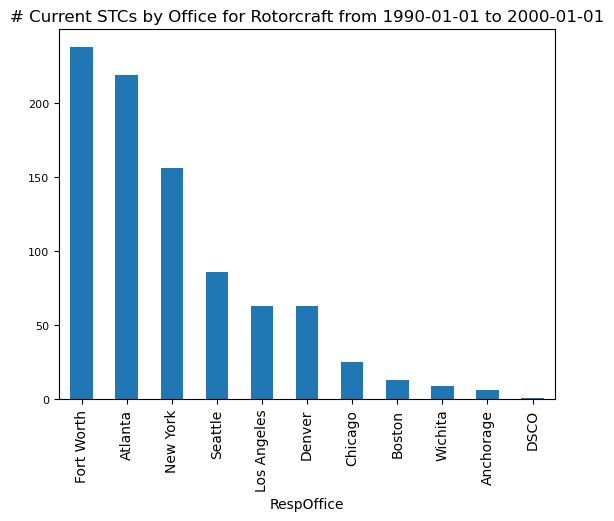

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


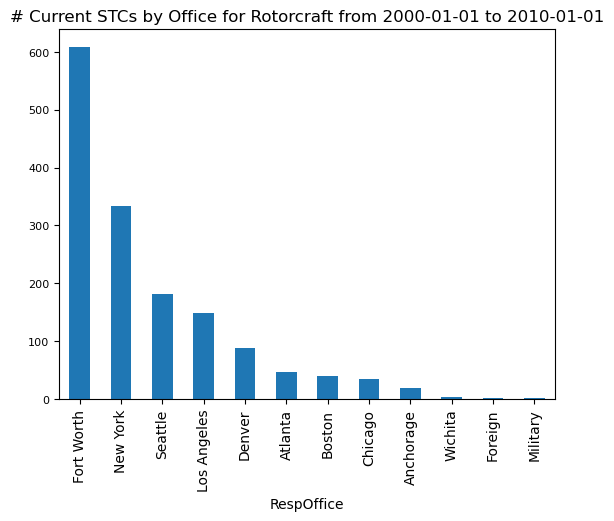

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


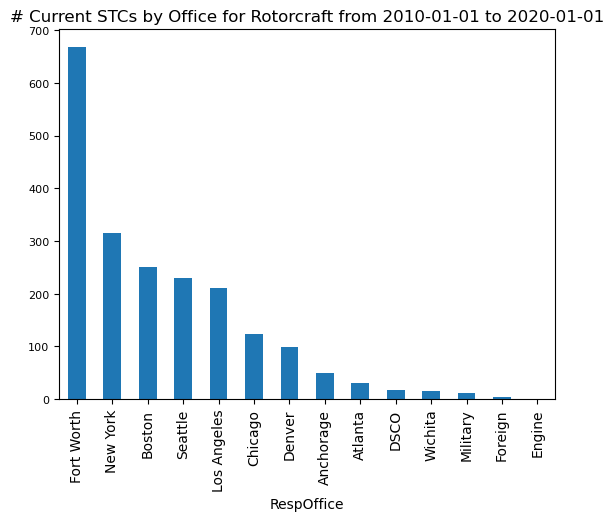

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


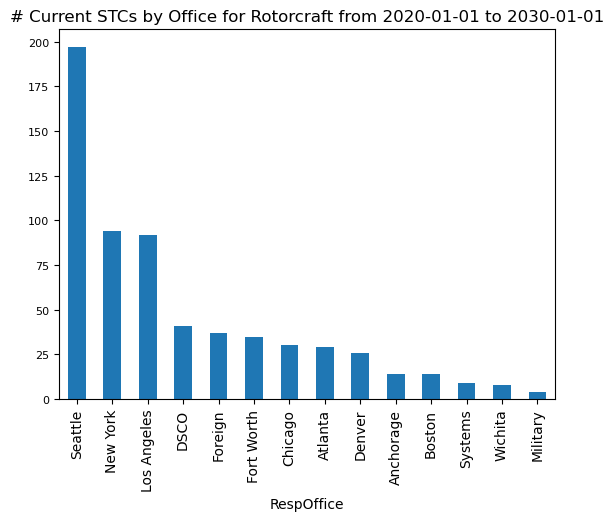

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


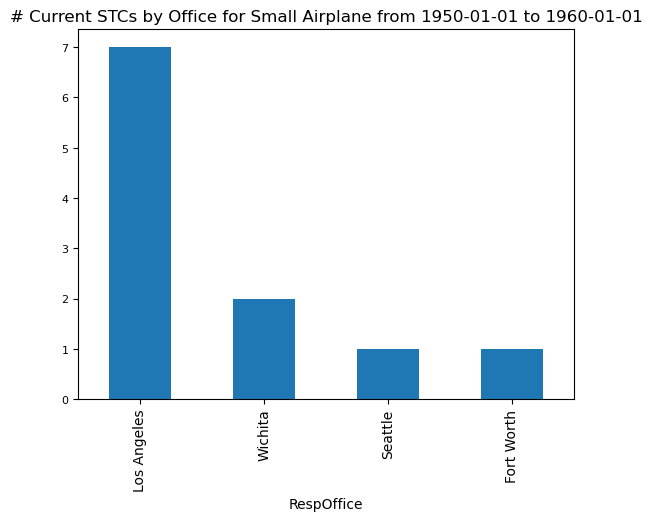

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


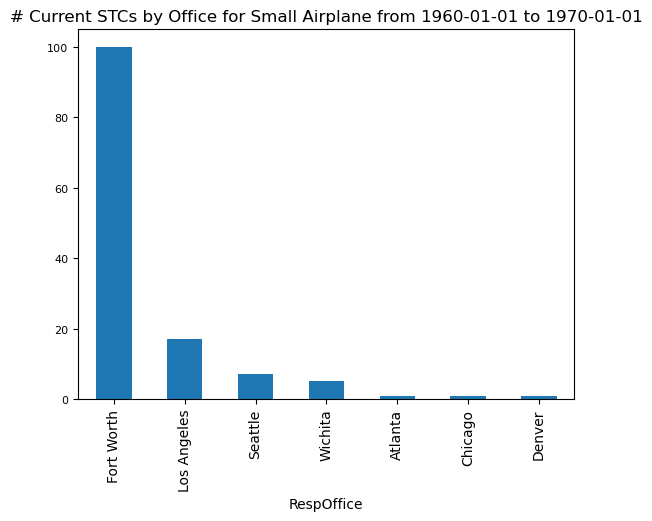

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


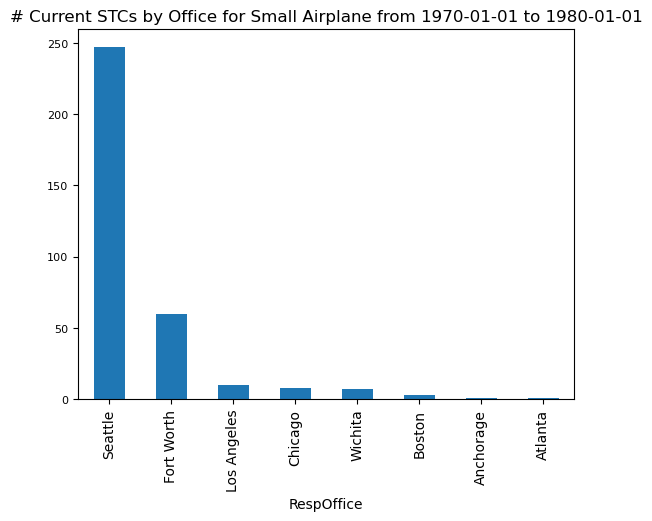

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


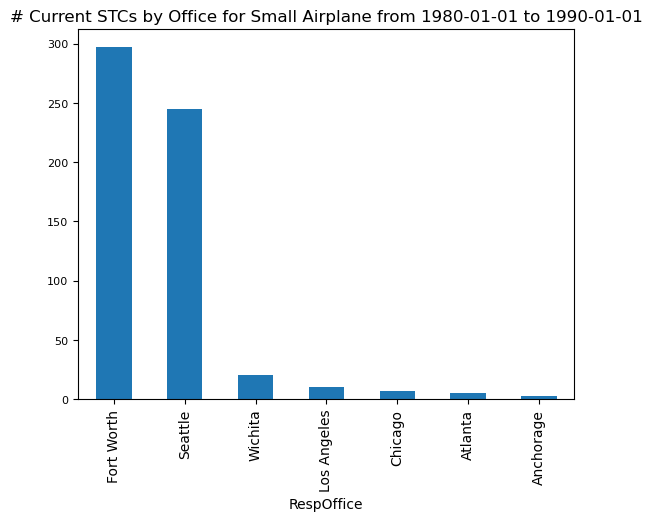

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


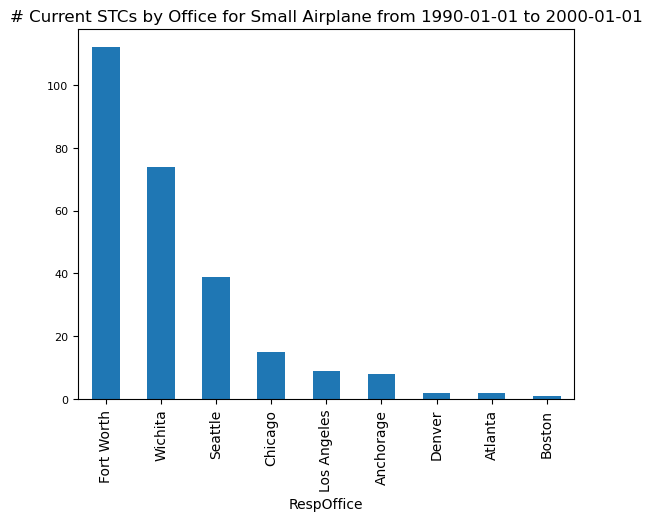

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


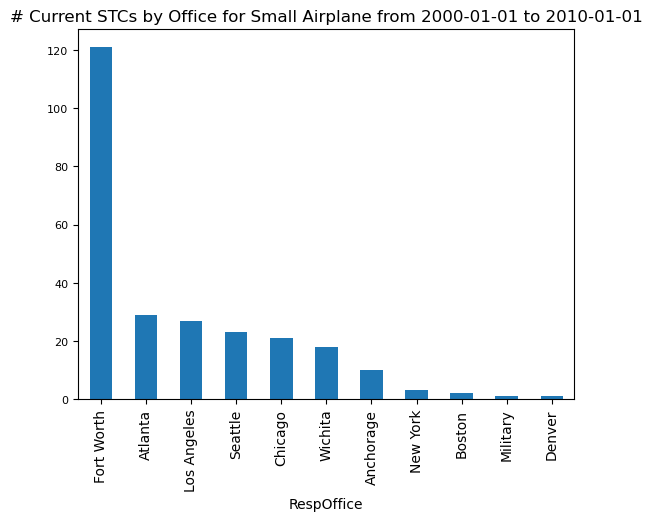

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


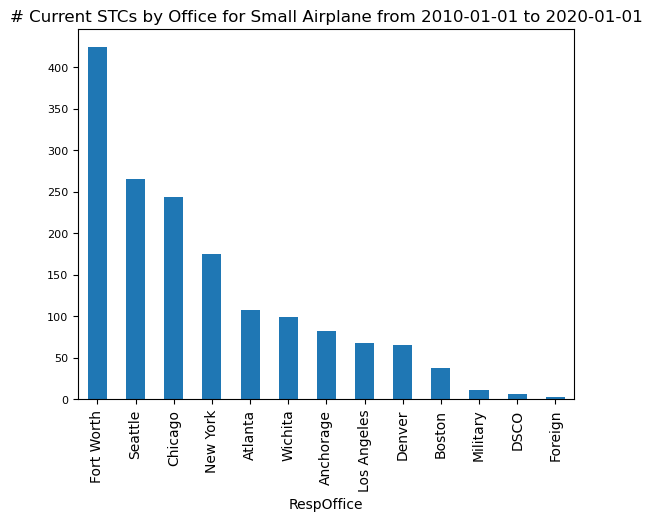

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


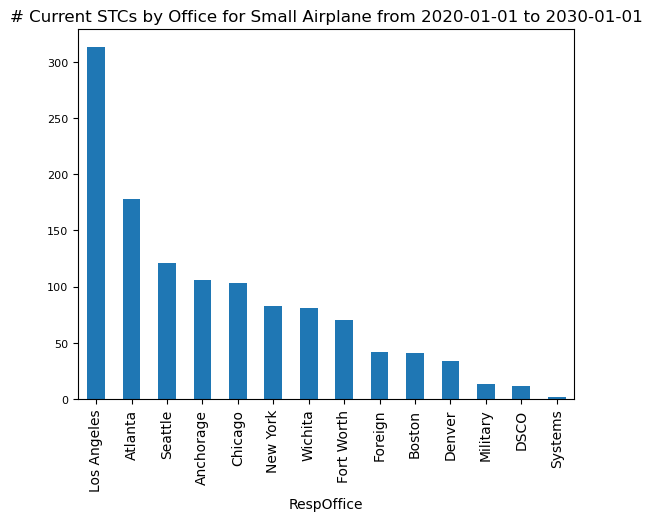

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


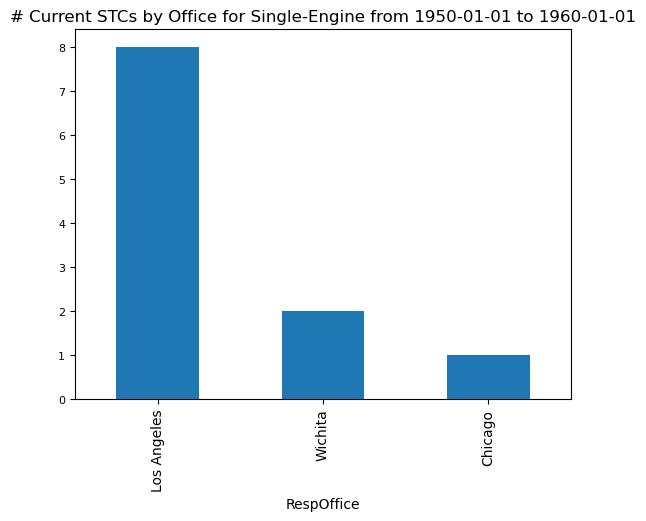

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


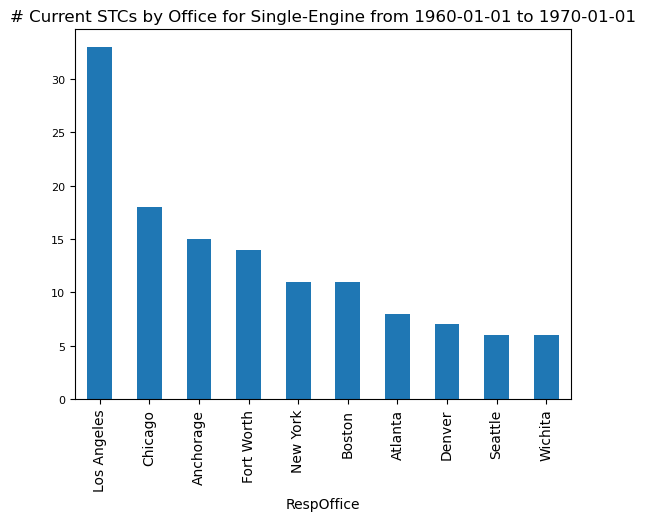

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


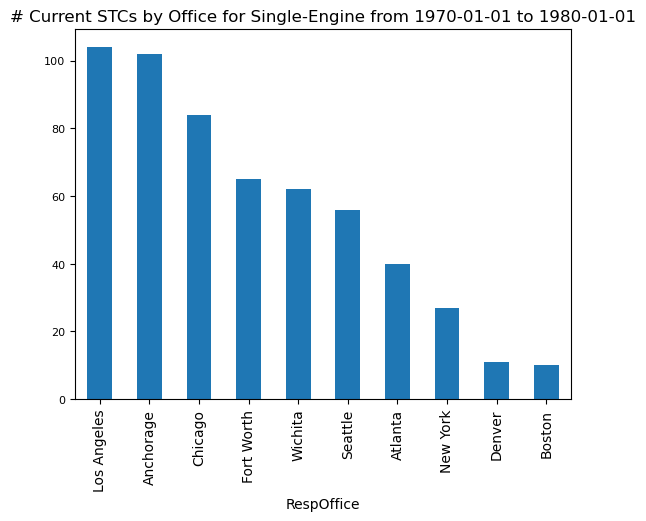

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


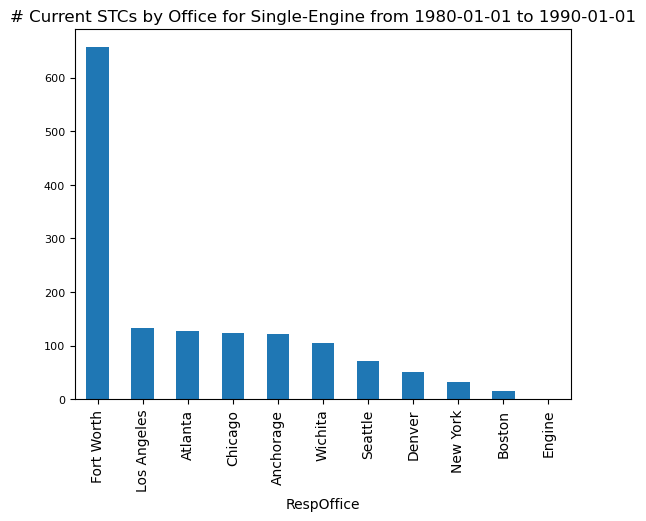

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


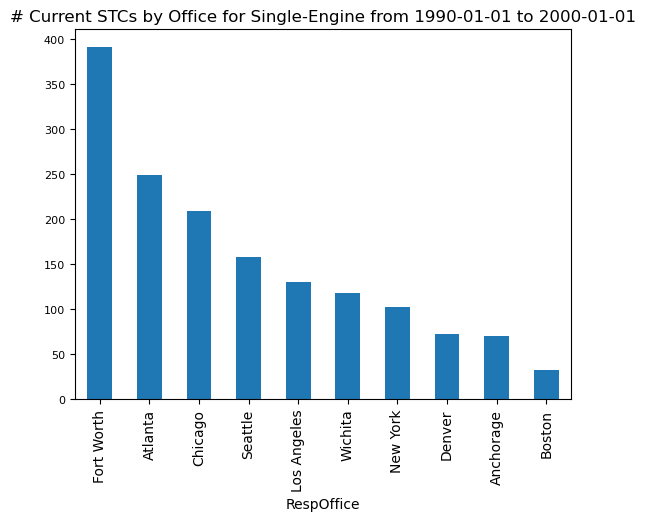

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


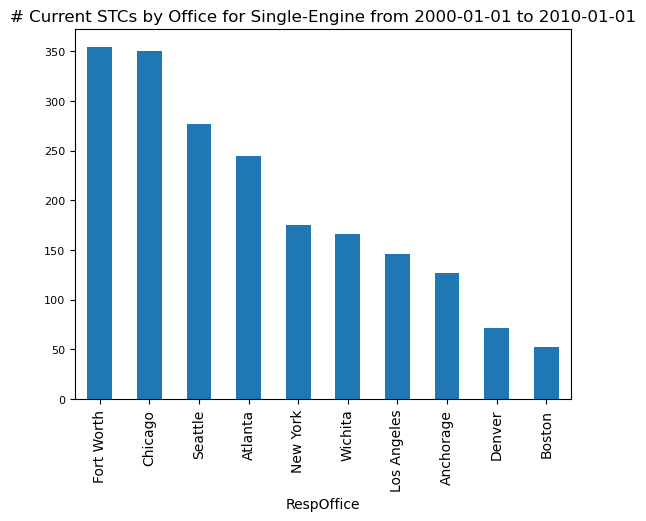

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


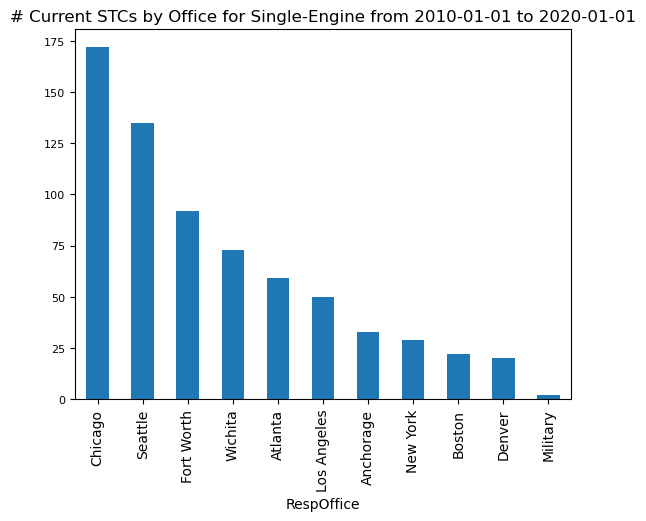

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


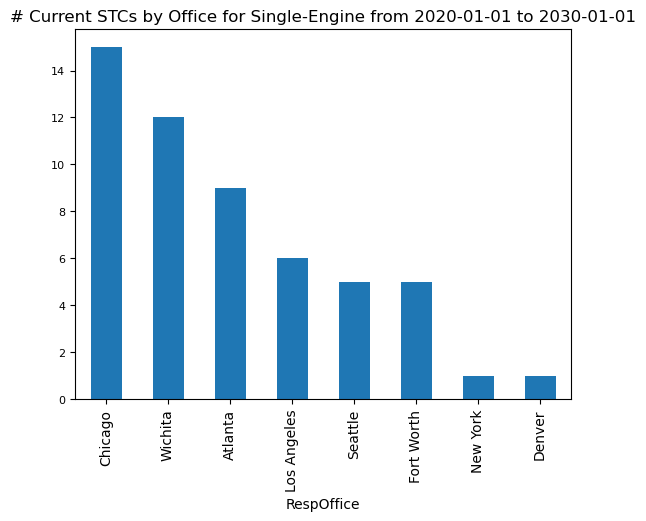

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


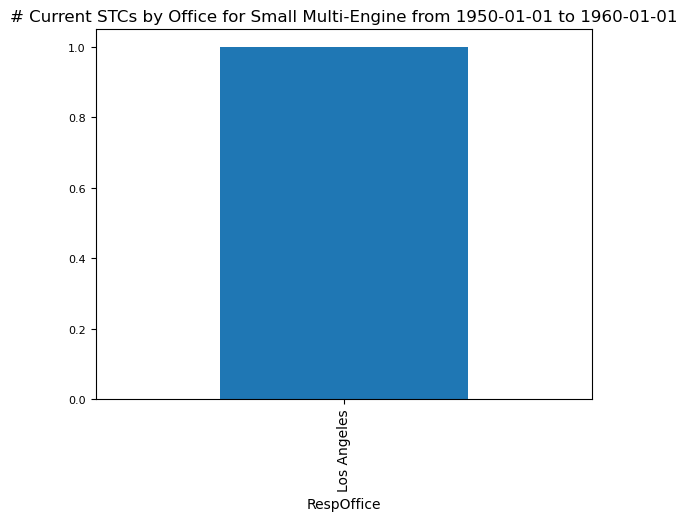

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


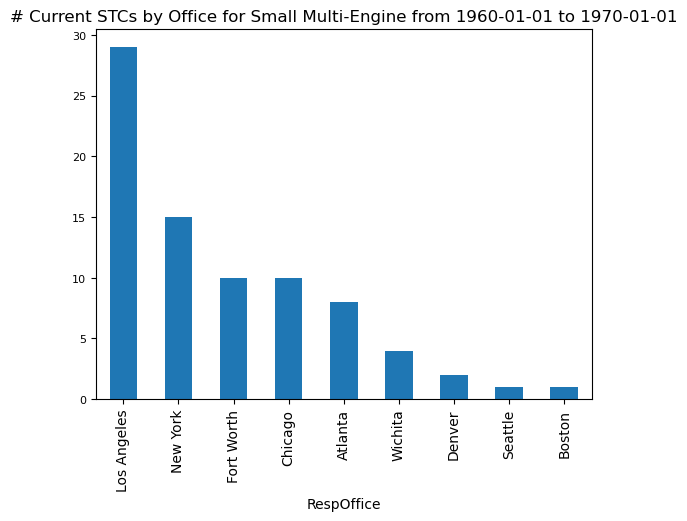

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


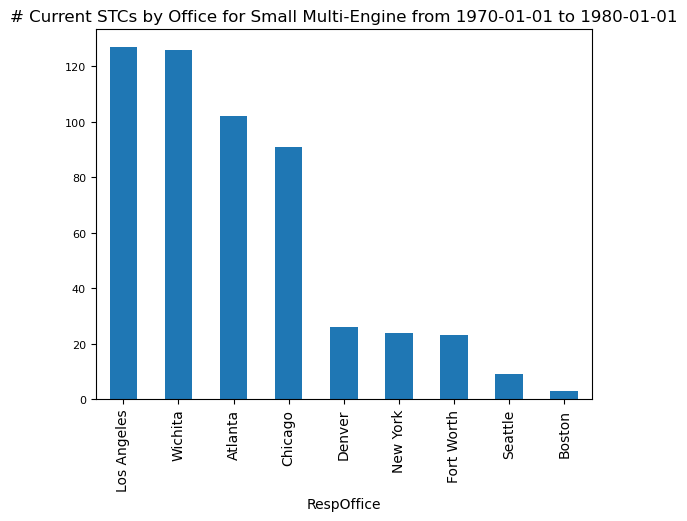

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


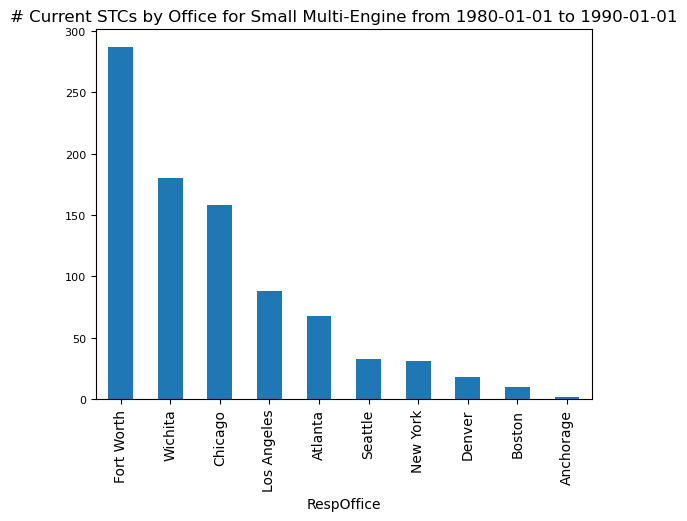

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


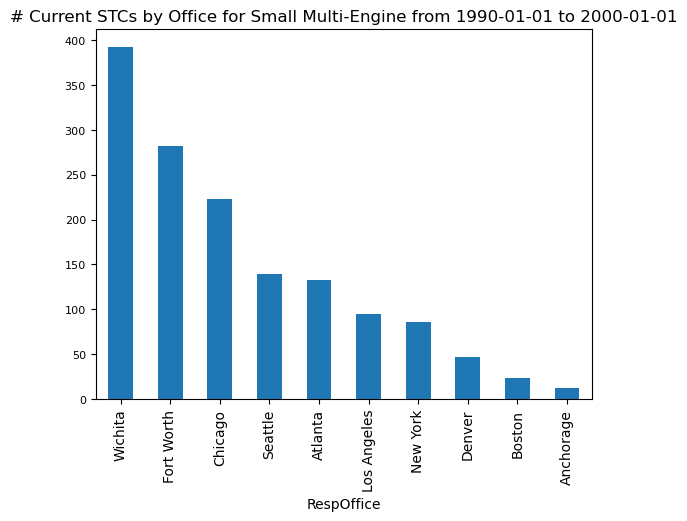

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


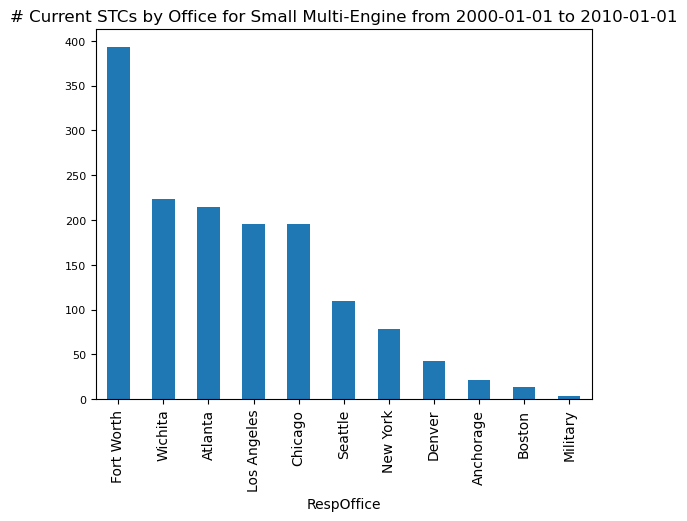

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


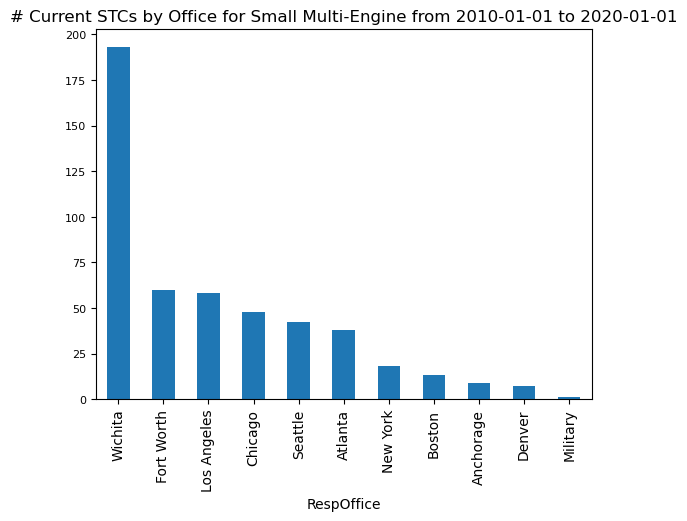

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


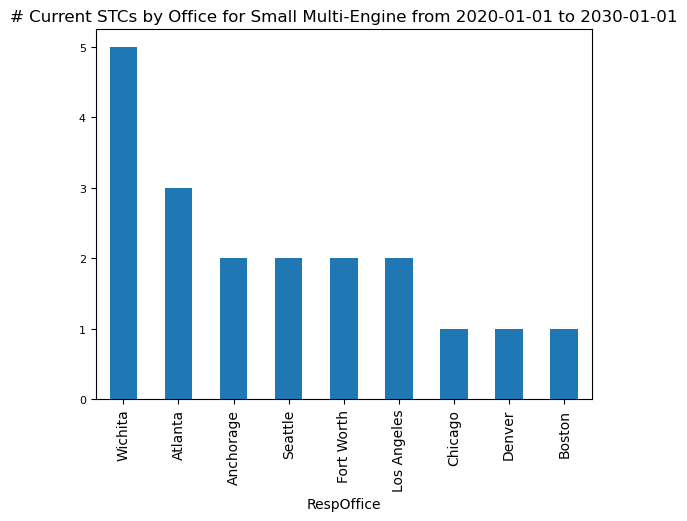

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


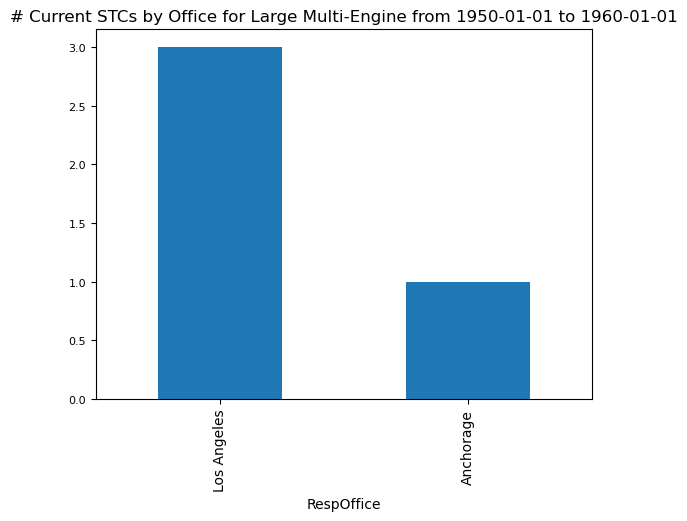

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


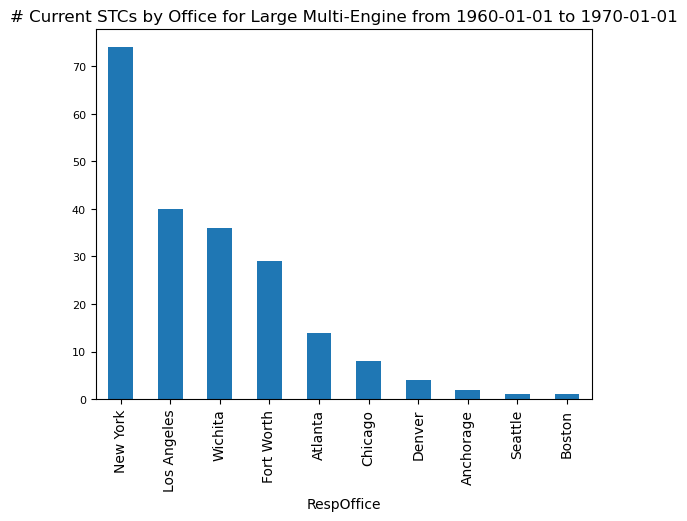

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


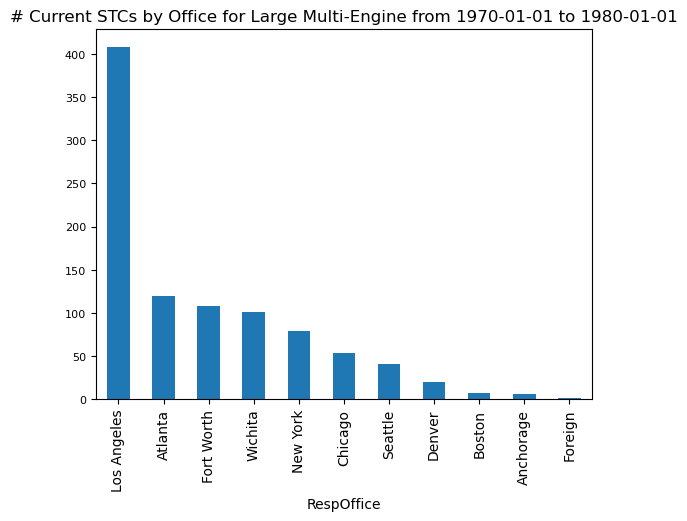

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


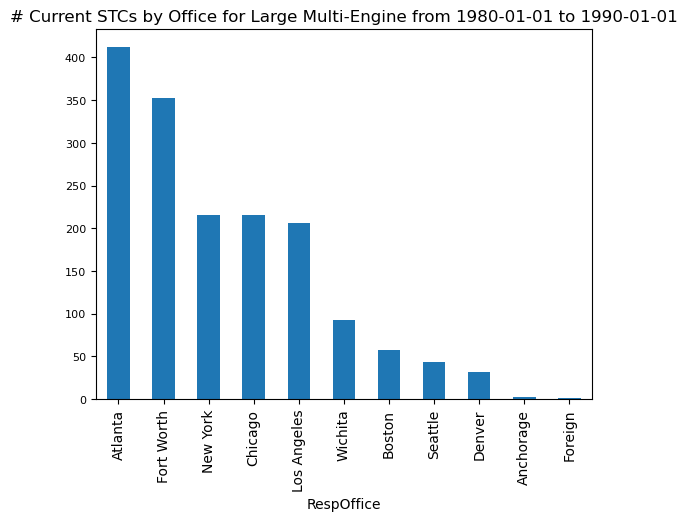

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


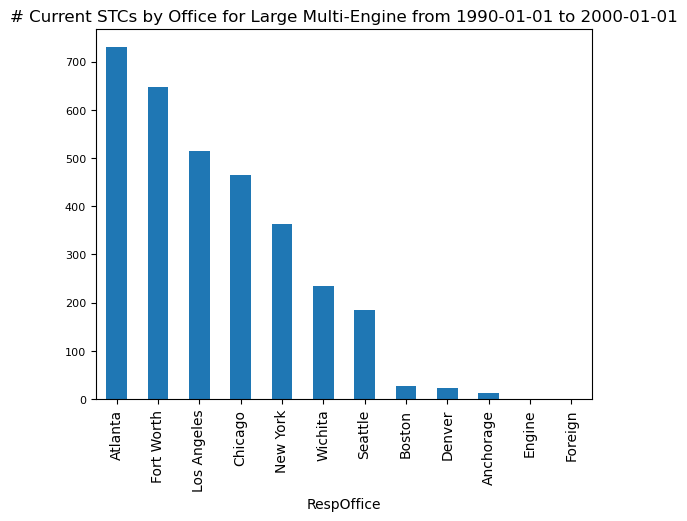

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


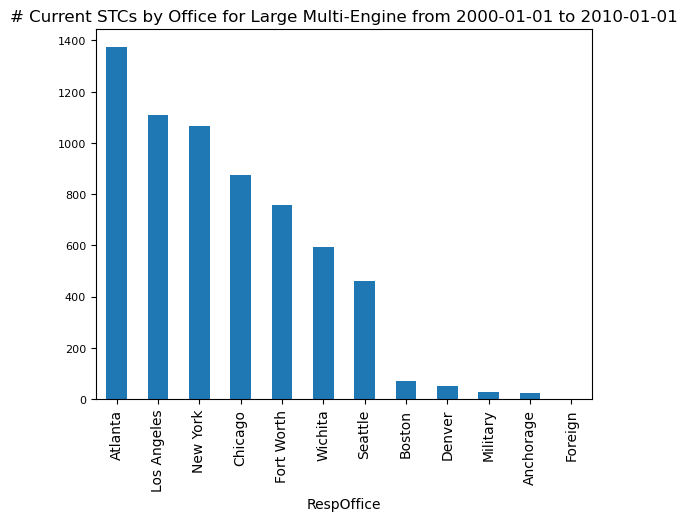

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


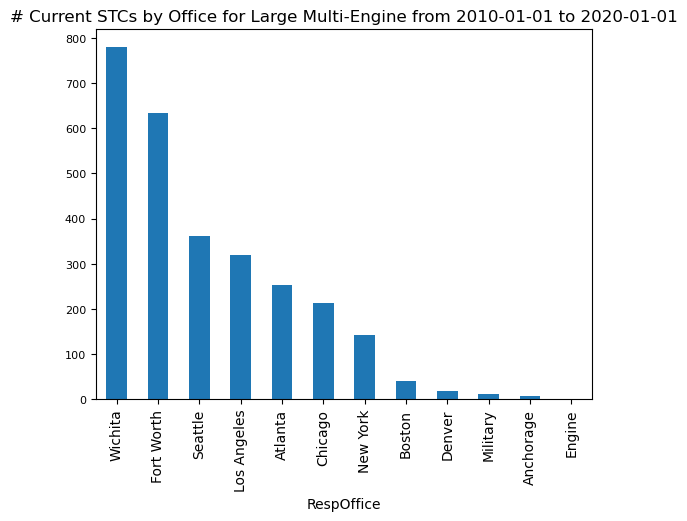

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


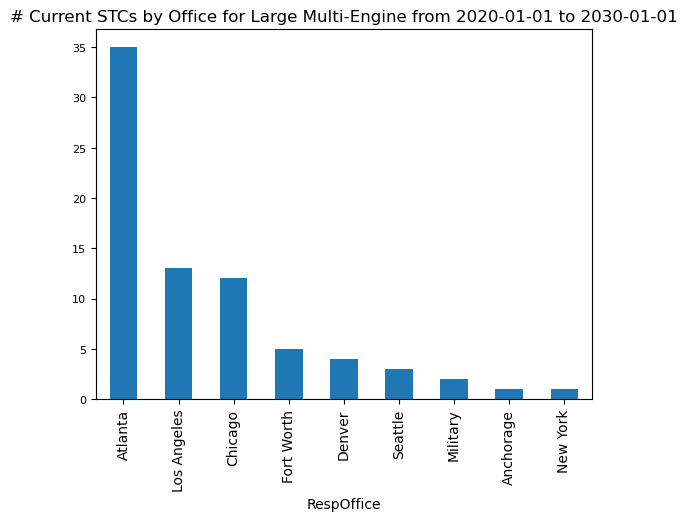

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: Se

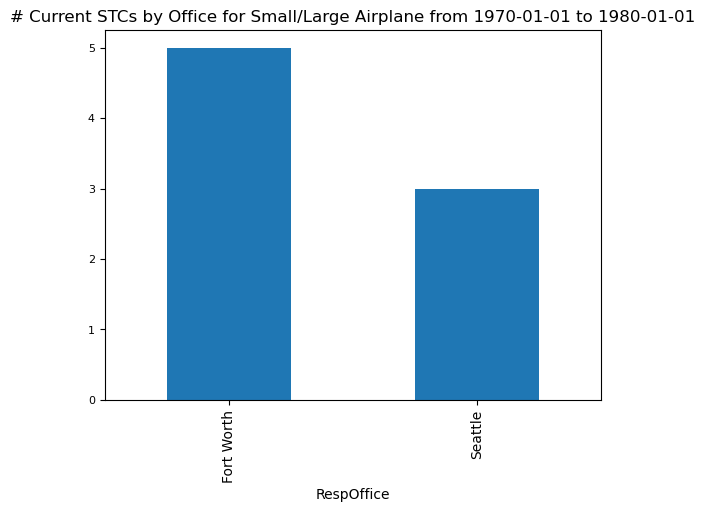

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


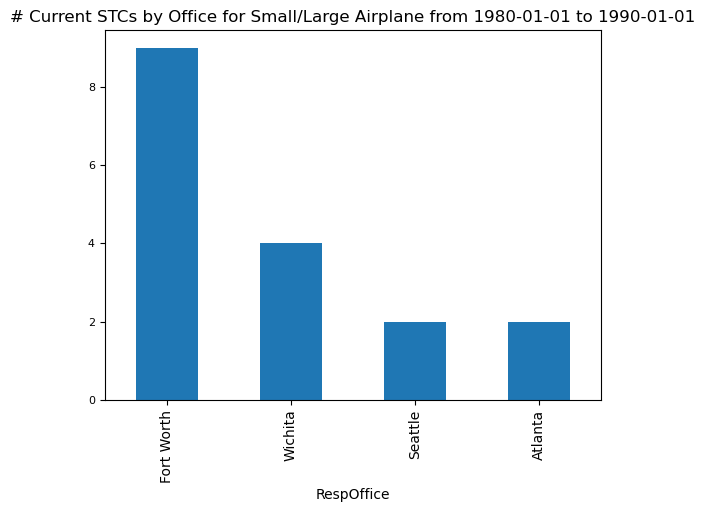

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


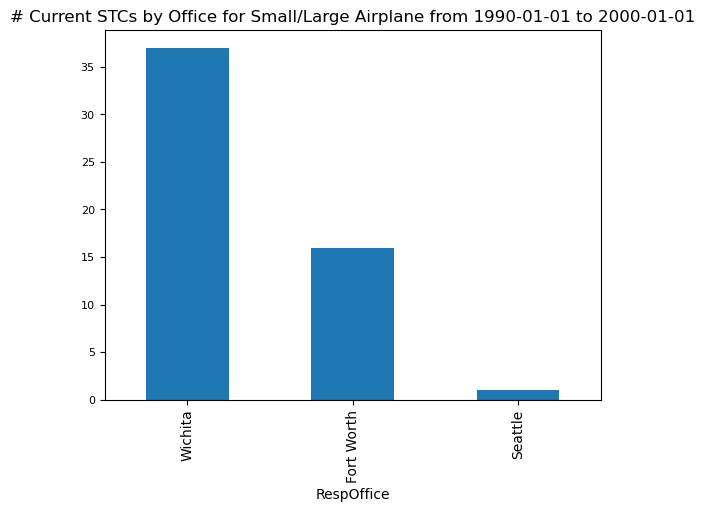

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


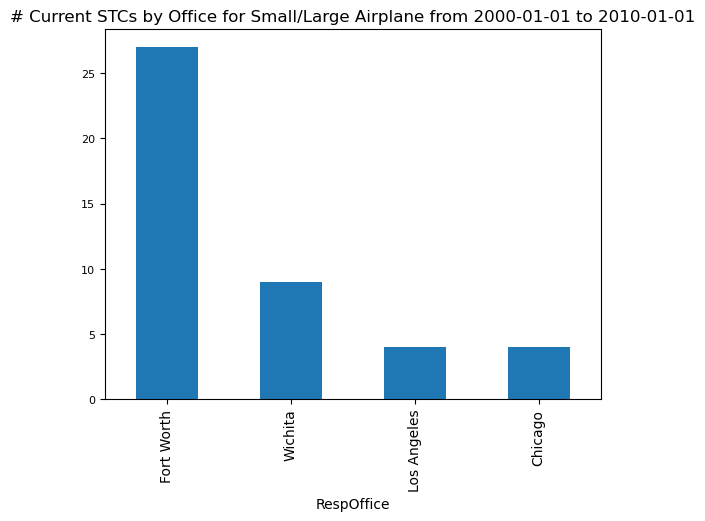

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


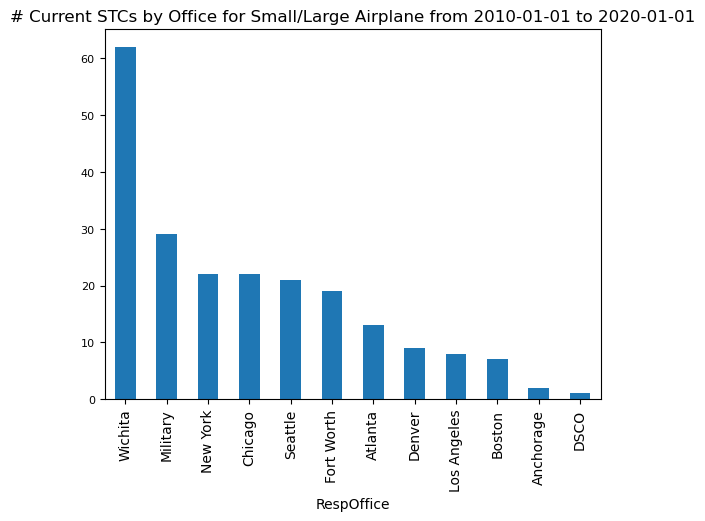

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


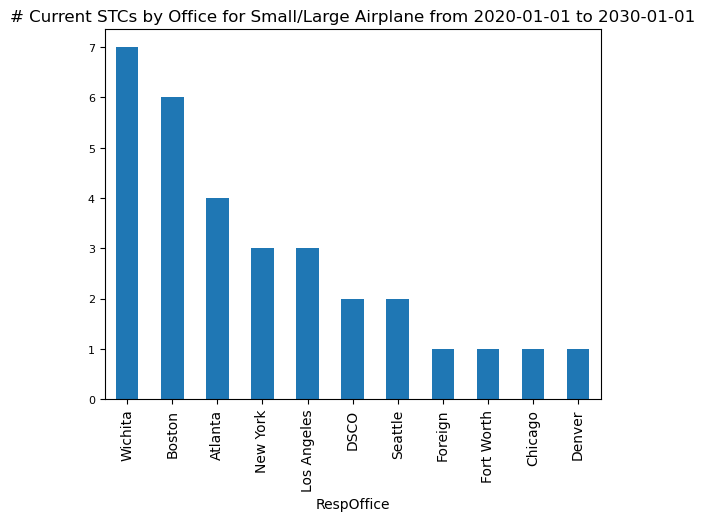

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: Se

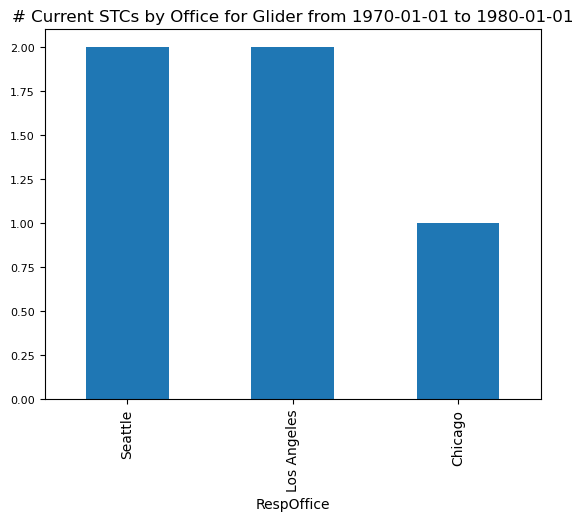

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


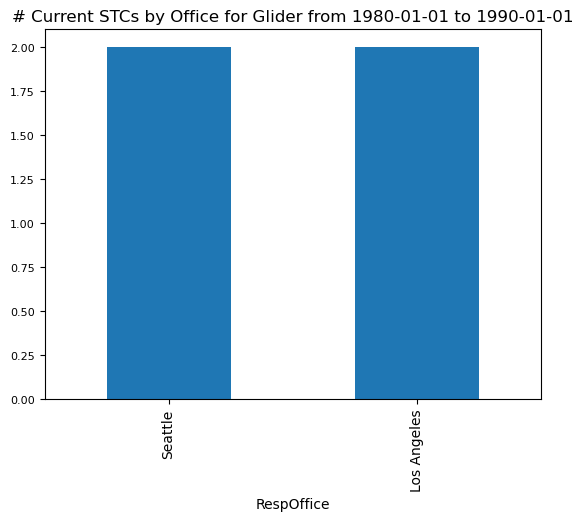

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


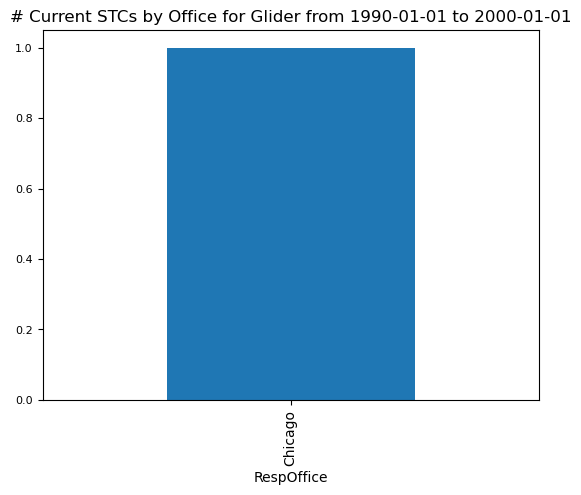

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


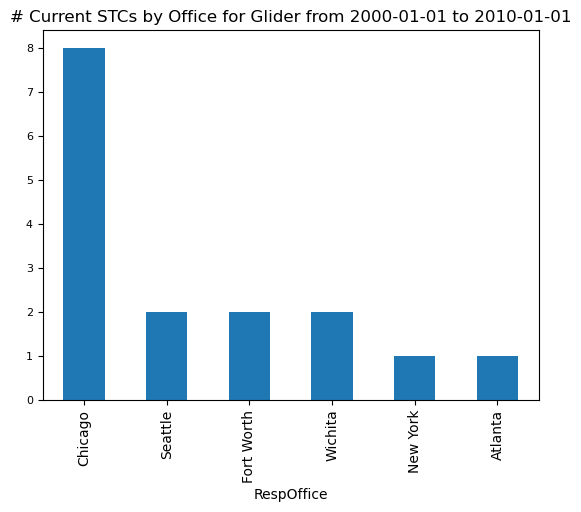

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


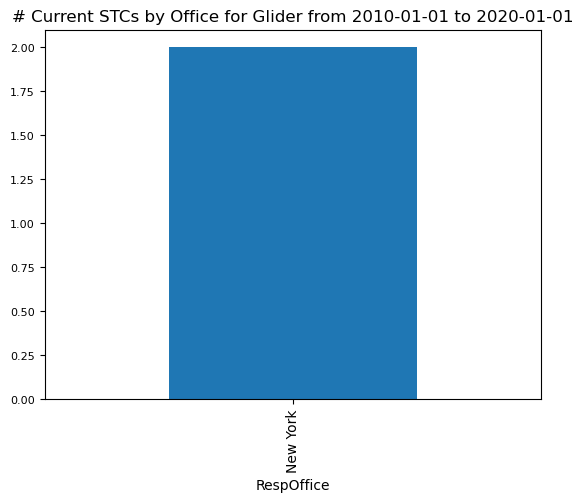

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


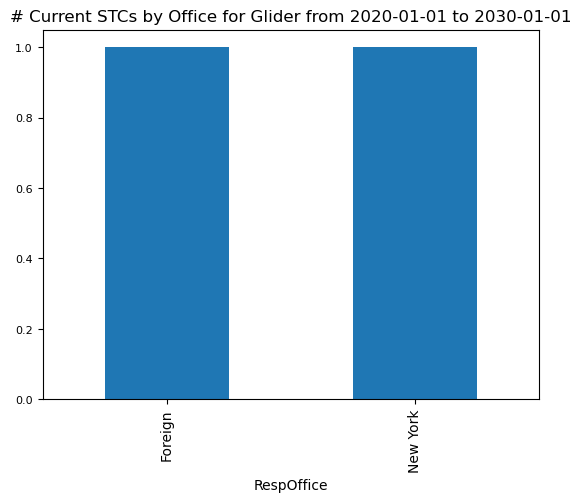

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: Se

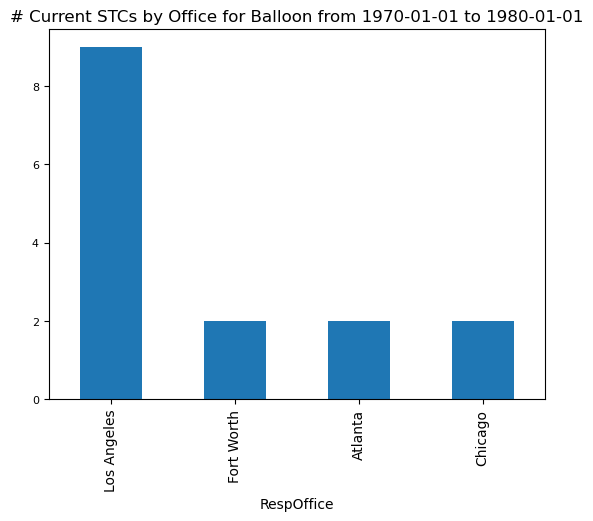

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


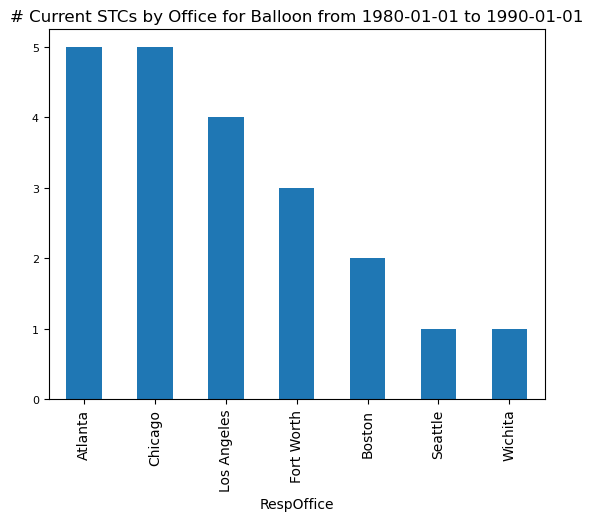

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


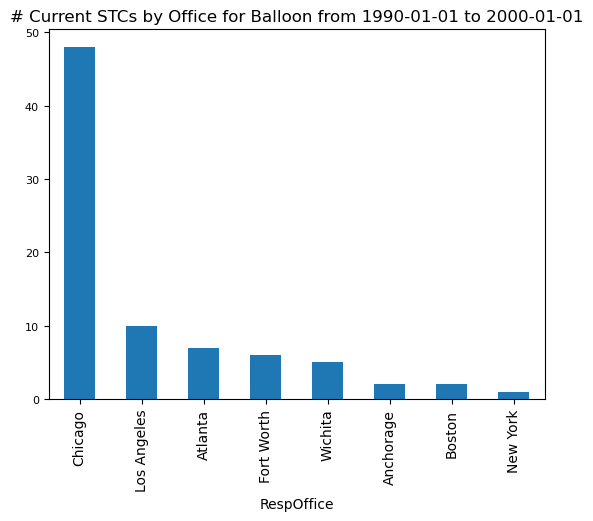

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


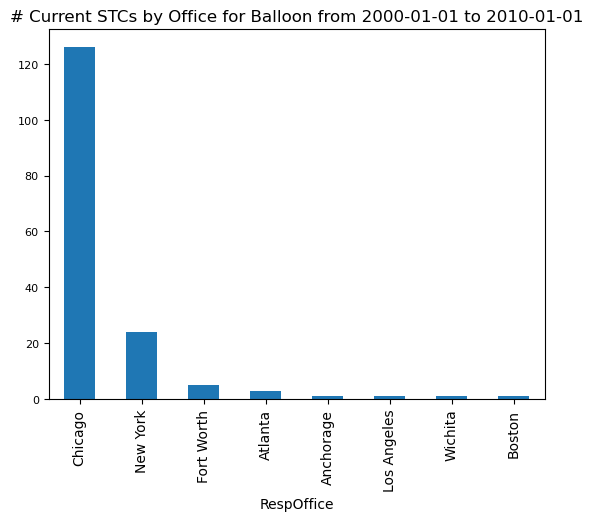

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


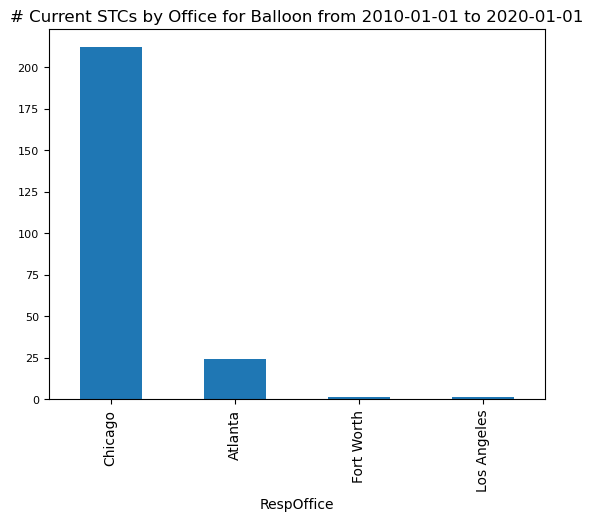

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


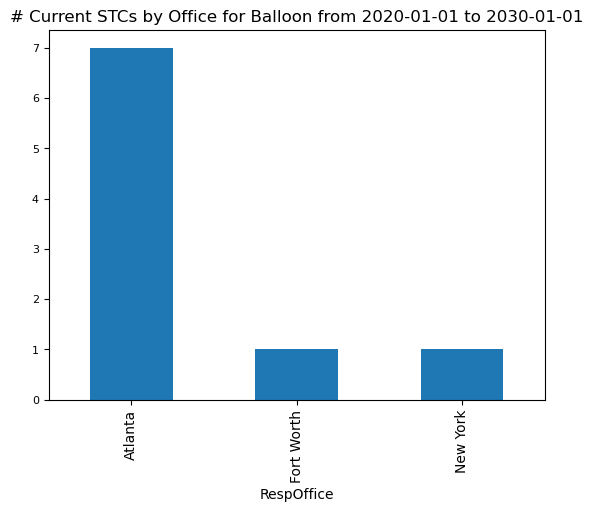

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: Se

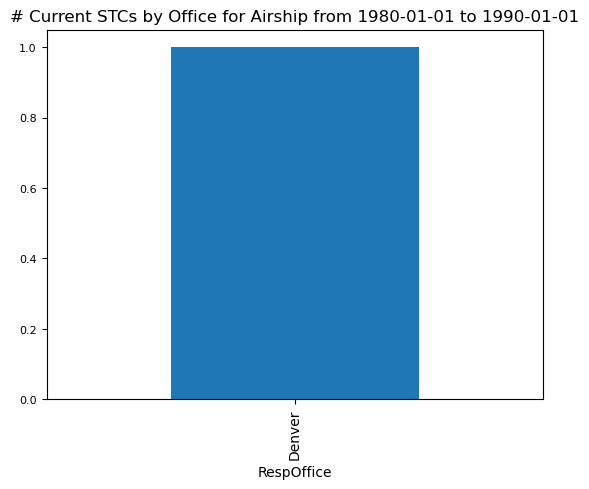

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


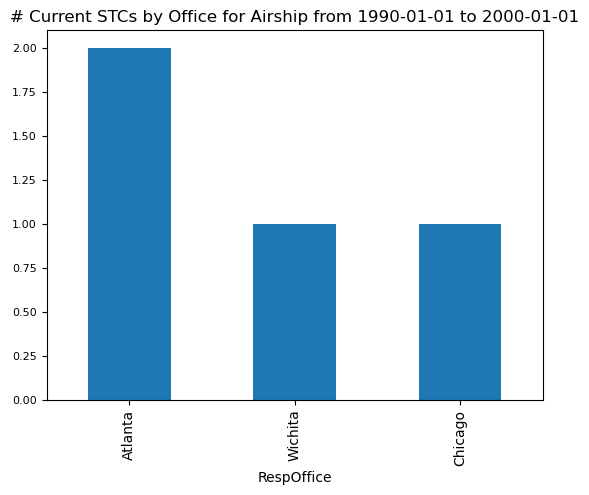

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


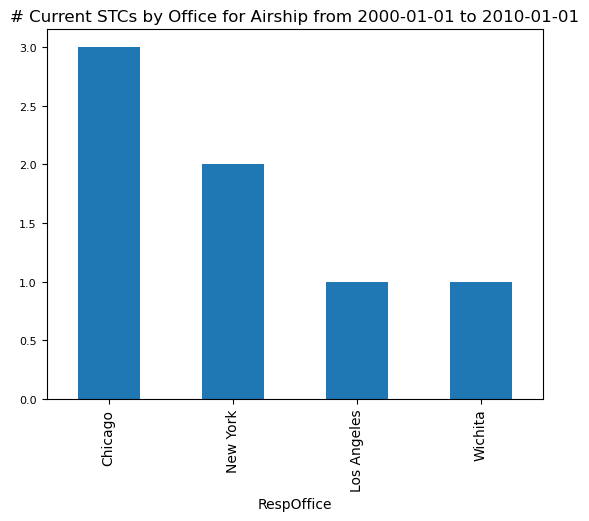

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


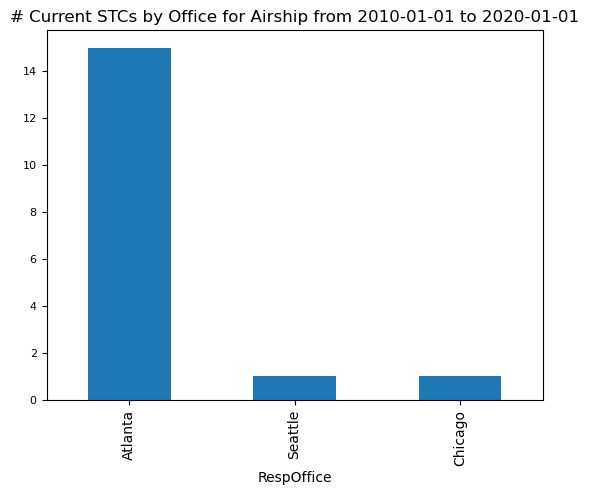

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: Us

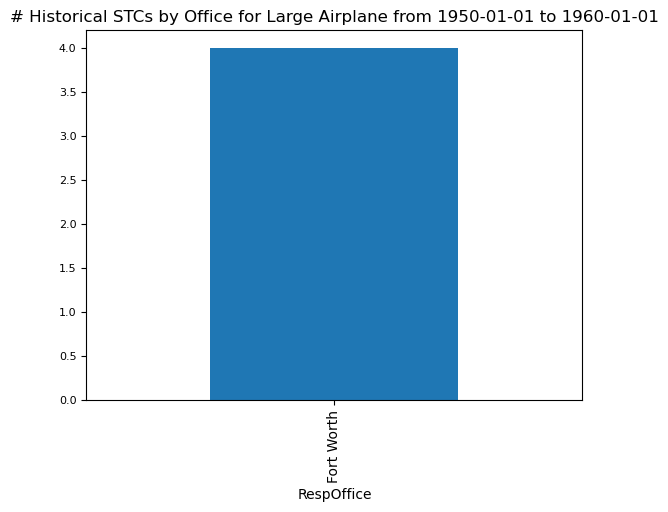

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


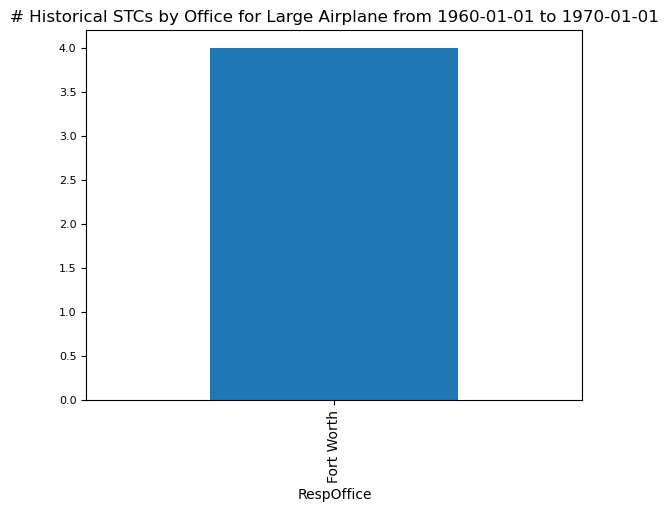

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


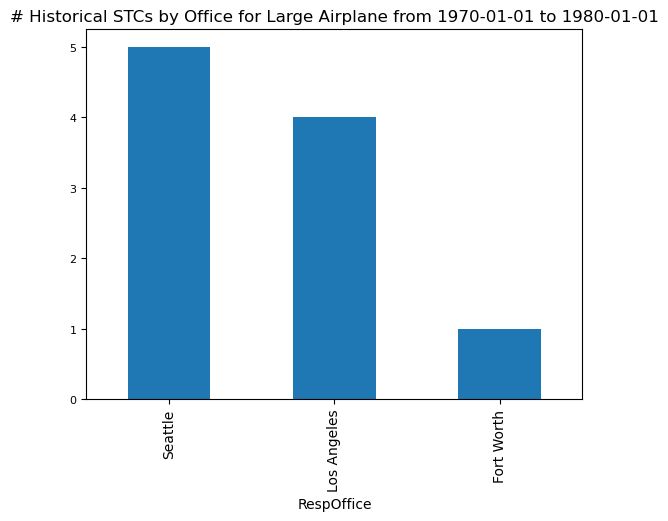

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


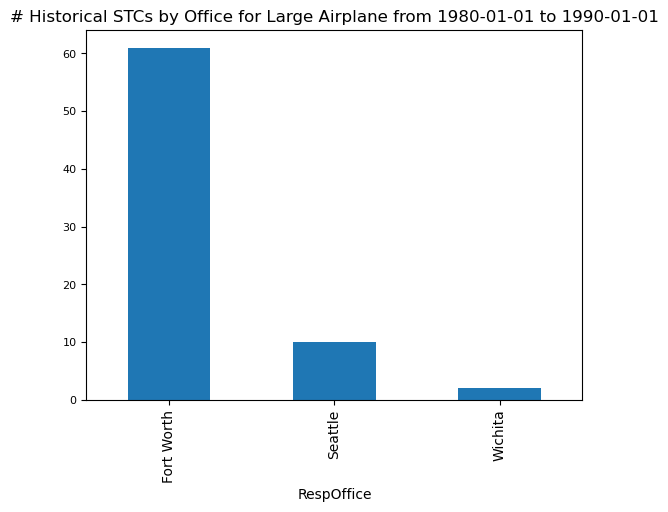

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


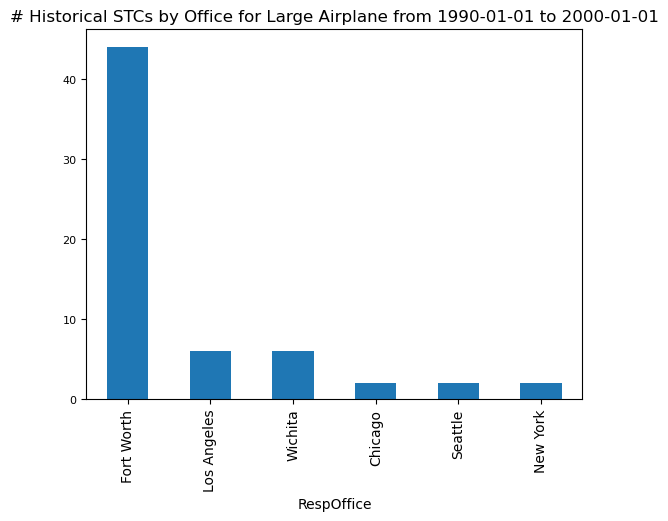

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


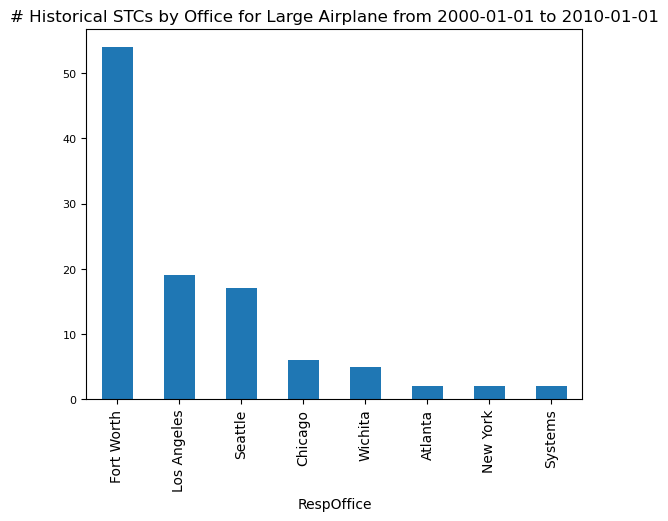

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


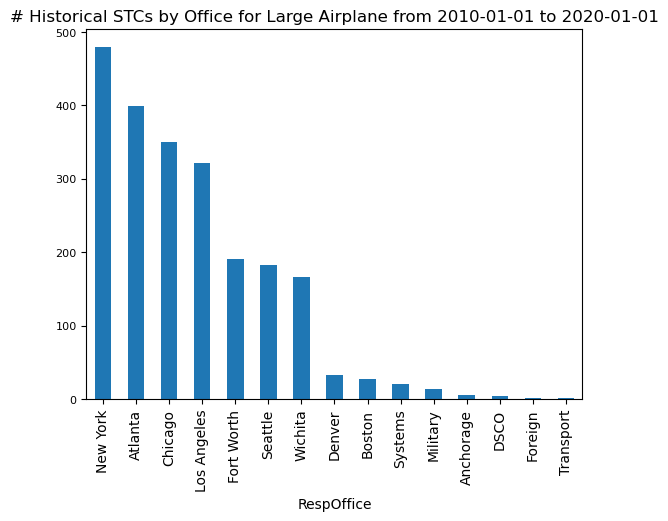

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


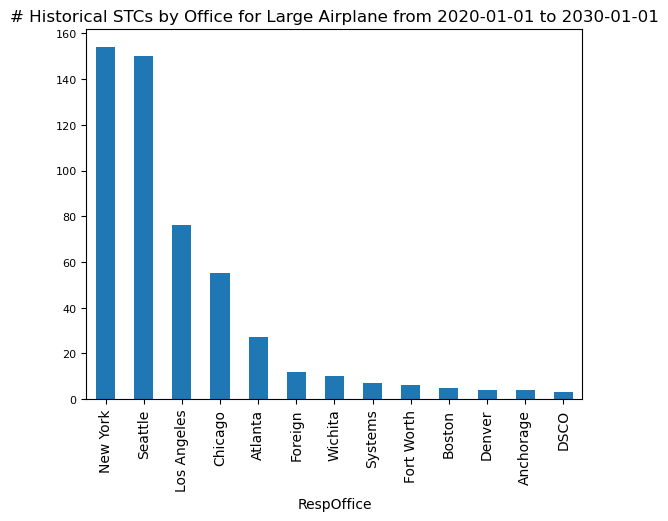

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats i

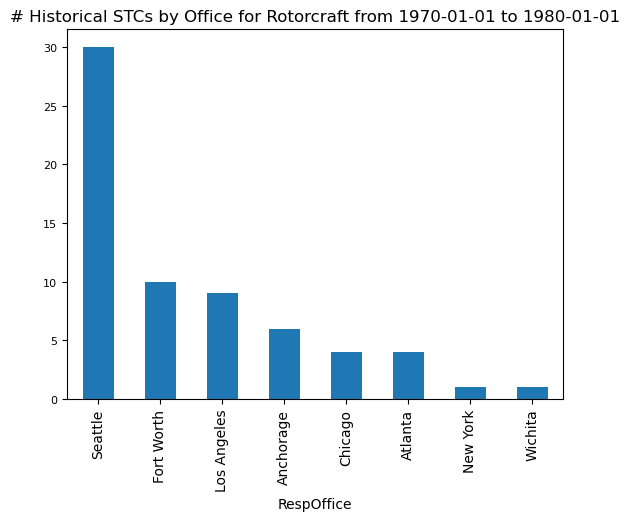

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


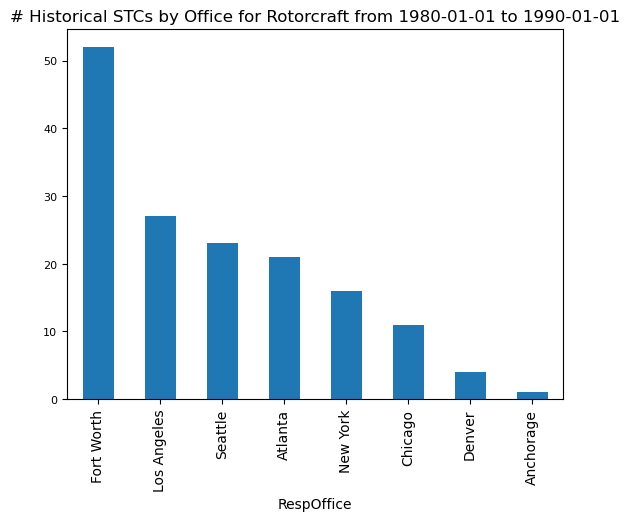

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


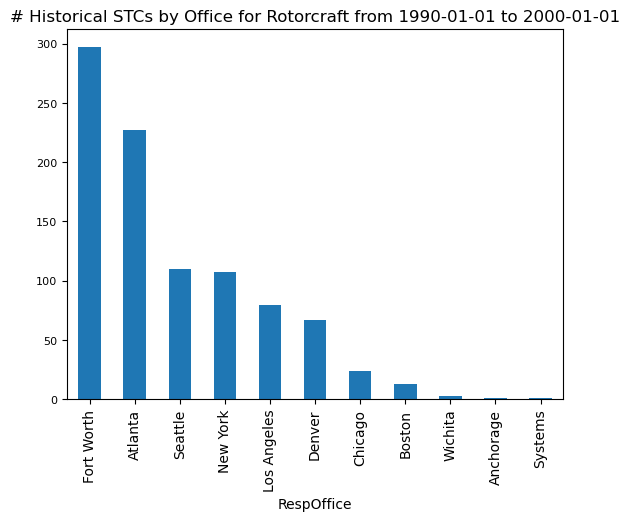

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


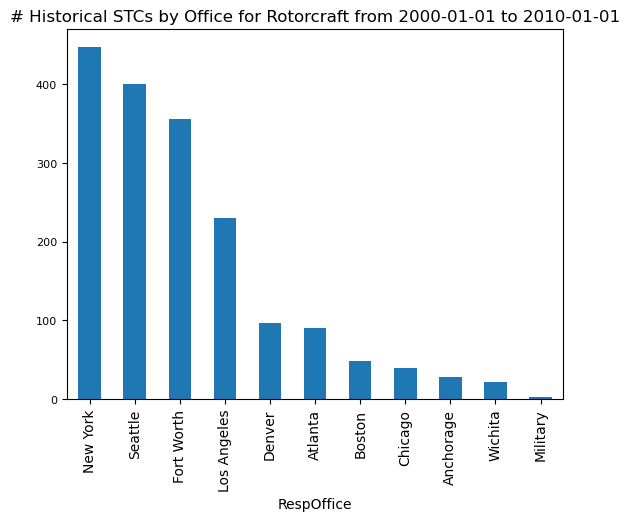

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


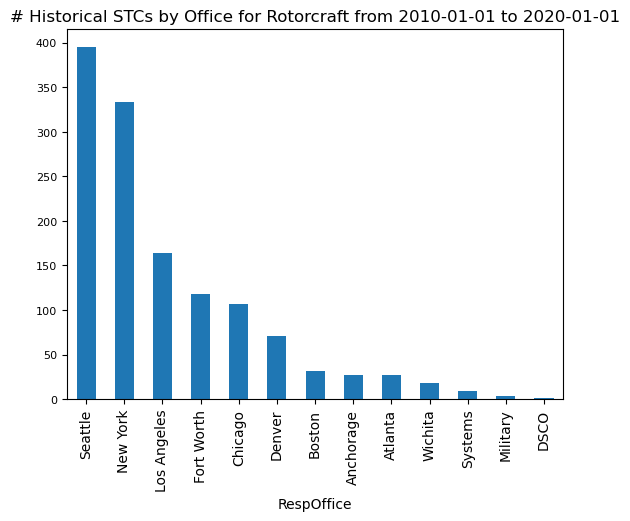

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


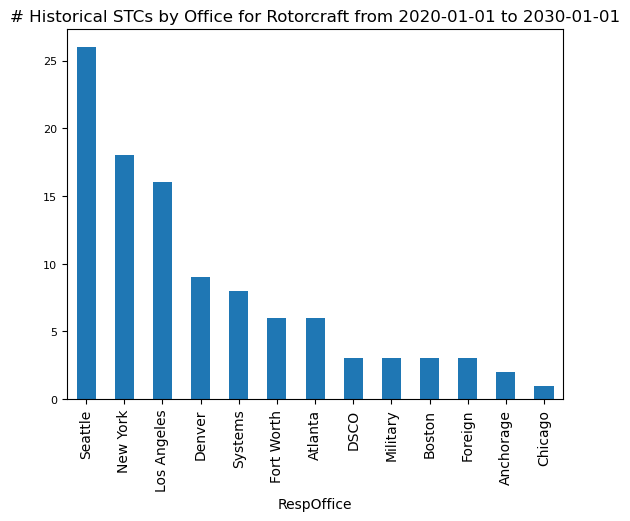

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


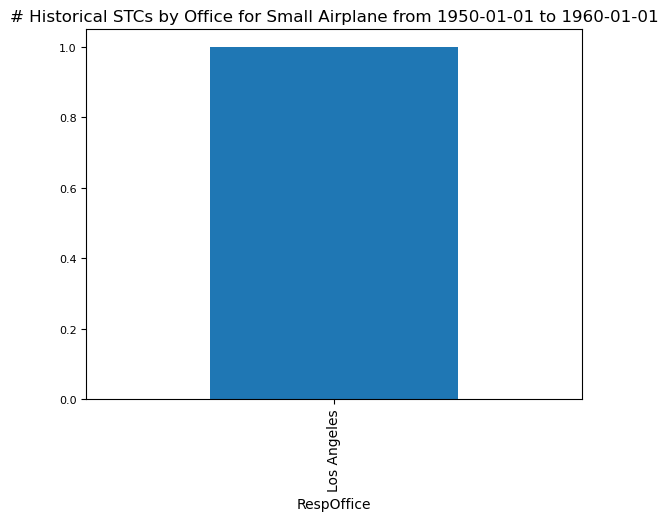

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


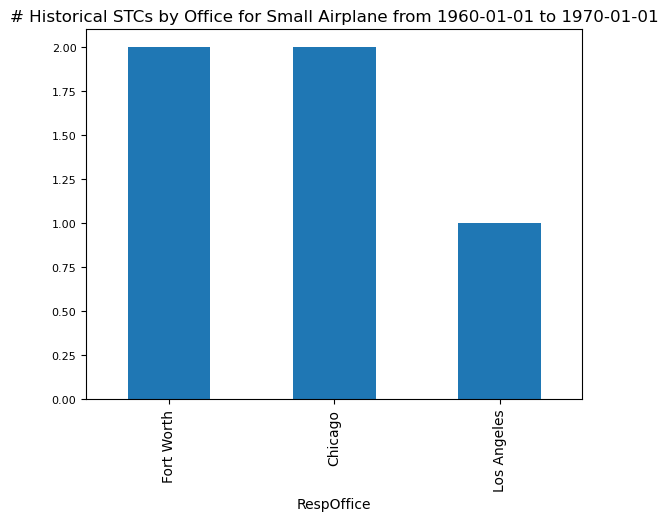

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


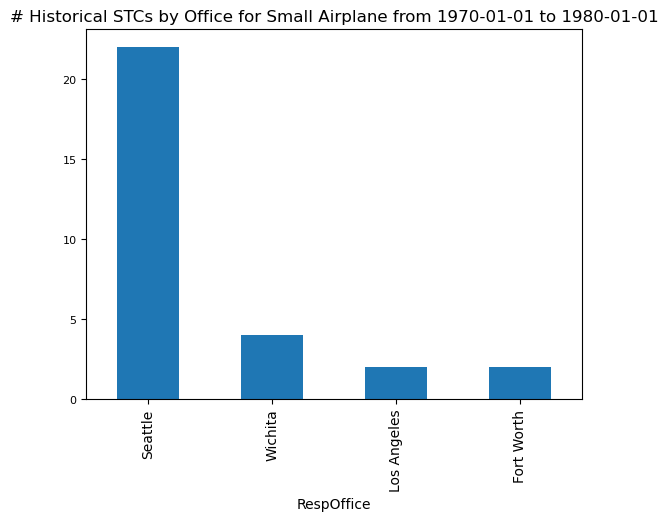

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


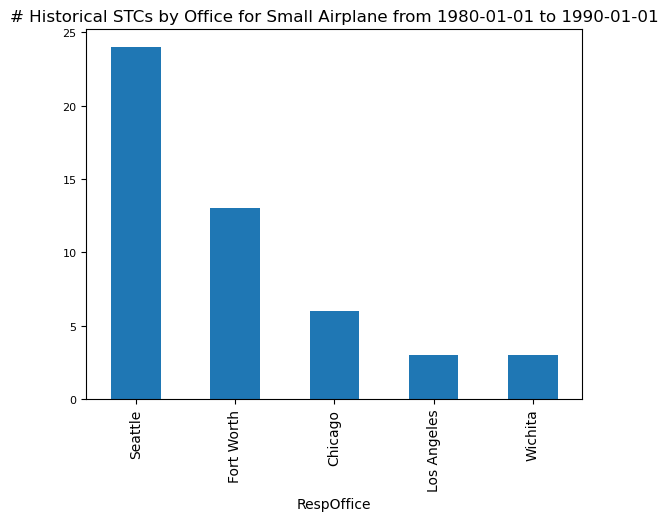

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


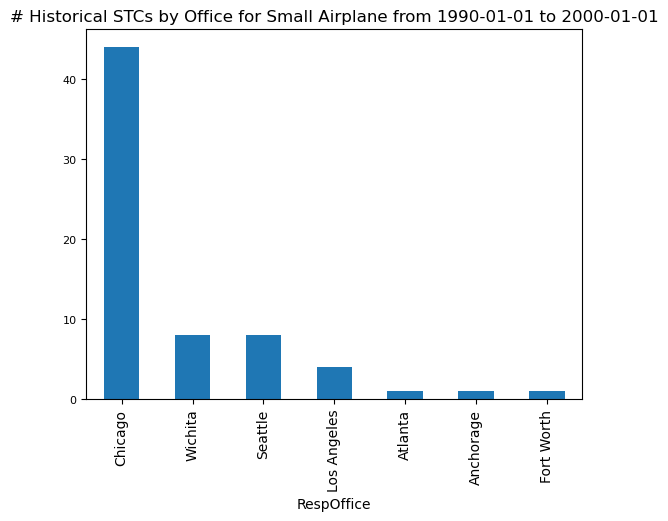

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


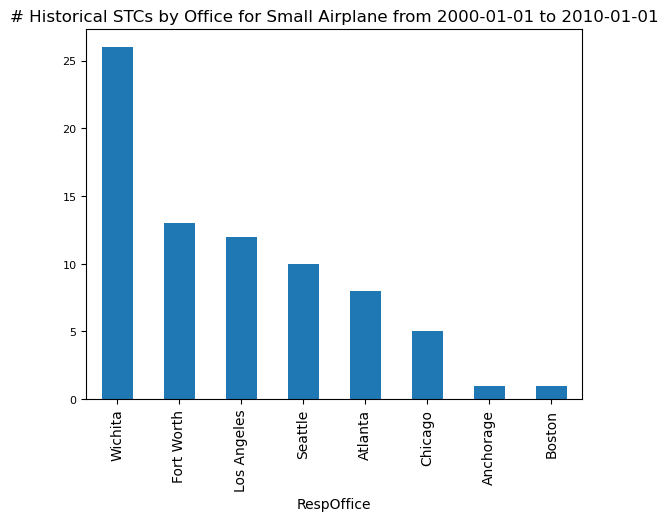

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


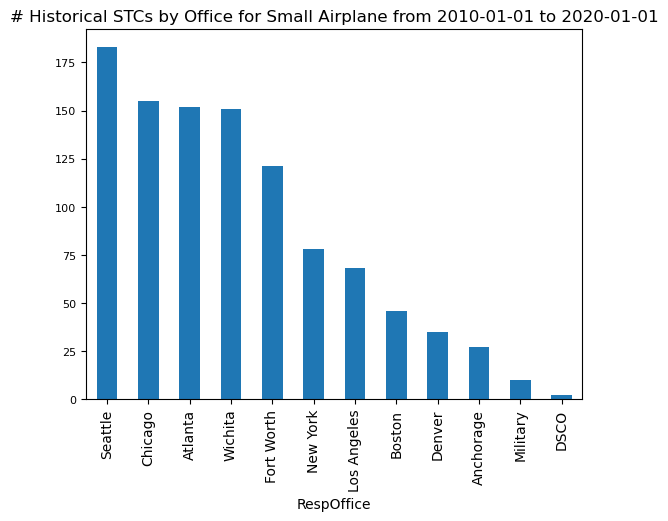

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


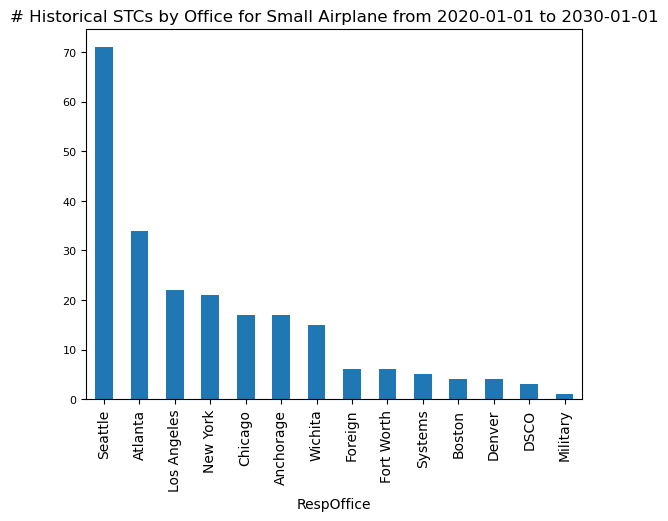

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


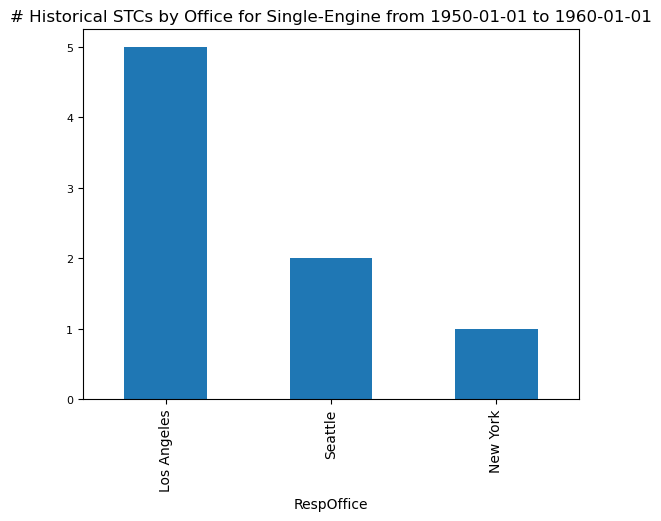

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


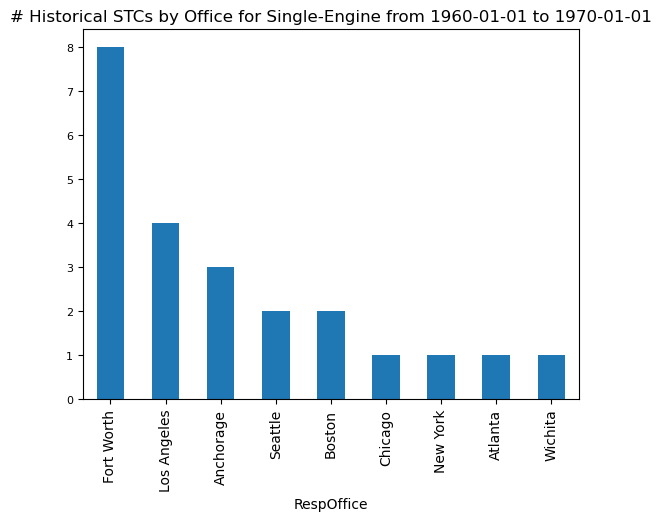

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


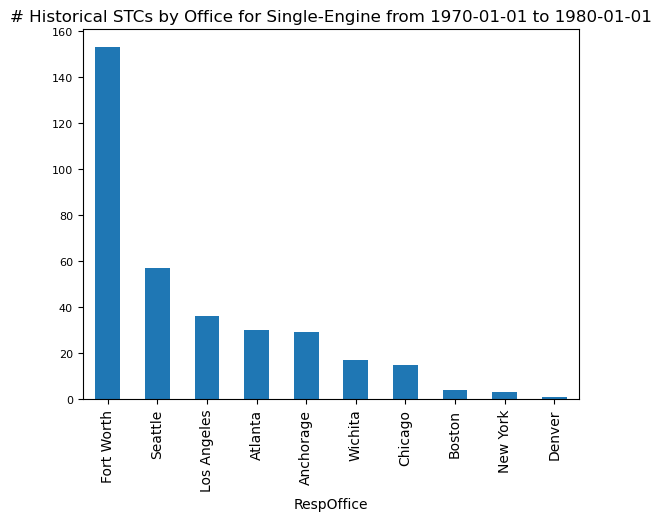

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


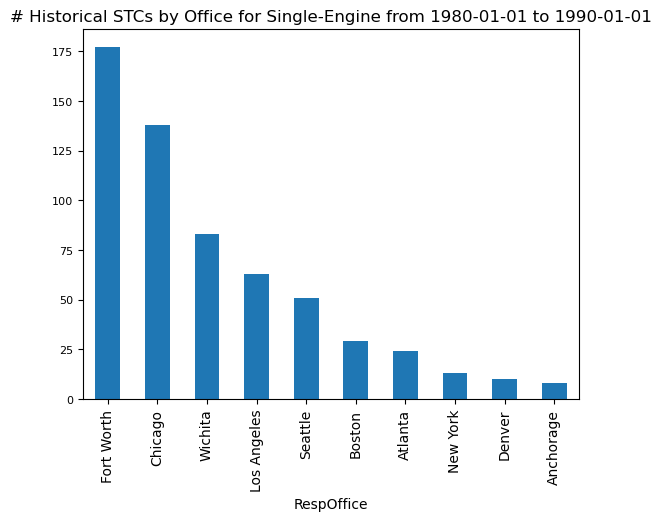

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


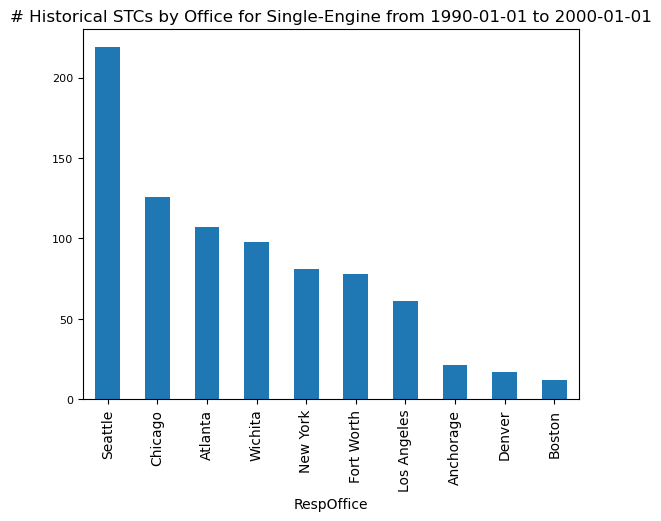

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


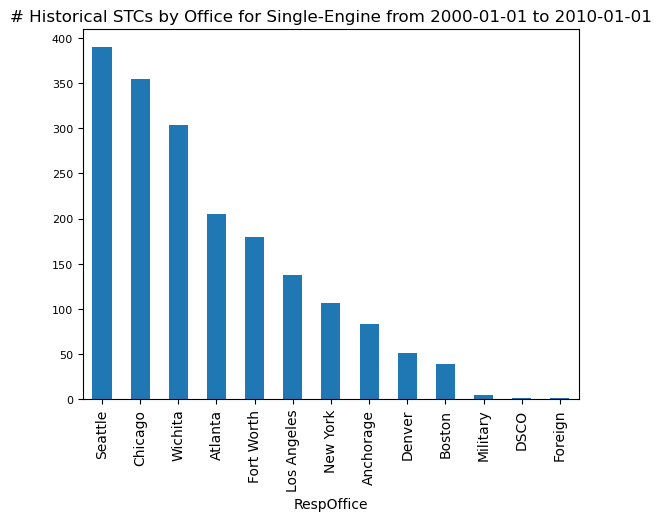

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


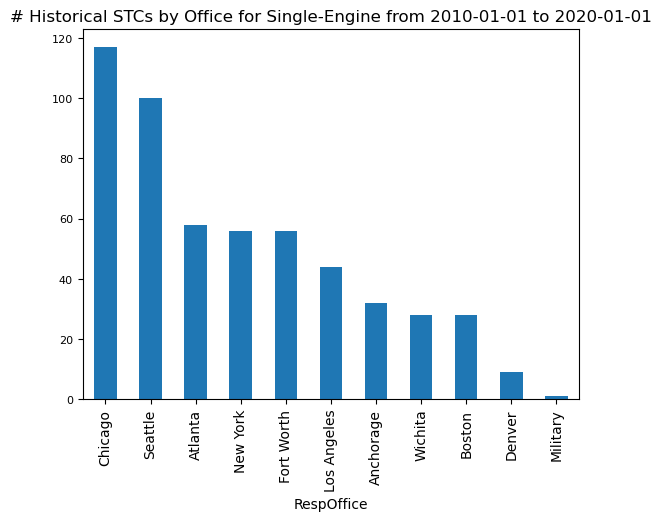

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


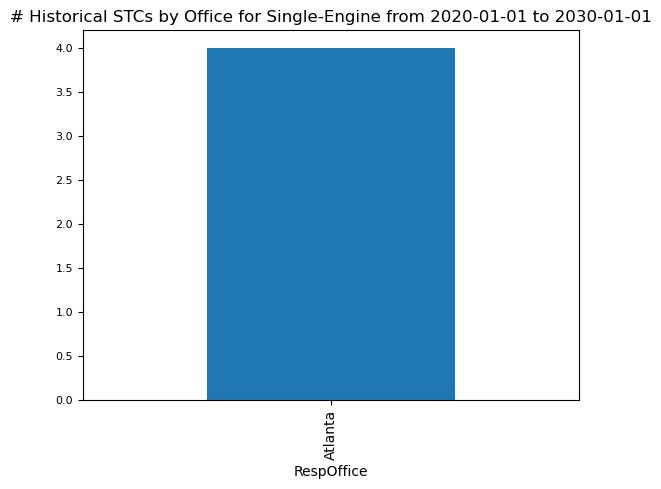

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats i

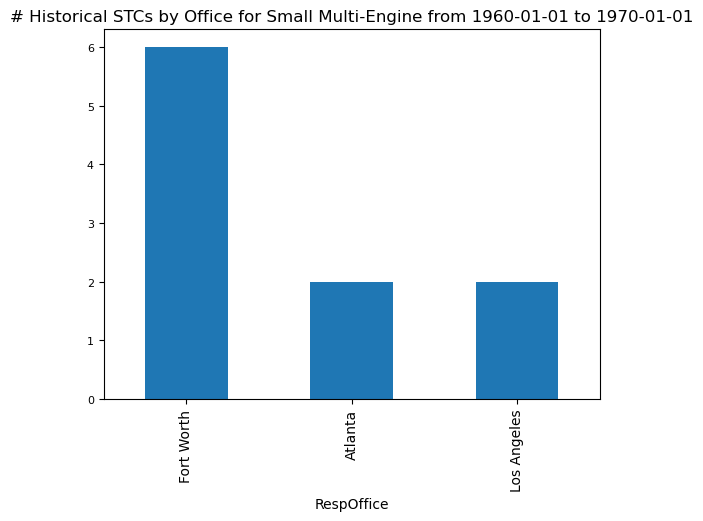

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


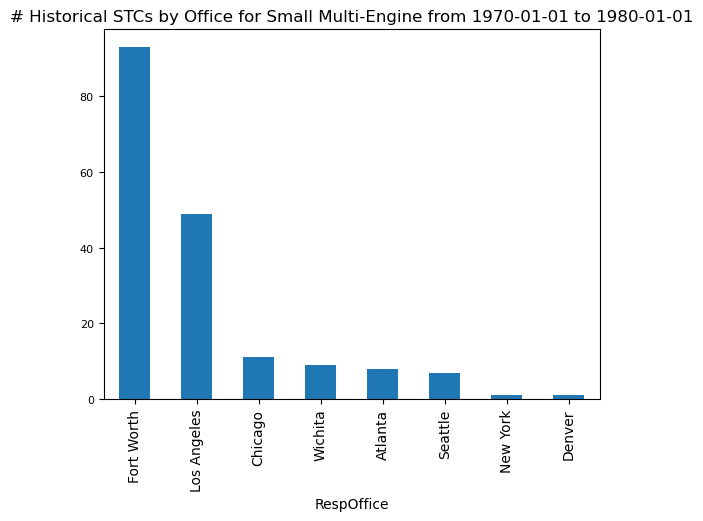

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


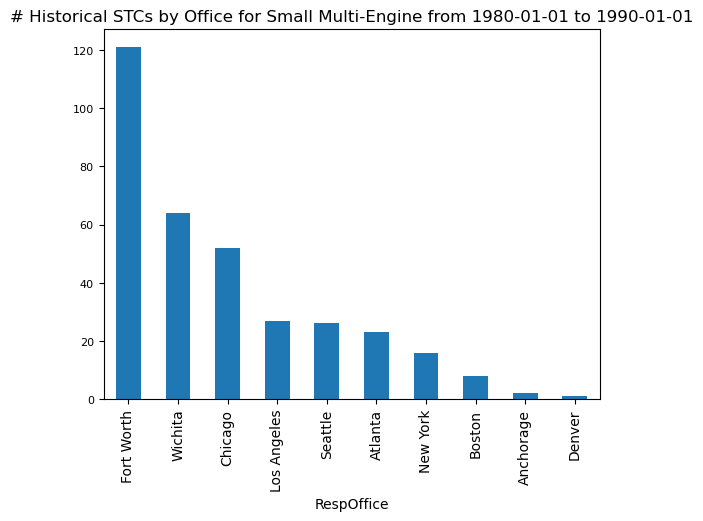

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


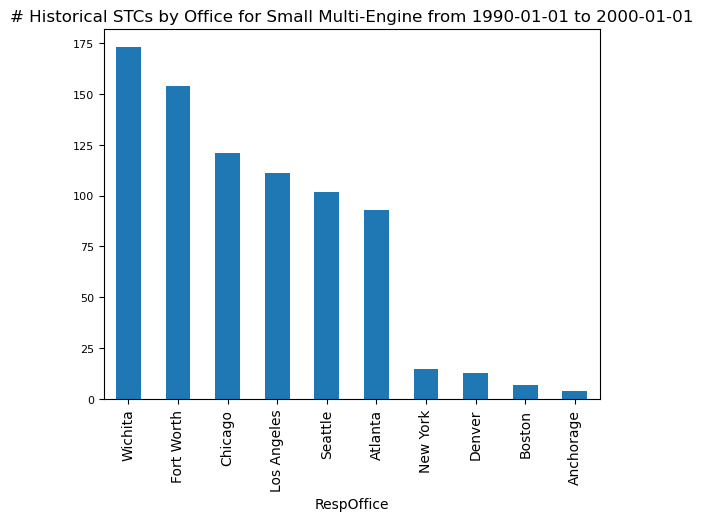

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


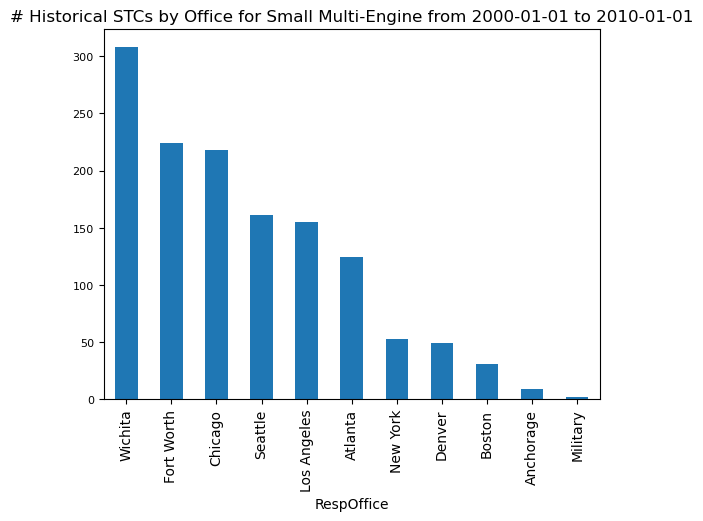

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


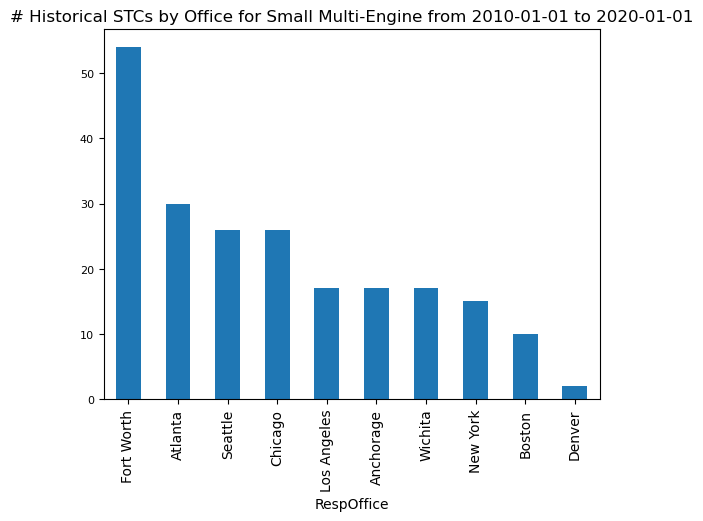

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


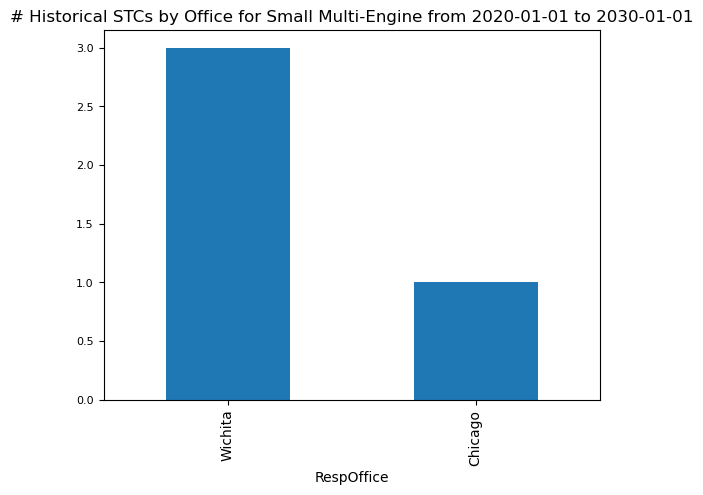

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


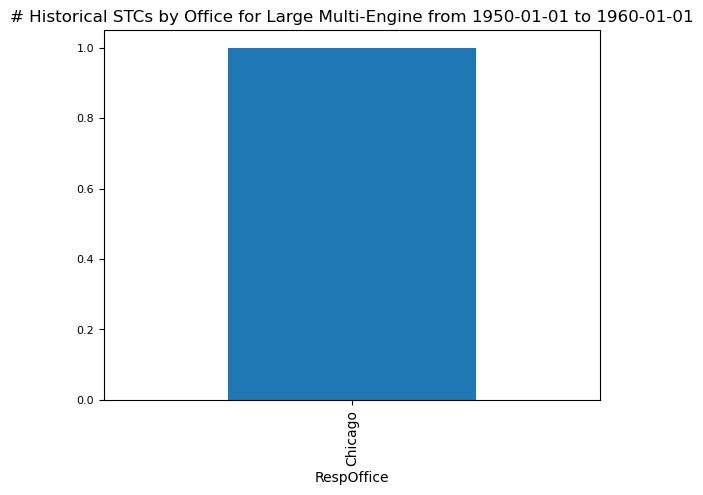

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


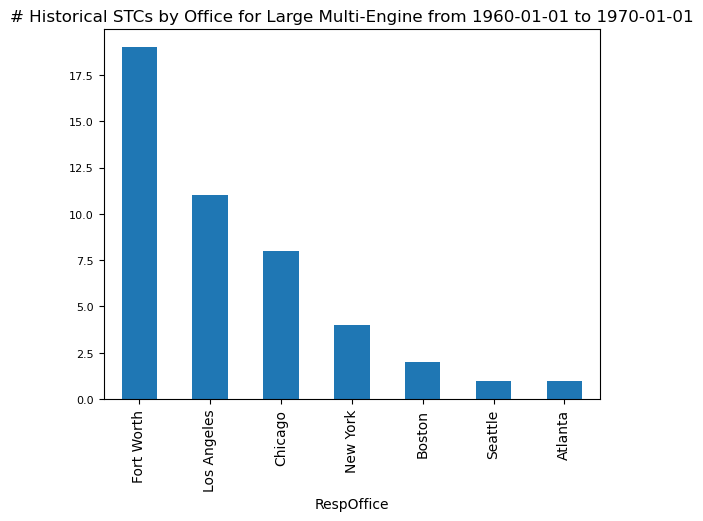

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


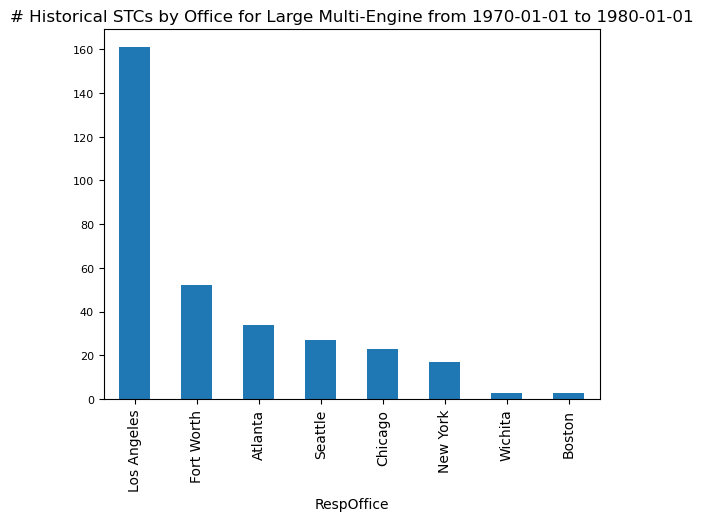

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


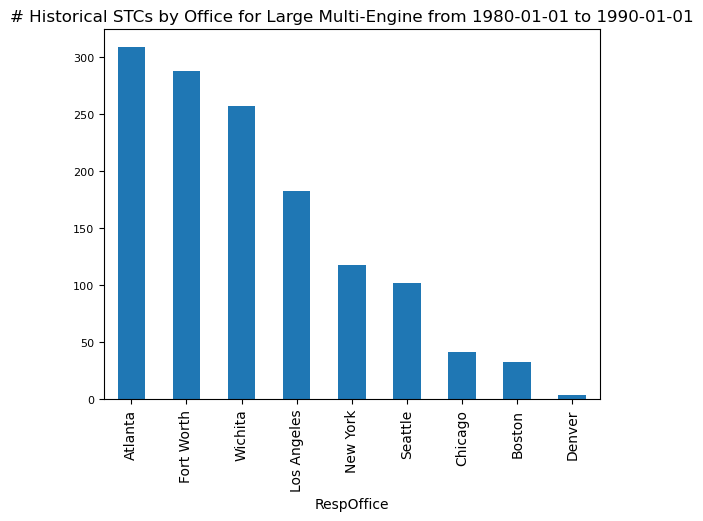

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


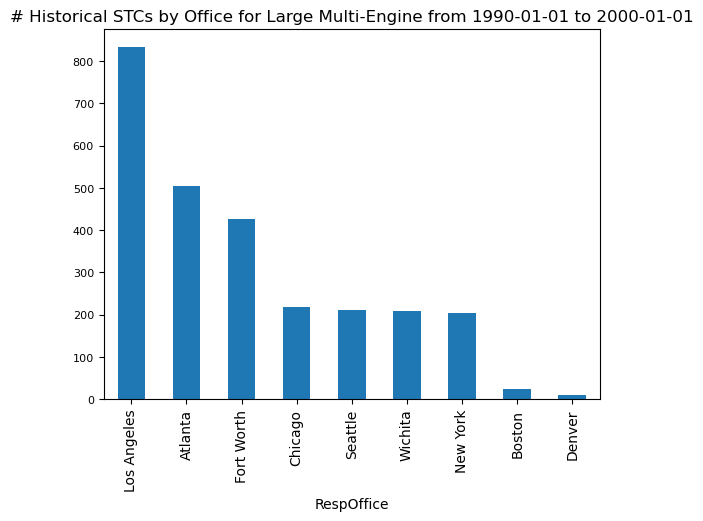

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


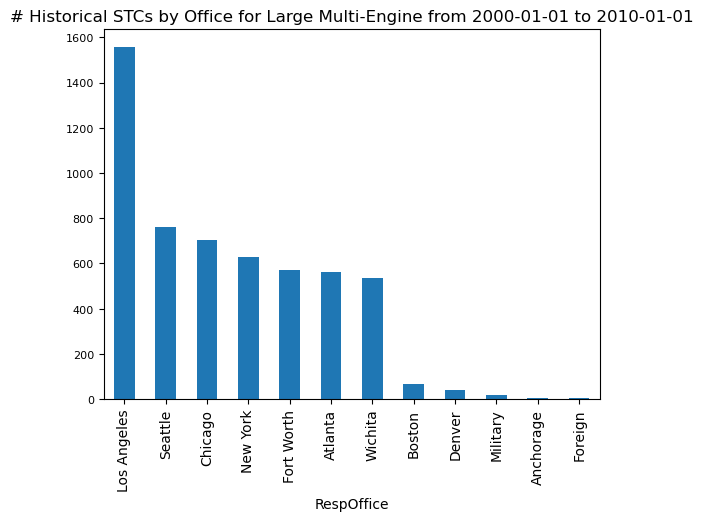

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


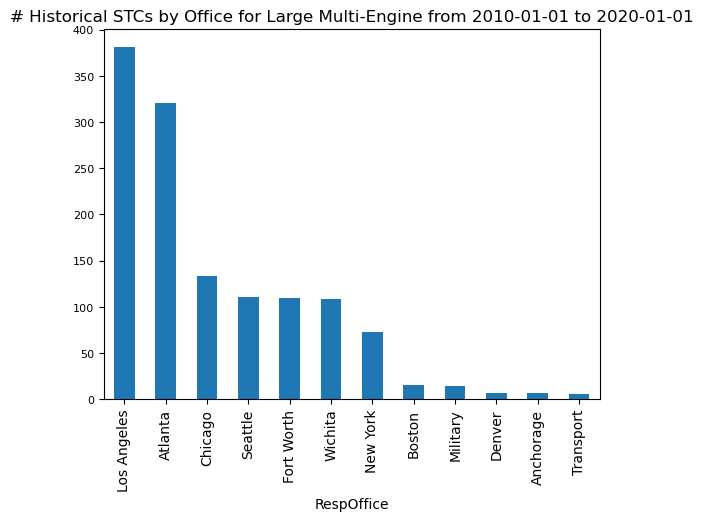

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


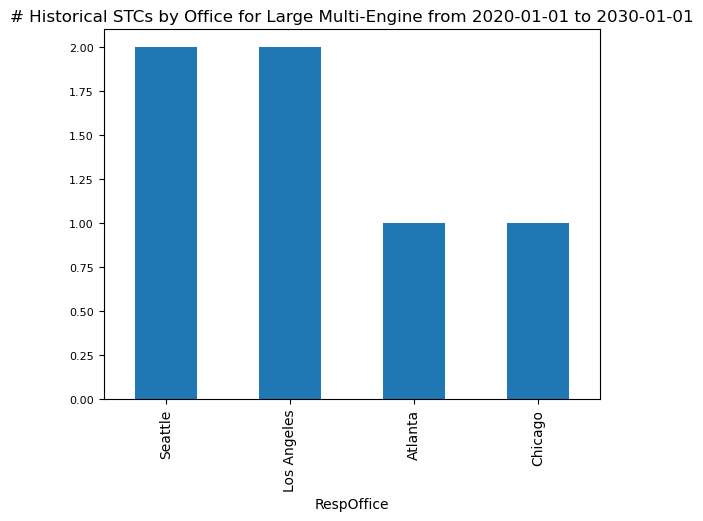

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: Se

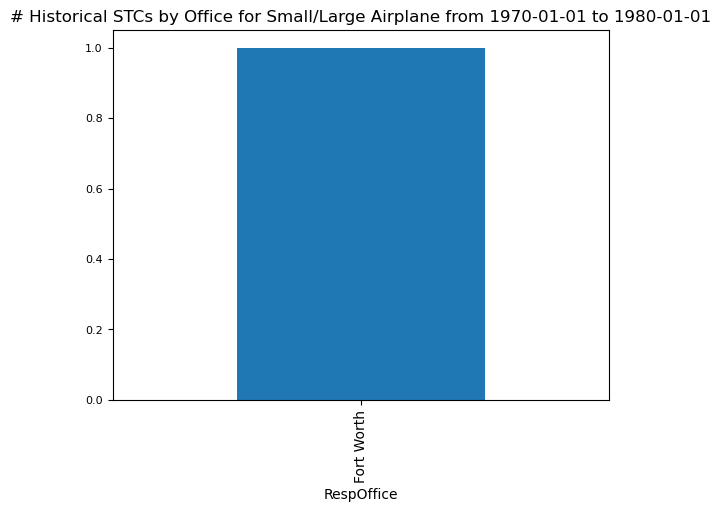

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


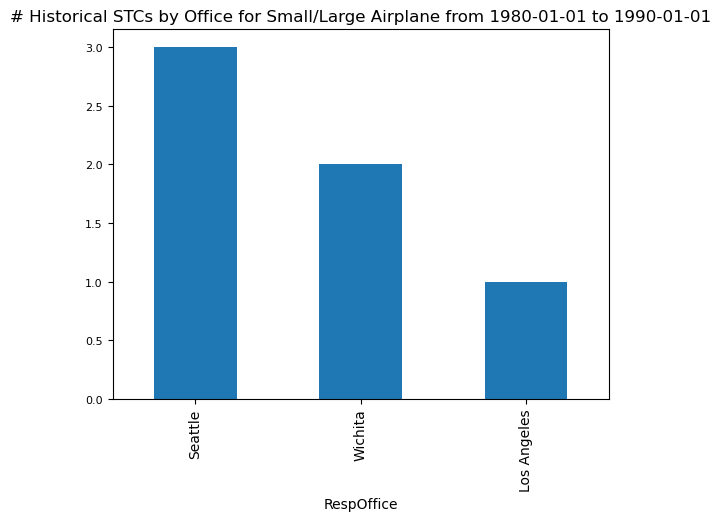

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


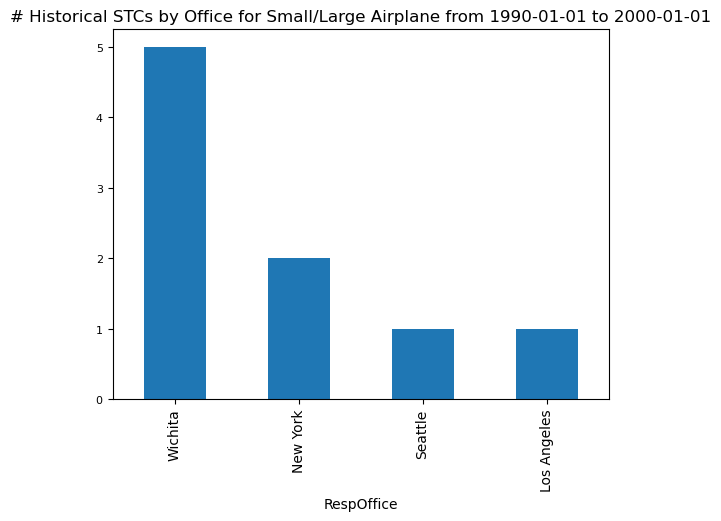

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


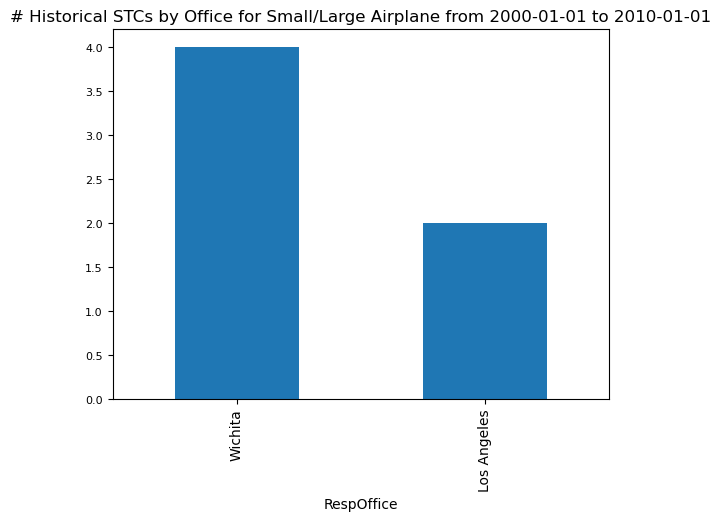

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


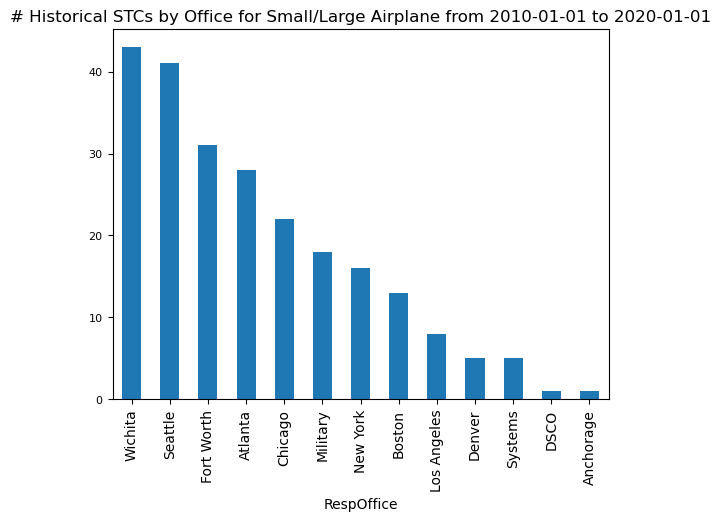

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


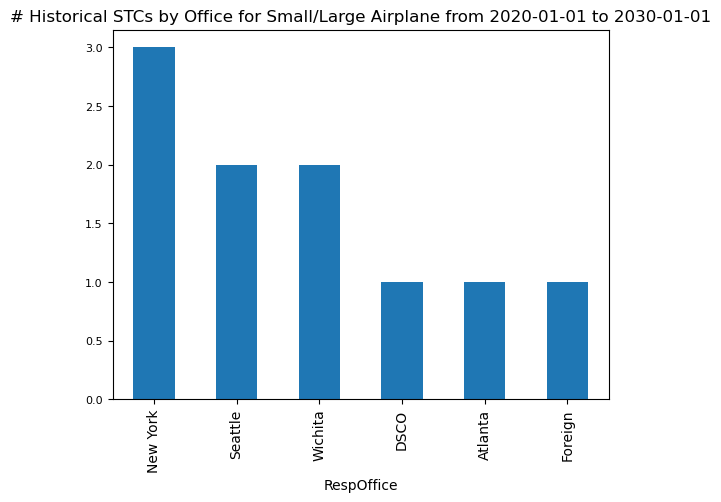

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: Se

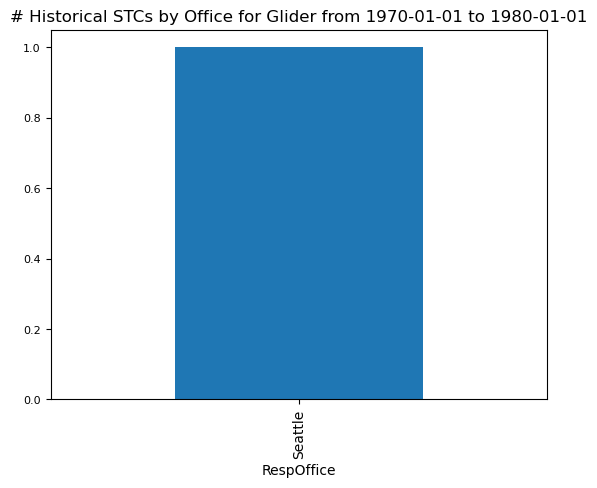

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats i

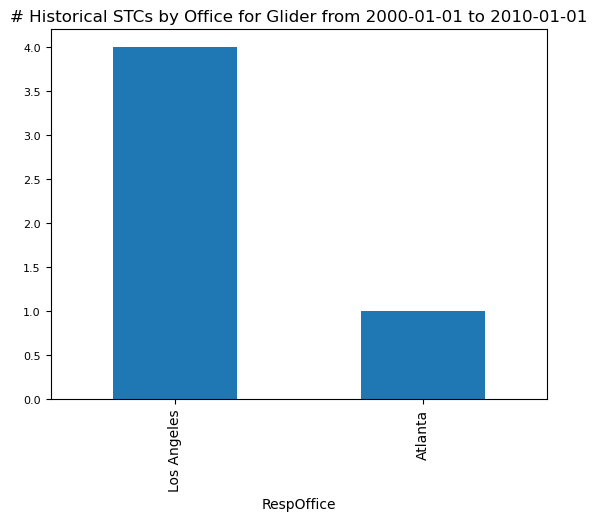

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats i

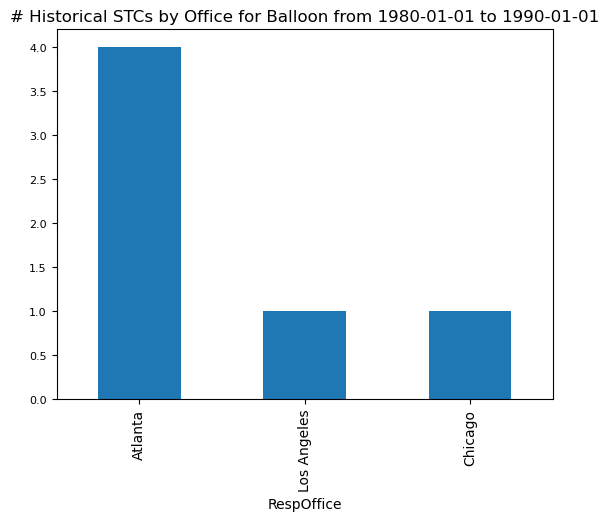

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


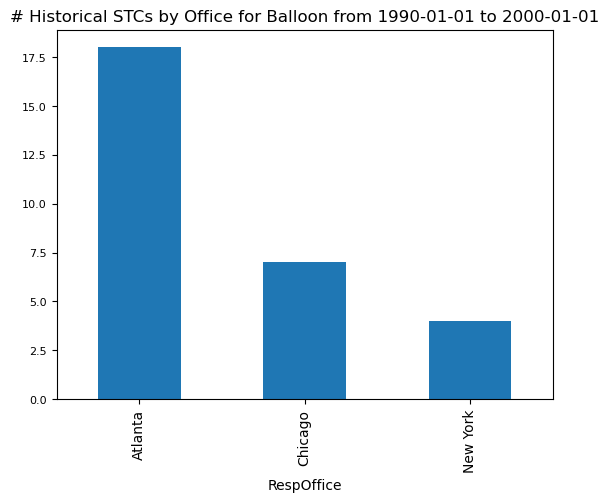

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


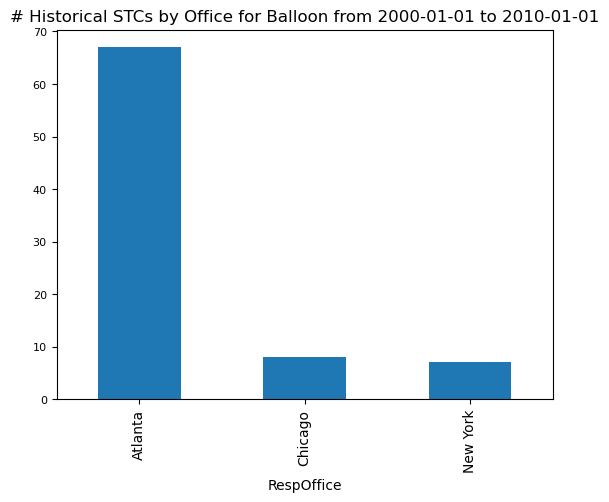

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


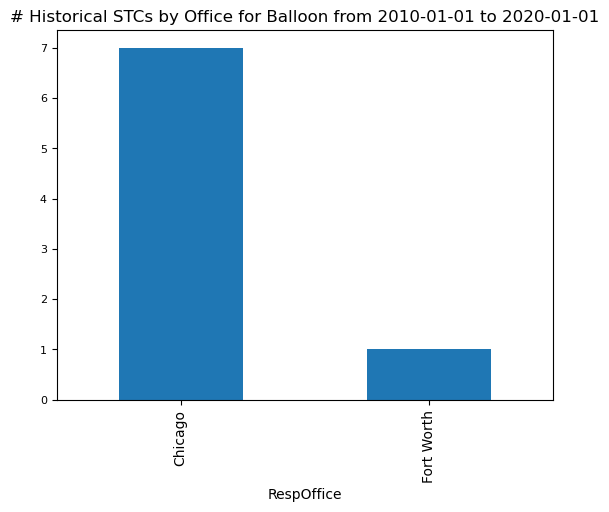

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


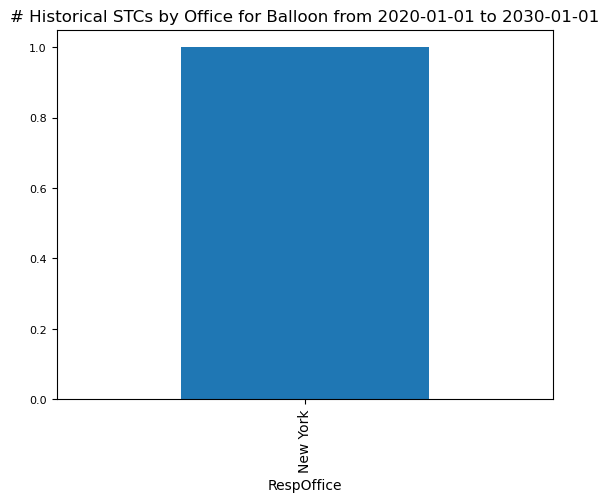

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: Se

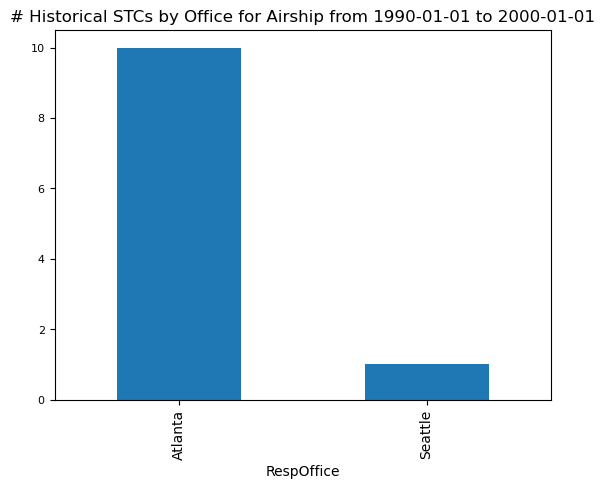

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


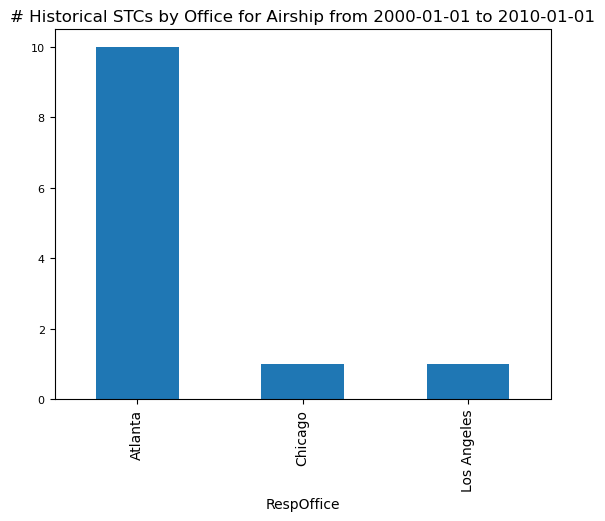

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()


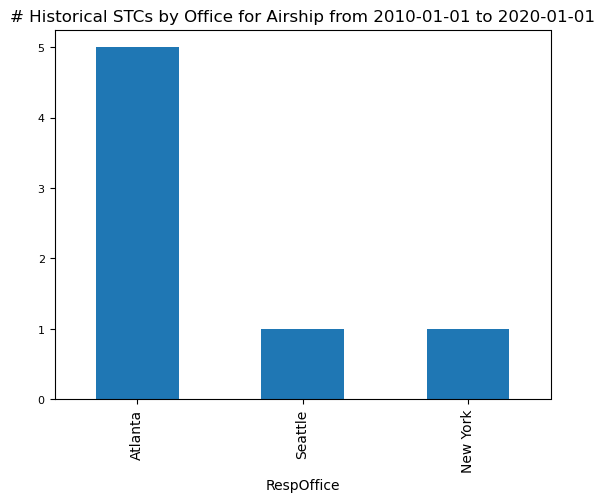

C:\Users\victor\AppData\Local\Temp\ipykernel_7812\2534784556.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date


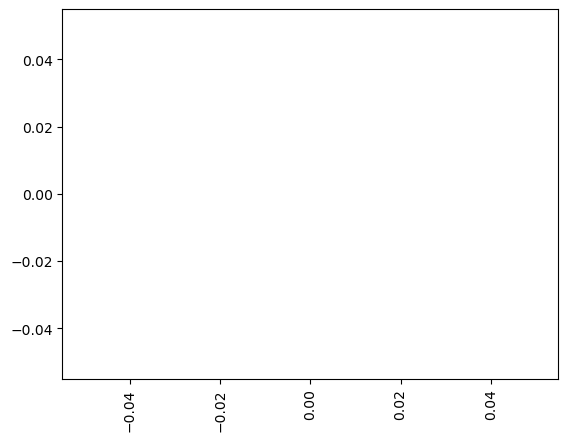

In [32]:
import matplotlib.pyplot as plt
import numpy as np

plt.rcParams['figure.dpi'] = 100
plt.rcParams['figure.figsize'] = 6.4, 4.8

df_stc_with_office = df_stc.merge(df_office, on='drs:primaryRespOffice')

for status in [["Current","Historical"],["Current"],["Historical"]]:
    for m, stcProductSubType in enumerate(df_stc_with_office["drs:stcProductSubType"].unique()):
        for n, _ in enumerate(start_dates):              
            try:
                df_dates = df_stc_with_office[df_stc_with_office["drs:stcProductSubType"]==stcProductSubType]
                df_dates["date sortable "+str(n)] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce").dt.date
                df_dates = df_dates[(start_dates.iloc[n]<df_dates["date sortable "+str(n)]) & (df_dates["date sortable "+str(n)]<end_dates.iloc[n])]
                df_dates[df_dates["drs:status"].isin(status)][df_dates["drs:stcProductSubType"]==stcProductSubType]["RespOffice"].value_counts(ascending=False).plot.bar()
                plt.yticks(fontsize=8)
                plt.title("# "+', '.join(status)+" STCs by Office for "+stcProductSubType +" from "+str(start_dates.iloc[n])+" to "+str(end_dates.iloc[n]))
                plt.show()
            except:
                pass

## STC dates

In [ ]:
df_stc[df_stc["drs:stcProductSubType"]==stcProductSubType][['drs:chronicleId', date_type]]

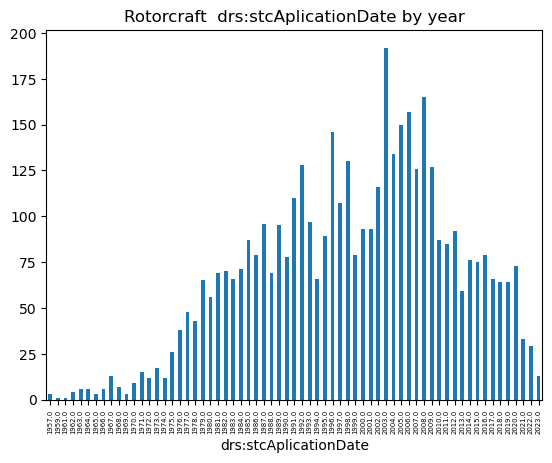

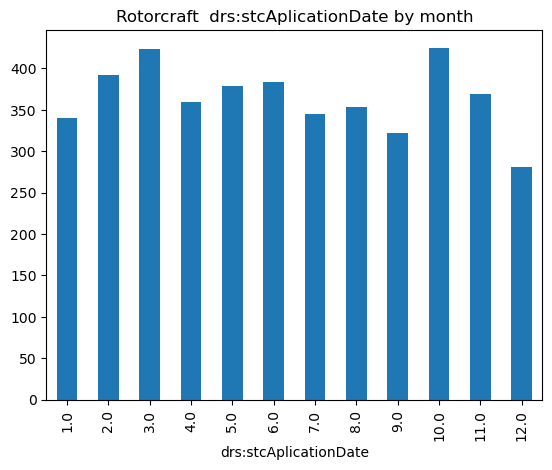

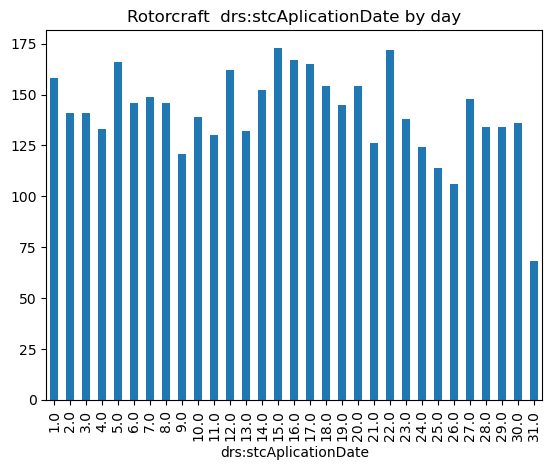

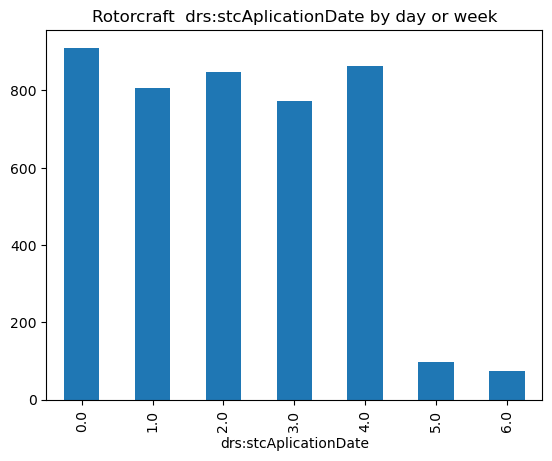

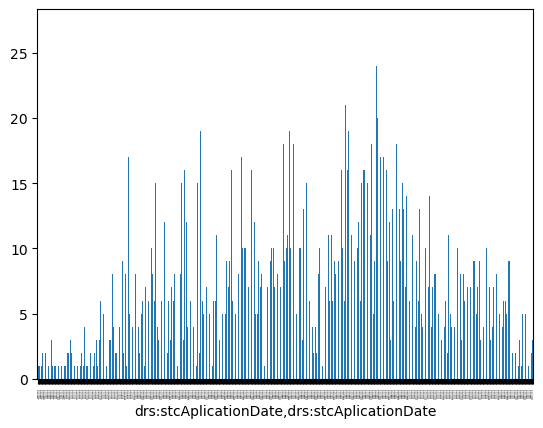

...

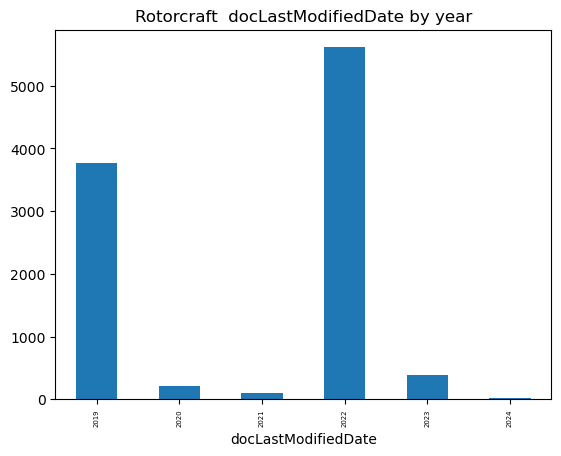

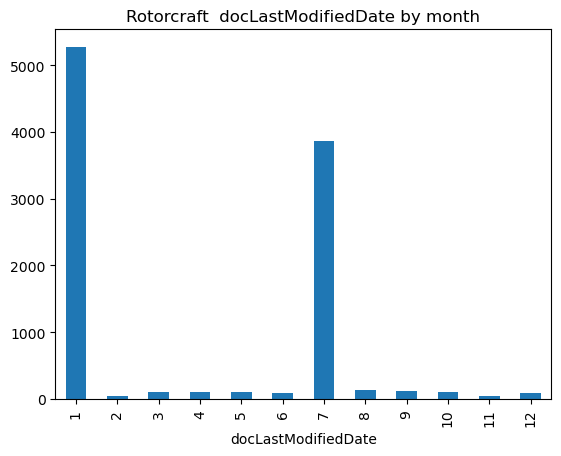

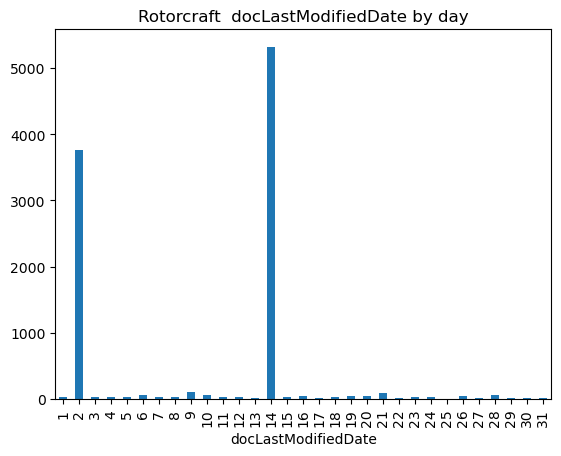

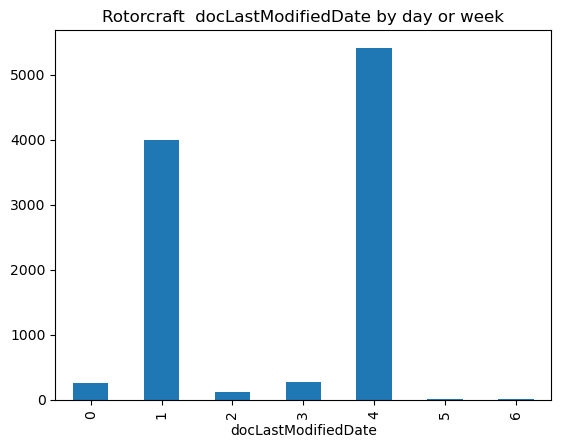

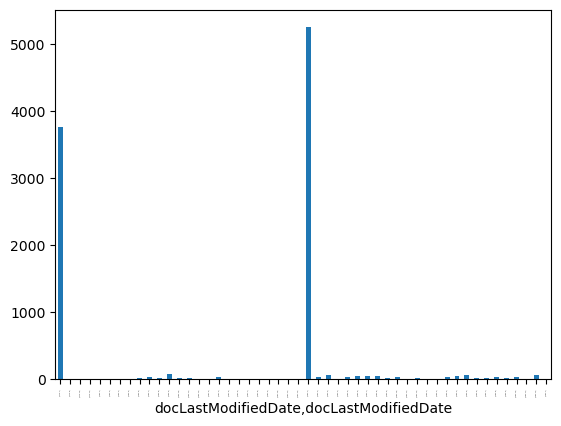

In [19]:
import matplotlib.pyplot as plt
import pandas as pd

plt.rcParams['figure.dpi'] = 100

for m, stcProductSubType in enumerate(df_stc["drs:stcProductSubType"].unique()):
    stcProductSubType =  'Rotorcraft'
    for date_type in ["drs:stcAplicationDate", "drs:stcStatusDate", "docLastModifiedDate"]:
        df_dates = df_stc[df_stc["drs:stcProductSubType"]==stcProductSubType][['drs:chronicleId', date_type]]
        df_dates = df_dates.drop_duplicates()
        df_dates = df_dates[date_type]
        df_dates = pd.to_datetime(df_dates, errors="coerce")
        
        #.to_datetime astype("datetime64", errors = 'ignore')
        #df_dates = df_stc[date_type].astype("datetime64", errors = 'ignore')
        df_dates.groupby(df_dates.dt.year).count().plot(kind="bar")
        plt.xticks(fontsize=5)
        plt.title(stcProductSubType+"  "+date_type+" by year")
        plt.show()
        df_dates.groupby(df_dates.dt.month).count().plot(kind="bar")
        plt.title(stcProductSubType+"  "+date_type+" by month")
        plt.show()
        df_dates.groupby(df_dates.dt.day).count().plot(kind="bar")
        plt.title(stcProductSubType+"  "+date_type+" by day")
        plt.show()
        df_dates.groupby(df_dates.dt.day_of_week).count().plot(kind="bar")
        plt.title(stcProductSubType+"  "+date_type+" by day or week")
        plt.show()
        df_dates.groupby([df_dates.dt.year, df_dates.dt.month]).count().plot(kind="bar")
        plt.xticks(fontsize=1)
        plt.show()

## Same but by decade

77952   1957-06-28
Name: drs:stcStatusDate, dtype: datetime64[ns]


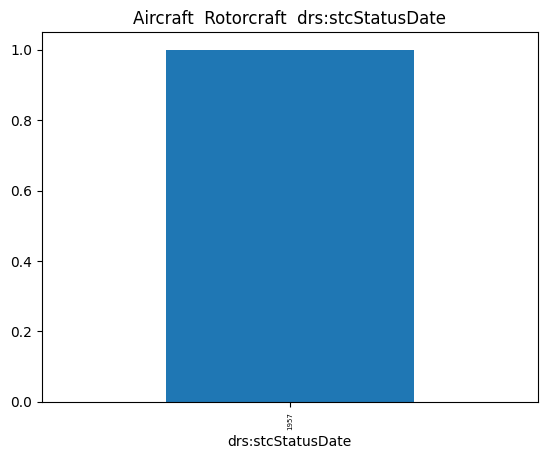

74705   1969-05-09
74710   1969-04-29
74755   1969-01-16
74756   1969-01-16
74792   1968-09-05
74866   1967-10-31
74867   1967-10-30
74872   1967-09-16
74897   1967-06-13
74911   1967-05-01
74921   1967-03-22
74938   1967-03-02
74945   1967-01-31
74955   1966-12-08
74956   1966-12-08
74957   1966-12-08
74958   1966-12-08
74959   1966-12-08
74960   1966-12-08
75089   1964-11-27
75204   1961-07-26
75243   1961-01-01
75324   1960-03-22
Name: drs:stcStatusDate, dtype: datetime64[ns]


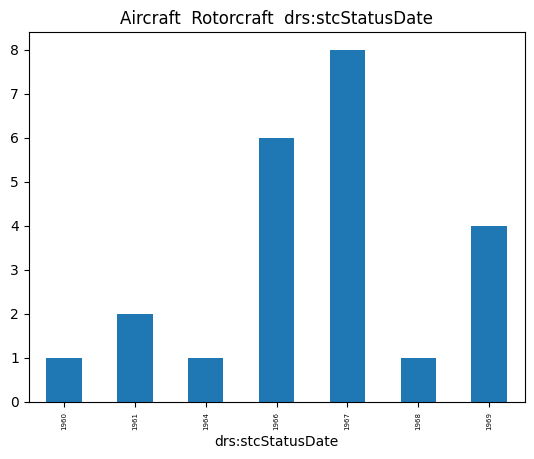

68146   1979-12-13
68152   1979-12-07
68164   1979-11-27
68167   1979-11-21
68168   1979-11-21
           ...    
71722   1970-08-13
71731   1970-07-14
71737   1970-06-30
71775   1970-05-26
71778   1970-05-20
Name: drs:stcStatusDate, Length: 260, dtype: datetime64[ns]


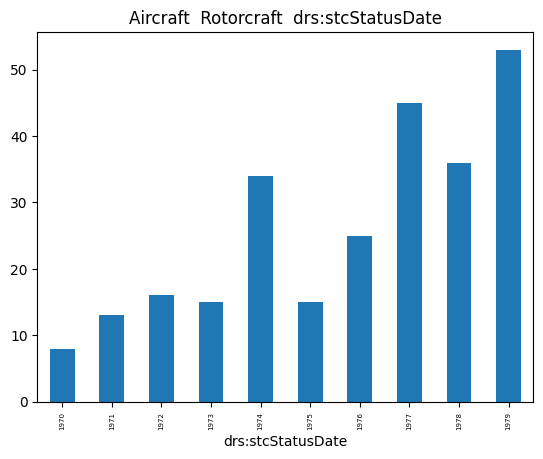

60068   1989-12-21
60075   1989-12-15
60079   1989-12-13
60099   1989-12-08
60101   1989-12-08
           ...    
68081   1980-01-17
68084   1980-01-11
68085   1980-01-11
68086   1980-01-11
68087   1980-01-11
Name: drs:stcStatusDate, Length: 530, dtype: datetime64[ns]


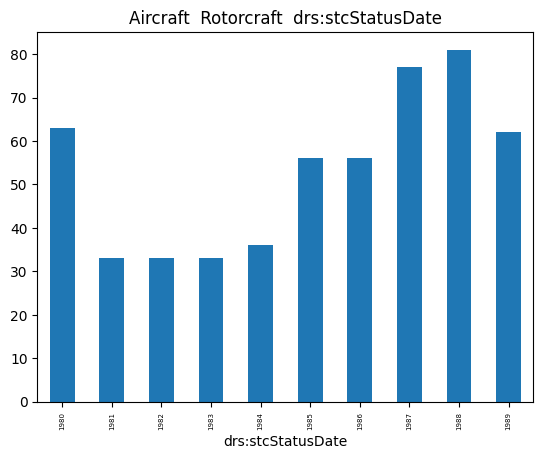

46542   1999-12-30
46544   1999-12-30
46555   1999-12-27
46571   1999-12-22
46576   1999-12-22
           ...    
60046   1990-01-08
60047   1990-01-08
60048   1990-01-08
60049   1990-01-08
60050   1990-01-08
Name: drs:stcStatusDate, Length: 1806, dtype: datetime64[ns]


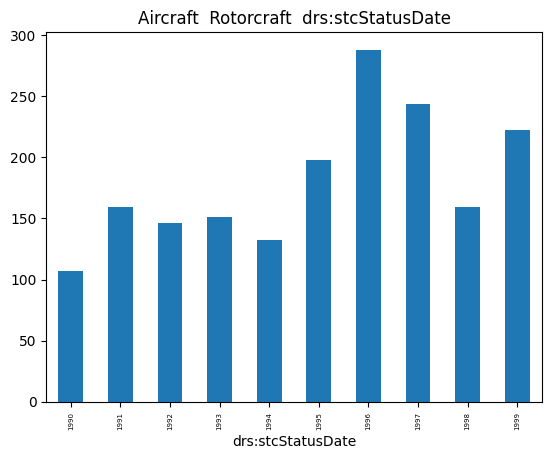

22894   2009-12-30
22895   2009-12-30
22896   2009-12-30
22902   2009-12-28
22903   2009-12-28
           ...    
46523   2000-01-11
46524   2000-01-11
46528   2000-01-07
46531   2000-01-07
46532   2000-01-07
Name: drs:stcStatusDate, Length: 3266, dtype: datetime64[ns]


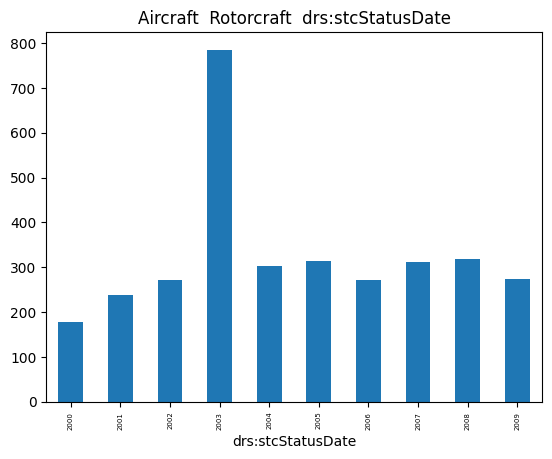

4007    2019-12-19
4009    2019-12-18
4017    2019-12-17
4019    2019-12-16
4027    2019-12-12
           ...    
22847   2010-01-11
22874   2010-01-07
22879   2010-01-06
22884   2010-01-05
22890   2010-01-04
Name: drs:stcStatusDate, Length: 3316, dtype: datetime64[ns]


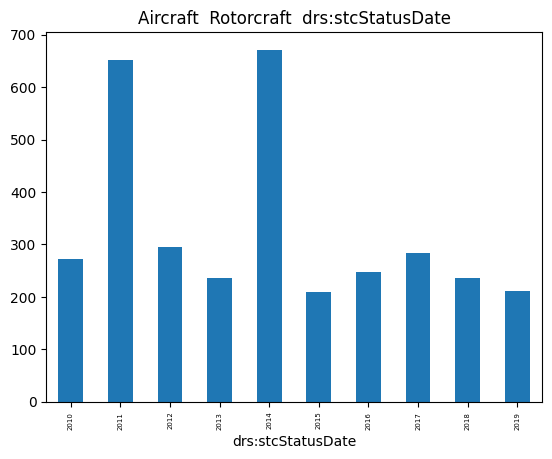

0      2023-03-09
2      2023-03-08
5      2023-03-06
7      2023-03-03
12     2023-03-01
          ...    
3895   2020-01-23
3897   2020-01-22
3909   2020-01-17
3934   2020-01-08
3960   2020-01-06
Name: drs:stcStatusDate, Length: 569, dtype: datetime64[ns]


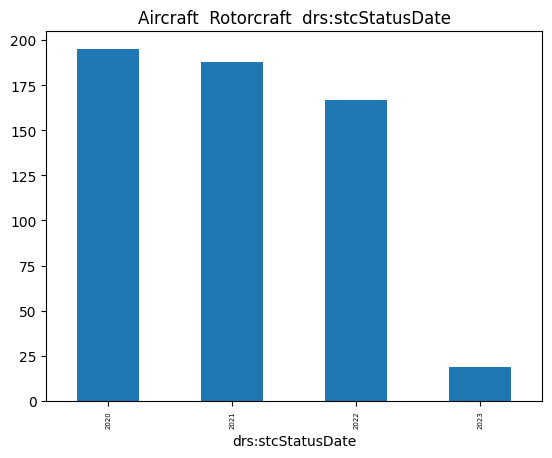

In [188]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

plt.rcParams['figure.dpi'] = 50

for m, stcProductSubType in enumerate(df_stc["drs:stcProductSubType"].unique()):
    for date_type in ["drs:stcStatusDate", "drs:stcAplicationDate", "docLastModifiedDate"]:    
        for n, _ in enumerate(start_dates):  
            #try:
            df_dates = pd.to_datetime(df_stc[df_stc["drs:stcProductSubType"]==stcProductSubType][date_type], errors="coerce")
            df_dates = df_dates.dropna().dt.date            
            df_dates = df_dates[start_dates.iloc[n]<df_dates][df_dates<end_dates.iloc[n]]
            
            df_dates = pd.to_datetime(df_dates)
            try:
                #.to_datetime astype("datetime64", errors = 'ignore')
                #df_dates = df_stc[date_type].astype("datetime64", errors = 'ignore')
                df_dates.groupby(df_dates.dt.year).count().plot(kind="bar")
                plt.xticks(fontsize=5)
                plt.title(df_stc[df_stc["drs:stcProductSubType"]==stcProductSubType].iloc[0]["drs:stcProductType"]+"  "+stcProductSubType+"  "+date_type)
                plt.show()
                '''
                df_dates.groupby(df_dates.dt.month).count().plot(kind="bar")
                plt.show()
                df_dates.groupby(df_dates.dt.day).count().plot(kind="bar")
                plt.show()
                df_dates.groupby(df_dates.dt.day_of_week).count().plot(kind="bar")
                plt.show()
                df_dates.groupby([df_dates.dt.year, df_dates.dt.month]).count().plot(kind="bar")
                plt.xticks(fontsize=1)
                plt.show()
                '''
            except:
                pass
        break
    break

## Delta time between reissuances

C:\Users\victor\AppData\Local\Temp\ipykernel_8864\3852566509.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["drs:stcStatusDate"] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce")


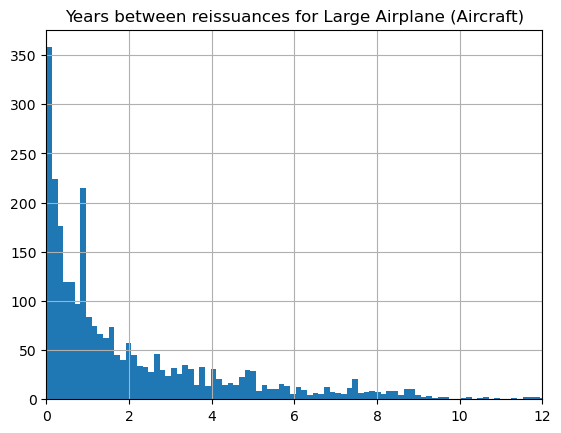

C:\Users\victor\AppData\Local\Temp\ipykernel_8864\3852566509.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["drs:stcStatusDate"] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce")


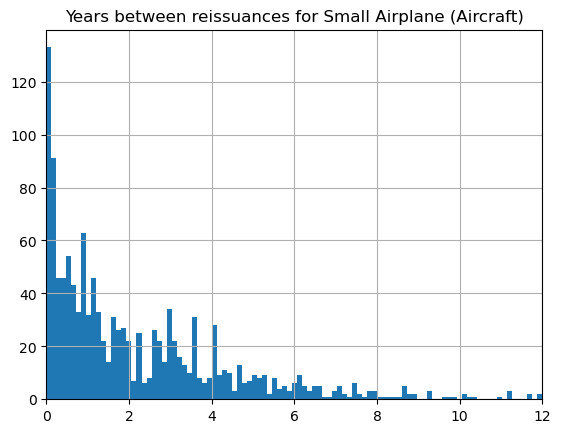

C:\Users\victor\AppData\Local\Temp\ipykernel_8864\3852566509.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["drs:stcStatusDate"] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce")


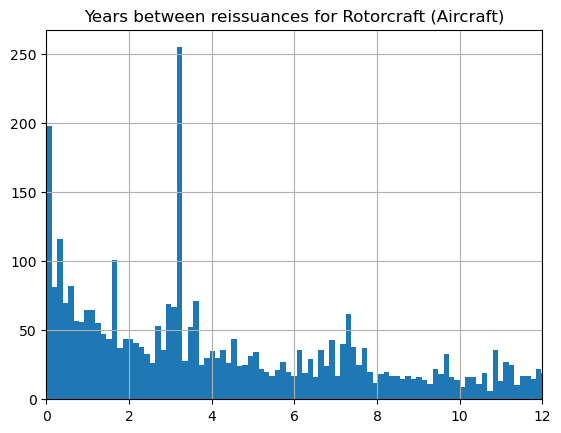

C:\Users\victor\AppData\Local\Temp\ipykernel_8864\3852566509.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["drs:stcStatusDate"] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce")


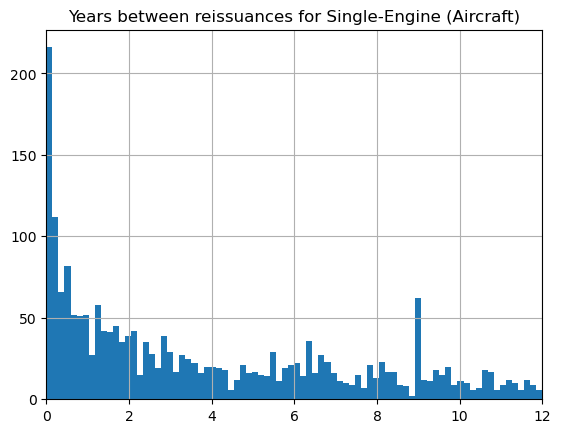

C:\Users\victor\AppData\Local\Temp\ipykernel_8864\3852566509.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["drs:stcStatusDate"] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce")


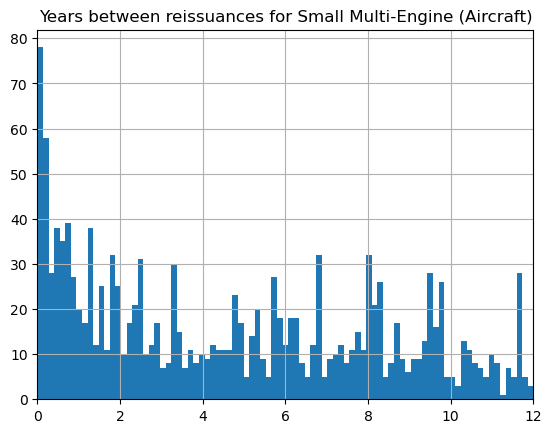

C:\Users\victor\AppData\Local\Temp\ipykernel_8864\3852566509.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["drs:stcStatusDate"] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce")


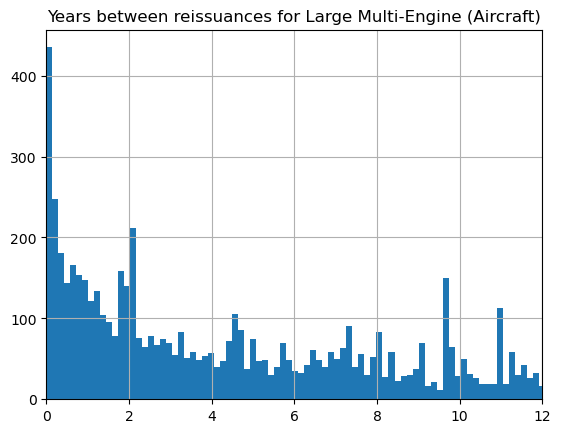

C:\Users\victor\AppData\Local\Temp\ipykernel_8864\3852566509.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["drs:stcStatusDate"] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce")


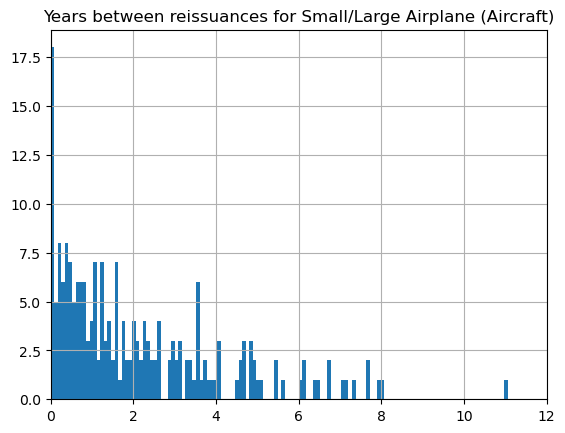

C:\Users\victor\AppData\Local\Temp\ipykernel_8864\3852566509.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["drs:stcStatusDate"] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce")


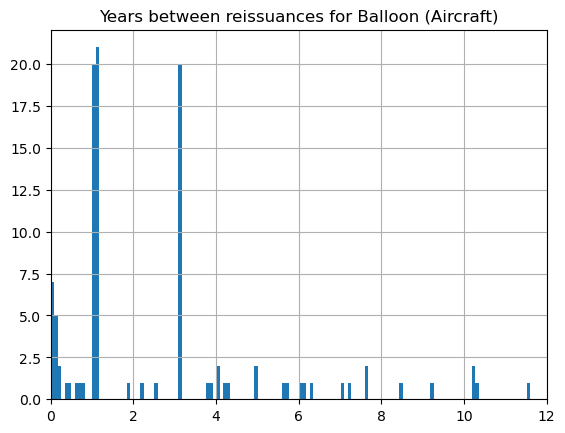

C:\Users\victor\AppData\Local\Temp\ipykernel_8864\3852566509.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["drs:stcStatusDate"] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce")


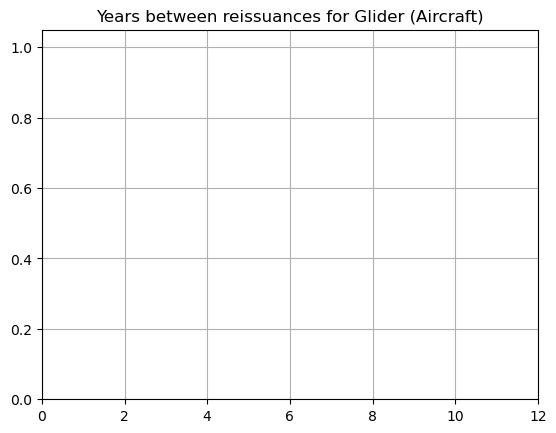

C:\Users\victor\AppData\Local\Temp\ipykernel_8864\3852566509.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["drs:stcStatusDate"] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce")


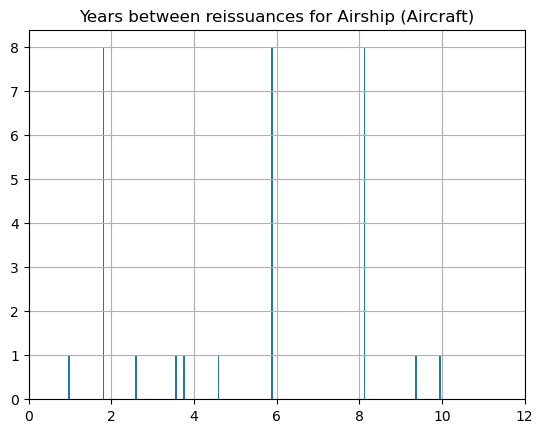

In [2]:
import matplotlib.pyplot as plt


for m, stcProductSubType in enumerate(df_stc["drs:stcProductSubType"].unique()):
    try:
        df_dates = df_stc[df_stc["drs:stcProductSubType"]==stcProductSubType]
        df_dates["drs:stcStatusDate"] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce")

        df_dates_diff = None

        for stc in df_dates["drs:chronicleId"].unique():
            this_dates = df_dates[df_dates["drs:chronicleId"]==stc].sort_values(by="drs:stcStatusDate")[["drs:stcStatusDate"]].diff()

            if this_dates.shape[0]>1:
                if df_dates_diff is None:
                    df_dates_diff = pd.DataFrame.from_dict(this_dates)
                else:
                    df_dates_diff = pd.concat([df_dates_diff, this_dates])                

        df_dates_diff = df_dates_diff.dropna()
        toto = df_dates_diff["drs:stcStatusDate"].dt.days/365
        toto.hist(bins=400)
        plt.xlim(left=0, right=12)
        plt.title("Years between reissuances for " + stcProductSubType+" ("+df_dates.iloc[0]["drs:stcProductType"]+")")
        plt.show()
    except:
        pass


## Number of reissuances

C:\Users\victor\AppData\Local\Temp\ipykernel_8864\989233957.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["drs:stcStatusDate"] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce")


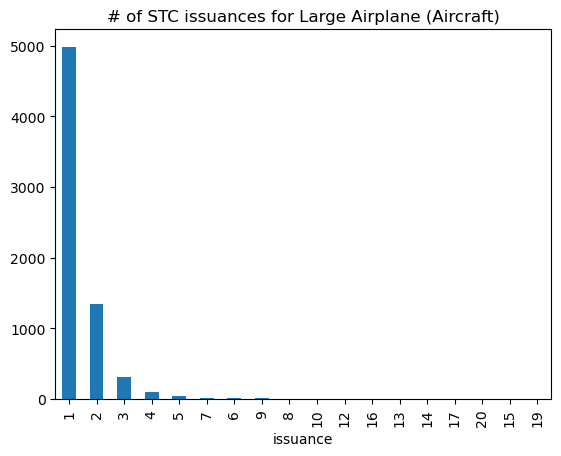

C:\Users\victor\AppData\Local\Temp\ipykernel_8864\989233957.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["drs:stcStatusDate"] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce")


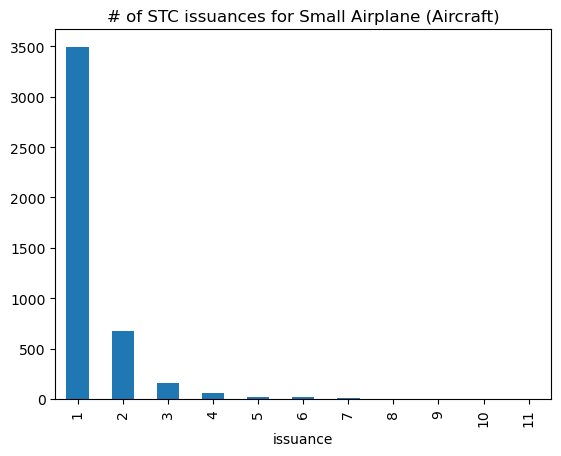

C:\Users\victor\AppData\Local\Temp\ipykernel_8864\989233957.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["drs:stcStatusDate"] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce")


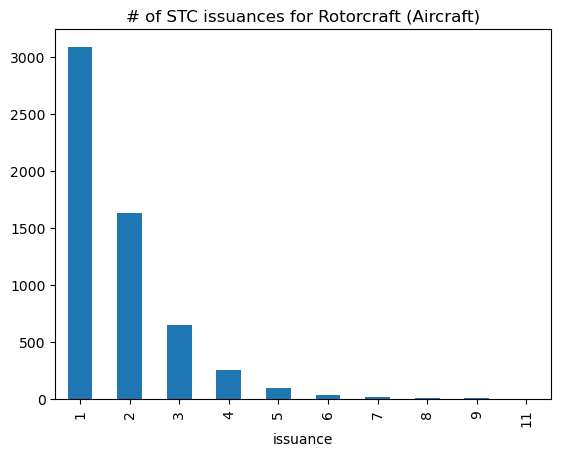

C:\Users\victor\AppData\Local\Temp\ipykernel_8864\989233957.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["drs:stcStatusDate"] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce")


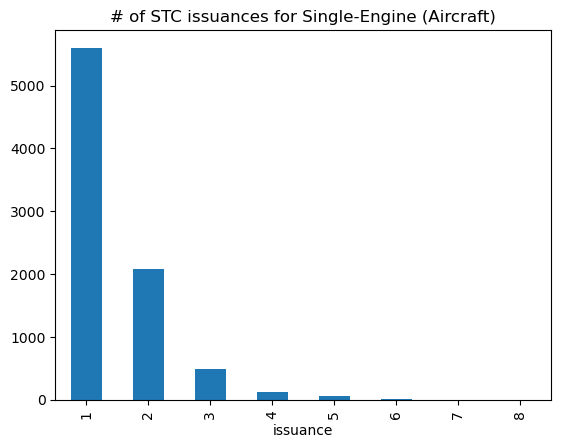

C:\Users\victor\AppData\Local\Temp\ipykernel_8864\989233957.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["drs:stcStatusDate"] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce")


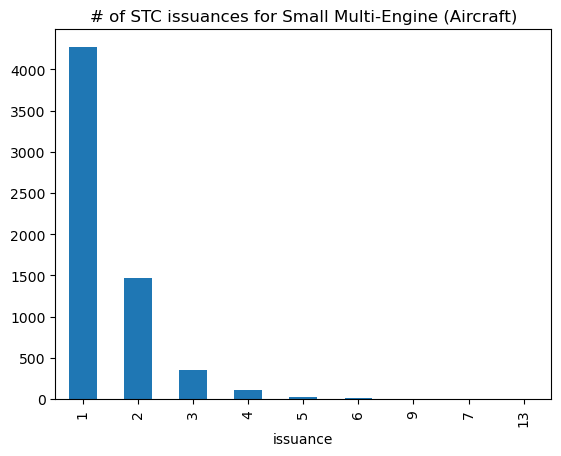

C:\Users\victor\AppData\Local\Temp\ipykernel_8864\989233957.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["drs:stcStatusDate"] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce")


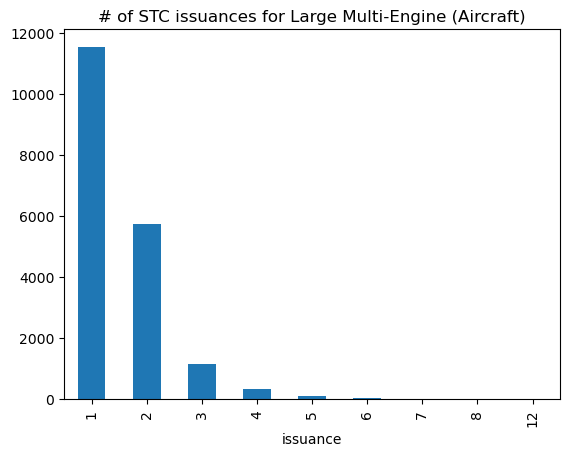

C:\Users\victor\AppData\Local\Temp\ipykernel_8864\989233957.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["drs:stcStatusDate"] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce")


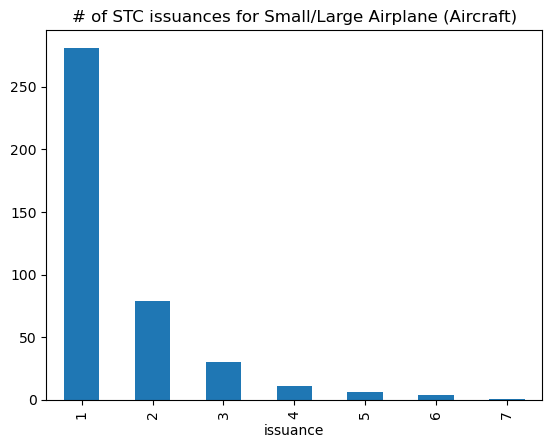

C:\Users\victor\AppData\Local\Temp\ipykernel_8864\989233957.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["drs:stcStatusDate"] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce")


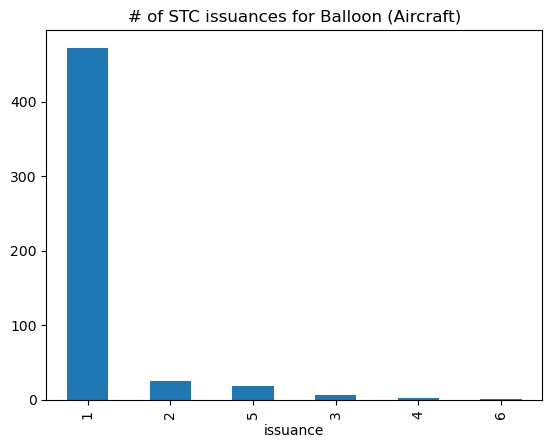

C:\Users\victor\AppData\Local\Temp\ipykernel_8864\989233957.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["drs:stcStatusDate"] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce")


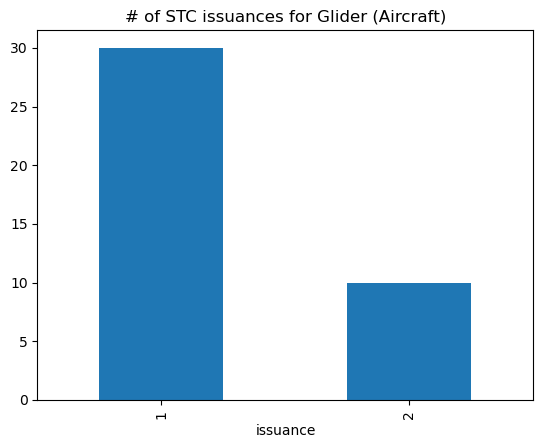

C:\Users\victor\AppData\Local\Temp\ipykernel_8864\989233957.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dates["drs:stcStatusDate"] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce")


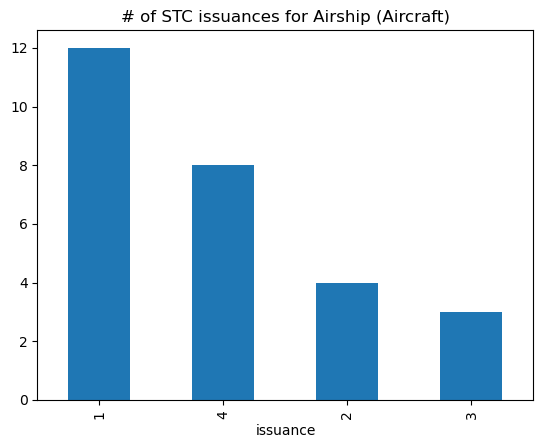

In [16]:
plt.rcParams['ytick.labelsize'] = 10

for _, stcProductSubType in enumerate(df_stc["drs:stcProductSubType"].unique()):
    try:
        df_dates = df_stc[df_stc["drs:stcProductSubType"]==stcProductSubType]
        df_dates["drs:stcStatusDate"] = pd.to_datetime(df_dates["drs:stcStatusDate"], errors="coerce")

        df_dates_diff = None

        for stc in df_dates["drs:chronicleId"].unique():
            # this_dates = pd.DataFrame(data={'issuance': 
            #                                 list(range(0,df_dates[df_dates["drs:chronicleId"]==stc].shape[0]))})       
            this_dates = pd.DataFrame(data={'issuance': 
                                            [df_dates[df_dates["drs:chronicleId"]==stc].shape[0]-1]})  
            if df_dates_diff is None:
                df_dates_diff = pd.DataFrame.from_dict(this_dates)
            else:
                df_dates_diff = pd.concat([df_dates_diff, 
                                           this_dates])                

        df_dates_diff = df_dates_diff.dropna()
        df_dates_diff["issuance"].value_counts(ascending=False).plot.bar()
        plt.title("# of STC re-issuances for " + stcProductSubType+" ("+df_dates.iloc[0]["drs:stcProductType"]+")")
        plt.show()
    except:
        pass

    # break

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

for m, stcProductSubType in enumerate(df_stc["drs:stcProductSubType"].unique()):
    for status in [["Current","Historical"],["Current"],["Historical"]]:
        try:
            df_stc[df_stc["drs:status"].isin(status)][df_stc["drs:stcProductSubType"]==stcProductSubType]["drs:stcHolder"].value_counts(ascending=False).nlargest(100).plot.bar() # legend=False, ax=axs[n, m]
            plt.title("# STCs by STC Holder for "+", ".join(status)+" and "+stcProductSubType)
            plt.show()
        except:
            pass
        #axs[n, m].set_title("# STCs by STC Holder for "+status+" and "+stcProductSubType)
#plt.show()

'''
df_stc["drs:stcHolder"].value_counts(ascending=True).nlargest(1000).plot.barh()
plt.title("# STCs by STC Holder")
plt.show()

then by dates?

nombre de STC par a, vs reissuance

faire date vs autre
'''

'''
df_stc["drs:stcProductType)"].value_counts(ascending=True).plot.barh()
plt.title("# STCs by Product Type")
plt.show()

df_stc["drs:primaryRespOffice"].value_counts(ascending=True).plot.barh()
plt.title("# STCs by certification office")
plt.show()

df_stc["drs:primaryRespOffice"].value_counts(ascending=True).plot.barh()
plt.title(withotu pdf?")
plt.show()

df_stc_sorted = df_stc.sort_values(by=["drs:stcStatusDate"])
df_stc[""].value_counts(ascending=True).plot.barh()
plt.plot(df_stc_sorted["drs:stcStatusDate"], np.linspace(1,df_stc.shape[0],df_stc.shape[0]))
plt.title("# STCs by Status Date")
plt.show()

bins = need to give number of weeks
_ = np.histogram(df_stc["drs:stcStatusDate"], bins=10, range=(a.min(), a.max()))
plt.title("# STCs by Status Date by weeks")
plt.show()

faut rajouter map ou adress

df_stc[""].value_counts(ascending=True).plot.barh()
plt.title("")
plt.show()
'''

# Aicraft TC Numbers statistics

In [ ]:
drs:stcModel

STC by TC. then by time for last update. Can give an idea of market share.